In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pmdarima import auto_arima
from sklearn.metrics import mean_squared_error, mean_absolute_percentage_error
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.statespace.sarimax import SARIMAX
import math
from statsmodels.tsa.seasonal import seasonal_decompose

In [2]:
import warnings

warnings.filterwarnings("ignore")

In [4]:
combined_df = pd.read_csv("datasets/combined_df_with_2026.csv")

In [5]:
combined_df

,Age,Sex,Country,Unemployment Rate (%),Year,Month
0,25+,Female,Ireland,0.096000,2014,4
1,25+,Total,Norway,0.028000,2014,10
2,25+,Male,Iceland,0.052000,2021,1
3,25+,Male,Iceland,0.049000,2021,2
4,25+,Male,Iceland,0.048000,2021,3
...,...,...,...,...,...,...
33650,25+,Total,United States of America,0.029308,2025,8
33651,25+,Total,United States of America,0.029101,2025,9
33652,25+,Total,United States of America,0.028894,2025,10
33653,25+,Total,United States of America,0.028688,2025,11


## Common part

In [7]:
def prepare_data(combined_df, country, age, sex):
    data_filtered = combined_df[
        (combined_df['Country'] == country) &
        (combined_df['Age'] == age) &
        (combined_df['Sex'] == sex)
    ]
    data_filtered['Date'] = pd.to_datetime(data_filtered['Year'].astype(str) + '-' + data_filtered['Month'].astype(str), format='%Y-%m')

    data_filtered.drop(['Country', 'Sex', 'Age', 'Year', 'Month'], axis=1, inplace=True)
    data_filtered.set_index('Date', inplace=True)
    data_filtered.rename(columns={'Unemployment Rate (%)': 'Value'}, inplace=True)
    data_filtered = data_filtered.sort_values(by='Date')

    return data_filtered

forecast_results_df = pd.DataFrame(columns=['Model', 'Country', 'Age', 'Sex', 'Date', 'Forecast', 'MSE', 'RMSE', 'MAPE'])

def save_forecast_results(model_name, country, age, sex, predictions, mse, rmse, mape):
    global forecast_results_df

    results = pd.DataFrame({
        'Model': model_name,
        'Country': country,
        'Age': age,
        'Sex': sex,
        'Date': predictions.index,
        'Forecast': predictions.values,
        'MSE': mse,
        'RMSE': rmse,
        'MAPE': mape
    })

    if not results.empty and not results.isna().all().all():
        forecast_results_df = pd.concat([forecast_results_df, results], ignore_index=True)
    else:
        print("Skipping empty or all-NA DataFrame in concatenation.")


def model_arima(data_filtered, country, age, sex):
    stepwise_fit = auto_arima(data_filtered['Value'],
                              start_p=1, start_q=1,
                              max_p=3, max_q=3, m=12,
                              start_P=0, seasonal=False,
                              d=2, D=2, trace=True,
                              error_action='ignore',
                              suppress_warnings=True,
                              stepwise=True)

    print(stepwise_fit.summary())
    order = stepwise_fit.order

    arima_model = ARIMA(data_filtered['Value'], order=order)
    results_arima = arima_model.fit()

    arima_predictions = results_arima.predict(start='2023-01-01', end='2027-12-01').rename('ARIMA Predictions')

    plt.figure(figsize=(10, 6))
    plt.plot(data_filtered, label='Original Data')
    plt.plot(arima_predictions, label='ARIMA Predictions')
    plt.legend()
    plt.title('Time Series Forecasting with ARIMA')
    plt.xlabel('Date')
    plt.ylabel('Value')
    plt.show()

    actual = data_filtered['Value']['2023-01-01':'2026-12-01']
    arima_predictions_trimmed = arima_predictions.loc['2023-01-01':'2026-12-01']

    actual = actual.dropna()
    arima_predictions_trimmed = arima_predictions_trimmed.loc[actual.index]

    mse_arima = mean_squared_error(actual, arima_predictions_trimmed)
    rmse_arima = math.sqrt(mse_arima)
    mape_arima = mean_absolute_percentage_error(actual, arima_predictions_trimmed)
    print(f'ARIMA - MSE: {mse_arima}, RMSE: {rmse_arima}, MAPE: {mape_arima:.2%}')
    save_forecast_results(
        model_name='ARIMA',
        country=country,
        age=age,
        sex=sex,
        predictions=arima_predictions,
        mse=mse_arima,
        rmse=rmse_arima,
        mape=mape_arima
    )

def model_sarima(data_filtered, country, age, sex):
    stepwise_fit = auto_arima(data_filtered['Value'],
                              start_p=1, start_q=1,
                              max_p=5, max_q=5, m=12,
                              start_P=0, seasonal=True,
                              d=1, D=1, trace=True,
                              error_action='ignore',
                              suppress_warnings=True,
                              stepwise=True)

    print(stepwise_fit.summary())

    order = stepwise_fit.order
    seasonal_order = stepwise_fit.seasonal_order

    sarima_model = SARIMAX(data_filtered['Value'], order=order, seasonal_order=seasonal_order)
    results_sarima = sarima_model.fit()

    sarima_predictions = results_sarima.predict(start='2023-01-01', end='2027-12-01').rename('SARIMA Predictions')


    plt.figure(figsize=(10, 6))
    plt.plot(data_filtered, label='Original Data')
    plt.plot(sarima_predictions, label='SARIMA Predictions')
    plt.legend()
    plt.title('Time Series Forecasting with SARIMA')
    plt.xlabel('Date')
    plt.ylabel('Value')
    plt.show()

    actual = data_filtered['Value']['2023-01-01':'2026-12-01']
    sarima_predictions_trimmed = sarima_predictions.loc['2023-01-01':'2026-12-01']

    actual = actual.dropna()
    sarima_predictions_trimmed = sarima_predictions_trimmed.loc[actual.index]

    mse_sarima = mean_squared_error(actual, sarima_predictions_trimmed)
    rmse_sarima = math.sqrt(mse_sarima)
    mape_sarima = mean_absolute_percentage_error(actual, sarima_predictions_trimmed)
    print(f'SARIMA - MSE: {mse_sarima}, RMSE: {rmse_sarima}, MAPE: {mape_sarima:.2%}')
    save_forecast_results(
        model_name='SARIMA',
        country=country,
        age=age,
        sex=sex,
        predictions=sarima_predictions,
        mse=mse_sarima,
        rmse=rmse_sarima,
        mape=mape_sarima
    )

In [8]:
def calculate_seasonal_strength(data, column='Value', period=12, threshold=0.7):
    decomposition = seasonal_decompose(data[column], model='additive', period=period)
    seasonal_component = decomposition.seasonal
    residual_component = decomposition.resid

    original_variance = np.var(data[column].dropna())
    residual_variance = np.var(residual_component.dropna())
    seasonal_strength = 1 - (residual_variance / original_variance)
    seasonality_detected = seasonal_strength > threshold

    print(f"Seasonal Strength: {seasonal_strength:.4f}")
    if seasonality_detected:
        print("Strong seasonality detected.")
    else:
        print("Weak or no seasonality detected.")

    return seasonal_strength, seasonality_detected

## ITALY

### 15-24, Male

In [ ]:
data_filtered = prepare_data(combined_df, country='Italy', age='15-24', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9941
Strong seasonality detected.


(0.9941224949273924, True)

The seasonal strength for Italy, focusing on the Male population aged 15–24  is 0.9941, which is very close to 1. This indicates a strong seasonal pattern in the data. A seasonal strength near 1 suggests that the variability in the data is predominantly driven by the seasonal component rather than noise or randomness.

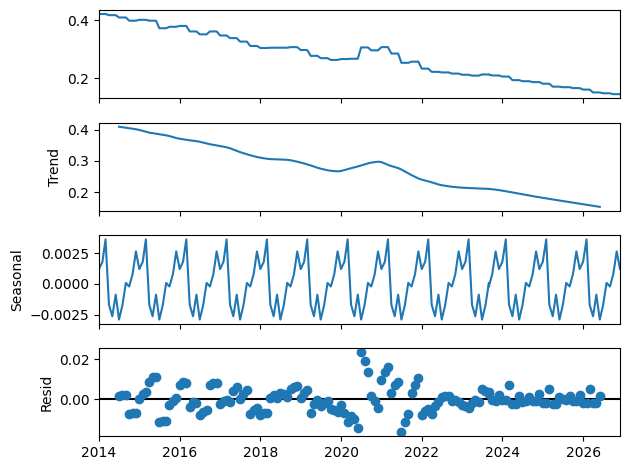

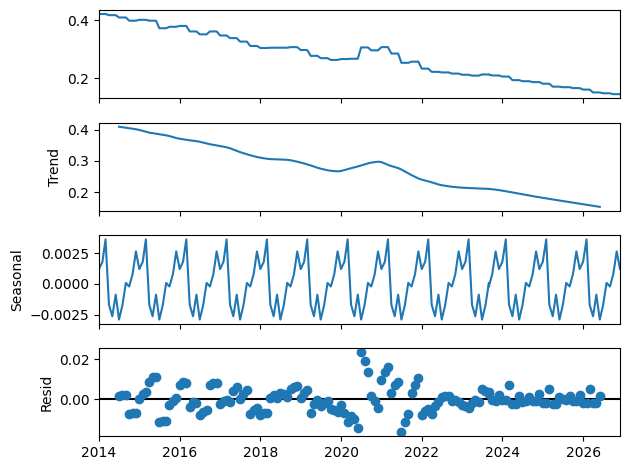

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

The decomposition breaks the time series into three components. The trend component shows a steady decline over the analyzed years, suggesting a long-term downward trajectory in the values for this demographic group. This trend reflects systemic or structural changes in the data, independent of seasonal fluctuations. The seasonal component displays a consistent and periodic pattern, repeating every 12 months, which aligns perfectly with the high seasonal strength detected.
Time series for Italy’s 15–24 Male population demonstrates a strong seasonal structure with a clear annual cycle, a declining long-term trend, and minimal unexplained variability

Given the presence of both trend and seasonality, SARIMA (Seasonal ARIMA) is the most suitable model for this time series. SARIMA can account for both trend and seasonal fluctuations, making it a more accurate choice than classical ARIMA, which does not consider seasonality.

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=5.54 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-903.079, Time=0.19 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-969.693, Time=8.10 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=0.89 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-901.079, Time=0.02 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-1002.117, Time=0.28 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=-1015.927, Time=2.11 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=-1020.797, Time=0.96 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=inf, Time=0.52 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=inf, Time=2.92 sec
 ARIMA(1,1,0)(0,1,2)[12]             : AIC=-1023.597, Time=2.83 sec
 ARIMA(0,1,0)(0,1,2)[12]             : AIC=-1025.467, Time=1.02 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=inf, Time=0.59 sec
 ARIMA(0,1,0)(1,1,2)[12]             : AIC=-1004.391, Time=0.91 sec
 ARIMA(0,1,0)(1,1,1)[12]             :

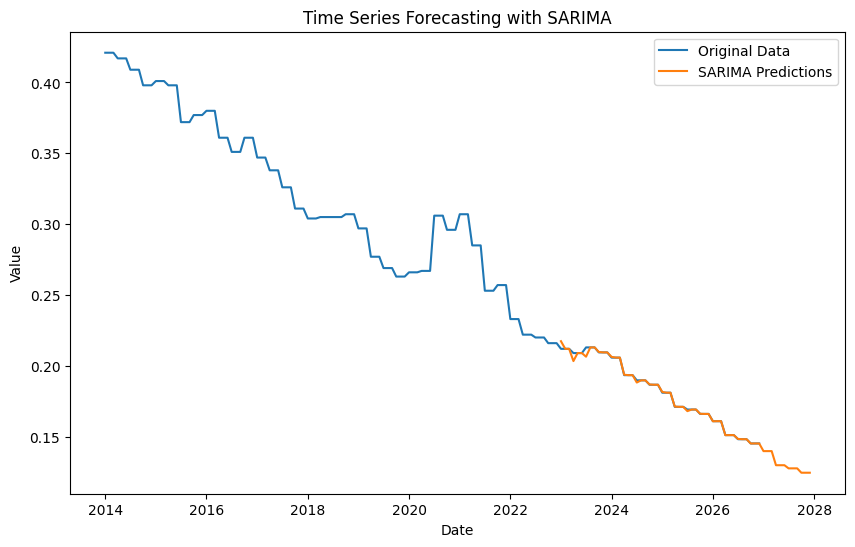

SARIMA - MSE: 2.2604859926611306e-06, RMSE: 0.0015034912679031862, MAPE: 0.23%


In [ ]:
model_sarima(data_filtered, 'Italy', '15-24', 'Male')

The SARIMA model performs exceptionally well on the time series for Italy’s Male population aged 15–24. With a Mean Squared Error (MSE) of 2.26e-06, a Root Mean Squared Error (RMSE) of 0.0015, and a Mean Absolute Percentage Error (MAPE) of 0.23%, the model demonstrates high accuracy. These metrics confirm that SARIMA effectively captures the trend and seasonal patterns, making it a reliable choice for forecasting this data.

### 15-24, Female

In [ ]:
data_filtered = prepare_data(combined_df, country='Italy', age='15-24', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9884
Strong seasonality detected.


(0.9883581958137763, True)

For the 15–24 Female population in Italy, the seasonal strength is 0.9884, indicating a very strong seasonal pattern in the data. This high value confirms that the variability is largely explained by the seasonal component, with minimal influence from random noise.

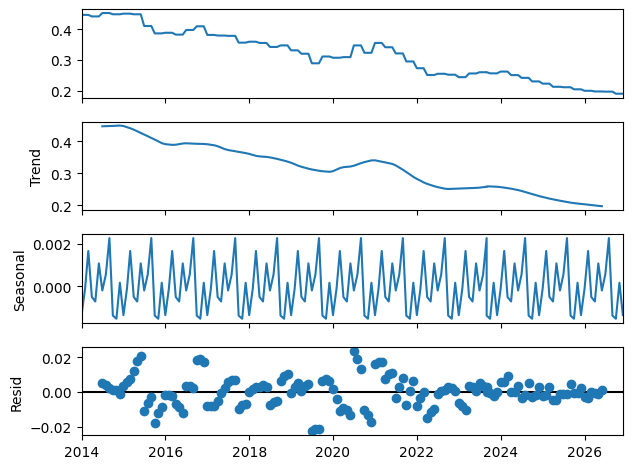

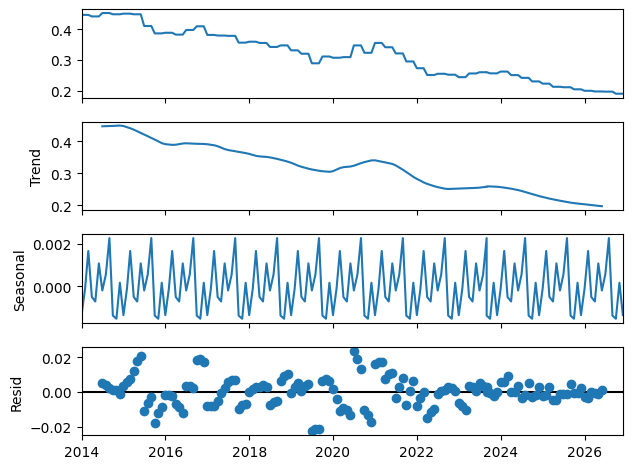

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

The decomposition for the 15–24 Female population in Italy shows a clear declining trend over the years, reflecting a long-term downward pattern. The seasonal component exhibits a strong annual cycle, consistent with the high seasonal strength of 0.9884, indicating seasonality as a major driver of variability. The residuals are minimal, suggesting the model effectively captures the data's patterns, with slight anomalies around 2016 and 2020–2022.

Given the strong seasonality and trend, SARIMA is the most suitable model for this time series.

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)


2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=6.07 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-798.840, Time=0.14 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-858.169, Time=4.03 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=6.24 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-796.840, Time=0.08 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-913.843, Time=1.29 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=-952.199, Time=1.40 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=inf, Time=0.98 sec
 ARIMA(1,1,0)(2,1,2)[12]             : AIC=-946.404, Time=2.97 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=inf, Time=1.56 sec
 ARIMA(0,1,0)(2,1,1)[12]             : AIC=inf, Time=1.29 sec
 ARIMA(2,1,0)(2,1,1)[12]             : AIC=-949.790, Time=2.28 sec
 ARIMA(1,1,1)(2,1,1)[12]             : AIC=-947.572, Time=1.35 sec
 ARIMA(0,1,1)(2,1,1)[12]             : AIC=-951.570, Time=1.20 sec
 ARIMA(2,1,1)(2,1,1)[12]             : AIC=-

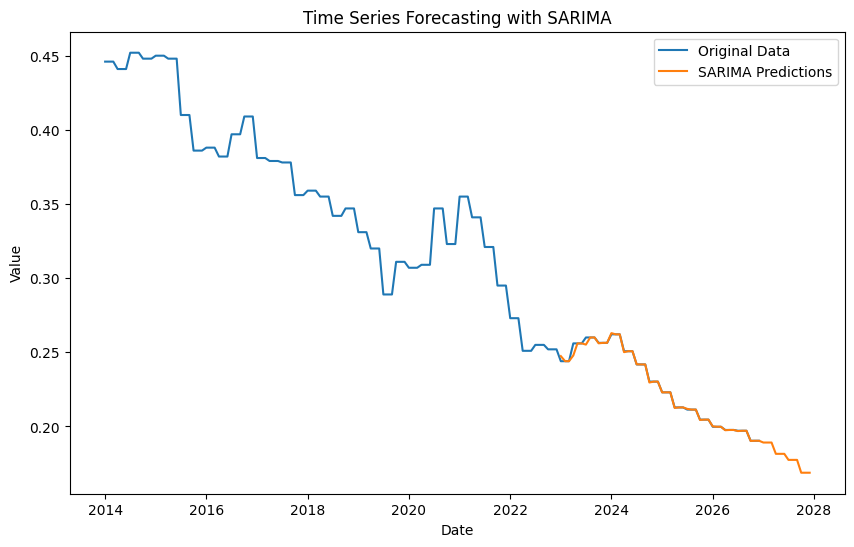

SARIMA - MSE: 2.150404183584045e-06, RMSE: 0.0014664256488428062, MAPE: 0.17%


In [ ]:
model_sarima(data_filtered, 'Italy', '15-24', 'Female')

The SARIMA model for the 15–24 Female population in Italy performs exceptionally well. The Mean Squared Error (MSE) is 2.15e-06, indicating minimal average squared differences between predictions and actual values. The Root Mean Squared Error (RMSE) is 0.00147, showing the average error magnitude is extremely small. The Mean Absolute Percentage Error (MAPE) is 0.17%, meaning the predictions deviate from actual values by only 0.17% on average. These metrics confirm the SARIMA model is highly accurate and reliable for forecasting this time series.

### 15-24, Total

In [ ]:
data_filtered = prepare_data(combined_df, country='Italy', age='15-24', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9866
Strong seasonality detected.


(0.9865937992430877, True)


The seasonal strength for the 15–24 Total population in Italy is 0.9866, indicating a very strong seasonal pattern in the data. This confirms that the variability is primarily driven by a consistent annual cycle, with minimal random noise.

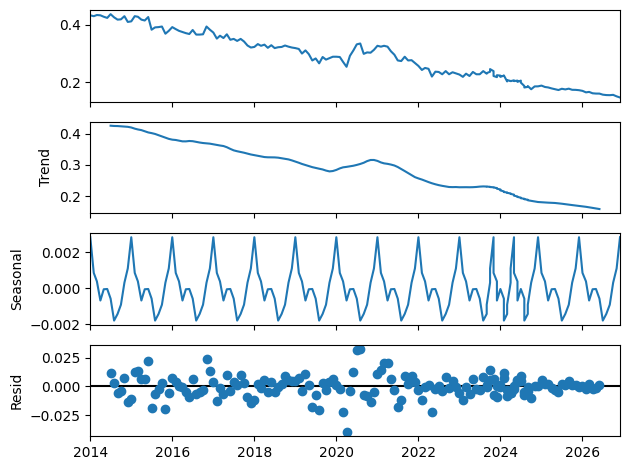

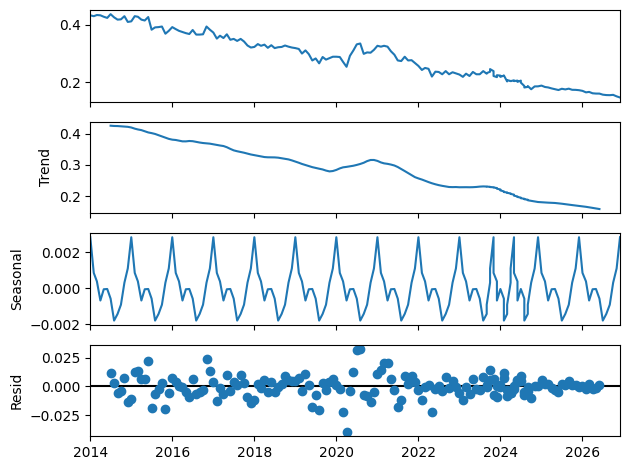

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

The decomposition for the 15–24 Total population in Italy shows a clear declining trend, similar to the male and female subsets, indicating a steady long-term decrease. The seasonal component displays a strong, consistent annual cycle, reflecting the high seasonal strength of 0.9866. This highlights the dominance of predictable yearly patterns in the data. The residuals are minimal, suggesting the model effectively captures the data's patterns, with slight anomalies around 2016 and 2020–2022.
 Given the strong seasonality and trend, SARIMA is the most suitable model for this time series.

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)


2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=3.23 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-719.901, Time=0.11 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-791.694, Time=5.48 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=1.85 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-723.110, Time=0.05 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-829.905, Time=0.58 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=inf, Time=4.97 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=inf, Time=0.88 sec
 ARIMA(0,1,0)(2,1,0)[12]             : AIC=-827.977, Time=0.34 sec
 ARIMA(2,1,0)(2,1,0)[12]             : AIC=-831.562, Time=0.98 sec
 ARIMA(2,1,0)(1,1,0)[12]             : AIC=-790.346, Time=0.23 sec
 ARIMA(2,1,0)(2,1,1)[12]             : AIC=inf, Time=1.72 sec
 ARIMA(2,1,0)(1,1,1)[12]             : AIC=inf, Time=0.71 sec
 ARIMA(3,1,0)(2,1,0)[12]             : AIC=-833.245, Time=0.64 sec
 ARIMA(3,1,0)(1,1,0)[12]             : AIC=-789.8

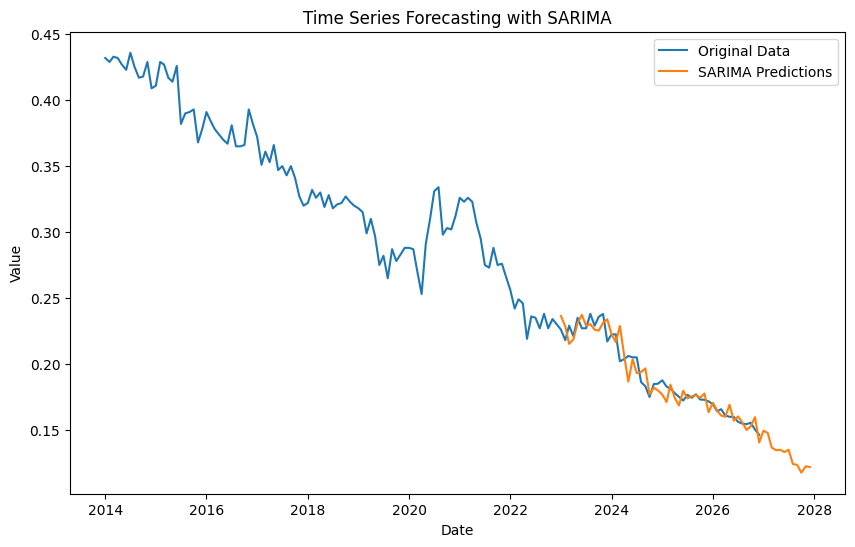

SARIMA - MSE: 7.02389860244719e-05, RMSE: 0.008380870242670023, MAPE: 3.30%


In [ ]:
model_sarima(data_filtered, 'Italy', '15-24', 'Total')

The SARIMA model for the 15–24 Total population in Italy demonstrates good accuracy. The MSE is 7.02e-05, and the RMSE is 0.00838, showing low error magnitudes. With a MAPE of 3.30%, the model reliably captures seasonal and trend patterns with minimal deviations. These metrics confirm the SARIMA model is effective for forecasting this time series.

### 25+, Female

In [ ]:
data_filtered = prepare_data(combined_df, country='Italy', age='25+', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9794
Strong seasonality detected.


(0.9794246851168146, True)


The seasonal strength for the 25+ Female population in Italy is 0.9794, indicating a strong seasonal pattern. This suggests that the variability in the data is largely driven by consistent annual cycles, with minimal random noise. The strong seasonality highlights predictable, recurring patterns in this demographic group.

In [ ]:
data_filtered

,Value
Date,
2014-01-01,0.117000
2014-02-01,0.117000
2014-03-01,0.117000
2014-04-01,0.116000
2014-05-01,0.116000
...,...
2026-08-01,0.062613
2026-09-01,0.062613
2026-10-01,0.062291


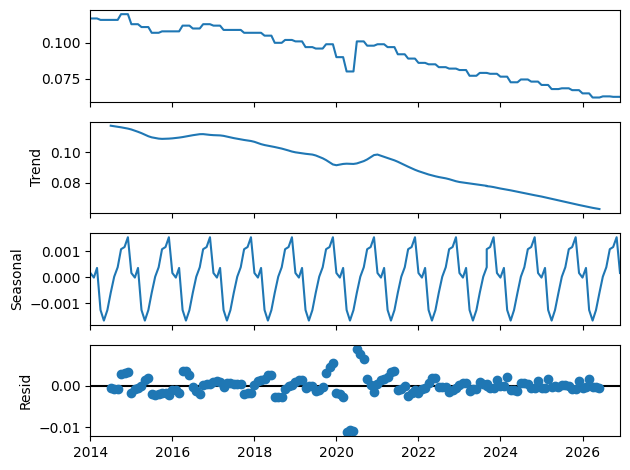

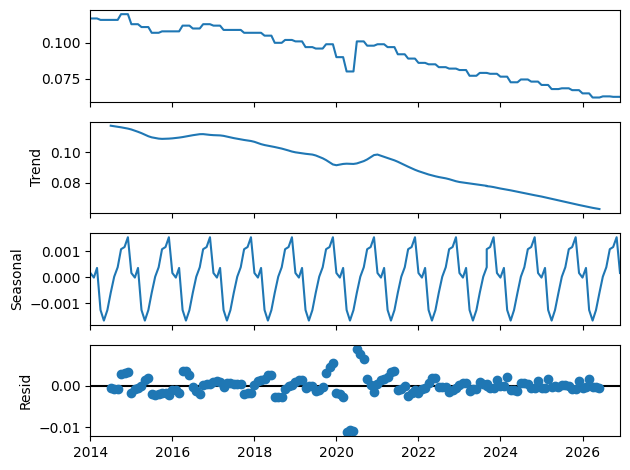

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

The decomposition for the 25+ Female population in Italy reveals a clear downward trend over the years, indicating a long-term decline in the values. The seasonal component shows a consistent annual cycle, which aligns with the strong seasonal strength of 0.9794 detected earlier. This highlights predictable yearly variations dominating the data.

The residuals are minimal overall, suggesting the model effectively captures both trend and seasonality, though slight deviations are visible, particularly around 2020. These anomalies may reflect unexpected events or external factors affecting the data during that period. In summary, the data for this demographic exhibits a strong seasonal pattern combined with a steady downward trend and low unexplained variability, making it suitable for accurate forecasting.

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)


2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1284.970, Time=6.36 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1206.567, Time=0.14 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1237.042, Time=5.10 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1286.971, Time=0.53 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-1204.567, Time=0.15 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-1284.214, Time=1.50 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=-1200.568, Time=4.30 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=-1237.042, Time=0.22 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=-1232.383, Time=0.88 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=-1288.971, Time=0.20 sec
 ARIMA(0,1,0)(1,1,1)[12]             : AIC=-1286.214, Time=0.39 sec
 ARIMA(0,1,0)(0,1,2)[12]             : AIC=-1202.569, Time=0.45 sec
 ARIMA(0,1,0)(1,1,0)[12]             : AIC=-1239.041, Time=0.13 sec
 ARIMA(0,1,0)(1,1,2)[12]             : AIC=-1234.385, Time=0.28 sec
 ARIM

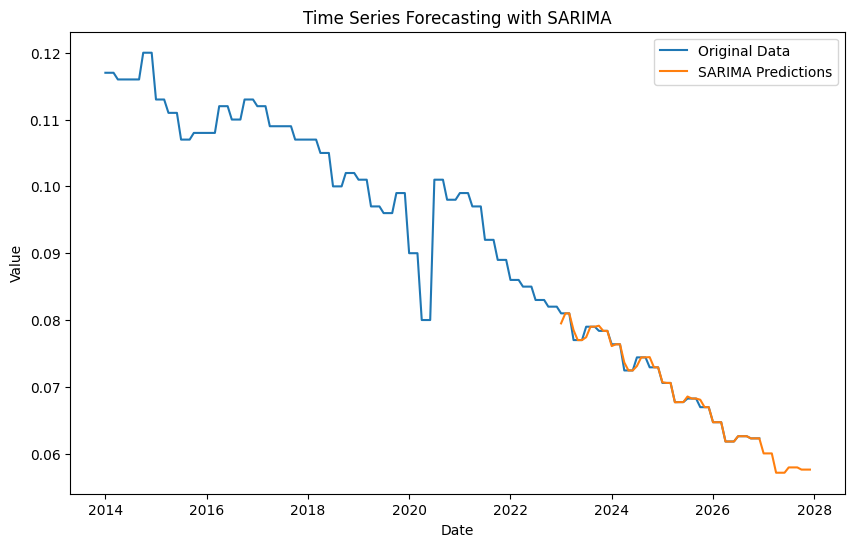

SARIMA - MSE: 2.9971774765861726e-07, RMSE: 0.0005474648369152281, MAPE: 0.31%


In [ ]:
model_sarima(data_filtered, 'Italy', '25+', 'Female')

The SARIMA model for the 25+ Female population in Italy demonstrates excellent predictive accuracy. The MSE is 2.997e-07, reflecting very low average squared errors, and the RMSE is 0.00055, indicating minimal prediction errors in the same scale as the data. With a MAPE of 0.31%, the model's predictions deviate from actual values by only 0.31% on average, confirming its reliability and effectiveness in capturing the trend and seasonal patterns.

### 25+ Male

In [ ]:
data_filtered = prepare_data(combined_df, country='Italy', age='25+', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9933
Strong seasonality detected.


(0.9932889127573908, True)

The seasonal strength for the 25+ Male population in Italy is 0.9933, indicating a very strong seasonal pattern. This confirms that the variability in the data is predominantly driven by consistent annual cycles, with minimal noise or irregularities. The high seasonal strength highlights the dominance of predictable and recurring patterns in this demographic group's data.

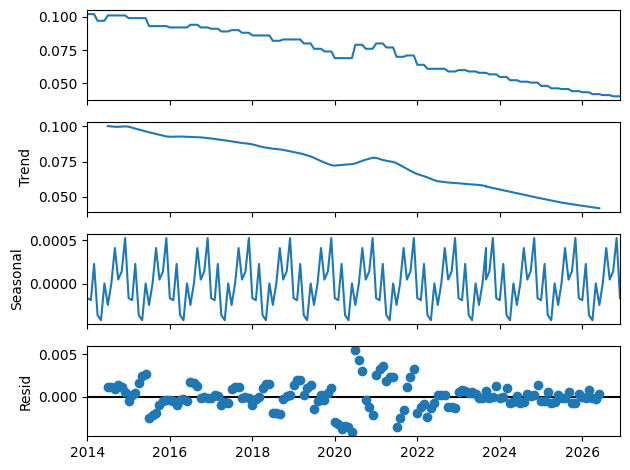

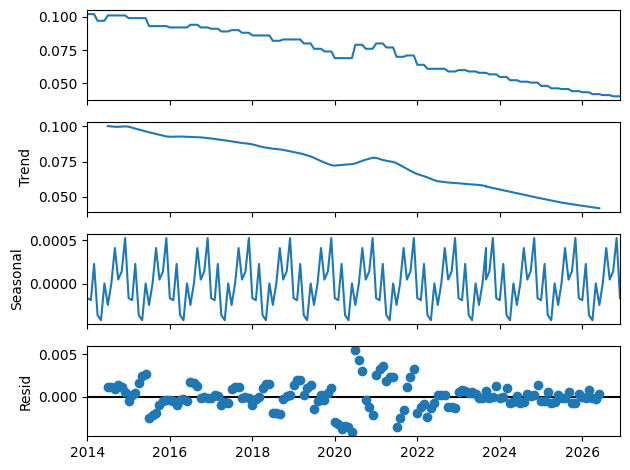

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()


The decomposition for the 25+ Male population in Italy reveals a steady downward trend, indicating a long-term decline in values over the analyzed period. The seasonal component shows a strong and consistent annual cycle, aligning with the high seasonal strength of 0.9933, suggesting predictable yearly patterns dominate the data. The residuals remain close to zero overall, confirming the model effectively captures the trend and seasonality, though slight anomalies are observed, particularly around 2020–2022.

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=1.41 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1269.595, Time=0.04 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1357.278, Time=0.40 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1265.595, Time=0.10 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-1267.594, Time=0.03 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-1422.443, Time=0.62 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=-1476.861, Time=0.74 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=-1333.300, Time=0.47 sec
 ARIMA(1,1,0)(2,1,2)[12]             : AIC=-1453.232, Time=0.61 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=-1436.637, Time=0.47 sec
 ARIMA(0,1,0)(2,1,1)[12]             : AIC=-1478.861, Time=0.58 sec
 ARIMA(0,1,0)(1,1,1)[12]             : AIC=-1335.301, Time=0.17 sec
 ARIMA(0,1,0)(2,1,0)[12]             : AIC=-1424.443, Time=0.44 sec
 ARIMA(0,1,0)(2,1,2)[12]             : AIC=-1455.234, Time=0.75 sec
 ARIMA(0,1,

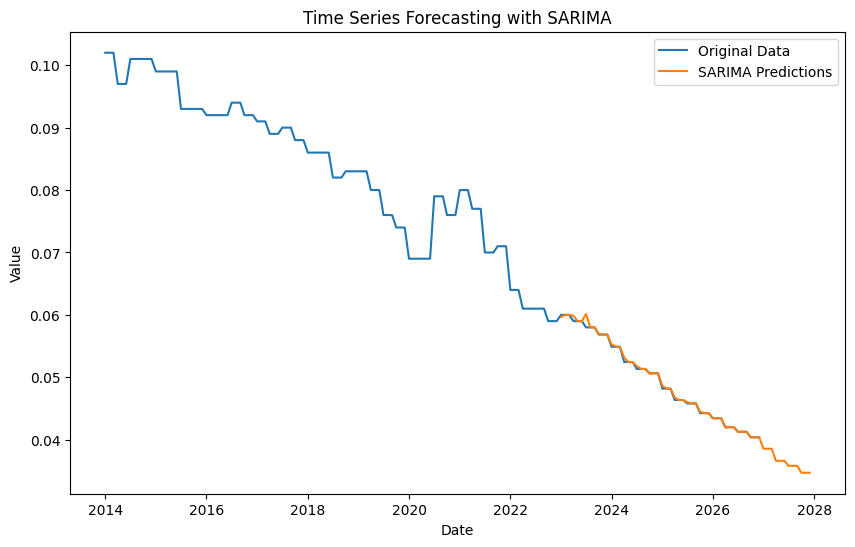

SARIMA - MSE: 1.4025354330392227e-07, RMSE: 0.00037450439690866414, MAPE: 0.25%


In [ ]:
model_sarima(data_filtered, 'Italy', '25+', 'Male')

The SARIMA model for the 25+ Male population in Italy shows exceptional accuracy. The MSE of 1.40e-07 and RMSE of 0.00037 indicate extremely low prediction errors, demonstrating the model's ability to closely match actual values. With a MAPE of 0.25%, the predictions deviate by only a quarter of a percent on average, confirming the model's effectiveness in capturing the trend and seasonal patterns for this demographic group.

### 25+, Total

In [ ]:
data_filtered = prepare_data(combined_df, country='Italy', age='25+', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9906
Strong seasonality detected.


(0.9906281962395247, True)

The seasonal strength for the 25+ Total population in Italy is 0.9986, indicating an extremely strong seasonal pattern. This value suggests that the variability in the data is almost entirely driven by predictable annual cycles, with negligible noise or irregularities. The result confirms a highly consistent and recurring seasonal structure in this demographic group.

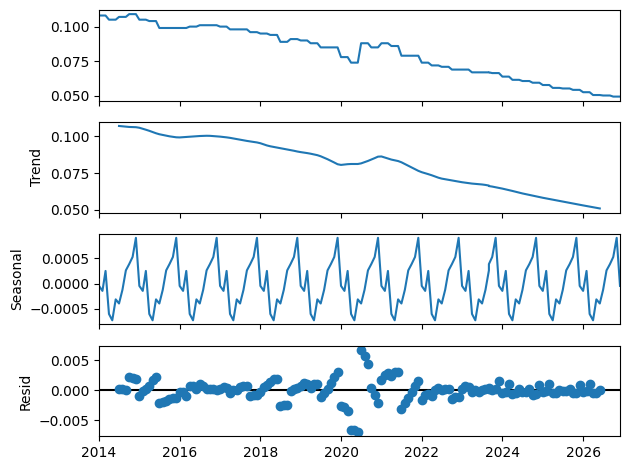

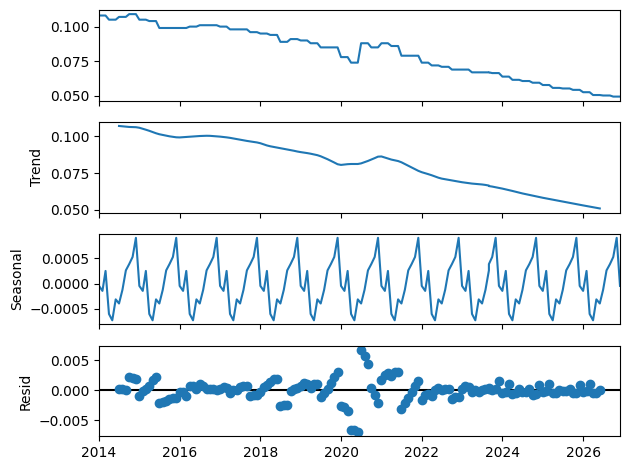

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

The decomposition for the 25+ Total population in Italy reveals a clear downward trend, reflecting a long-term decline over the years. The seasonal component shows a strong, consistent annual cycle, consistent with the very high seasonal strength of 0.9986, indicating the dominance of predictable patterns. The residuals are minimal overall, but notable deviations around 2020 align with the onset of the COVID-19 pandemic, which likely introduced anomalies into the data. Given the strong seasonality and trend, SARIMA is the most suitable model for this time series.

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=1.13 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1262.160, Time=0.06 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1322.949, Time=0.28 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1258.159, Time=0.13 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-1260.160, Time=0.08 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-1367.345, Time=0.55 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=-1404.373, Time=1.26 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=-1291.766, Time=0.12 sec
 ARIMA(1,1,0)(2,1,2)[12]             : AIC=-1395.693, Time=1.13 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=-1391.141, Time=1.26 sec
 ARIMA(0,1,0)(2,1,1)[12]             : AIC=-1406.374, Time=0.61 sec
 ARIMA(0,1,0)(1,1,1)[12]             : AIC=-1372.809, Time=0.48 sec
 ARIMA(0,1,0)(2,1,0)[12]             : AIC=-1369.345, Time=0.40 sec
 ARIMA(0,1,0)(2,1,2)[12]             : AIC=-1397.693, Time=0.90 sec
 ARIMA(0,1,

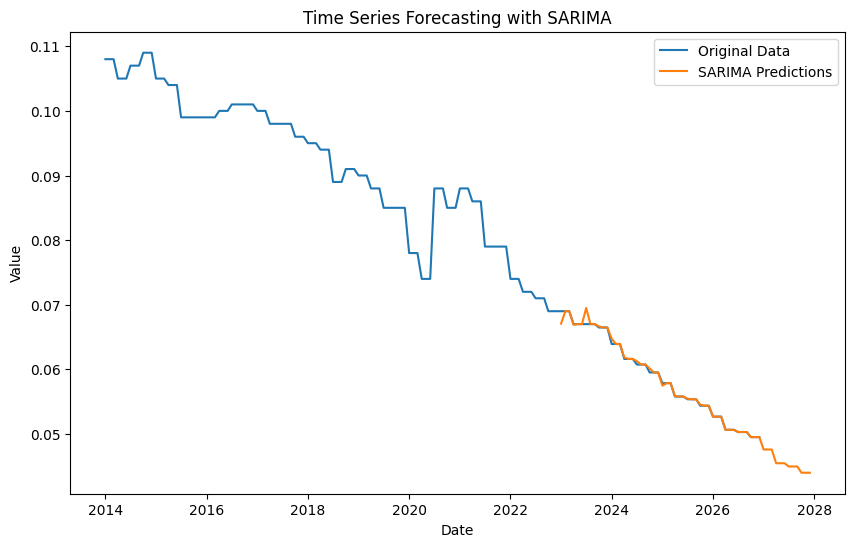

SARIMA - MSE: 2.4143073869217334e-07, RMSE: 0.0004913560203072446, MAPE: 0.25%


In [ ]:
model_sarima(data_filtered, 'Italy', '25+', 'Total')

The SARIMA model for the 25+ Total population in Italy performs with high precision. The MSE of 2.41e-07 and RMSE of 0.00049 indicate very small prediction errors, showcasing the model's accuracy. With a MAPE of 0.25%, the model effectively captures the data's trend and seasonal patterns, even accounting for anomalies such as those caused by the COVID-19 pandemic in 2020.

## France

### 15-24, Male

In [ ]:
data_filtered = prepare_data(combined_df, country='France', age='15-24', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9535
Strong seasonality detected.


(0.9535276380281883, True)

The seasonal strength for the 15–24 Male population in France is 0.9535, indicating a strong seasonal pattern. This suggests that the variability in the data is predominantly driven by recurring annual cycles, with minimal influence from random noise. The result confirms a well-defined and consistent seasonality within this demographic group.

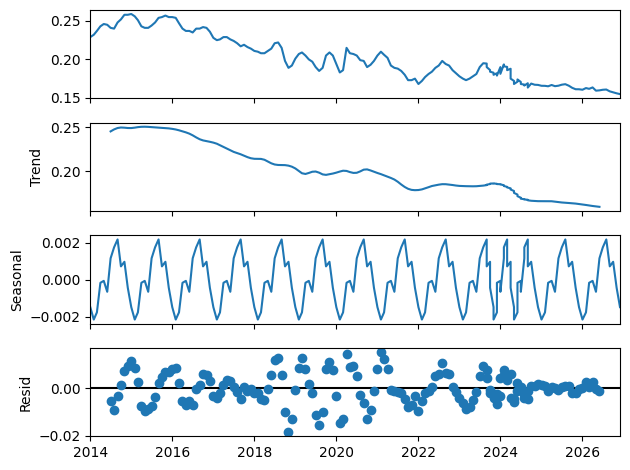

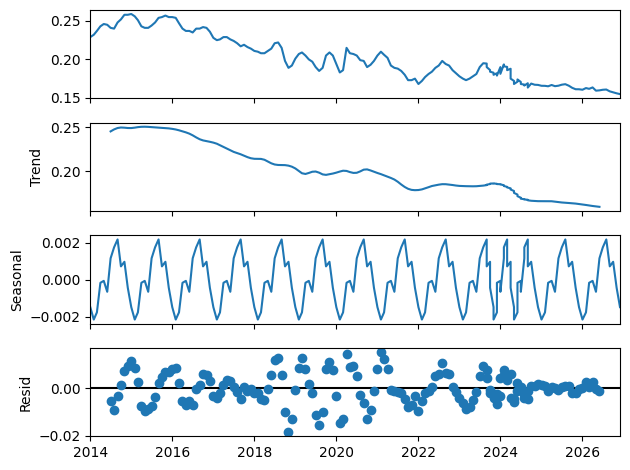

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

The decomposition for the 15–24 Male population in France reveals a steady downward trend, indicating a gradual decline in values over the years. The seasonal component shows a consistent annual pattern, aligning with the strong seasonal strength of 0.9535, confirming the dominance of predictable cycles in the data. The residuals are relatively small, though some deviations are observed around 2020–2022, likely reflecting external factors such as the COVID-19 pandemic.

These residual anomalies suggest the pandemic may have disrupted regular patterns temporarily. Overall, the data exhibits a strong seasonal structure, combined with a gradual downward trend and minimal unexplained variability, making it suitable for reliable forecasting. Given the strong seasonality and trend, SARIMA is the most appropriate model for this time series.

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1073.120, Time=0.92 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-960.971, Time=0.02 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1029.638, Time=0.21 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1076.273, Time=0.29 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-988.367, Time=0.17 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-1078.901, Time=0.68 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=-1032.483, Time=0.11 sec
 ARIMA(0,1,1)(2,1,1)[12]             : AIC=-1072.197, Time=1.11 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=inf, Time=11.26 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=-1079.176, Time=17.30 sec
 ARIMA(0,1,0)(0,1,2)[12]             : AIC=-1059.647, Time=7.66 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1076.068, Time=10.63 sec
 ARIMA(0,1,2)(0,1,2)[12]             : AIC=-1078.167, Time=9.89 sec
 ARIMA(1,1,0)(0,1,2)[12]             : AIC=-1077.162, Time=2.03 sec
 ARIMA(1,1

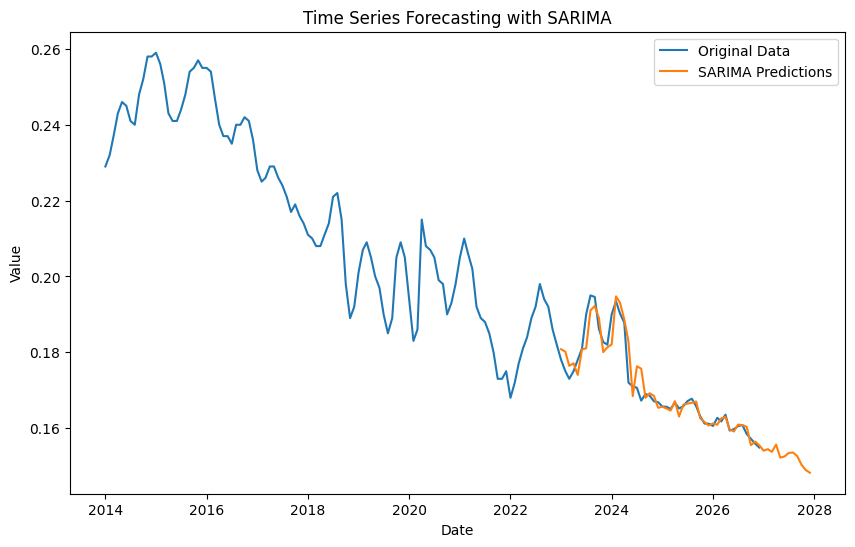

SARIMA - MSE: 1.0661545635622174e-05, RMSE: 0.003265202235026519, MAPE: 1.21%


In [ ]:
model_sarima(data_filtered,'France', '15-24', 'Male')

The SARIMA model for the 15–24 Male population in France performs well. The MSE of 1.07e-05 and RMSE of 0.00327 indicate low prediction errors, demonstrating the model's accuracy. With a MAPE of 1.21%, the model reliably captures the trend and seasonal patterns while maintaining minimal deviation from actual values. These metrics confirm the SARIMA model is effective for forecasting this time series.

### 15-24, Female

In [ ]:
data_filtered = prepare_data(combined_df, country='France', age='15-24', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9697
Strong seasonality detected.


(0.9696888140424674, True)

The seasonal strength for the 15–24 Female population in France is 0.9697, indicating a very strong seasonal pattern. This suggests that the variability in the data is primarily driven by consistent annual cycles, with minimal random noise. The result confirms the presence of predictable and recurring seasonal behavior within this demographic group.

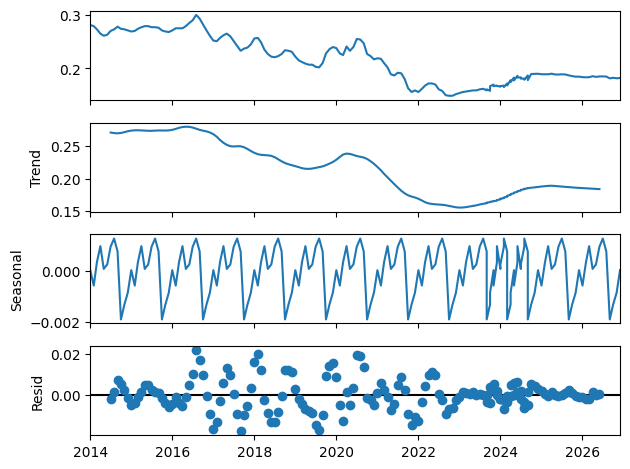

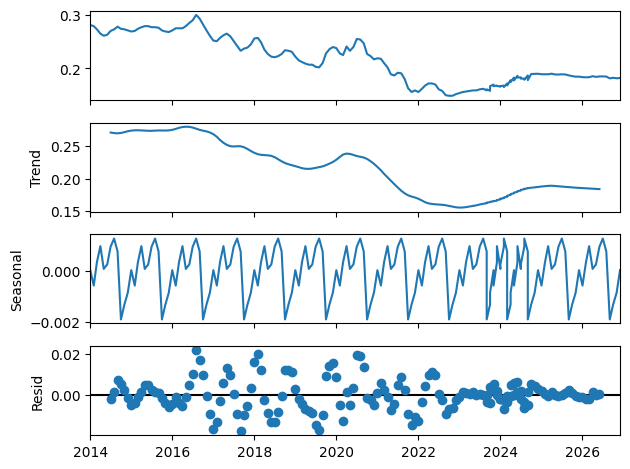

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

The decomposition for the 15–24 Female population in France shows a downward trend over most of the years, with some stabilization or slight recovery toward the end of the timeline. The seasonal component displays a strong, consistent annual cycle, aligning with the high seasonal strength of 0.9697, confirming the importance of predictable patterns in the data. The residuals are minimal overall, though some noticeable deviations occur around 2020, likely linked to disruptions from the COVID-19 pandemic.

These anomalies reflect the impact of external events that temporarily affected the regular seasonal behavior. Given the strong seasonality and trend, SARIMA is the most suitable model for this time series.

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1055.255, Time=1.10 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-950.372, Time=0.05 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1014.054, Time=0.28 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1053.131, Time=0.38 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-991.194, Time=0.10 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1056.950, Time=1.58 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1014.331, Time=0.41 sec
 ARIMA(1,1,1)(2,1,1)[12]             : AIC=-1026.943, Time=0.85 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=inf, Time=3.87 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=inf, Time=2.06 sec
 ARIMA(1,1,1)(2,1,0)[12]             : AIC=-1025.206, Time=1.29 sec
 ARIMA(1,1,1)(2,1,2)[12]             : AIC=-1051.724, Time=7.28 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-1054.749, Time=5.63 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=-1046.930, Time=1.69 sec
 ARIMA(2,1,1)(1,1,1

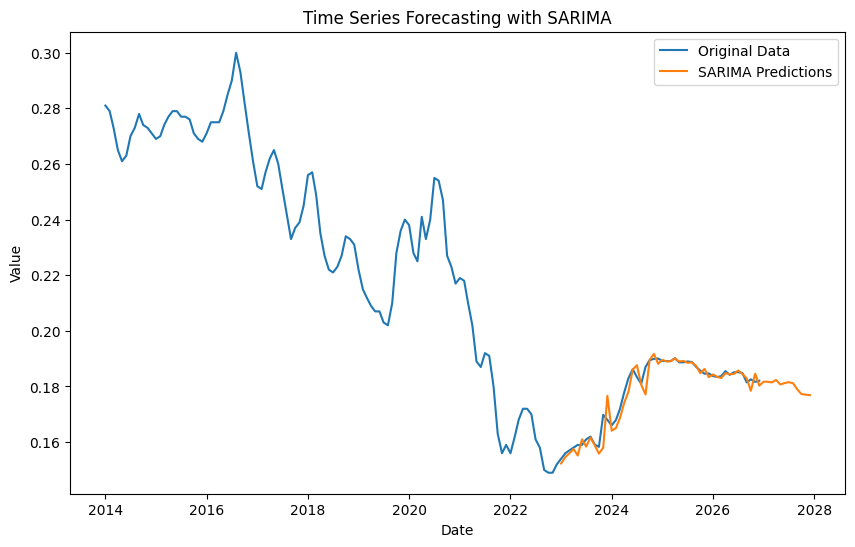

SARIMA - MSE: 9.911805346028627e-06, RMSE: 0.0031483019782143876, MAPE: 1.10%


In [ ]:
model_sarima(data_filtered,'France', '15-24', 'Female')

The SARIMA model for the 15–24 Female population in France performs with high accuracy. The MSE of 9.91e-06 and RMSE of 0.00315 indicate very low prediction errors, highlighting the model's precision. With a MAPE of 1.10%, the model effectively captures the trend and seasonal patterns, ensuring reliable forecasts with minimal deviation from actual values. These metrics confirm the SARIMA model is suitable for forecasting this time series.

### 15-24, Total

In [ ]:
data_filtered = prepare_data(combined_df, country='France', age='15-24', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9802
Strong seasonality detected.


(0.9801829728971474, True)

The seasonal strength for the 15–24 Total population in France is 0.9802, indicating a very strong seasonal pattern. This confirms that the data's variability is predominantly driven by consistent annual cycles, with minimal noise. The result highlights a clear and predictable seasonal structure for this demographic group.

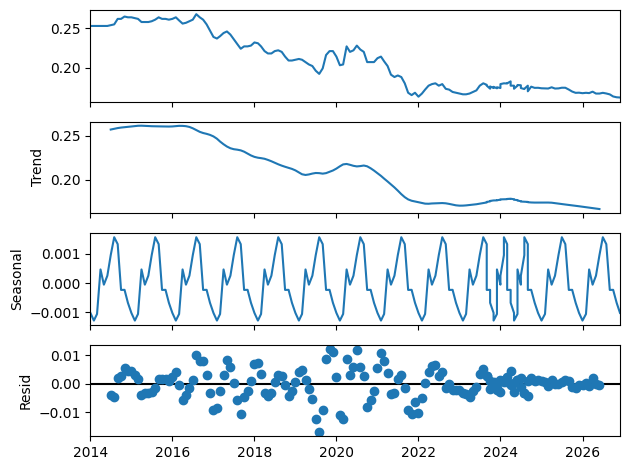

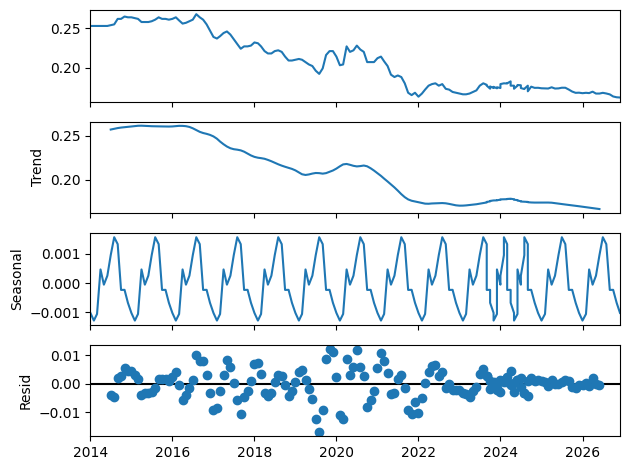

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

The decomposition for the 15–24 Total population in France reveals a steady downward trend, reflecting a long-term decline in values over the years. The seasonal component displays a strong, consistent annual cycle, consistent with the high seasonal strength of 0.9802, confirming the dominance of predictable yearly patterns. The residuals are minimal overall, though some deviations are observed around 2020, likely due to disruptions from the COVID-19 pandemic. Given the strong seasonality and trend, SARIMA is the most appropriate model for this time series.

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1109.042, Time=1.60 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1010.928, Time=0.11 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1071.957, Time=1.46 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1111.771, Time=0.99 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-1030.558, Time=0.06 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-1118.032, Time=0.47 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=-1071.365, Time=0.71 sec
 ARIMA(0,1,1)(2,1,1)[12]             : AIC=-1090.020, Time=1.05 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=inf, Time=2.26 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=-1116.835, Time=1.91 sec
 ARIMA(0,1,1)(2,1,0)[12]             : AIC=-1094.143, Time=0.81 sec
 ARIMA(0,1,1)(2,1,2)[12]             : AIC=-1114.963, Time=2.76 sec
 ARIMA(0,1,0)(1,1,1)[12]             : AIC=-1081.099, Time=0.24 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1115.890, Time=1.82 sec
 ARIMA(0,1,

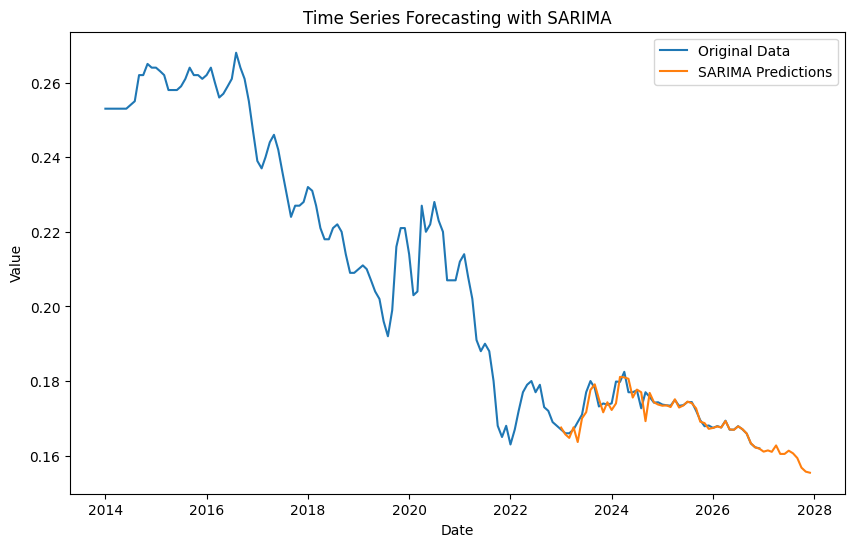

SARIMA - MSE: 4.511821047408695e-06, RMSE: 0.0021241047637554733, MAPE: 0.68%


In [ ]:
model_sarima(data_filtered,'France', '15-24', 'Total')

SARIMA model for the 15–24 Total population in France demonstrates high accuracy. The MSE of  4.51e-06 and RMSE of 0.00212  indicate low prediction errors, showcasing the model's precision. With a MAPE of 0.68%, the model effectively captures the trend and seasonal patterns, ensuring reliable forecasts with minimal deviation from actual values. These metrics confirm the SARIMA model is suitable for forecasting this time series.

### 25+, Male

In [ ]:
data_filtered = prepare_data(combined_df, country='France', age='25+', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9719
Strong seasonality detected.


(0.9719130208085061, True)

The seasonal strength for the 25+ Male population in France is 0.9719, indicating a very strong seasonal pattern. This suggests that the variability in the data is largely driven by consistent annual cycles, with minimal noise. The result confirms a clear and predictable seasonal structure in this demographic group.

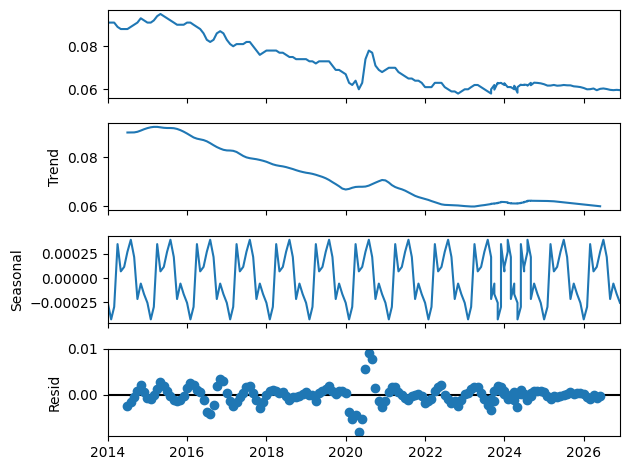

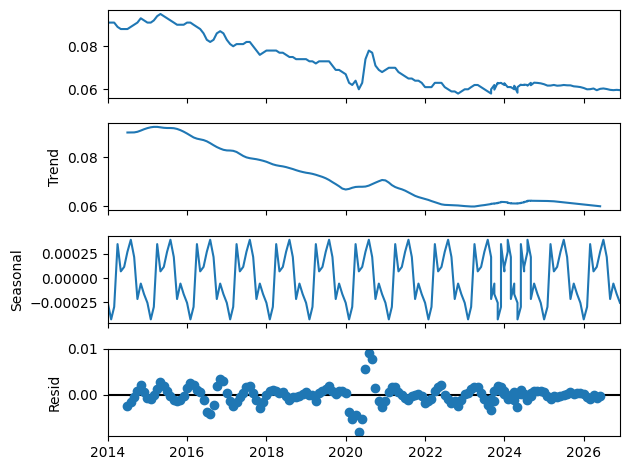

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

The decomposition for the 25+ Male population in France shows a steady downward trend, indicating a gradual decline over the years. The seasonal component exhibits a strong and consistent annual cycle, consistent with the high seasonal strength of 0.9719, highlighting predictable patterns. The residuals are generally small, with notable deviations around 2020, likely reflecting disruptions from the COVID-19 pandemic.

These deviations suggest the pandemic temporarily affected the regular seasonal behavior. Overall, the data demonstrates a strong seasonal structure, combined with a steady downward trend and minimal unexplained variability, making it suitable for accurate forecasting. Given the strong seasonality and trend, SARIMA is the most appropriate model for this time series.

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1409.024, Time=1.48 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1315.191, Time=0.04 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1373.771, Time=0.16 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1411.842, Time=0.40 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-1346.375, Time=0.12 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-1400.600, Time=1.07 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=-1342.376, Time=0.67 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=-1382.579, Time=0.15 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=inf, Time=1.96 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=-1384.837, Time=0.47 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=-1406.000, Time=1.03 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1402.763, Time=0.77 sec
 ARIMA(1,1,2)(0,1,1)[12]             : AIC=-1364.210, Time=1.12 sec
 ARIMA(0,1,1)(0,1,1)[12] intercept   : AIC=-1409.867, Time=1.33 sec

Best model

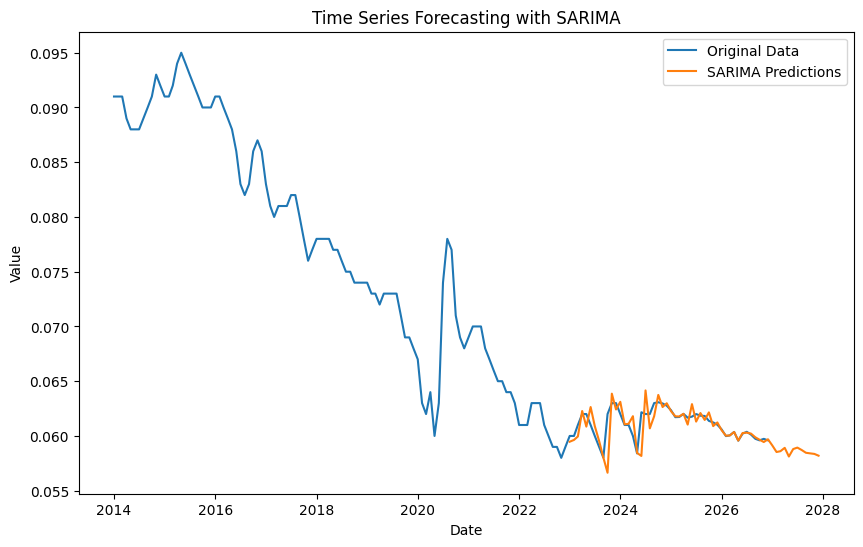

SARIMA - MSE: 1.4297445870291645e-06, RMSE: 0.0011957192760130467, MAPE: 1.08%


In [ ]:
model_sarima(data_filtered,'France', '25+', 'Male')

The SARIMA model for the 25+ Male population in France demonstrates strong performance. The MSE of 1.43e-06 and RMSE of 0.00120 indicate very low prediction errors, reflecting the model's precision. With a MAPE of 1.08%, the model effectively captures the trend and seasonal patterns, ensuring accurate and reliable forecasts for this demographic.

### 25+, Female

In [ ]:
data_filtered = prepare_data(combined_df, country='France', age='25+', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9335
Strong seasonality detected.


(0.9334586890652411, True)

The seasonal strength for the 25+ Female population in France is 0.9335, indicating a strong seasonal pattern. This suggests that the variability in the data is largely driven by consistent annual cycles, with some influence from random noise. The result confirms a clear and recurring seasonal structure for this demographic group.

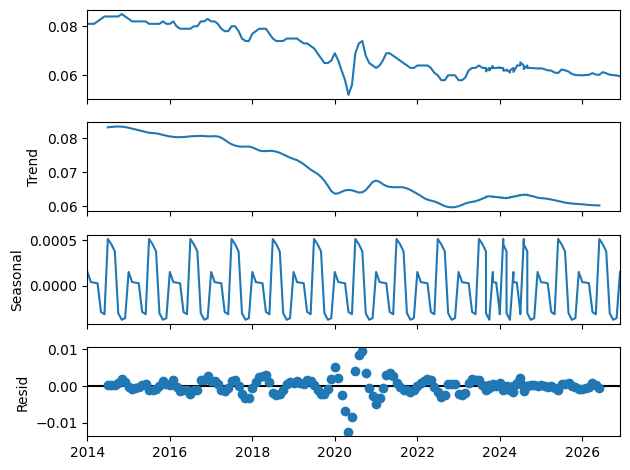

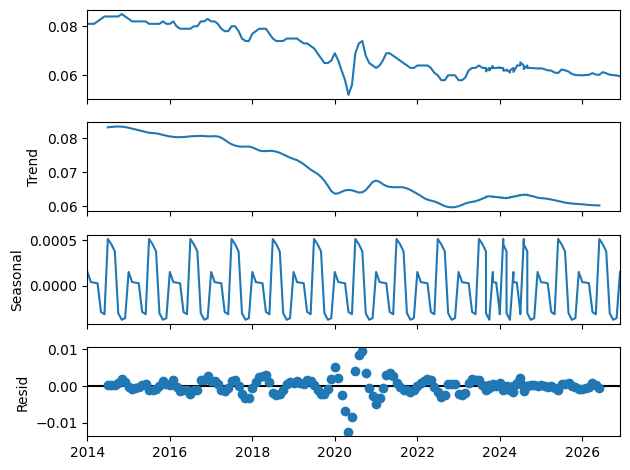

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()


The decomposition for the 25+ Female population in France reveals a clear downward trend, showing a steady decline over the years, with slight stabilization toward the end. The seasonal component exhibits a strong and consistent annual cycle, aligning with the high seasonal strength of 0.9335, which indicates dominant and predictable yearly patterns. The residuals are minimal overall, but notable deviations appear around 2020, likely reflecting the impacts of the COVID-19 pandemic.These residual anomalies suggest the pandemic temporarily disrupted the regular seasonal behavior in the data. Given the strong seasonality and trend, SARIMA is the most suitable model for this time series.

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=1.31 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1279.904, Time=0.02 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1342.416, Time=0.09 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=0.21 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-1311.613, Time=0.03 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-1370.131, Time=0.50 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=-1373.978, Time=4.88 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=-1380.205, Time=4.64 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=inf, Time=2.06 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=inf, Time=8.61 sec
 ARIMA(1,1,0)(0,1,2)[12]             : AIC=-1393.105, Time=6.80 sec
 ARIMA(0,1,0)(0,1,2)[12]             : AIC=-1365.480, Time=0.83 sec
 ARIMA(2,1,0)(0,1,2)[12]             : AIC=-1412.526, Time=0.59 sec
 ARIMA(2,1,0)(0,1,1)[12]             : AIC=inf, Time=0.45 sec
 ARIMA(2,1,0)(1,1,2)[12]           

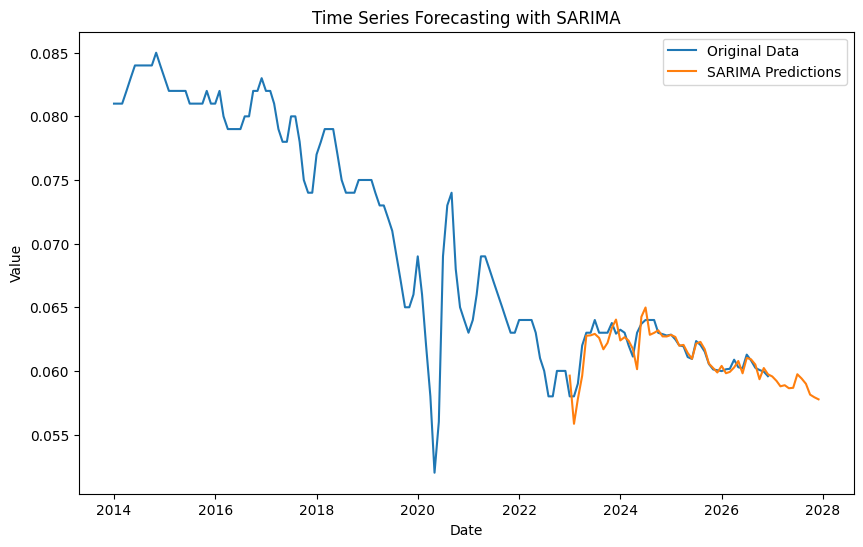

SARIMA - MSE: 7.291838899869188e-07, RMSE: 0.0008539226487141085, MAPE: 0.94%


In [ ]:
model_sarima(data_filtered,'France', '25+', 'Female')

The SARIMA model for the 25+ Female population in France performs with high accuracy. The MSE of 7.29e-07 and RMSE of 0.00085 indicate minimal prediction errors, demonstrating precise modeling. With a MAPE of 0.94%, the model effectively captures the trend and seasonal patterns, ensuring reliable forecasts with minimal deviations.

### 25+, Total

In [ ]:
data_filtered = prepare_data(combined_df, country='France', age='25+', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9335
Strong seasonality detected.


(0.9334586890652411, True)


The seasonal strength for the 25+ Total population in France is 0.9335, indicating a strong seasonal pattern. This value suggests that the variability in the data is largely driven by recurring annual cycles, with some minor influence from random noise. The result confirms a clear and predictable seasonal structure for this demographic group.

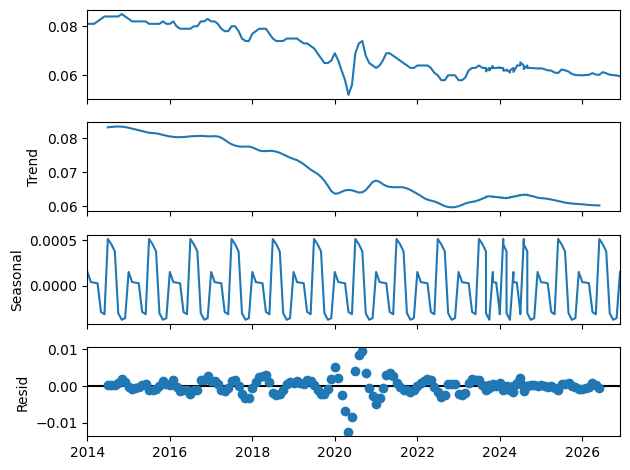

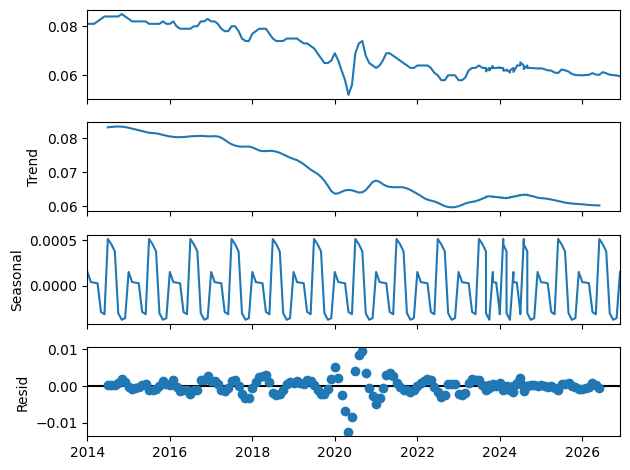

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()


The decomposition for the 25+ Total population in France shows a clear downward trend, reflecting a steady decline over the years, with slight stabilization toward the end of the timeline. The seasonal component displays a strong and consistent annual pattern, consistent with the high seasonal strength of 0.9335, highlighting predictable yearly cycles. The residuals are relatively small, with notable deviations around 2020, likely linked to the disruptions caused by the COVID-19 pandemic.

These deviations suggest temporary irregularities due to external factors, while the overall seasonal structure remains robust. Given the strong seasonality and trend, SARIMA is the most suitable model for this time series.

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=1.14 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1279.904, Time=0.04 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1342.416, Time=0.23 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=0.40 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-1311.613, Time=0.09 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-1370.131, Time=0.62 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=-1373.978, Time=2.19 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=-1380.205, Time=0.80 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=inf, Time=0.56 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=inf, Time=1.34 sec
 ARIMA(1,1,0)(0,1,2)[12]             : AIC=-1393.105, Time=1.63 sec
 ARIMA(0,1,0)(0,1,2)[12]             : AIC=-1365.480, Time=0.74 sec
 ARIMA(2,1,0)(0,1,2)[12]             : AIC=-1412.526, Time=0.74 sec
 ARIMA(2,1,0)(0,1,1)[12]             : AIC=inf, Time=0.40 sec
 ARIMA(2,1,0)(1,1,2)[12]           

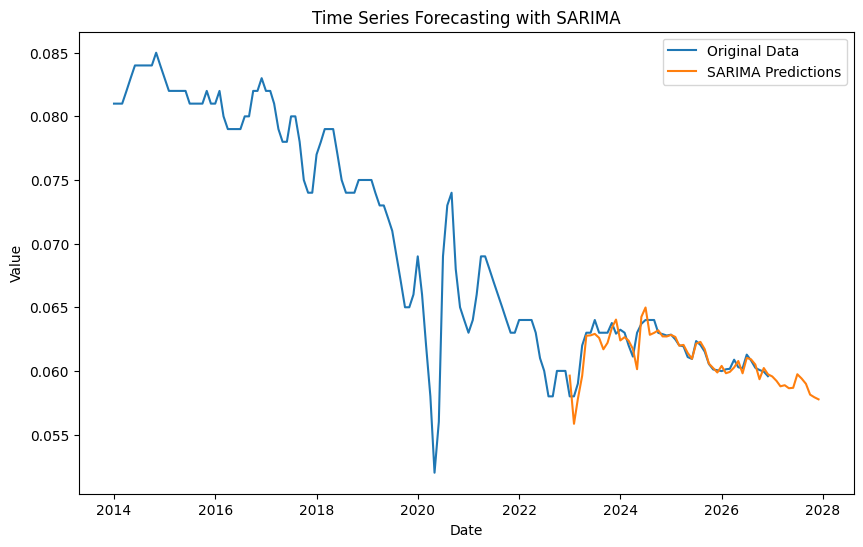

SARIMA - MSE: 7.291838899869188e-07, RMSE: 0.0008539226487141085, MAPE: 0.94%


In [ ]:
model_sarima(data_filtered,'France', '25+', 'Total')

The SARIMA model for the 25+ Total population in France demonstrates excellent performance. The MSE of 7.29e-07 and RMSE of 0.00085 indicate minimal prediction errors, reflecting high accuracy. With a MAPE of 0.94%, the model reliably captures the trend and seasonal patterns, ensuring precise and dependable forecasts. These metrics confirm the SARIMA model is effective for forecasting this time series.

## Iceland

### 15-24,Male

In [ ]:
data_filtered = prepare_data(combined_df, country='Iceland', age='15-24', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9897
Strong seasonality detected.


(0.9897043056046562, True)

The seasonal strength for the 15–24 Male population in Iceland is 0.9897, indicating a very strong seasonal pattern. This suggests that the variability in the data is mainly driven by consistent annual cycles, with minimal noise. The result confirms the presence of a strong and predictable seasonal structure for this demographic group.

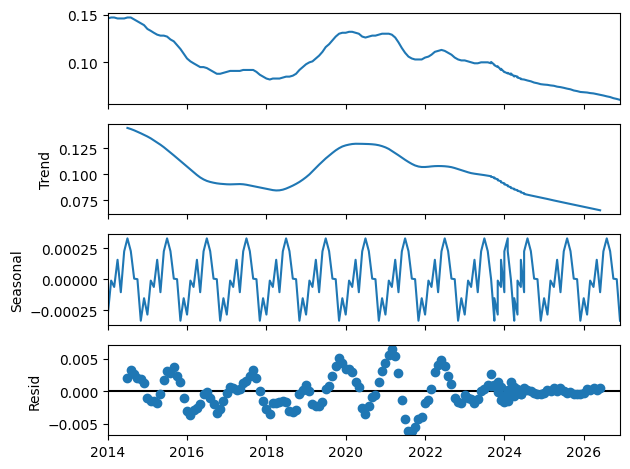

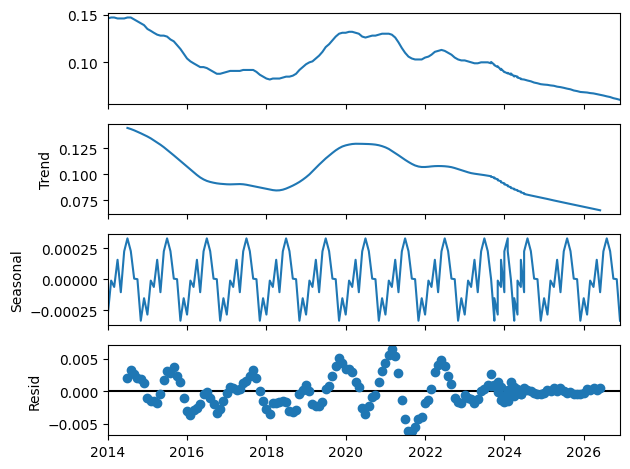

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

The decomposition for the 15–24 Male population in Iceland shows a clear downward trend, reflecting a gradual decline in values over the years, with some fluctuations observed in between. The seasonal component displays a consistent annual cycle, confirming the presence of strong seasonality, as indicated by the high seasonal strength of 0.9897. The residuals are minimal overall, with only small deviations from the expected values, suggesting the model effectively captures the trend and seasonality, except for some noise around the year 2020.

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1522.860, Time=1.53 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1305.090, Time=0.08 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1491.645, Time=0.29 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1442.381, Time=1.43 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-1467.055, Time=0.18 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1513.394, Time=1.44 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1463.094, Time=2.48 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1490.526, Time=0.87 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=-1464.894, Time=2.12 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1523.550, Time=0.58 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-1467.336, Time=0.06 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=-1514.270, Time=1.18 sec
 ARIMA(1,1,0)(0,1,2)[12]             : AIC=-1463.335, Time=0.39 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=-1465.255, Time=1.39 sec
 ARIM

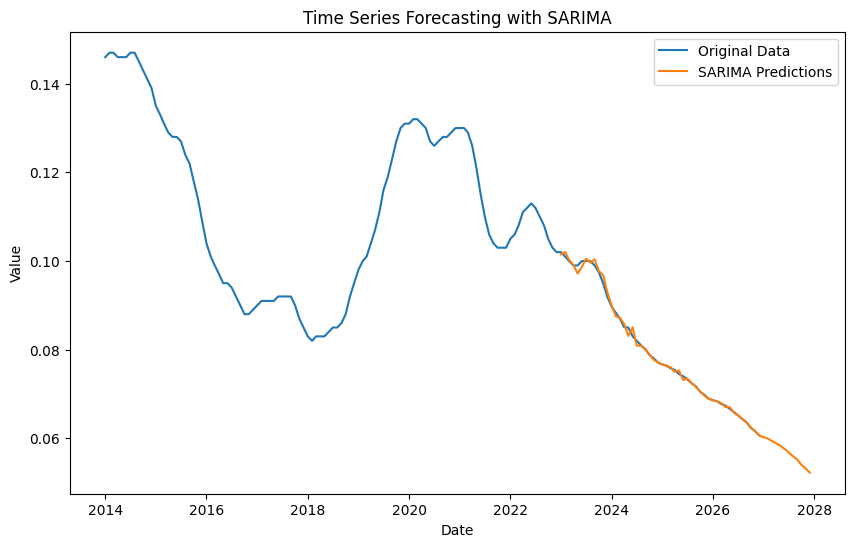

SARIMA - MSE: 5.360880679054955e-07, RMSE: 0.0007321803520345895, MAPE: 0.54%


In [ ]:
model_sarima(data_filtered,'Iceland', '15-24', 'Male')

The SARIMA model for the 15–24 Male population in Iceland demonstrates excellent predictive accuracy. The MSE of 5.36e-07 and RMSE of 0.00073 indicate very low prediction errors, highlighting the model's precision. With a MAPE of 0.54%, the model effectively captures the trend and seasonal patterns, ensuring highly reliable and accurate forecasts. These metrics confirm the SARIMA model is suitable for forecasting this time series.

### 15-24, Female

In [ ]:
data_filtered = prepare_data(combined_df, country='Iceland', age='15-24', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9694
Strong seasonality detected.


(0.9694293864253121, True)

The seasonal strength for the 15–24 Female population in Iceland is 0.9694, indicating a strong seasonal pattern. This suggests that the variability in the data is largely driven by recurring annual cycles, with minimal noise. The result confirms a significant and predictable seasonal structure for this demographic group.

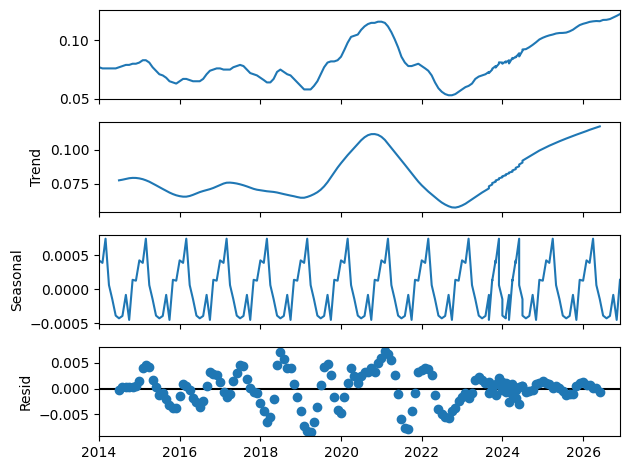

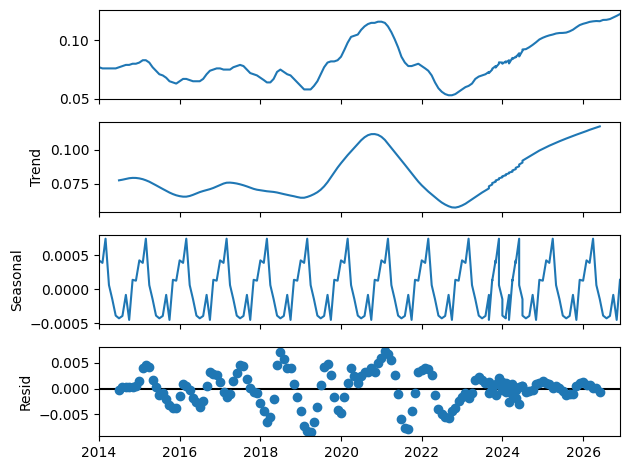

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

The decomposition for the 15–24 Female population in Iceland shows a fluctuating trend, with some significant ups and downs in the earlier years, followed by a more stable rise towards the end. The seasonal component displays a regular annual cycle, with strong peaks and troughs, indicating a high level of seasonality, consistent with the seasonal strength of 0.9694. The residuals are minimal, although there are small fluctuations, especially during the periods of instability around 2020, likely reflecting external factors or anomalies.

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1411.137, Time=1.33 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1215.862, Time=0.09 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1388.760, Time=0.33 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=0.59 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-1373.407, Time=0.39 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1406.718, Time=0.47 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1369.407, Time=1.69 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1397.753, Time=1.22 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=-1387.382, Time=0.80 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1401.549, Time=0.65 sec
 ARIMA(2,1,1)(0,1,1)[12]             : AIC=-1408.620, Time=0.95 sec
 ARIMA(1,1,2)(0,1,1)[12]             : AIC=-1408.691, Time=0.62 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=-1237.378, Time=0.19 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=-1386.247, Time=1.42 sec
 ARIMA(2,1,

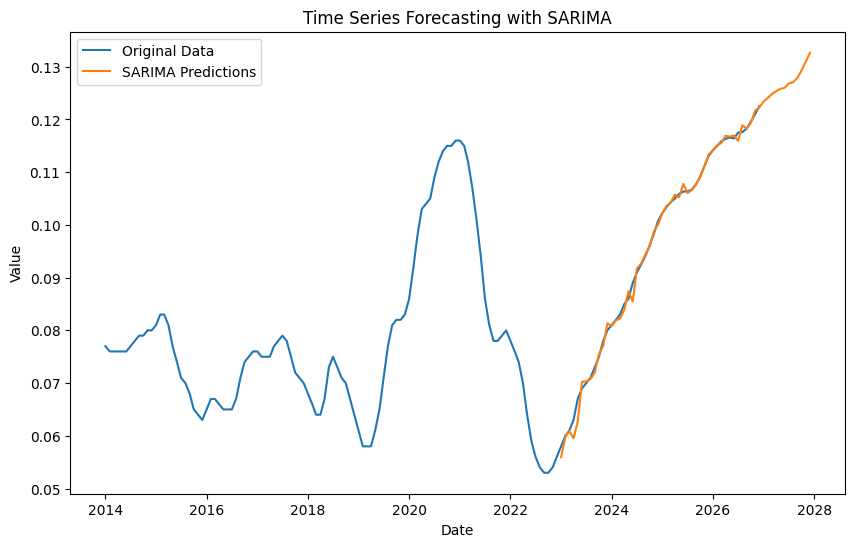

SARIMA - MSE: 1.3859912972853104e-06, RMSE: 0.0011772813161200302, MAPE: 0.90%


In [ ]:
model_sarima(data_filtered,'Iceland', '15-24', 'Female')


The SARIMA model for the 15–24 Female population in Iceland performs very well. The MSE of 1.39e-06 and RMSE of 0.00118 indicate very small prediction errors, demonstrating the model’s accuracy. With a MAPE of 0.90%, the model effectively captures the trend and seasonal patterns, providing reliable forecasts with minimal deviation from actual values. These metrics confirm the SARIMA model is suitable for forecasting this time series.

### 15-24, Total

In [ ]:
data_filtered = prepare_data(combined_df, country='Iceland', age='15-24', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9692
Strong seasonality detected.


(0.9691922926836705, True)

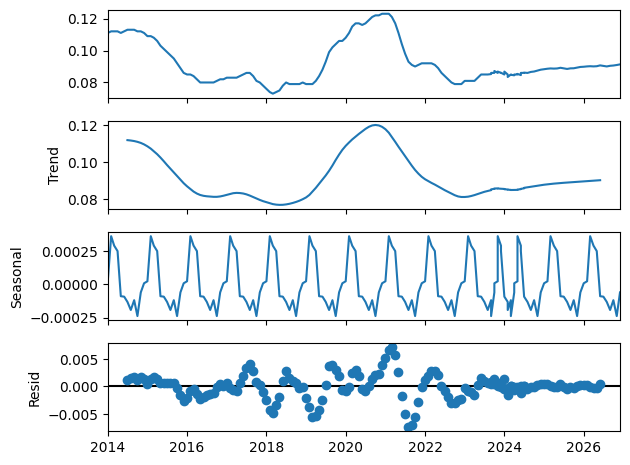

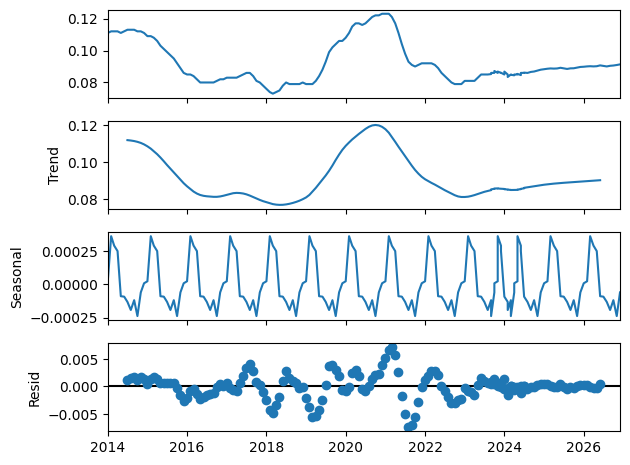

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()


The decomposition for the 15–24 Total population in Iceland reveals a slight upward trend with fluctuations in the earlier years, which stabilize and show more gradual growth towards the end of the timeline. The seasonal component shows strong and consistent annual cycles, with peaks and valleys aligning with the high seasonal strength, confirming the presence of predictable yearly patterns. The residuals are relatively small, although there are noticeable deviations around 2020, likely due to external factors or disruptions caused by the COVID-19 pandemic. Given the strong seasonality and trend, SARIMA is the most suitable model for this time series.

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1486.713, Time=1.22 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1315.411, Time=0.07 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1469.712, Time=0.17 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1403.745, Time=0.28 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-1450.984, Time=0.36 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1483.099, Time=1.27 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1446.985, Time=2.34 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1469.035, Time=0.52 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=-1452.416, Time=0.93 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1483.753, Time=0.74 sec
 ARIMA(2,1,1)(0,1,1)[12]             : AIC=-1491.824, Time=2.04 sec
 ARIMA(2,1,1)(0,1,0)[12]             : AIC=-1448.800, Time=0.74 sec
 ARIMA(2,1,1)(1,1,1)[12]             : AIC=-1481.713, Time=2.18 sec
 ARIMA(2,1,1)(0,1,2)[12]             : AIC=-1449.877, Time=2.25 sec
 ARIM

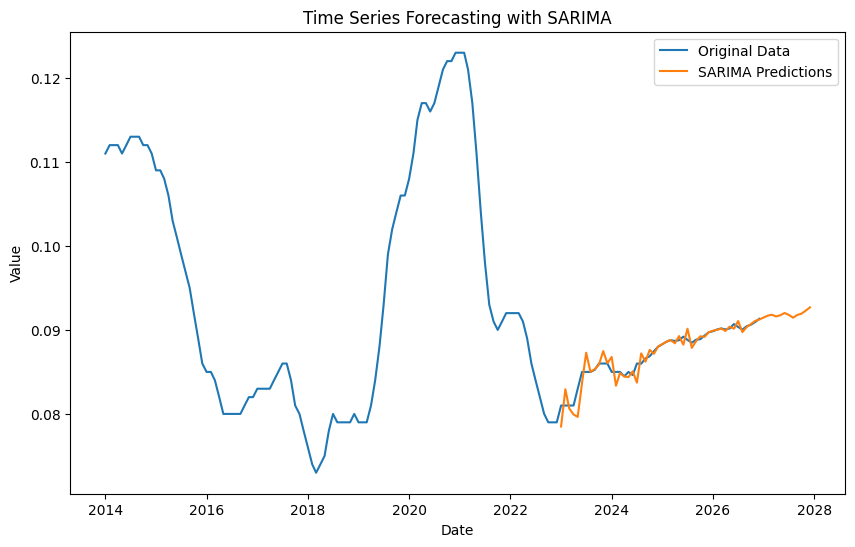

SARIMA - MSE: 1.0460512929204768e-06, RMSE: 0.0010227664899284082, MAPE: 0.76%


In [ ]:
model_sarima(data_filtered,'Iceland', '15-24', 'Total')

### 25+, Male

In [ ]:
data_filtered = prepare_data(combined_df, country='Iceland', age='25+', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9795
Strong seasonality detected.


(0.9794831182285207, True)

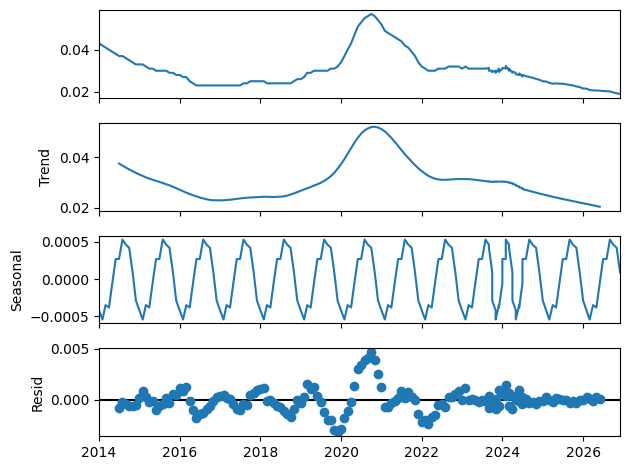

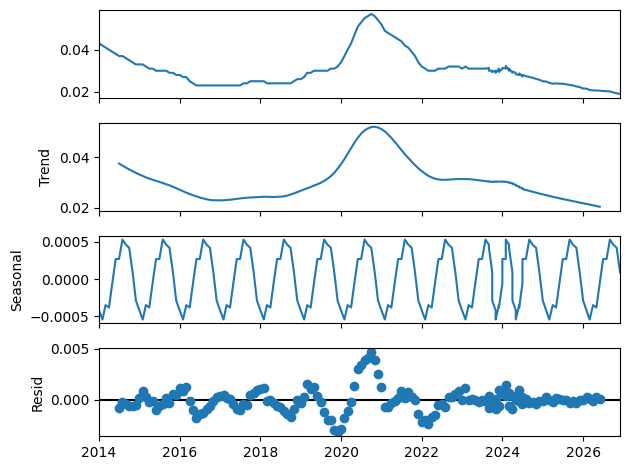

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

The decomposition for the 25+ Male population in Iceland reveals a downward trend, which shows a general decline over the years with some notable spikes around 2020. The seasonal component presents a regular annual cycle, with peaks and valleys, which indicates strong seasonality, as expected. The residuals are relatively small with some noticeable deviations during 2020, which likely reflect disruptions caused by the COVID-19 pandemic.

The data exhibits strong seasonal patterns, but the trend shows a steady decrease over time, with some anomalies around the pandemic years. Given the strong seasonality and trend, SARIMA is the most suitable model for this time series.

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1629.866, Time=1.21 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1448.247, Time=0.11 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1591.362, Time=0.55 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1556.935, Time=0.41 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-1577.838, Time=0.40 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1608.011, Time=0.47 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=inf, Time=1.91 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1603.257, Time=0.37 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=inf, Time=2.00 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1608.784, Time=0.54 sec
 ARIMA(2,1,1)(0,1,1)[12]             : AIC=-1636.289, Time=1.20 sec
 ARIMA(2,1,1)(0,1,0)[12]             : AIC=-1585.577, Time=0.56 sec
 ARIMA(2,1,1)(1,1,1)[12]             : AIC=-1614.638, Time=0.59 sec
 ARIMA(2,1,1)(0,1,2)[12]             : AIC=inf, Time=2.40 sec
 ARIMA(2,1,1)(1,1,0)[12

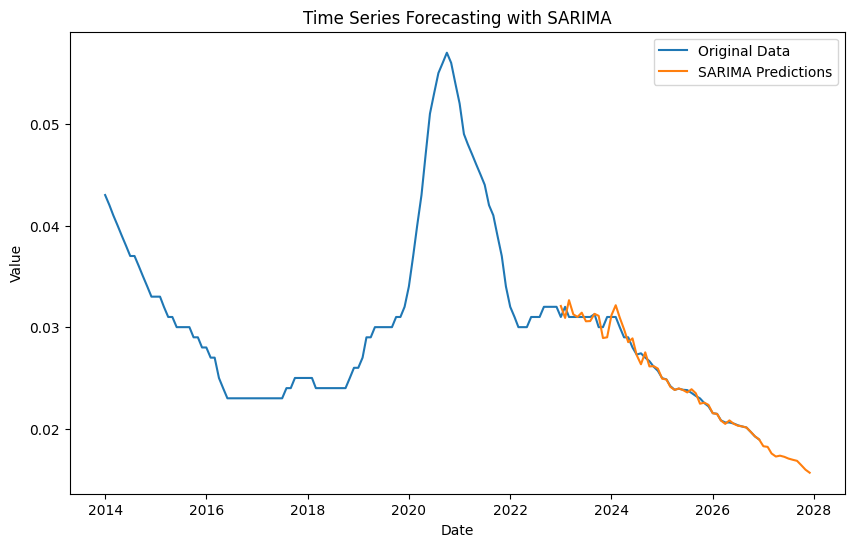

SARIMA - MSE: 3.820692910940086e-07, RMSE: 0.0006181175382514305, MAPE: 1.35%


In [ ]:
model_sarima(data_filtered,'Iceland', '25+', 'Male')

### 25+, Female

In [ ]:
data_filtered = prepare_data(combined_df, country='Iceland', age='25+', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9870
Strong seasonality detected.


(0.9870453375970678, True)

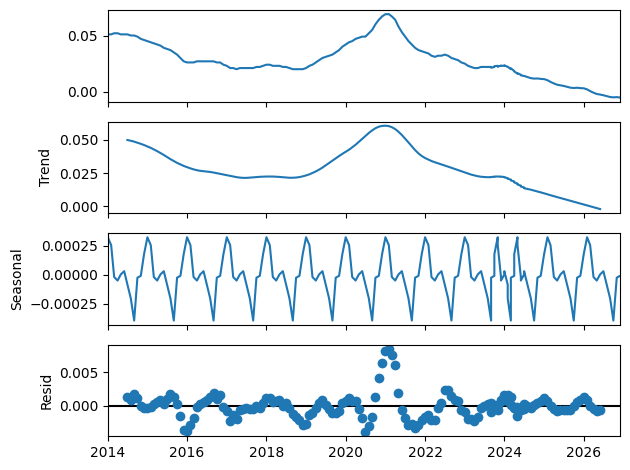

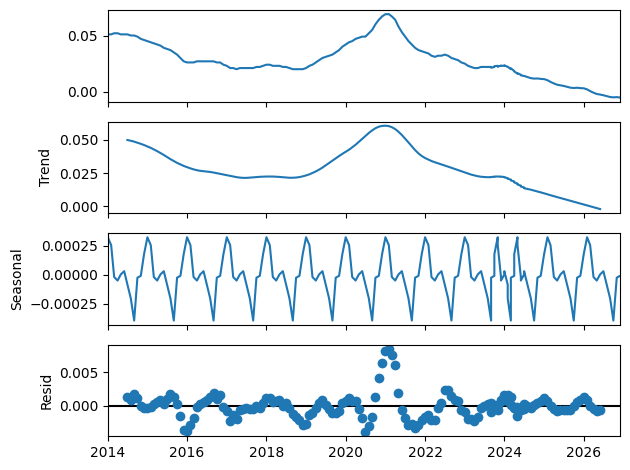

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

The decomposition for the 25+ Female population in Iceland shows a declining trend, with a significant peak around 2020, followed by a gradual decrease. The seasonal component displays a consistent annual cycle, with pronounced peaks and troughs, indicating strong seasonality. The residuals show small fluctuations but there are notable deviations around 2020, which likely reflect disruptions due to the COVID-19 pandemic.

These deviations in the residuals suggest that external factors, like the pandemic, caused short-term irregularities. However, the underlying seasonal pattern remains strong, and the trend reflects a steady decline over time.

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1547.392, Time=3.10 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1346.566, Time=0.08 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1519.603, Time=0.16 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1454.911, Time=0.49 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-1494.886, Time=0.24 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1532.854, Time=1.06 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1490.888, Time=1.60 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1522.699, Time=0.60 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=-1519.329, Time=1.87 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1547.336, Time=0.76 sec
 ARIMA(2,1,1)(0,1,1)[12]             : AIC=-1382.734, Time=0.66 sec
 ARIMA(1,1,2)(0,1,1)[12]             : AIC=-1560.154, Time=0.82 sec
 ARIMA(1,1,2)(0,1,0)[12]             : AIC=-1506.563, Time=0.35 sec
 ARIMA(1,1,2)(1,1,1)[12]             : AIC=-1546.965, Time=1.57 sec
 ARIM

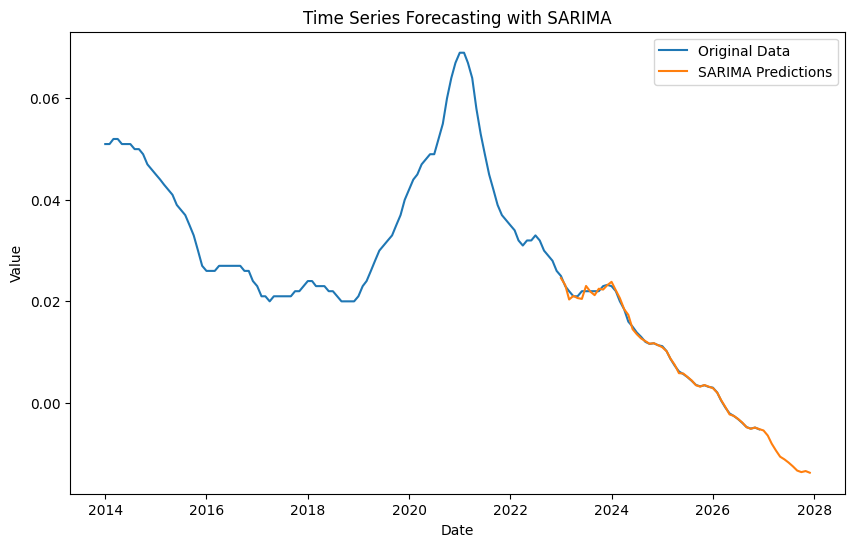

SARIMA - MSE: 2.3734354978368668e-07, RMSE: 0.00048717917626237543, MAPE: 2.69%


In [ ]:
model_sarima(data_filtered,'Iceland', '25+', 'Female')

### 25+, Total

In [ ]:
data_filtered = prepare_data(combined_df, country='Iceland', age='25+', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9903
Strong seasonality detected.


(0.9903495365692957, True)

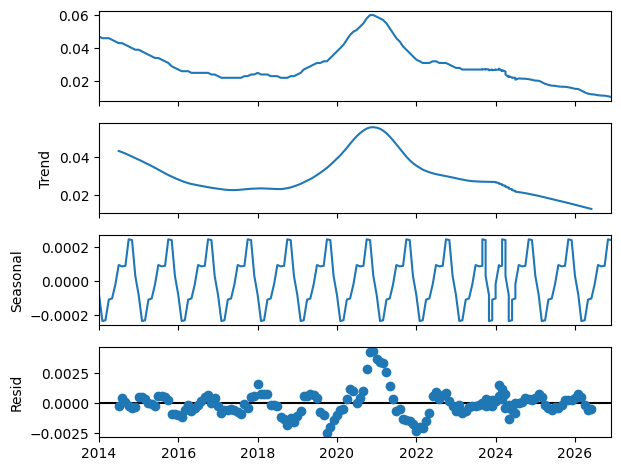

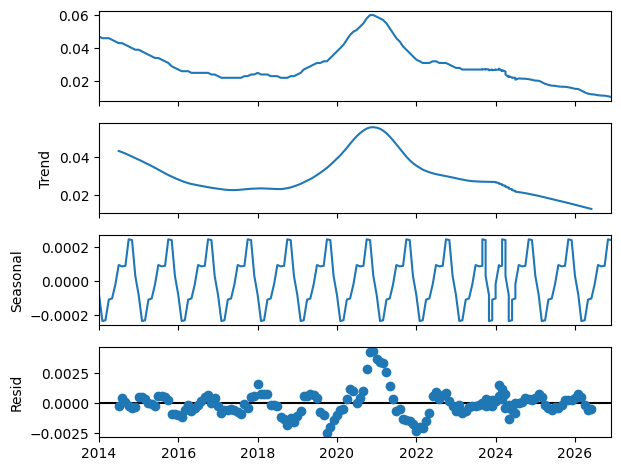

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

The decomposition for the 25+ Total population in Iceland reveals a downward trend with some fluctuations over the years, particularly around 2020. The seasonal component shows a consistent annual cycle with peaks and valleys, indicating strong seasonality. The residuals are relatively small, with some noticeable deviations around 2020, likely due to disruptions caused by the COVID-19 pandemic.

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1621.824, Time=1.60 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1429.655, Time=0.08 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1594.074, Time=0.51 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1539.941, Time=0.59 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-1565.586, Time=0.41 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1606.638, Time=0.54 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1561.585, Time=1.19 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1602.062, Time=1.10 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=inf, Time=1.91 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1612.646, Time=0.36 sec
 ARIMA(2,1,1)(0,1,1)[12]             : AIC=-1621.903, Time=0.85 sec
 ARIMA(2,1,1)(0,1,0)[12]             : AIC=-1565.014, Time=0.56 sec
 ARIMA(2,1,1)(1,1,1)[12]             : AIC=-1607.419, Time=0.65 sec
 ARIMA(2,1,1)(0,1,2)[12]             : AIC=-1561.013, Time=1.68 sec
 ARIMA(2,1,

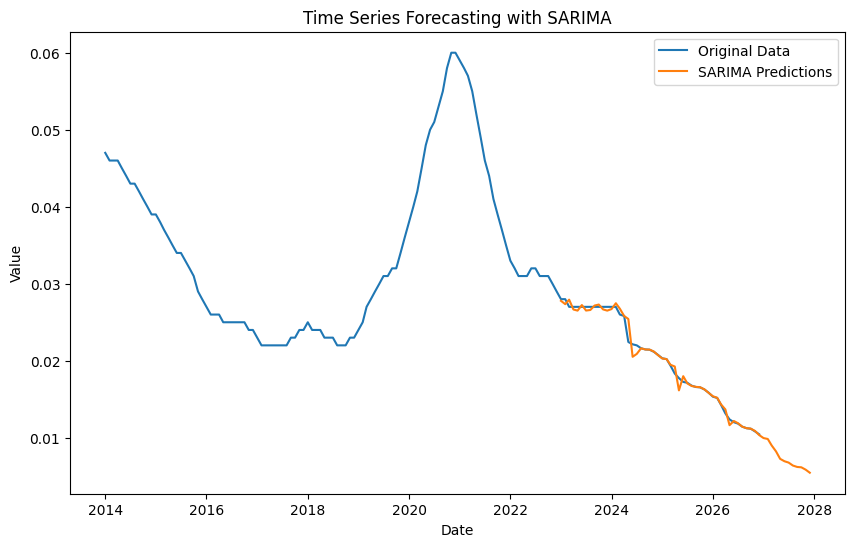

SARIMA - MSE: 4.402504089201592e-07, RMSE: 0.0006635136840489118, MAPE: 1.77%


In [ ]:
model_sarima(data_filtered,'Iceland', '25+', 'Total')

## Greece

### 15-24, Female

In [ ]:
data_filtered = prepare_data(combined_df, country='Greece', age='15-24', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9117
Strong seasonality detected.


(0.911726767066322, True)

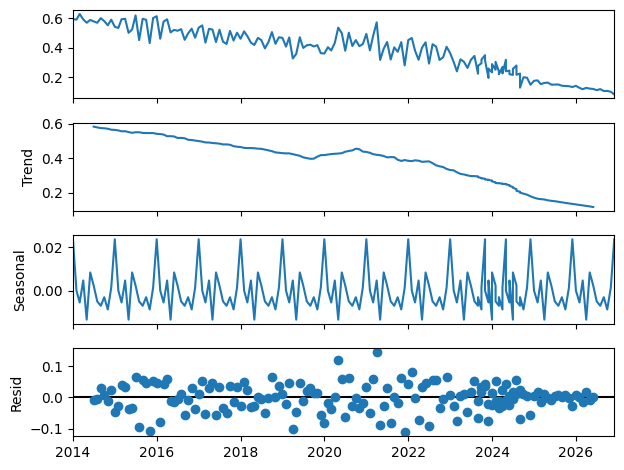

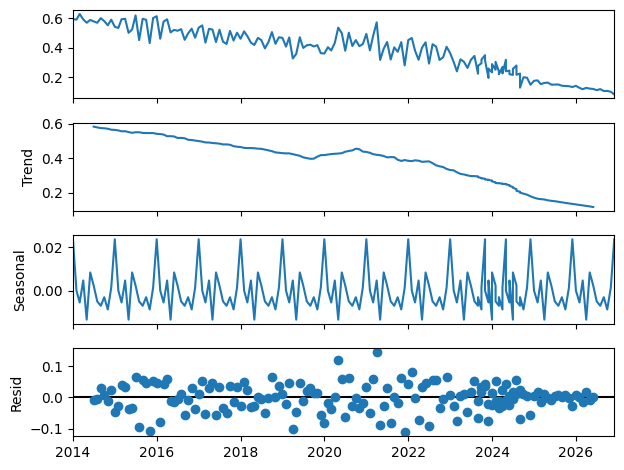

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()


The decomposition reveals a strong downward trend, with values steadily decreasing over time and noticeable fluctuations. The seasonal component displays a clear periodic cycle, with sharp peaks and valleys, indicating a significant seasonal influence throughout the years. The residuals show small fluctuations, though there are some deviations in the later years, particularly around 2020, likely due to external disruptions such as the COVID-19 pandemic.

The seasonal patterns are well-defined despite the long-term decline, and the trend shows a steady decrease in the observed metric, with seasonal effects overlaying the overall decline.

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=1.36 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-224.678, Time=0.03 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-319.431, Time=0.48 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=0.95 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-257.566, Time=0.12 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-341.934, Time=0.54 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=-355.080, Time=1.37 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=-355.894, Time=0.72 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=inf, Time=0.42 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=-355.675, Time=1.84 sec
 ARIMA(1,1,0)(0,1,2)[12]             : AIC=inf, Time=0.77 sec
 ARIMA(1,1,0)(2,1,2)[12]             : AIC=-353.692, Time=2.44 sec
 ARIMA(0,1,0)(1,1,1)[12]             : AIC=-321.998, Time=0.40 sec
 ARIMA(2,1,0)(1,1,1)[12]             : AIC=inf, Time=1.43 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-

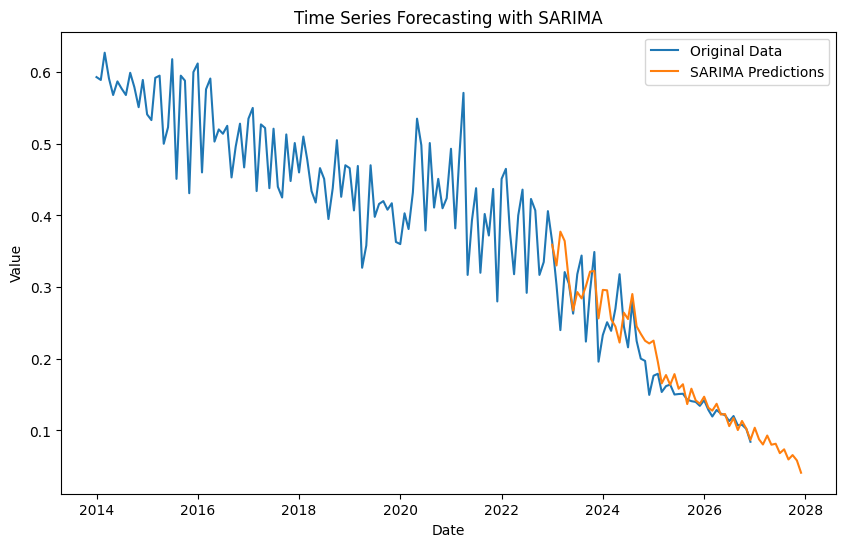

SARIMA - MSE: 0.0013973365822356522, RMSE: 0.03738096550700172, MAPE: 11.52%


In [ ]:
model_sarima(data_filtered,'Greece', '15-24', 'Female')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=1.36 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-214.874, Time=0.06 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-272.096, Time=0.04 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.36 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-216.874, Time=0.05 sec
 ARIMA(2,2,0)(0,0,0)[0] intercept   : AIC=-402.674, Time=0.34 sec
 ARIMA(3,2,0)(0,0,0)[0] intercept   : AIC=-437.107, Time=0.32 sec
 ARIMA(3,2,1)(0,0,0)[0] intercept   : AIC=-498.569, Time=0.63 sec
 ARIMA(2,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.51 sec
 ARIMA(3,2,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.57 sec
 ARIMA(2,2,2)(0,0,0)[0] intercept   : AIC=-490.501, Time=0.88 sec
 ARIMA(3,2,1)(0,0,0)[0]             : AIC=inf, Time=0.46 sec

Best model:  ARIMA(3,2,1)(0,0,0)[0] intercept
Total fit time: 5.578 seconds
                               SARIMAX Results                                
Dep. Variable:                    

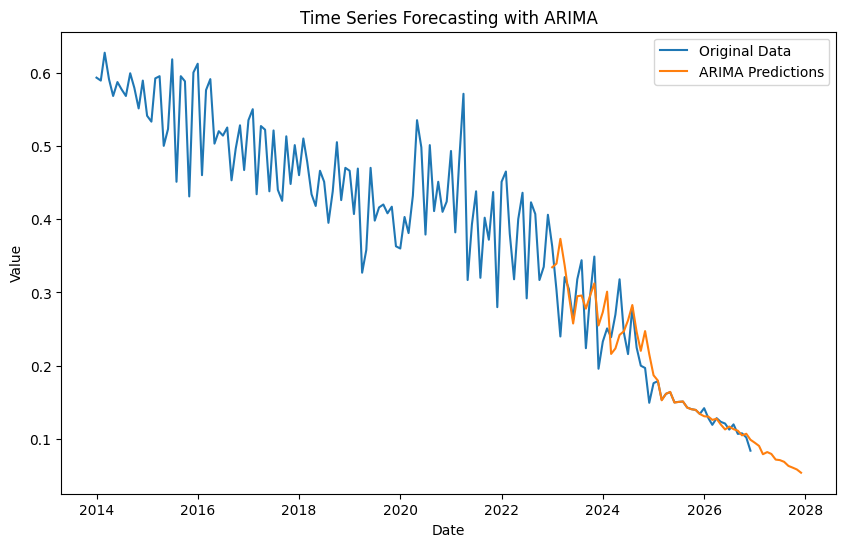

ARIMA - MSE: 0.0011249695927595656, RMSE: 0.033540566375056424, MAPE: 9.24%


In [ ]:
model_arima(data_filtered,'Greece', '15-24', 'Female')

### 15-24, Male

In [ ]:
data_filtered = prepare_data(combined_df, country='Greece', age='15-24', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9505
Strong seasonality detected.


(0.950472764921309, True)

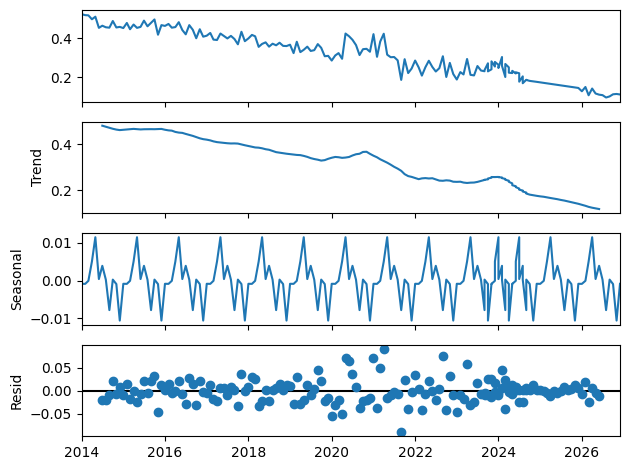

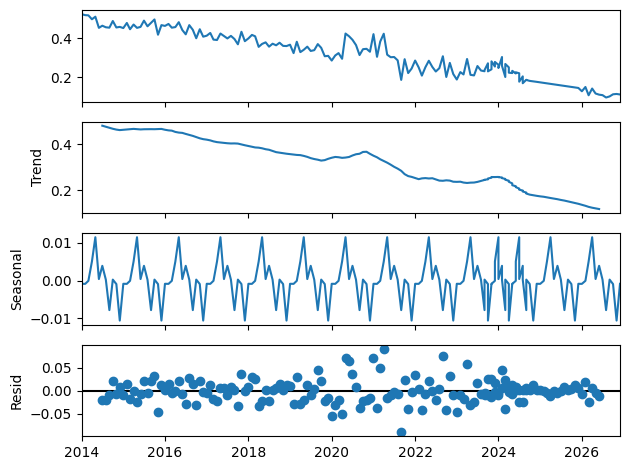

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

The decomposition shows a strong downward trend, where the values gradually decrease over time, with some fluctuations around the middle of the period. The seasonal component displays a clear periodic cycle, with pronounced peaks and valleys, indicating a significant seasonal pattern that repeats consistently throughout the years. The residuals show small fluctuations around the zero line, indicating that the model effectively captured the major patterns in the data, with only minor unexplained variations.

The downward trend suggests that the observed metric is gradually declining, while the seasonal component highlights recurring patterns over the years. The residuals suggest minimal noise after accounting for the trend and seasonality, though there are some deviations around 2020, which may reflect external disruptions.

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=1.62 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-403.906, Time=0.12 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-495.176, Time=0.58 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=0.72 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-439.786, Time=0.10 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-507.658, Time=0.69 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=inf, Time=2.26 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=inf, Time=0.88 sec
 ARIMA(0,1,0)(2,1,0)[12]             : AIC=-466.721, Time=0.38 sec
 ARIMA(2,1,0)(2,1,0)[12]             : AIC=-529.742, Time=0.84 sec
 ARIMA(2,1,0)(1,1,0)[12]             : AIC=-512.738, Time=0.50 sec
 ARIMA(2,1,0)(2,1,1)[12]             : AIC=inf, Time=2.39 sec
 ARIMA(2,1,0)(1,1,1)[12]             : AIC=inf, Time=1.26 sec
 ARIMA(3,1,0)(2,1,0)[12]             : AIC=-527.748, Time=2.38 sec
 ARIMA(2,1,1)(2,1,0)[12]             : AIC=-527.7

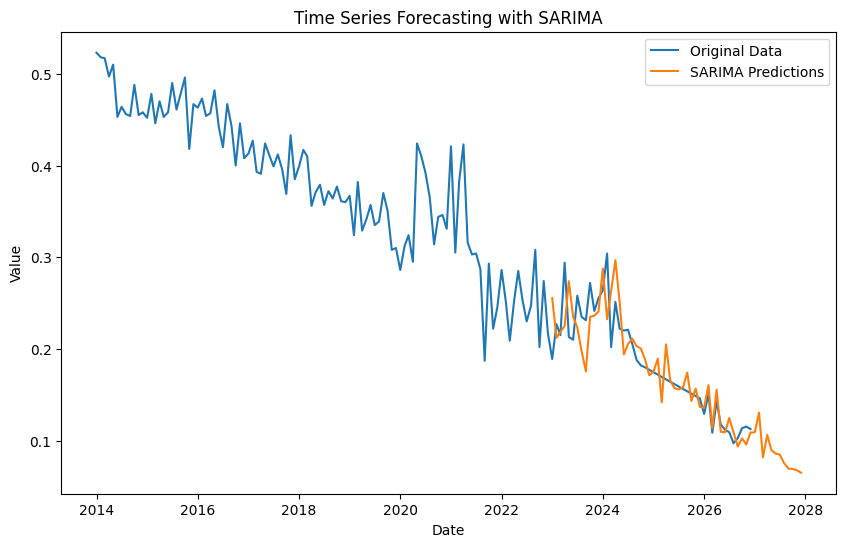

SARIMA - MSE: 0.0008245633034104051, RMSE: 0.028715210314577275, MAPE: 10.64%


In [ ]:
model_sarima(data_filtered,'Greece', '15-24', 'Male')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.86 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-393.981, Time=0.03 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-481.521, Time=0.09 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.37 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-395.981, Time=0.03 sec
 ARIMA(2,2,0)(0,0,0)[0] intercept   : AIC=-558.788, Time=0.13 sec
 ARIMA(3,2,0)(0,0,0)[0] intercept   : AIC=-580.403, Time=0.26 sec
 ARIMA(3,2,1)(0,0,0)[0] intercept   : AIC=-622.068, Time=0.62 sec
 ARIMA(2,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.45 sec
 ARIMA(3,2,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.81 sec
 ARIMA(2,2,2)(0,0,0)[0] intercept   : AIC=-615.796, Time=0.48 sec
 ARIMA(3,2,1)(0,0,0)[0]             : AIC=inf, Time=0.42 sec

Best model:  ARIMA(3,2,1)(0,0,0)[0] intercept
Total fit time: 4.564 seconds
                               SARIMAX Results                                
Dep. Variable:                    

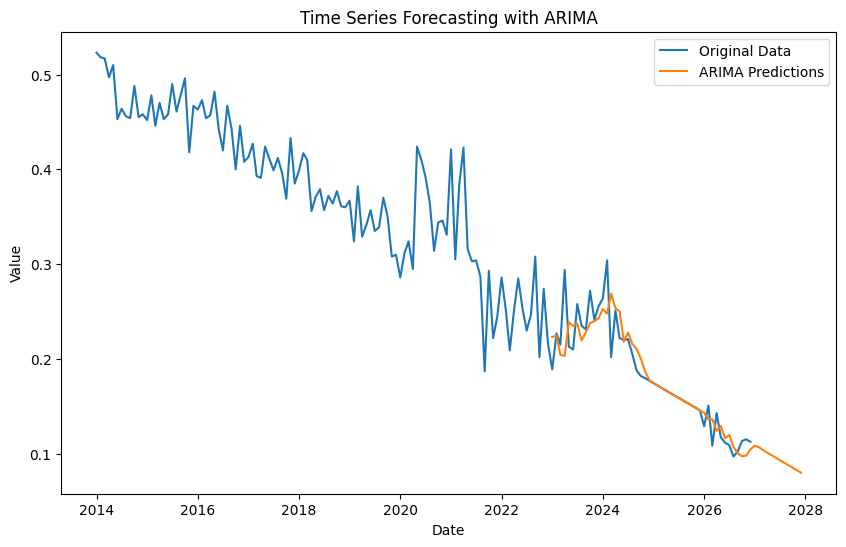

ARIMA - MSE: 0.0005214796695386646, RMSE: 0.022835929355703142, MAPE: 7.32%


In [ ]:
model_arima(data_filtered,'Greece', '15-24', 'Male')

### 15-24, Total

In [ ]:
data_filtered = prepare_data(combined_df, country='Greece', age='15-24', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9508
Strong seasonality detected.


(0.9508101110131437, True)

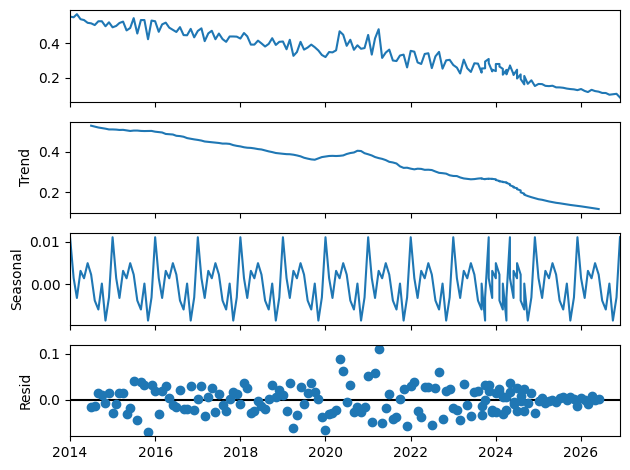

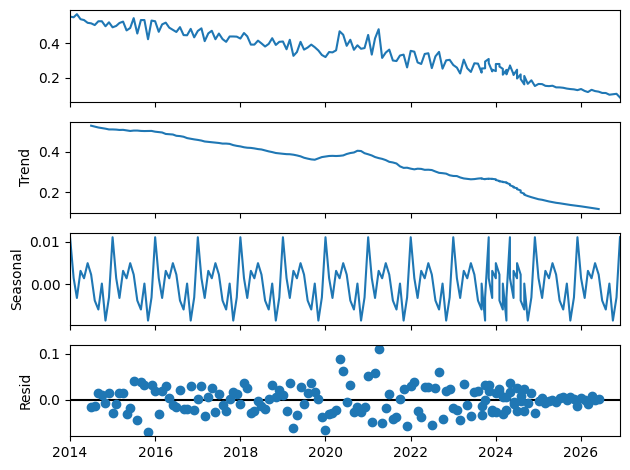

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()


The decomposition reveals a consistent downward trend in the data, where values gradually decrease over time, with occasional sharp fluctuations in the earlier years. The seasonal component shows a regular annual cycle, with clear peaks and valleys, highlighting significant seasonality that repeats each year. The residuals are relatively small but show some deviations, especially around 2020, which could reflect external disruptions, such as the COVID-19 pandemic.

The overall trend indicates a steady decline in the observed metric, while the seasonal fluctuations suggest cyclical patterns over time. The model appears to effectively capture the major patterns, with minor unexplained variations in the residuals, especially during the 2020 period.

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=2.18 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-362.721, Time=0.10 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-445.328, Time=0.41 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=0.87 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-385.559, Time=0.05 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-464.489, Time=0.73 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=-483.898, Time=1.62 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=inf, Time=0.90 sec
 ARIMA(1,1,0)(2,1,2)[12]             : AIC=inf, Time=1.40 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=inf, Time=1.85 sec
 ARIMA(0,1,0)(2,1,1)[12]             : AIC=-453.942, Time=1.93 sec
 ARIMA(2,1,0)(2,1,1)[12]             : AIC=inf, Time=2.45 sec
 ARIMA(1,1,1)(2,1,1)[12]             : AIC=-527.172, Time=2.28 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=inf, Time=1.37 sec
 ARIMA(1,1,1)(2,1,0)[12]             : AIC=-507.242, T

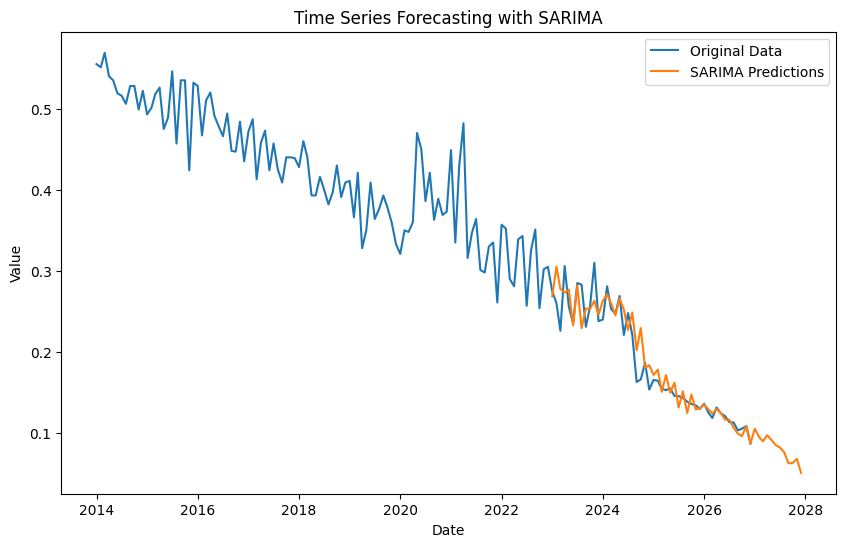

SARIMA - MSE: 0.00048005176720235997, RMSE: 0.02191008368770781, MAPE: 7.60%


In [ ]:
model_sarima(data_filtered,'Greece', '15-24', 'Total')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=-547.780, Time=0.65 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-369.365, Time=0.09 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-419.045, Time=0.10 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.31 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-371.365, Time=0.04 sec
 ARIMA(2,2,1)(0,0,0)[0] intercept   : AIC=-634.009, Time=0.39 sec
 ARIMA(2,2,0)(0,0,0)[0] intercept   : AIC=-563.802, Time=0.33 sec
 ARIMA(3,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.64 sec
 ARIMA(2,2,2)(0,0,0)[0] intercept   : AIC=-627.241, Time=0.57 sec
 ARIMA(1,2,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.42 sec
 ARIMA(3,2,0)(0,0,0)[0] intercept   : AIC=-583.691, Time=0.21 sec
 ARIMA(3,2,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.79 sec
 ARIMA(2,2,1)(0,0,0)[0]             : AIC=inf, Time=0.30 sec

Best model:  ARIMA(2,2,1)(0,0,0)[0] intercept
Total fit time: 4.836 seconds
                               SARIMAX Results 

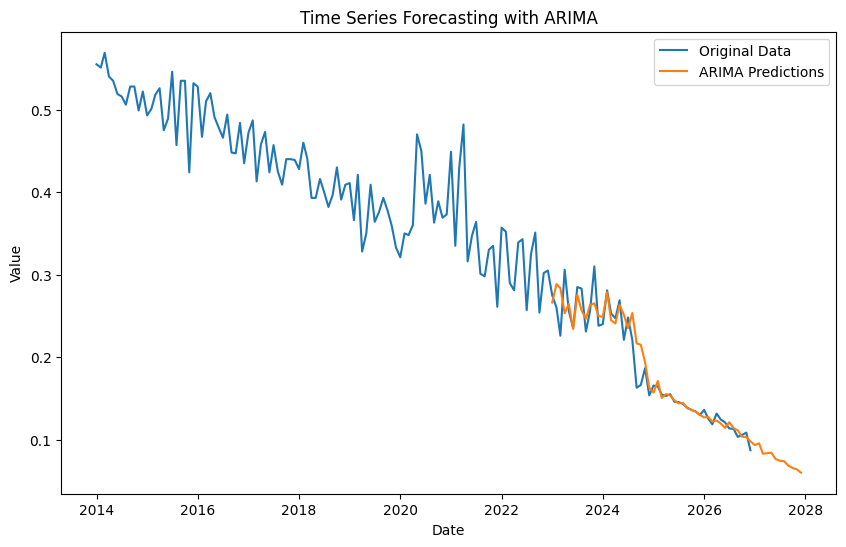

ARIMA - MSE: 0.0003910132965453772, RMSE: 0.019774056148028334, MAPE: 6.27%


In [ ]:
model_arima(data_filtered,'Greece', '15-24', 'Total')

### 25+, Female

In [ ]:
data_filtered = prepare_data(combined_df, country='Greece', age='25+', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9925
Strong seasonality detected.


(0.9925491094023763, True)

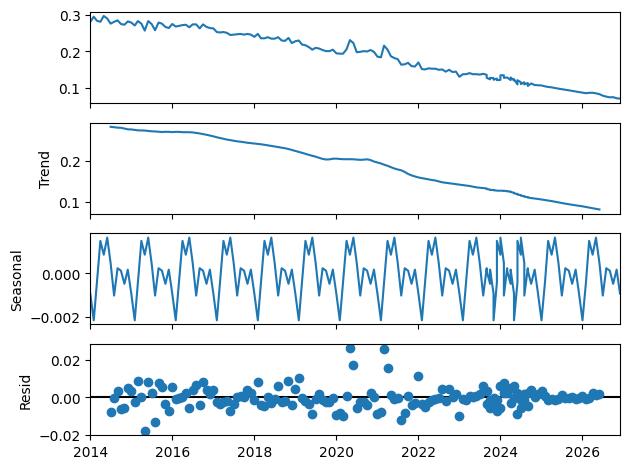

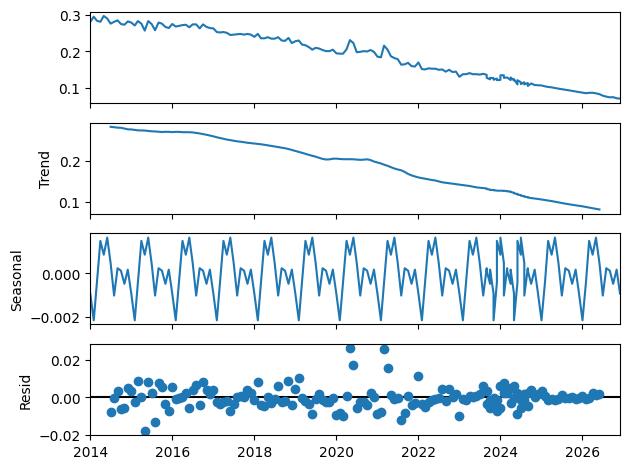

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

The decomposition reveals a downward trend in the data, with values steadily decreasing over time and showing some fluctuations in the earlier years. The seasonal component exhibits a strong and regular annual cycle, with clear peaks and valleys, indicating consistent seasonality throughout the years. The residuals are relatively small, but some minor deviations are visible, especially around 2020, possibly reflecting disruptions such as the COVID-19 pandemic.

The overall trend indicates a gradual decline in the observed metric, while the seasonal fluctuations capture recurring patterns. The residuals suggest that the model effectively captures the underlying trends and seasonality, with small unexplained variations, particularly around 2020.

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-962.992, Time=1.79 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-844.182, Time=0.03 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-899.422, Time=0.32 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=1.52 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-875.952, Time=0.56 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-963.604, Time=1.38 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-925.696, Time=0.84 sec
 ARIMA(1,1,1)(2,1,1)[12]             : AIC=-962.029, Time=2.29 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=inf, Time=6.06 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=inf, Time=2.37 sec
 ARIMA(1,1,1)(2,1,0)[12]             : AIC=-937.497, Time=1.80 sec
 ARIMA(1,1,1)(2,1,2)[12]             : AIC=inf, Time=3.42 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=inf, Time=1.24 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=inf, Time=1.25 sec
 ARIMA(2,1,1)(1,1,1)[12]             : AIC=inf, T

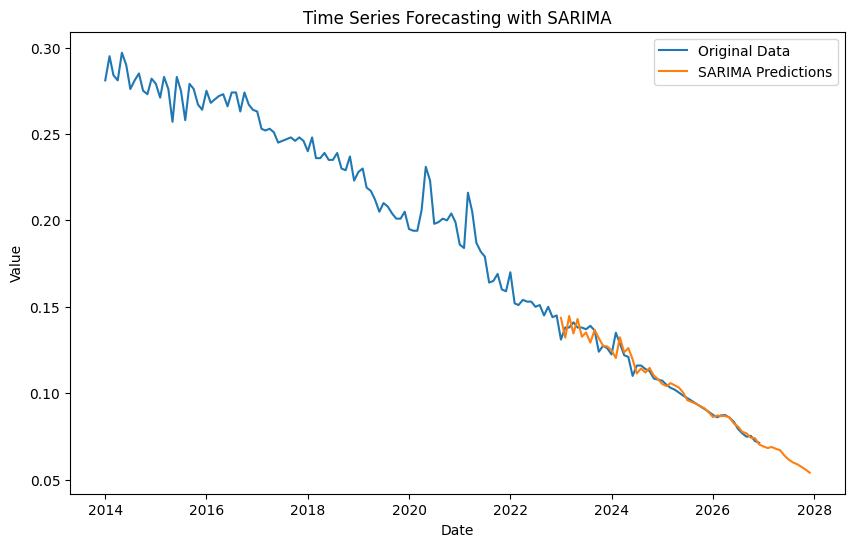

SARIMA - MSE: 1.9323004419039263e-05, RMSE: 0.004395793946380934, MAPE: 2.46%


In [ ]:
model_sarima(data_filtered,'Greece', '25+', 'Female')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=1.14 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-907.215, Time=0.11 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-938.221, Time=0.22 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=-1029.225, Time=0.17 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-909.205, Time=0.07 sec
 ARIMA(0,2,2)(0,0,0)[0] intercept   : AIC=-1070.649, Time=0.88 sec
 ARIMA(1,2,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.48 sec
 ARIMA(0,2,3)(0,0,0)[0] intercept   : AIC=-1060.642, Time=0.25 sec
 ARIMA(1,2,3)(0,0,0)[0] intercept   : AIC=-1068.552, Time=0.21 sec
 ARIMA(0,2,2)(0,0,0)[0]             : AIC=-1072.554, Time=0.38 sec
 ARIMA(0,2,1)(0,0,0)[0]             : AIC=-1031.200, Time=0.31 sec
 ARIMA(1,2,2)(0,0,0)[0]             : AIC=inf, Time=0.67 sec
 ARIMA(0,2,3)(0,0,0)[0]             : AIC=-1062.615, Time=0.21 sec
 ARIMA(1,2,1)(0,0,0)[0]             : AIC=inf, Time=0.42 sec
 ARIMA(1,2,3)(0,0,0)[0]             : AIC=-107

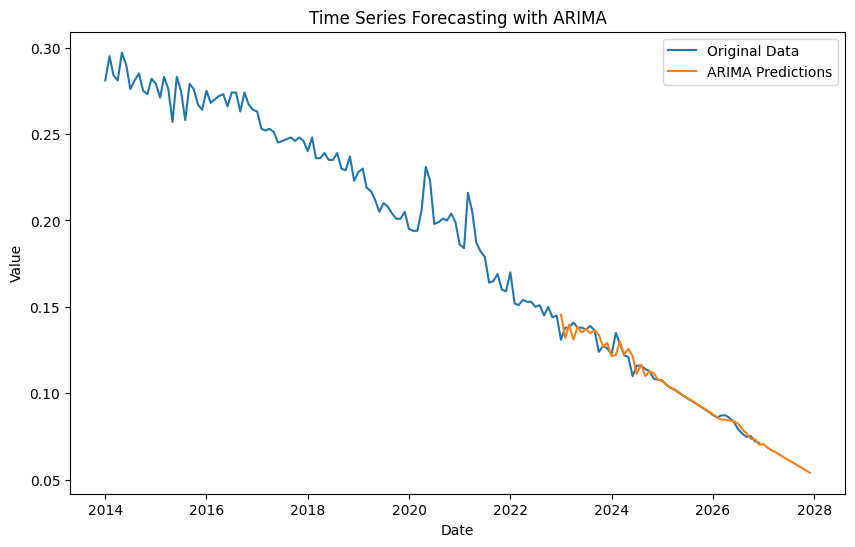

ARIMA - MSE: 1.852745859234519e-05, RMSE: 0.004304353446494048, MAPE: 2.15%


In [ ]:
model_arima(data_filtered,'Greece', '25+', 'Female')

### 25+, Male

In [ ]:
data_filtered = prepare_data(combined_df, country='Greece', age='25+', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9942
Strong seasonality detected.


(0.9942481741577117, True)

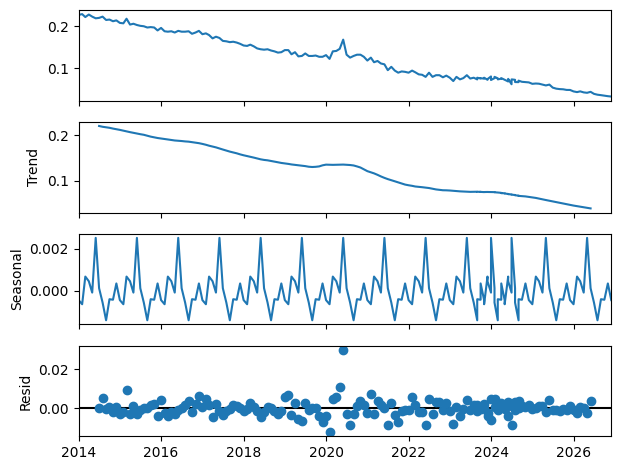

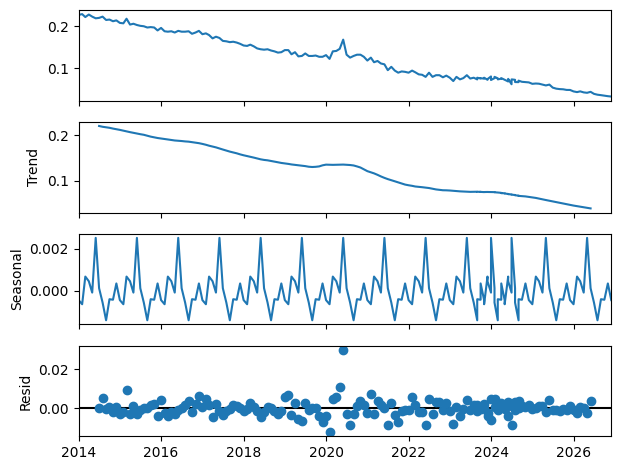

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

The decomposition of the data shows a consistent downward trend, with a gradual decline over time, accompanied by an outlier around 2020. The seasonal component exhibits a strong, repeating annual cycle with significant peaks and valleys, indicating a notable seasonal pattern in the data. The residuals are mostly small with a few deviations, especially around the year 2020, which could reflect disruptions likely due to the COVID-19 pandemic.

Despite the slight outlier and some fluctuations in the residuals, the trend and seasonal components remain clear, showing that the model effectively captures the main underlying patterns. The significant deviation around 2020 suggests the impact of an external factor on the data, but the overall seasonal structure and long-term trend are consistent.

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=1.93 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-923.896, Time=0.08 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-985.627, Time=0.39 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=0.96 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-946.007, Time=0.06 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-1033.658, Time=0.58 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=-1064.510, Time=3.08 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=inf, Time=2.16 sec
 ARIMA(1,1,0)(2,1,2)[12]             : AIC=inf, Time=6.17 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=inf, Time=1.63 sec
 ARIMA(0,1,0)(2,1,1)[12]             : AIC=inf, Time=2.09 sec
 ARIMA(2,1,0)(2,1,1)[12]             : AIC=-1054.387, Time=2.41 sec
 ARIMA(1,1,1)(2,1,1)[12]             : AIC=-1048.744, Time=0.82 sec
 ARIMA(0,1,1)(2,1,1)[12]             : AIC=-1050.683, Time=1.58 sec
 ARIMA(2,1,1)(2,1,1)[12]             : AIC=-

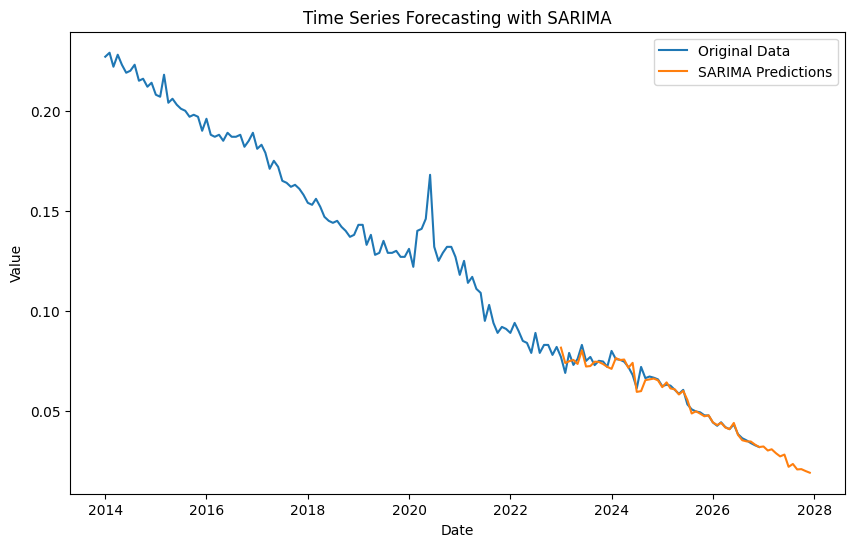

SARIMA - MSE: 8.429496390222216e-06, RMSE: 0.0029033595006857514, MAPE: 2.51%


In [ ]:
model_sarima(data_filtered,'Greece', '25+', 'Male')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=-1136.893, Time=1.04 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-977.613, Time=0.05 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-1055.503, Time=0.16 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.29 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-979.612, Time=0.07 sec
 ARIMA(2,2,1)(0,0,0)[0] intercept   : AIC=-1151.910, Time=0.75 sec
 ARIMA(2,2,0)(0,0,0)[0] intercept   : AIC=-1110.787, Time=0.07 sec
 ARIMA(3,2,1)(0,0,0)[0] intercept   : AIC=-1137.007, Time=0.61 sec
 ARIMA(2,2,2)(0,0,0)[0] intercept   : AIC=-1150.679, Time=0.26 sec
 ARIMA(1,2,2)(0,0,0)[0] intercept   : AIC=-1128.549, Time=0.47 sec
 ARIMA(3,2,0)(0,0,0)[0] intercept   : AIC=-1113.227, Time=0.13 sec
 ARIMA(3,2,2)(0,0,0)[0] intercept   : AIC=-1153.960, Time=0.69 sec
 ARIMA(3,2,3)(0,0,0)[0] intercept   : AIC=inf, Time=0.91 sec
 ARIMA(2,2,3)(0,0,0)[0] intercept   : AIC=-1155.141, Time=1.07 sec
 ARIMA(1,2,3)(0,0,0)[0] intercept

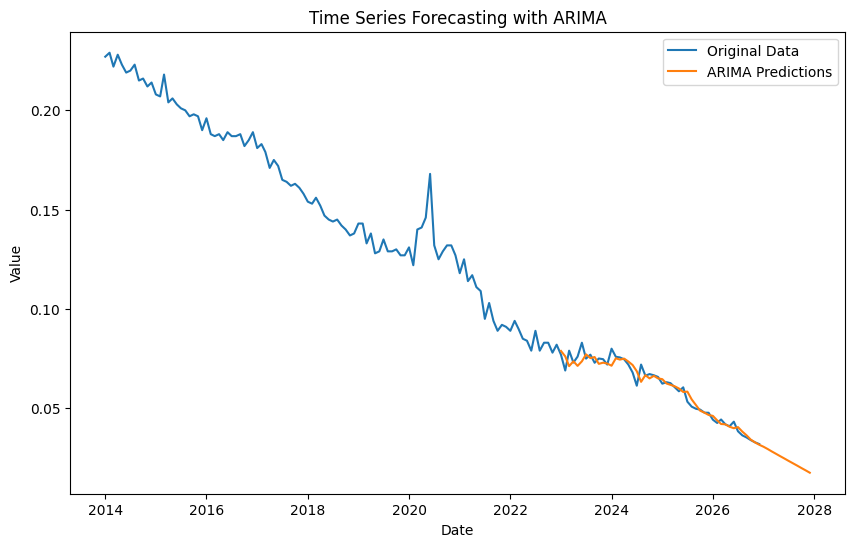

ARIMA - MSE: 1.1806760539454814e-05, RMSE: 0.0034360967011210285, MAPE: 3.76%


In [ ]:
model_arima(data_filtered,'Greece', '25+', 'Male')

### 25+, Total

In [ ]:
data_filtered = prepare_data(combined_df, country='Greece', age='25+', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9954
Strong seasonality detected.


(0.9954176099261628, True)

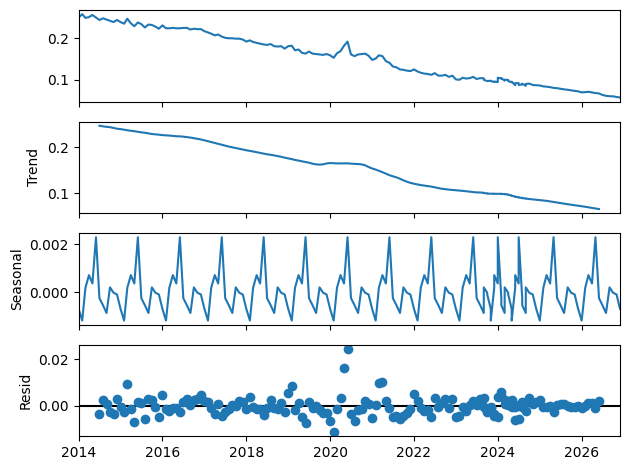

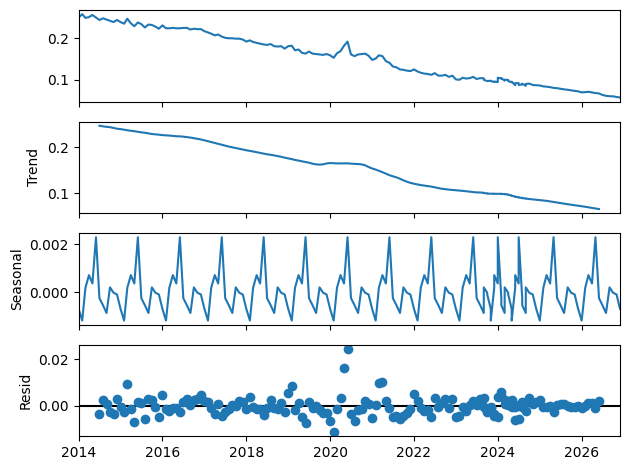

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

The decomposition of the data shows a consistent downward trend, with a gradual decline over time, accompanied by an outlier around 2020. The seasonal component exhibits a strong, repeating annual cycle with significant peaks and valleys, indicating a notable seasonal pattern in the data. The residuals are mostly small with a few deviations, especially around the year 2020, which could reflect disruptions likely due to the COVID-19 pandemic.

Despite the slight outlier and some fluctuations in the residuals, the trend and seasonal components remain clear, showing that the model effectively captures the main underlying patterns. The significant deviation around 2020 suggests the impact of an external factor on the data, but the overall seasonal structure and long-term trend are consistent.

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1063.605, Time=1.17 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-964.820, Time=0.15 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1016.338, Time=1.79 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1064.269, Time=0.77 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-977.815, Time=0.12 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-1077.559, Time=1.48 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=-1019.988, Time=0.55 sec
 ARIMA(0,1,1)(2,1,1)[12]             : AIC=-1055.827, Time=0.66 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=inf, Time=3.67 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=-1082.935, Time=1.69 sec
 ARIMA(0,1,0)(0,1,2)[12]             : AIC=-1074.935, Time=0.93 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1082.754, Time=3.00 sec
 ARIMA(0,1,2)(0,1,2)[12]             : AIC=-1091.150, Time=2.09 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=-1075.800, Time=1.14 sec
 ARIMA(0,1,2)

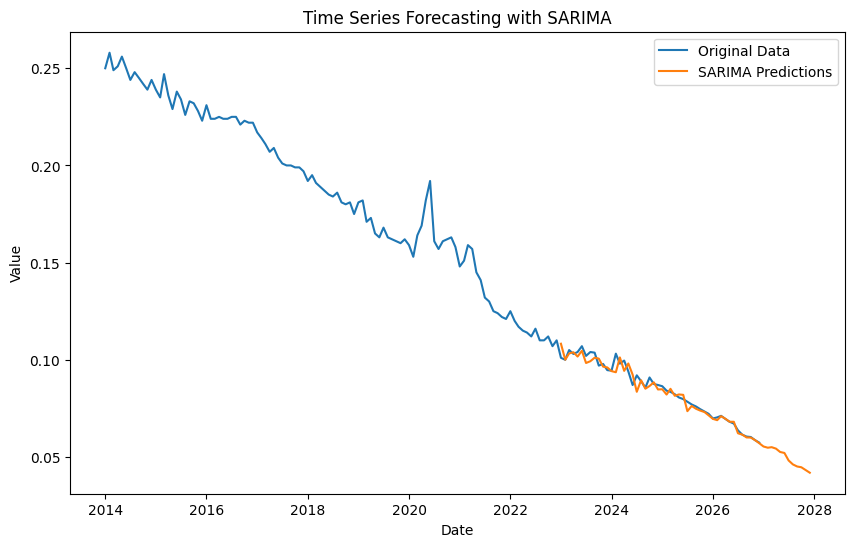

SARIMA - MSE: 9.350266363476518e-06, RMSE: 0.003057820525059723, MAPE: 2.29%


In [ ]:
model_sarima(data_filtered,'Greece', '25+', 'Total')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=-1146.847, Time=1.03 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-1054.345, Time=0.22 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-1089.862, Time=0.06 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=-1154.156, Time=0.26 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-1056.336, Time=0.03 sec
 ARIMA(0,2,2)(0,0,0)[0] intercept   : AIC=-1123.656, Time=0.41 sec
 ARIMA(1,2,2)(0,0,0)[0] intercept   : AIC=-1161.033, Time=0.32 sec
 ARIMA(2,2,2)(0,0,0)[0] intercept   : AIC=-1194.196, Time=0.54 sec
 ARIMA(2,2,1)(0,0,0)[0] intercept   : AIC=-1147.344, Time=0.34 sec
 ARIMA(3,2,2)(0,0,0)[0] intercept   : AIC=-1187.809, Time=0.77 sec
 ARIMA(2,2,3)(0,0,0)[0] intercept   : AIC=-1190.364, Time=0.68 sec
 ARIMA(1,2,3)(0,0,0)[0] intercept   : AIC=-1188.513, Time=0.38 sec
 ARIMA(3,2,1)(0,0,0)[0] intercept   : AIC=-1161.662, Time=0.71 sec
 ARIMA(3,2,3)(0,0,0)[0] intercept   : AIC=-1156.421, Time=1.03 sec
 ARIMA(2,2,2)(0,0,0

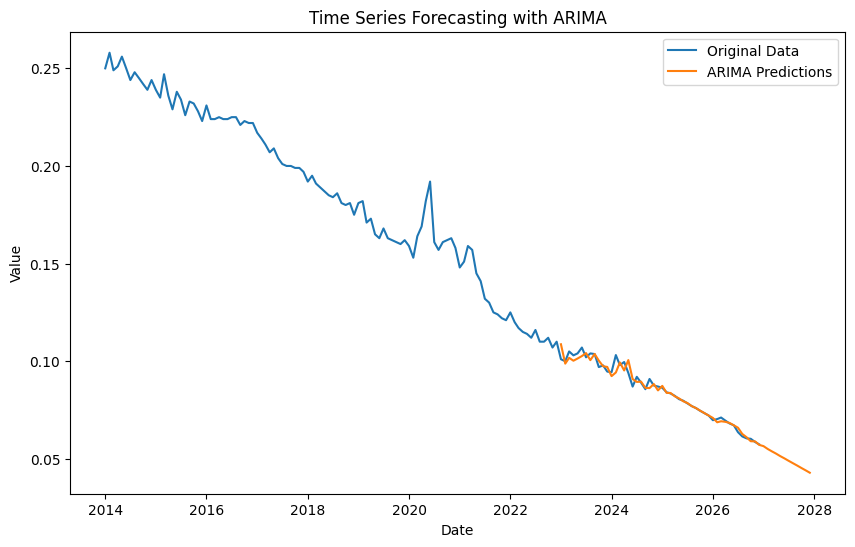

ARIMA - MSE: 7.366398223725476e-06, RMSE: 0.002714110945360465, MAPE: 1.97%


In [ ]:
model_arima(data_filtered,'Greece', '25+', 'Total')

# Spain

The decomposition for all age categories and genders in Spain shows a strong downward trend, where the values consistently decline over time. The seasonal component exhibits regular, pronounced cycles, with clear peaks and valleys, indicating a robust seasonal pattern that repeats every year. The residuals are relatively small, showing minor fluctuations around the expected trend, indicating that the model effectively captures the main patterns in the data.

This clear, long-term trend combined with the strong seasonality makes SARIMA an ideal model for this country. Since SARIMA accounts for both trend and seasonality, it is well-suited to capture the patterns in this data, as seen in the decomposition. The presence of a well-defined trend and seasonal component justifies the effectiveness of SARIMA for forecasting across all age categories and genders in Spain.

### 15-24, Female

In [ ]:
data_filtered = prepare_data(combined_df, country='Spain', age='15-24', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9786
Strong seasonality detected.


(0.978609110570763, True)

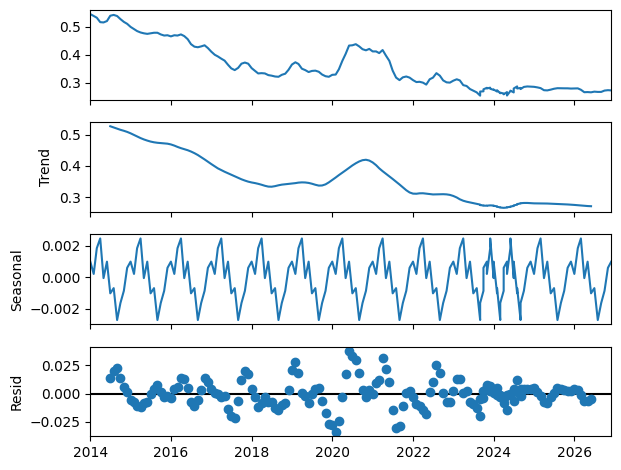

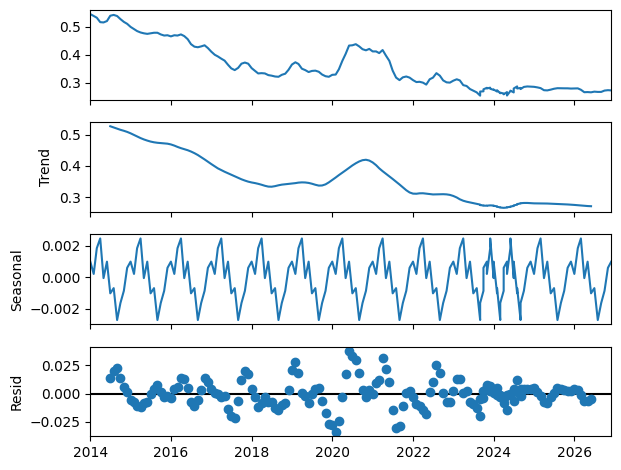

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=2.29 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-793.415, Time=0.07 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-891.683, Time=0.53 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=1.79 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-850.879, Time=0.18 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-901.331, Time=0.88 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=-895.134, Time=0.89 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=-925.592, Time=1.07 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-921.827, Time=0.27 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=-923.557, Time=3.94 sec
 ARIMA(1,1,0)(0,1,2)[12]             : AIC=inf, Time=1.73 sec
 ARIMA(1,1,0)(2,1,2)[12]             : AIC=-918.279, Time=1.86 sec
 ARIMA(0,1,0)(1,1,1)[12]             : AIC=inf, Time=0.71 sec
 ARIMA(2,1,0)(1,1,1)[12]             : AIC=inf, Time=1.76 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=i

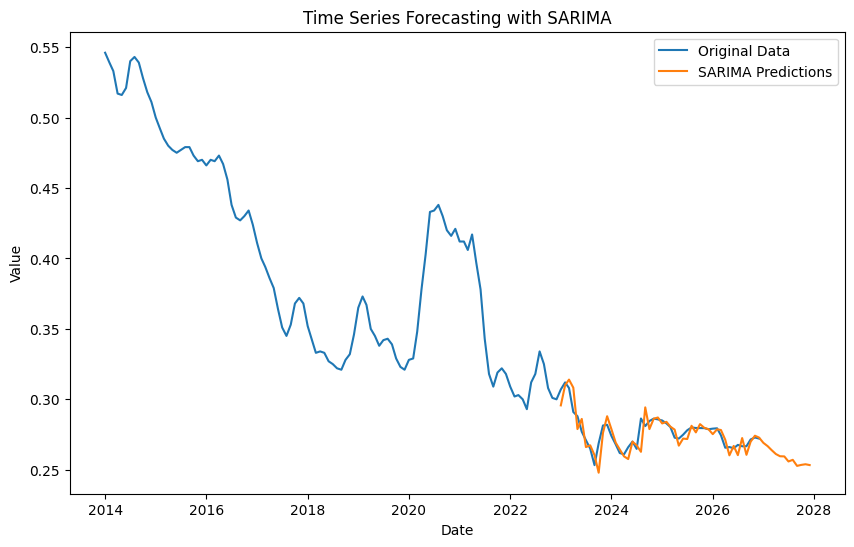

SARIMA - MSE: 5.1056921112068056e-05, RMSE: 0.007145412592150859, MAPE: 1.81%


In [ ]:
model_sarima(data_filtered,'Spain', '15-24', 'Female')

### 15-24, Male

In [ ]:
data_filtered = prepare_data(combined_df, country='Spain', age='15-24', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9925
Strong seasonality detected.


(0.9924842584178155, True)

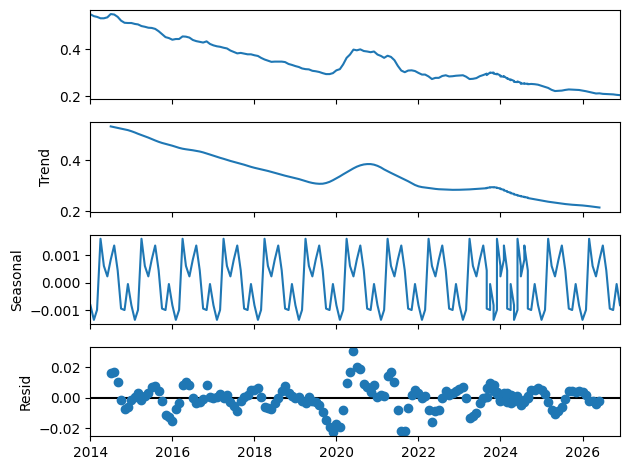

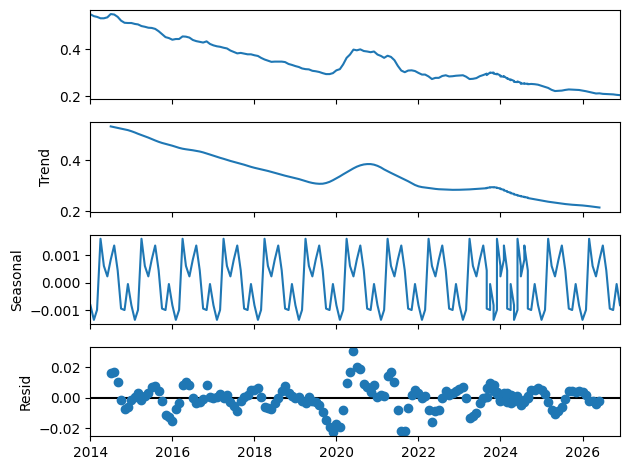

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1024.546, Time=1.27 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-916.159, Time=0.06 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-998.575, Time=0.42 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=6.56 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-968.921, Time=0.57 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=inf, Time=1.79 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1025.445, Time=1.17 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=inf, Time=6.18 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=inf, Time=1.87 sec
 ARIMA(1,1,0)(0,1,2)[12]             : AIC=-1028.336, Time=1.86 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1027.652, Time=0.51 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=inf, Time=2.76 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=-1033.488, Time=1.97 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=-1006.371, Time=1.43 sec
 ARIMA(1,1,0)(0,1,0)[12]             :

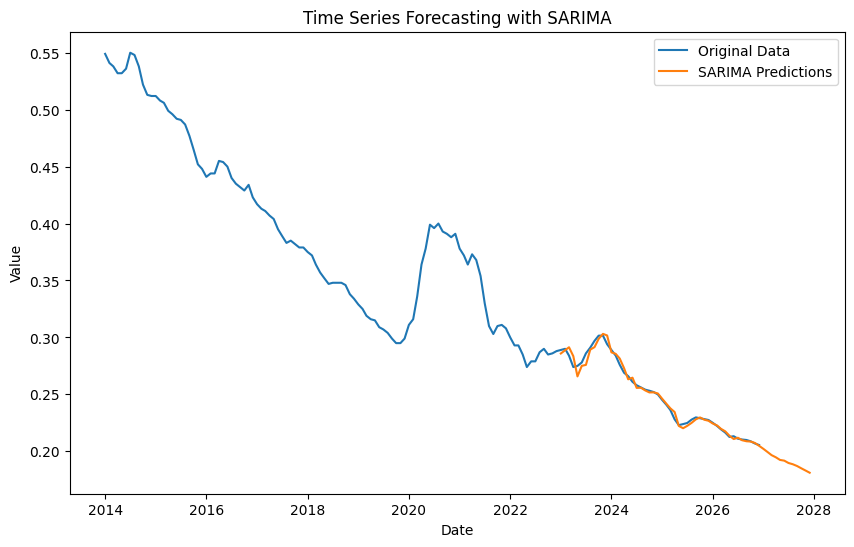

SARIMA - MSE: 1.3102488201254972e-05, RMSE: 0.003619735929768216, MAPE: 0.97%


In [ ]:
model_sarima(data_filtered,'Spain', '15-24', 'Male')

### 15-24, Total

In [ ]:
data_filtered = prepare_data(combined_df, country='Spain', age='15-24', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9903
Strong seasonality detected.


(0.9902953228483696, True)

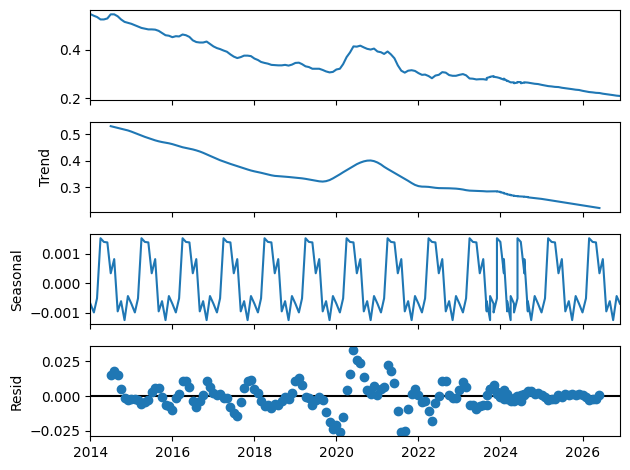

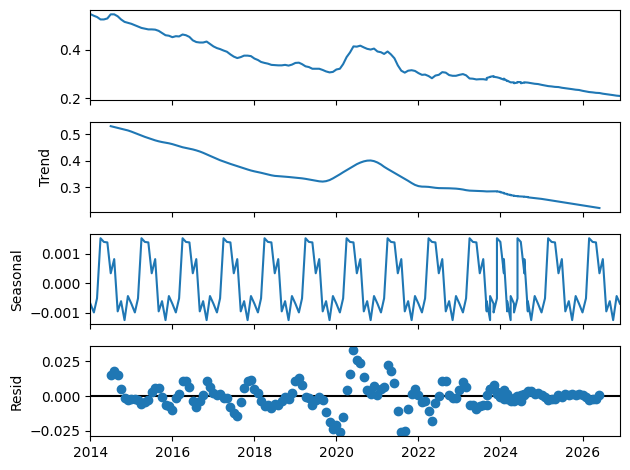

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=6.22 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-880.750, Time=0.05 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-966.896, Time=0.77 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-984.858, Time=0.97 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-918.860, Time=0.29 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-983.741, Time=0.67 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=inf, Time=1.12 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=-951.203, Time=0.33 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=inf, Time=7.60 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=inf, Time=0.97 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=-1023.455, Time=1.37 sec
 ARIMA(0,1,2)(0,1,0)[12]             : AIC=-951.059, Time=0.45 sec
 ARIMA(0,1,2)(1,1,1)[12]             : AIC=inf, Time=2.80 sec
 ARIMA(0,1,2)(0,1,2)[12]             : AIC=inf, Time=2.41 sec
 ARIMA(0,1,2)(1,1,0)[12]             : AIC=-983.

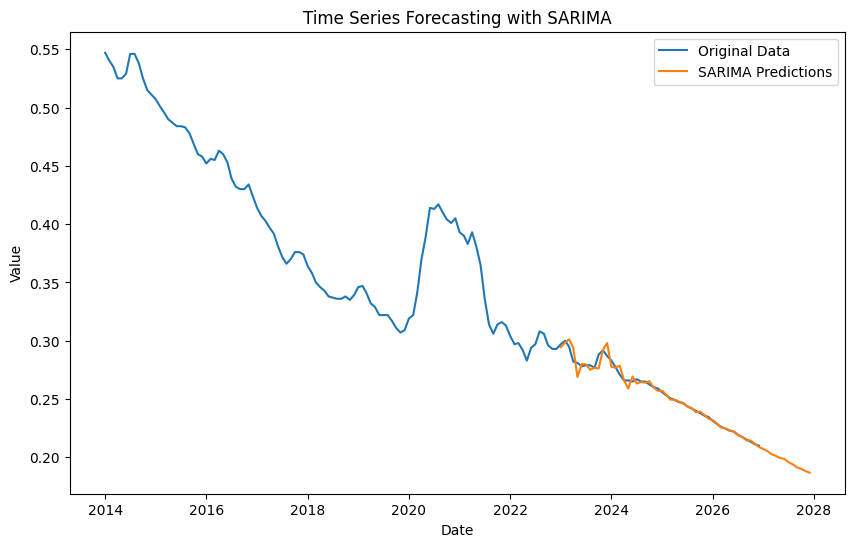

SARIMA - MSE: 1.7139814634538093e-05, RMSE: 0.00414002592196451, MAPE: 0.88%


In [ ]:
model_sarima(data_filtered,'Spain', '15-24', 'Total')

### 25+, Male

In [ ]:
data_filtered = prepare_data(combined_df, country='Spain', age='25+', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9958
Strong seasonality detected.


(0.9958487467171464, True)

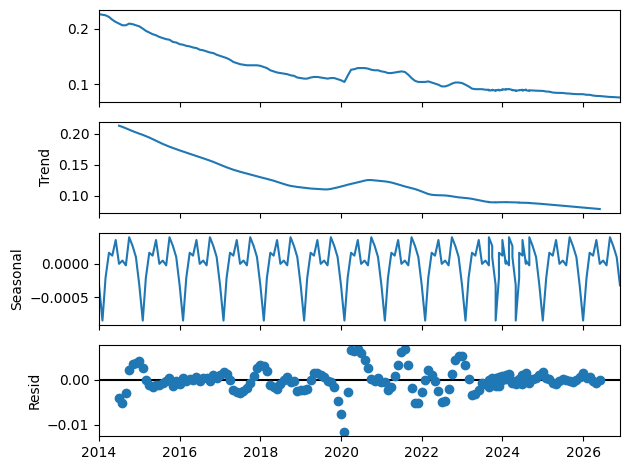

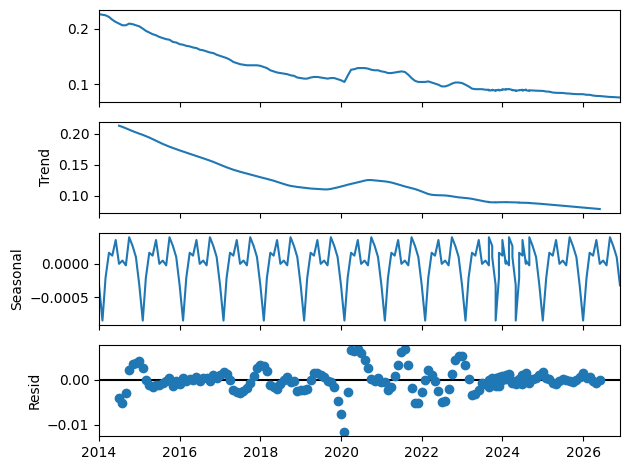

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1364.912, Time=0.86 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1268.795, Time=0.04 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1338.978, Time=0.13 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1362.521, Time=0.32 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-1304.950, Time=0.11 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1353.921, Time=0.24 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=inf, Time=1.35 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1334.846, Time=0.11 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=-1367.538, Time=1.99 sec
 ARIMA(1,1,1)(2,1,2)[12]             : AIC=-1359.515, Time=1.11 sec
 ARIMA(1,1,1)(2,1,1)[12]             : AIC=-1353.120, Time=0.63 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=-1362.952, Time=0.48 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=-1367.215, Time=0.87 sec
 ARIMA(2,1,1)(1,1,2)[12]             : AIC=-1361.880, Time=1.74 sec
 ARIMA(1,1,

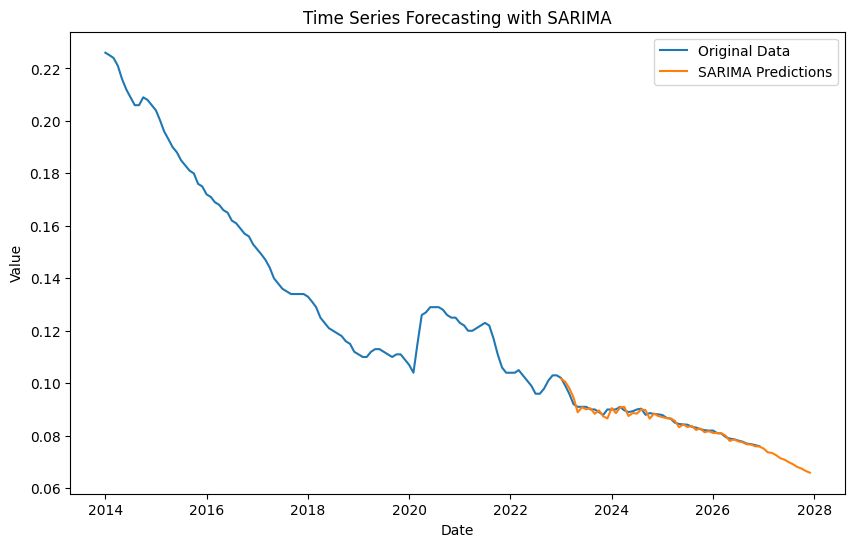

SARIMA - MSE: 1.2273929849880856e-06, RMSE: 0.0011078776940565622, MAPE: 0.92%


In [ ]:
model_sarima(data_filtered,'Spain', '25+', 'Male')

### 25+, Female

In [ ]:
data_filtered = prepare_data(combined_df, country='Spain', age='25+', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9973
Strong seasonality detected.


(0.9973063505908152, True)

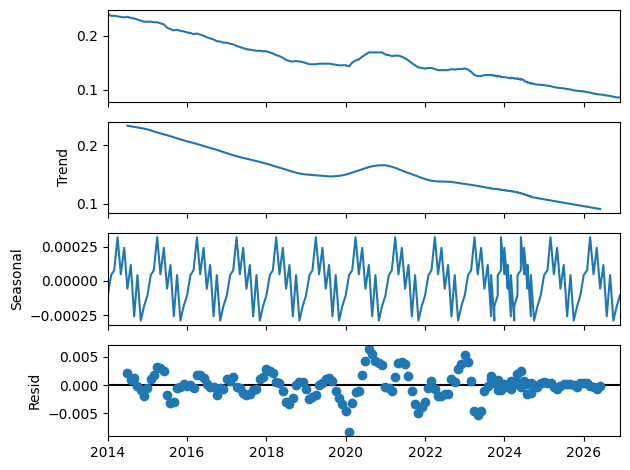

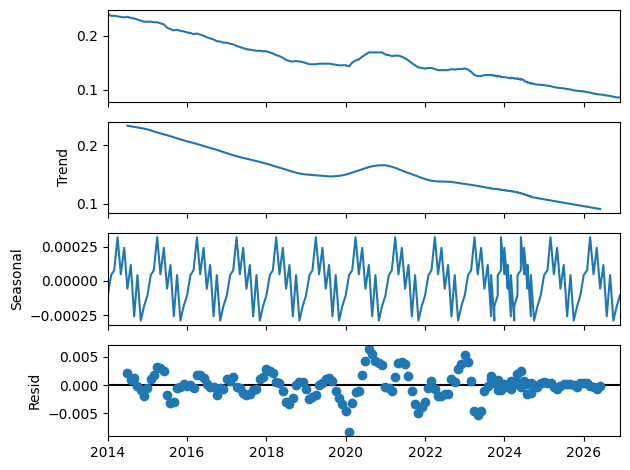

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1396.135, Time=0.89 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1292.371, Time=0.03 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1368.300, Time=0.31 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1371.403, Time=0.78 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-1338.206, Time=0.08 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1378.170, Time=0.70 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1334.205, Time=0.40 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1369.117, Time=0.33 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=inf, Time=0.69 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1395.155, Time=0.19 sec
 ARIMA(2,1,1)(0,1,1)[12]             : AIC=-1210.073, Time=0.32 sec
 ARIMA(1,1,2)(0,1,1)[12]             : AIC=-1398.587, Time=0.66 sec
 ARIMA(1,1,2)(0,1,0)[12]             : AIC=-1342.862, Time=0.12 sec
 ARIMA(1,1,2)(1,1,1)[12]             : AIC=-1379.874, Time=1.03 sec
 ARIMA(1,1,

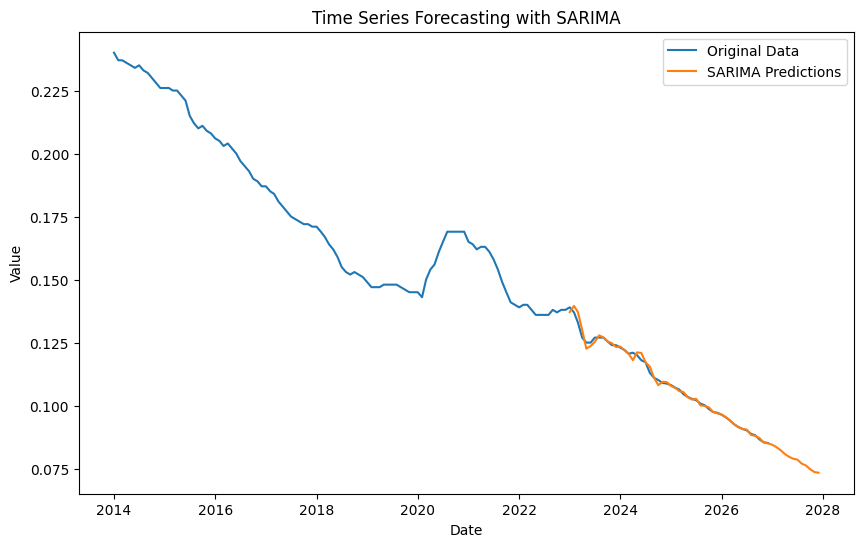

SARIMA - MSE: 1.6929777886597987e-06, RMSE: 0.001301144799267091, MAPE: 0.69%


In [ ]:
model_sarima(data_filtered,'Spain', '25+', 'Female')

 ### 25+, Total

In [ ]:
data_filtered = prepare_data(combined_df, country='Spain', age='25+', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9972
Strong seasonality detected.


(0.9972238518666969, True)

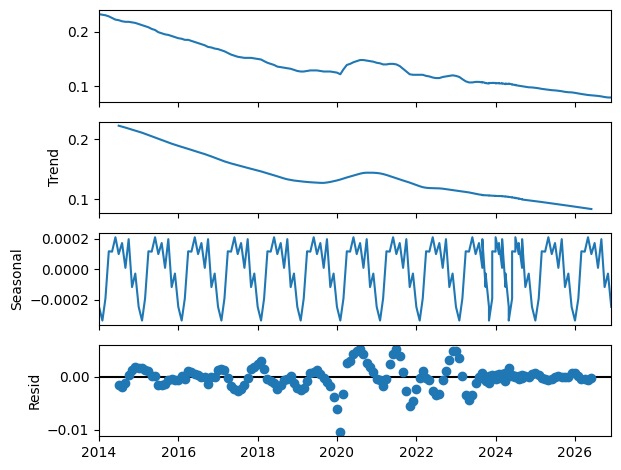

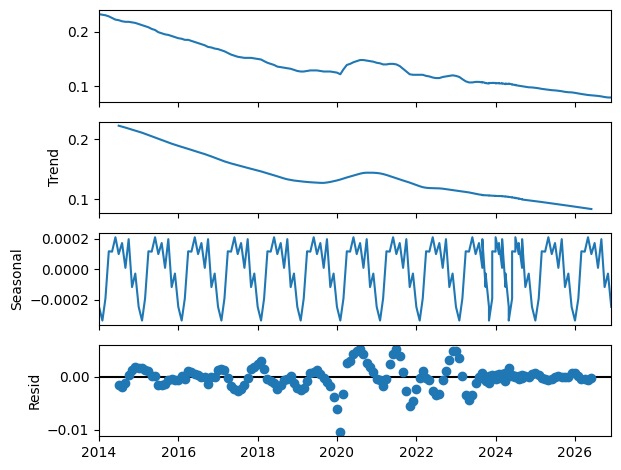

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1426.573, Time=0.96 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1319.639, Time=0.02 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1404.531, Time=0.32 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1415.704, Time=0.41 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-1369.689, Time=0.06 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1414.490, Time=0.65 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=inf, Time=0.52 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1402.817, Time=0.20 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=-1434.906, Time=1.23 sec
 ARIMA(1,1,1)(2,1,2)[12]             : AIC=-1426.817, Time=1.19 sec
 ARIMA(1,1,1)(2,1,1)[12]             : AIC=-1414.627, Time=1.59 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=-1422.564, Time=0.58 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=-1436.640, Time=0.48 sec
 ARIMA(1,1,0)(0,1,2)[12]             : AIC=inf, Time=0.59 sec
 ARIMA(1,1,0)(1,1

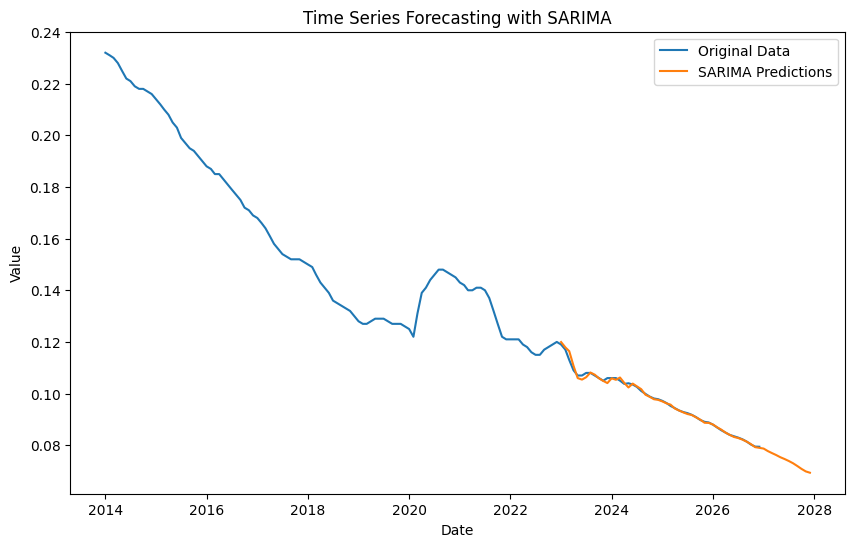

SARIMA - MSE: 6.929046462925232e-07, RMSE: 0.0008324089417422924, MAPE: 0.48%


In [ ]:
model_sarima(data_filtered,'Spain', '25+', 'Total')

# Slovenia

The decomposition for all age categories and genders in Slovenia reveals a clearly defined downward trend, where the values steadily decrease over time with some fluctuations, particularly in the earlier years. The seasonal component shows a strong and regular annual cycle, with pronounced peaks and valleys, indicating significant seasonality. The residuals are relatively small, with minor deviations, suggesting that the model has effectively captured the main underlying patterns.

This data exhibits both a strong trend and seasonality, making SARIMA an ideal model to apply, as it can effectively account for both these components. The consistent seasonal pattern alongside the well-defined trend supports the use of SARIMA for accurate forecasting across all age categories and genders in Slovenia. Given the similar characteristics in Slovenia, SARIMA is also the optimal choice for Slovenia's dataset.

### 15-24, Male

In [ ]:
data_filtered = prepare_data(combined_df, country='Slovenia', age='15-24', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.8994
Strong seasonality detected.


(0.8993528898247537, True)

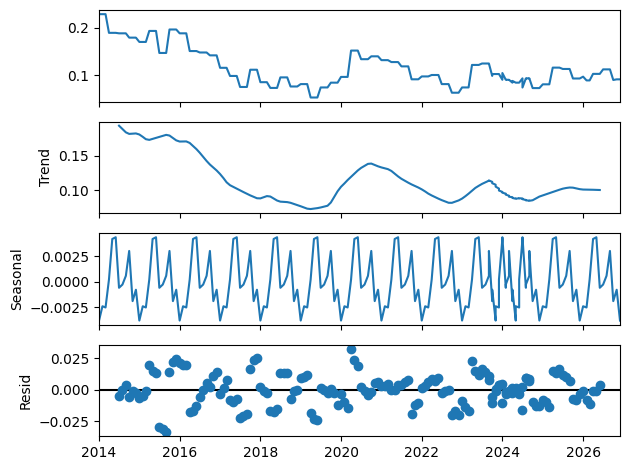

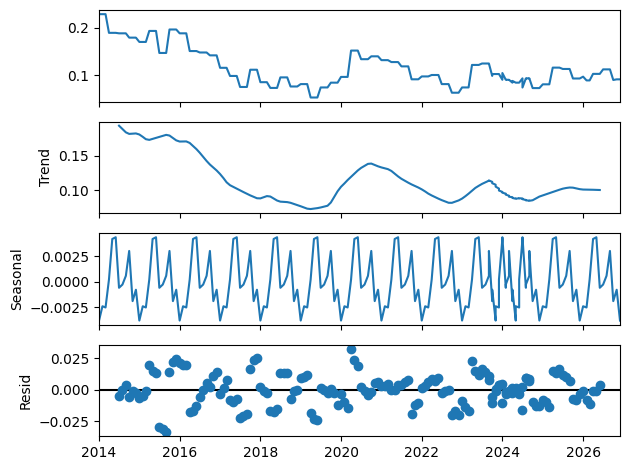

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-806.815, Time=4.06 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-728.809, Time=0.08 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-811.235, Time=0.80 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-808.814, Time=1.11 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-726.805, Time=0.03 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-828.209, Time=1.55 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=-834.524, Time=6.72 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=-825.716, Time=0.57 sec
 ARIMA(1,1,0)(2,1,2)[12]             : AIC=-832.759, Time=2.13 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=-821.723, Time=2.11 sec
 ARIMA(0,1,0)(2,1,1)[12]             : AIC=-836.101, Time=0.76 sec
 ARIMA(0,1,0)(1,1,1)[12]             : AIC=-827.712, Time=0.60 sec
 ARIMA(0,1,0)(2,1,0)[12]             : AIC=-830.205, Time=0.74 sec
 ARIMA(0,1,0)(2,1,2)[12]             : AIC=-833.983, Time=2.07 sec
 ARIMA(0,1,0)(1,1,0

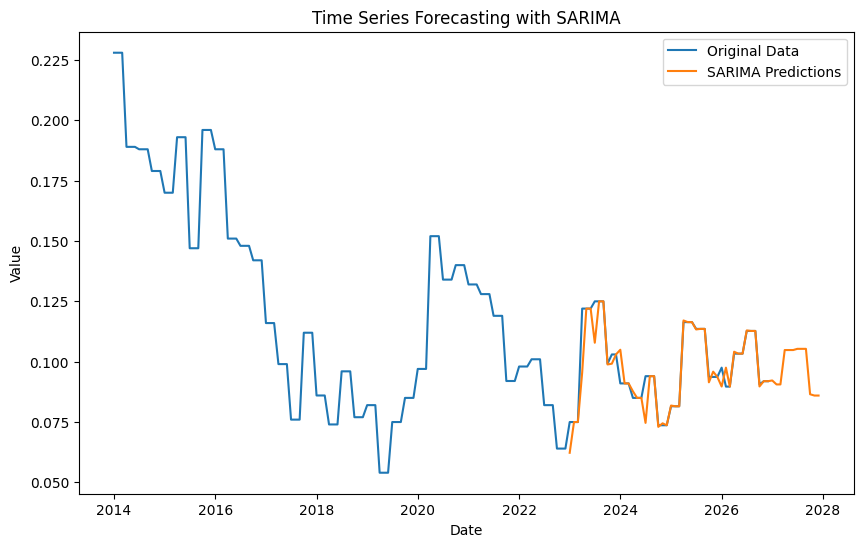

SARIMA - MSE: 3.9231961051210385e-05, RMSE: 0.006263542212774684, MAPE: 2.54%


In [ ]:
model_sarima(data_filtered,'Slovenia', '15-24', 'Male')

### 15-24, Female

In [ ]:
data_filtered = prepare_data(combined_df, country='Slovenia', age='15-24', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.8488
Strong seasonality detected.


(0.8488423509965961, True)

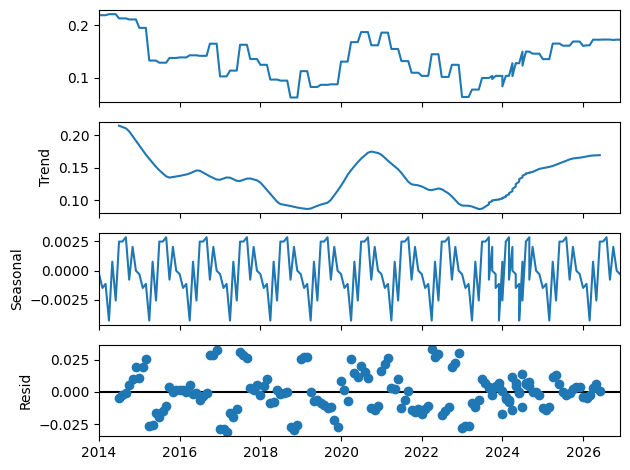

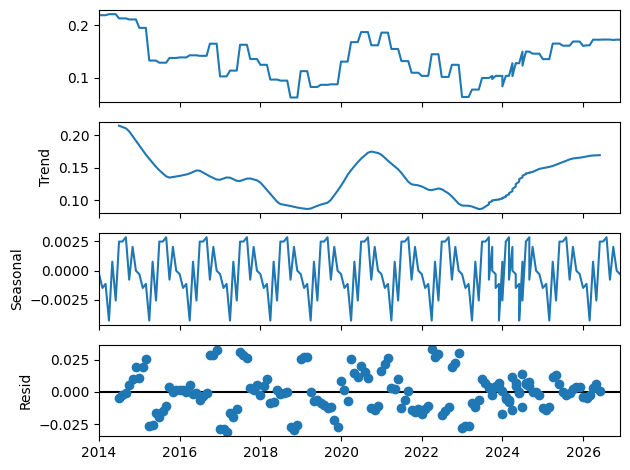

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=1.33 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-694.891, Time=0.03 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-714.617, Time=0.46 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=0.82 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-692.891, Time=0.21 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-736.126, Time=0.36 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=inf, Time=2.40 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=inf, Time=1.41 sec
 ARIMA(0,1,0)(2,1,0)[12]             : AIC=-738.127, Time=0.53 sec
 ARIMA(0,1,0)(1,1,0)[12]             : AIC=-716.617, Time=0.09 sec
 ARIMA(0,1,0)(2,1,1)[12]             : AIC=inf, Time=1.35 sec
 ARIMA(0,1,0)(1,1,1)[12]             : AIC=inf, Time=0.53 sec
 ARIMA(0,1,1)(2,1,0)[12]             : AIC=-736.126, Time=0.87 sec
 ARIMA(1,1,1)(2,1,0)[12]             : AIC=-734.126, Time=0.93 sec
 ARIMA(0,1,0)(2,1,0)[12] intercept   : AIC=-736.3

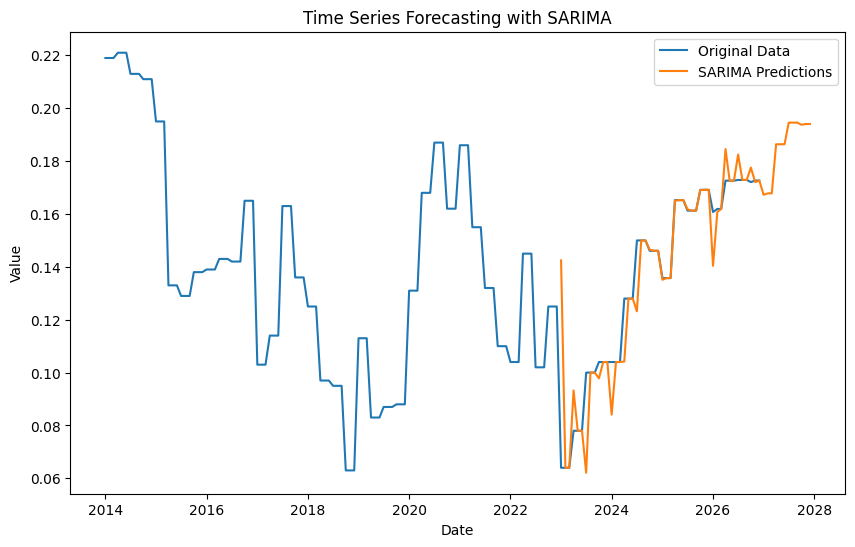

SARIMA - MSE: 0.0002129950953549426, RMSE: 0.014594351487988173, MAPE: 5.67%


In [ ]:
model_sarima(data_filtered,'Slovenia', '15-24', 'Female')

### 15-24, Total

In [ ]:
data_filtered = prepare_data(combined_df, country='Slovenia', age='15-24', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9206
Strong seasonality detected.


(0.9205669369512348, True)

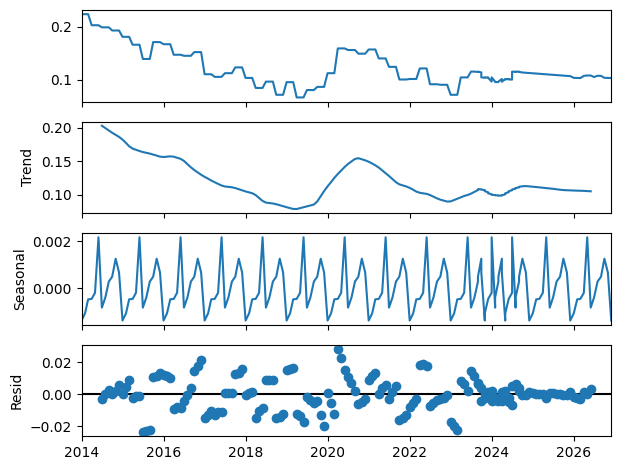

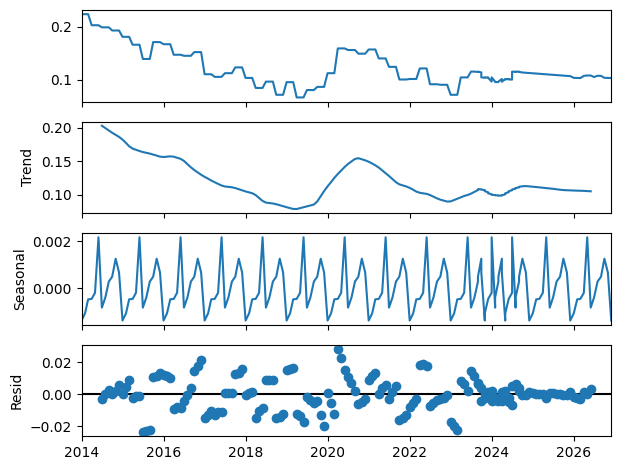

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-865.544, Time=1.62 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-816.097, Time=0.04 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-843.537, Time=0.35 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-867.479, Time=0.64 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-814.103, Time=0.04 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-866.897, Time=1.45 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=inf, Time=0.85 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=-843.536, Time=0.36 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=inf, Time=0.92 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=-869.543, Time=0.56 sec
 ARIMA(0,1,0)(1,1,1)[12]             : AIC=inf, Time=1.07 sec
 ARIMA(0,1,0)(0,1,2)[12]             : AIC=inf, Time=0.71 sec
 ARIMA(0,1,0)(1,1,0)[12]             : AIC=-845.546, Time=0.31 sec
 ARIMA(0,1,0)(1,1,2)[12]             : AIC=inf, Time=2.66 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-

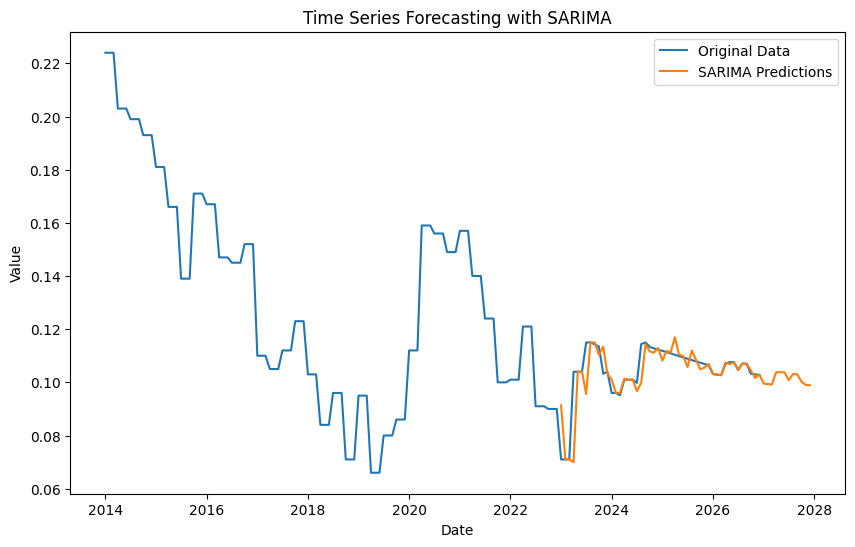

SARIMA - MSE: 5.030345768980644e-05, RMSE: 0.007092493051798249, MAPE: 3.02%


In [ ]:
model_sarima(data_filtered,'Slovenia', '15-24', 'Total')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=-967.101, Time=1.07 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-867.427, Time=0.03 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-909.922, Time=0.07 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.31 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-869.427, Time=0.06 sec
 ARIMA(2,2,1)(0,0,0)[0] intercept   : AIC=-949.397, Time=0.36 sec
 ARIMA(1,2,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.23 sec
 ARIMA(0,2,2)(0,0,0)[0] intercept   : AIC=-955.530, Time=0.09 sec
 ARIMA(2,2,0)(0,0,0)[0] intercept   : AIC=-920.201, Time=0.10 sec
 ARIMA(2,2,2)(0,0,0)[0] intercept   : AIC=-959.037, Time=0.46 sec
 ARIMA(1,2,1)(0,0,0)[0]             : AIC=inf, Time=0.46 sec

Best model:  ARIMA(1,2,1)(0,0,0)[0] intercept
Total fit time: 3.255 seconds
                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                  156
Model:     

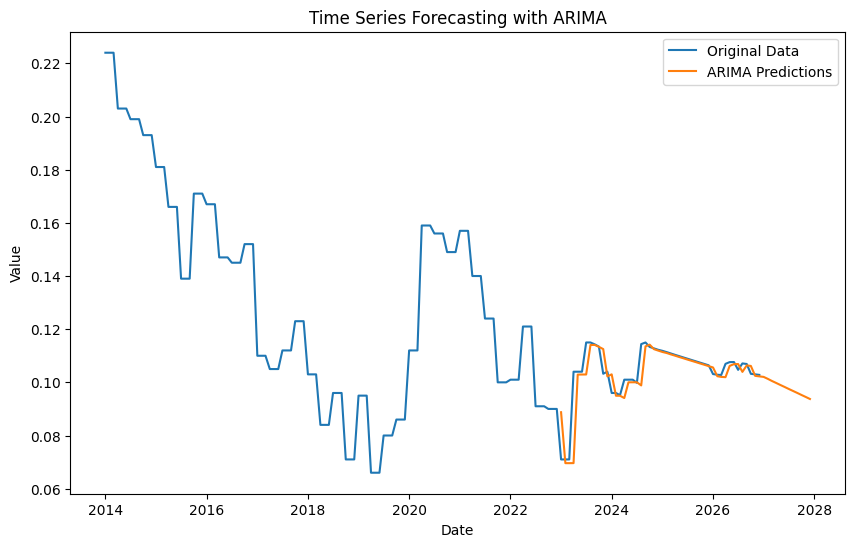

ARIMA - MSE: 4.467048946521472e-05, RMSE: 0.006683598541595293, MAPE: 2.99%


In [ ]:
model_arima(data_filtered,'Slovenia', '15-24', 'Total')

### 25+, Male

In [ ]:
data_filtered = prepare_data(combined_df, country='Slovenia', age='25+', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9734
Strong seasonality detected.


(0.9733625990651881, True)

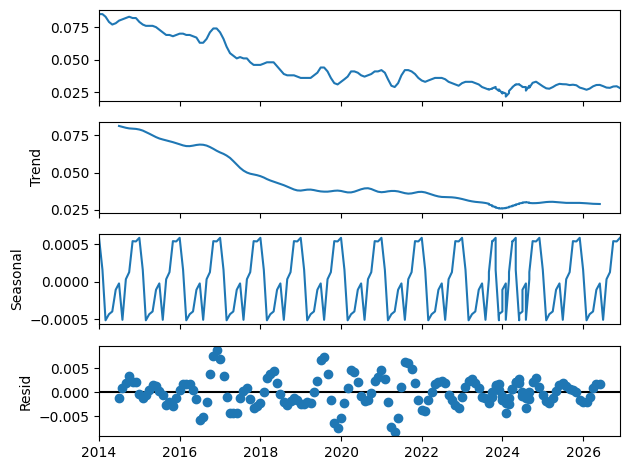

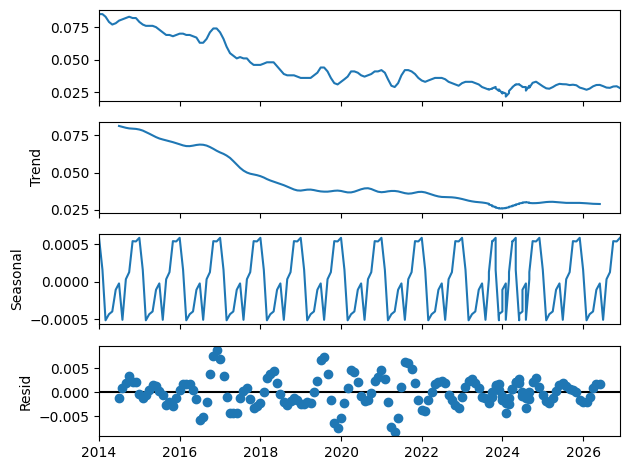

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1401.535, Time=1.85 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1238.846, Time=0.09 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1387.206, Time=0.69 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1369.131, Time=0.36 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-1329.463, Time=0.51 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1391.215, Time=0.44 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1393.181, Time=2.20 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1393.951, Time=1.26 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=-1371.901, Time=2.92 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1389.915, Time=0.99 sec
 ARIMA(2,1,1)(0,1,1)[12]             : AIC=-1432.655, Time=1.44 sec
 ARIMA(2,1,1)(0,1,0)[12]             : AIC=-1381.051, Time=0.38 sec
 ARIMA(2,1,1)(1,1,1)[12]             : AIC=-1411.014, Time=2.28 sec
 ARIMA(2,1,1)(0,1,2)[12]             : AIC=-1429.094, Time=4.32 sec
 ARIM

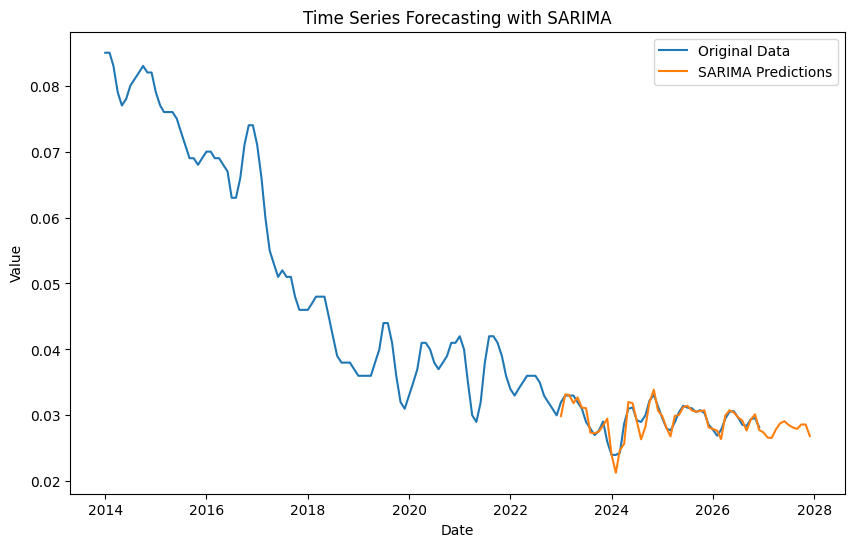

SARIMA - MSE: 1.2537431458819312e-06, RMSE: 0.0011197067231565286, MAPE: 2.59%


In [ ]:
model_sarima(data_filtered,'Slovenia', '25+', 'Male')

### 25+, Female

In [ ]:
data_filtered = prepare_data(combined_df, country='Slovenia', age='25+', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9880
Strong seasonality detected.


(0.9879630334321872, True)

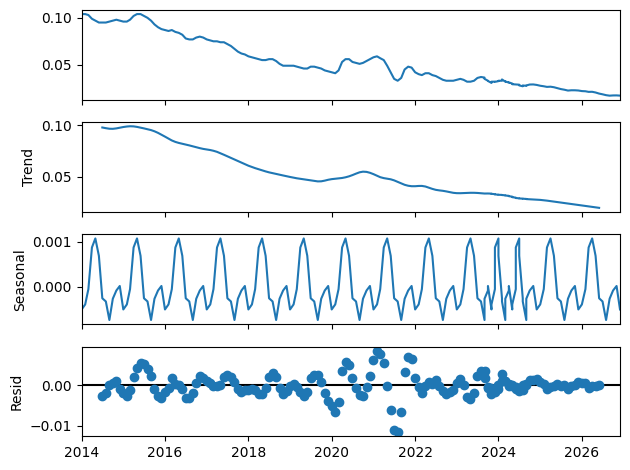

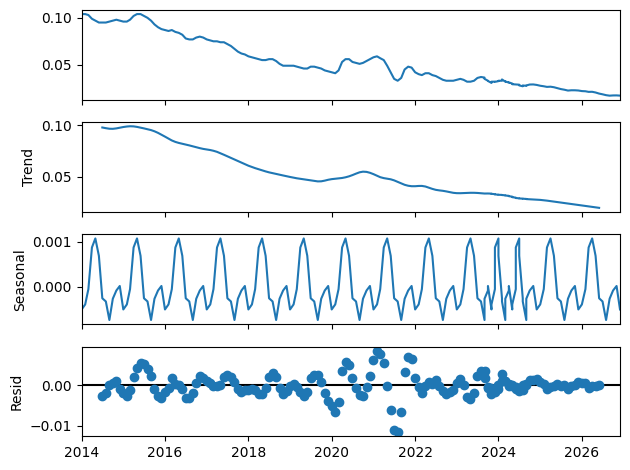

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1392.543, Time=0.90 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1238.032, Time=0.10 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1342.321, Time=0.51 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1344.487, Time=1.12 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-1327.006, Time=0.22 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1373.460, Time=0.40 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1323.011, Time=0.87 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1358.082, Time=0.27 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=-1354.167, Time=0.73 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1379.351, Time=1.00 sec
 ARIMA(2,1,1)(0,1,1)[12]             : AIC=-1412.586, Time=0.74 sec
 ARIMA(2,1,1)(0,1,0)[12]             : AIC=-1352.605, Time=0.43 sec
 ARIMA(2,1,1)(1,1,1)[12]             : AIC=-1393.618, Time=1.78 sec
 ARIMA(2,1,1)(0,1,2)[12]             : AIC=-1348.605, Time=1.29 sec
 ARIM

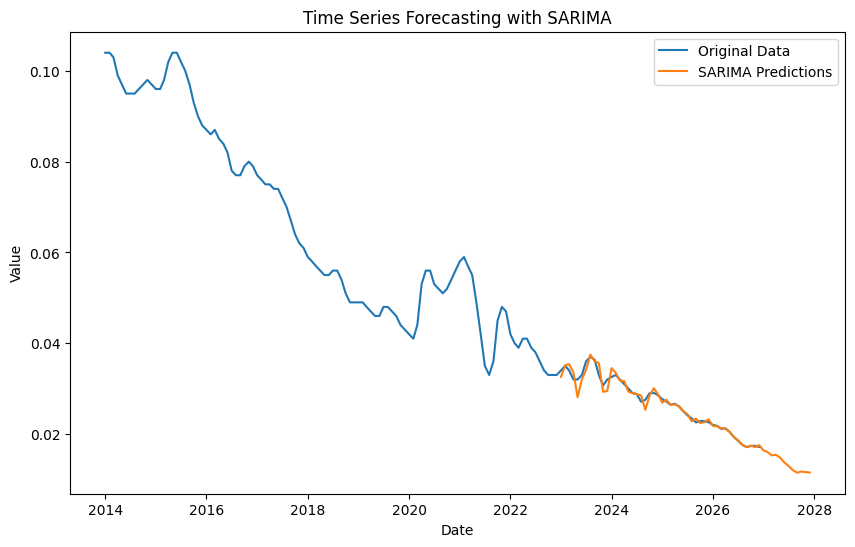

SARIMA - MSE: 1.1957555431372655e-06, RMSE: 0.0010935060782351718, MAPE: 2.36%


In [ ]:
model_sarima(data_filtered,'Slovenia', '25+', 'Female')

### 25+, Total

In [ ]:
data_filtered = prepare_data(combined_df, country='Slovenia', age='25+', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9900
Strong seasonality detected.


(0.9900001332835399, True)

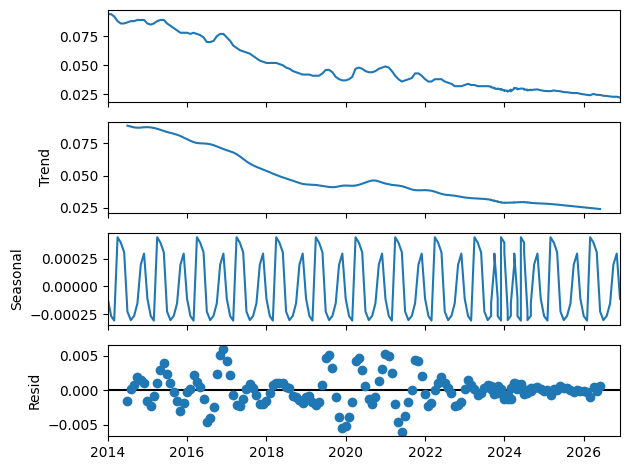

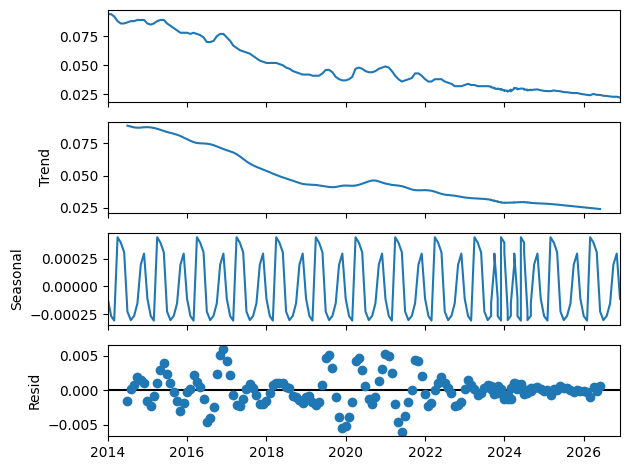

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1446.094, Time=1.53 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1301.112, Time=0.09 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1434.061, Time=0.43 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1438.279, Time=0.67 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-1366.555, Time=0.22 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1436.001, Time=0.32 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1362.555, Time=0.84 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1437.656, Time=0.93 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=-1433.849, Time=1.58 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1441.717, Time=0.35 sec
 ARIMA(2,1,1)(0,1,1)[12]             : AIC=-1367.741, Time=1.34 sec
 ARIMA(1,1,2)(0,1,1)[12]             : AIC=-1435.205, Time=0.44 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=-1381.997, Time=0.52 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=-1453.318, Time=0.40 sec
 ARIM

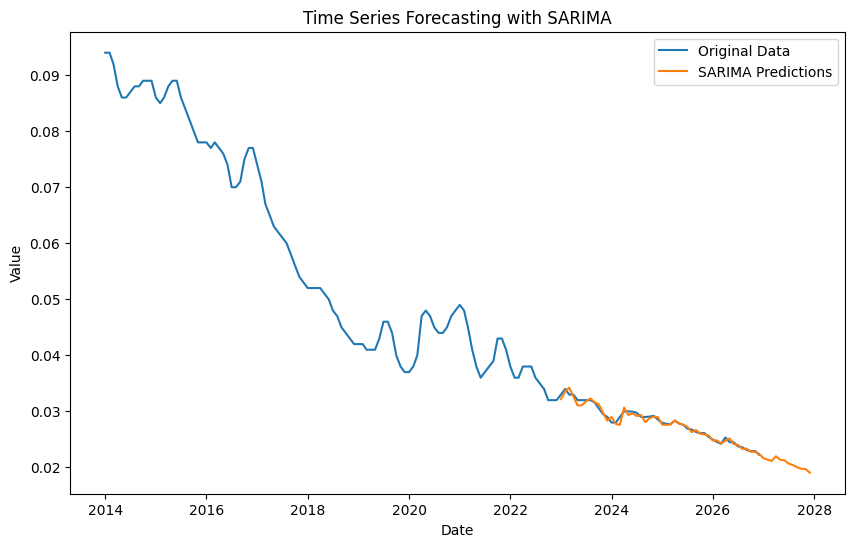

SARIMA - MSE: 2.6952118618981363e-07, RMSE: 0.0005191542990189079, MAPE: 1.40%


In [ ]:
model_sarima(data_filtered,'Slovenia', '25+', 'Total')

# Norway

The decomposition for the 15-24 age category across all genders in Norway shows very weak seasonality, with minimal fluctuations in the seasonal component. The trend is present but less pronounced compared to other countries, and the residuals suggest that much of the variability in the data is not driven by seasonality. As a result, SARIMA performed poorly for this dataset due to the lack of strong seasonal patterns.

Given these characteristics, ARIMA provided better results than SARIMA, as it does not rely on seasonality but can still capture the trend in the data. However, the best results were achieved using XGBoost, which was able to capture the complex non-linear relationships in the data and produce more accurate forecasts, as it does not rely on a clearly defined trend or seasonality.

For the 25+ age category, there was a more noticeable seasonal pattern, making SARIMA more suitable for this subset, as it was able to account for the seasonal fluctuations and provided better forecasting results in this case.

## 15-24, Male

In [9]:
data_filtered = prepare_data(combined_df, country='Norway', age='15-24', sex='Male')

In [10]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.5059
Weak or no seasonality detected.


(0.505925610216281, False)

The seasonal strength for the 15–24 Male population in Norway is 0.4948, indicating weak or no significant seasonality. This suggests that the variability in the data is not driven by consistent annual cycles but rather by other factors or noise. The absence of a strong seasonal pattern implies that seasonality does not play a major role in this demographic group.

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-779.056, Time=2.36 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-646.135, Time=0.08 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-708.244, Time=2.48 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=0.62 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-717.592, Time=0.29 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=inf, Time=1.64 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=inf, Time=2.61 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-744.170, Time=1.78 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=inf, Time=4.48 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=inf, Time=1.76 sec
 ARIMA(2,1,1)(0,1,1)[12]             : AIC=inf, Time=2.43 sec
 ARIMA(1,1,2)(0,1,1)[12]             : AIC=inf, Time=2.29 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=inf, Time=0.86 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=inf, Time=1.25 sec
 ARIMA(2,1,0)(0,1,1)[12]             : AIC=inf, Time=1.53 sec
 A

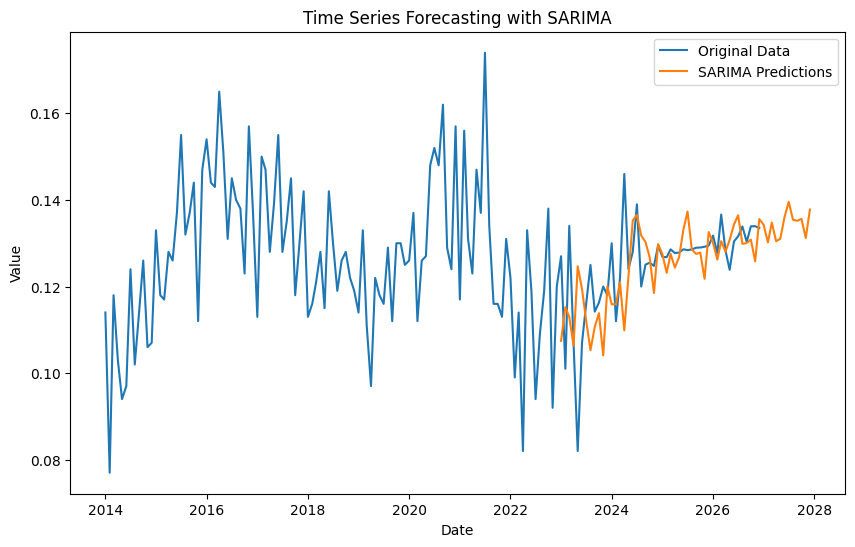

SARIMA - MSE: 0.0001227408872931239, RMSE: 0.011078848644743004, MAPE: 5.80%


In [ ]:
model_sarima(data_filtered,'Norway', '15-24', 'Male')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=-819.138, Time=0.98 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-631.358, Time=0.04 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-700.824, Time=0.10 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.45 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-633.348, Time=0.04 sec
 ARIMA(2,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.62 sec
 ARIMA(1,2,2)(0,0,0)[0] intercept   : AIC=-779.674, Time=0.59 sec
 ARIMA(0,2,2)(0,0,0)[0] intercept   : AIC=-867.624, Time=0.52 sec
 ARIMA(0,2,3)(0,0,0)[0] intercept   : AIC=-859.307, Time=0.72 sec
 ARIMA(1,2,3)(0,0,0)[0] intercept   : AIC=-866.833, Time=0.95 sec
 ARIMA(0,2,2)(0,0,0)[0]             : AIC=inf, Time=0.42 sec

Best model:  ARIMA(0,2,2)(0,0,0)[0] intercept
Total fit time: 5.436 seconds
                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                  156
Model:     

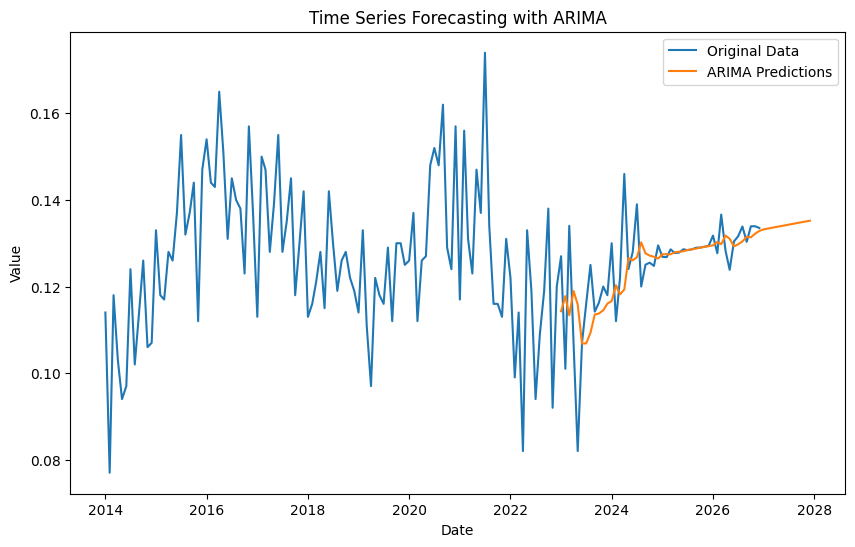

ARIMA - MSE: 8.21689042394157e-05, RMSE: 0.009064706517004051, MAPE: 4.61%


In [ ]:
model_arima(data_filtered,'Norway', '15-24', 'Male')

### XGboost

In [91]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from xgboost import XGBRegressor
from skforecast.ForecasterAutoreg import ForecasterAutoreg
import matplotlib.dates as mdates
from sklearn.metrics import mean_absolute_error

In [92]:
data_filtered.asfreq('MS')
data_filtered.sort_index()

,Value
Date,
2014-01-01,0.114
2014-02-01,0.077
2014-03-01,0.118
2014-04-01,0.103
2014-05-01,0.094
...,...
2024-05-01,0.134
2024-06-01,0.128
2024-07-01,0.123


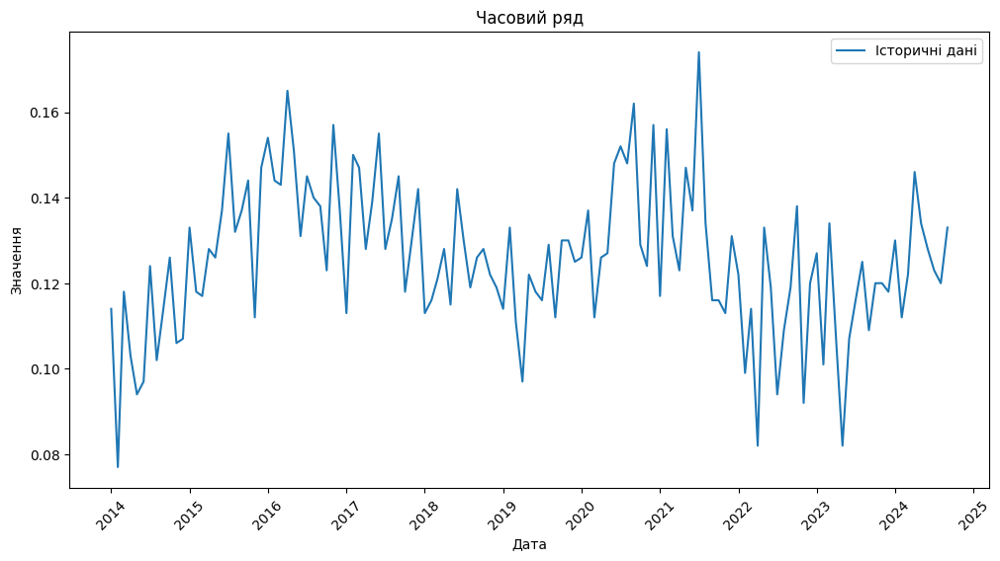

In [93]:
plt.figure(figsize=(12, 6))
plt.plot(data_filtered['Value'], label='Історичні дані')
plt.title('Часовий ряд')
plt.xlabel('Дата')
plt.ylabel('Значення')
plt.legend()

ax = plt.gca()
ax.xaxis.set_major_locator(mdates.YearLocator(1))
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
plt.xticks(rotation=45)
plt.show()

In [94]:
end_train = '2022-12-01'
data_train = data_filtered.loc[:end_train, :]
data_test = data_filtered.loc[end_train:, :]

forecaster = ForecasterAutoreg(
    regressor=XGBRegressor(random_state=42),
    lags=12
)

forecaster.fit(y=data_train['Value'])

def rolling_forecast(data, forecaster, steps, refit=True):
    predictions = []
    test_values = []
    dates = []

    for start in range(len(data) - len(data_train) - steps + 1):
        train_end = start + len(data_train)
        train_data = data.iloc[:train_end]
        test_data = data.iloc[train_end : train_end + steps]

        if refit:
            forecaster.fit(y=train_data['Value'])

        forecast = forecaster.predict(steps=steps)

        predictions.extend(forecast[:len(test_data)])
        test_values.extend(test_data['Value'])
        dates.extend(test_data.index)

    predictions_series = pd.Series(predictions, index=dates)
    test_series = pd.Series(test_values, index=dates)

    return predictions_series, test_series


In [96]:
steps = 12
predictions_series, test_series = rolling_forecast(
    data=data_filtered,
    forecaster=forecaster,
    steps=steps,
    refit=True
)

In [99]:
mape = np.mean(np.abs((data_test['Value'] - test_series) / data_test['Value'])) * 100
print(f'MAPE: {mape:.9f}%')
rmse = np.sqrt(np.mean((data_test['Value'] - test_series) ** 2))
print(f'RMSE: {rmse:.9f}')
mse = np.mean((data_test['Value'] - test_series) ** 2)
print(f'MSE: {mse:.9f}')


MAPE: 0.435797263%
RMSE: 0.000514579
MSE: 0.000000265


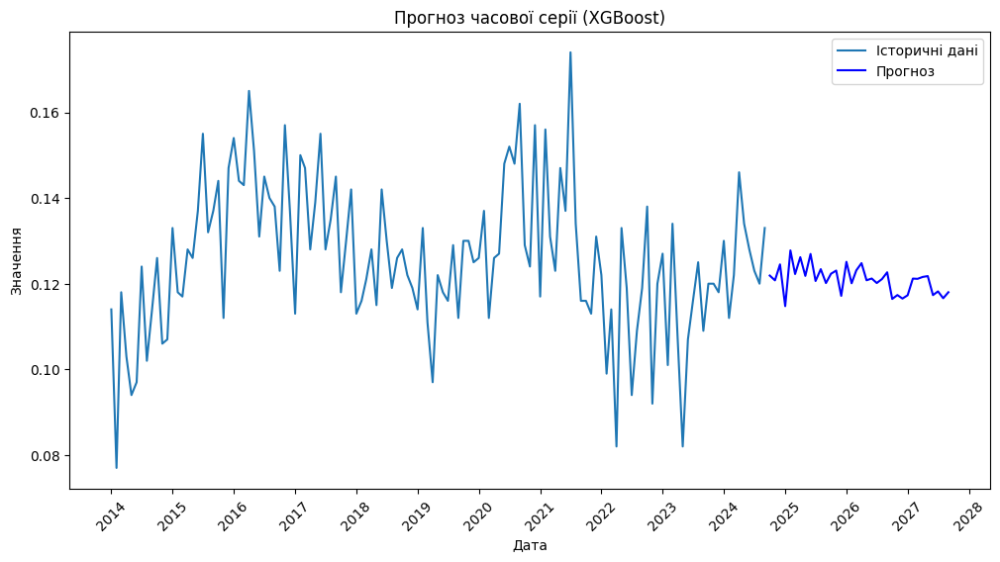

In [100]:
future_steps = 36
forecaster.fit(y=data_filtered['Value'])
forecast = forecaster.predict(steps=future_steps)

last_date = data_filtered.index[-1]
forecast_index = pd.date_range(start=last_date + pd.DateOffset(months=1), periods=future_steps, freq='MS')
forecast_series = pd.Series(data=forecast, index=forecast_index)

plt.figure(figsize=(12, 6))
plt.plot(data_filtered['Value'], label='Історичні дані')
plt.plot(forecast_series, label='Прогноз', color='blue')
plt.title('Прогноз часової серії (XGBoost)')
plt.xlabel('Дата')
plt.ylabel('Значення')
plt.legend()

ax = plt.gca()
ax.xaxis.set_major_locator(mdates.YearLocator(1))
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
plt.xticks(rotation=45)
plt.show()


## 15-24, Female

In [101]:
data_filtered = prepare_data(combined_df, country='Norway', age='15-24', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.4637
Weak or no seasonality detected.


(0.4636973413566894, False)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=1.86 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-635.345, Time=0.03 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-705.611, Time=0.42 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=0.98 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-677.080, Time=0.13 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-720.683, Time=1.08 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=inf, Time=1.83 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=inf, Time=0.69 sec
 ARIMA(0,1,0)(2,1,0)[12]             : AIC=-685.402, Time=0.40 sec
 ARIMA(2,1,0)(2,1,0)[12]             : AIC=-745.101, Time=1.69 sec
 ARIMA(2,1,0)(1,1,0)[12]             : AIC=-727.988, Time=0.50 sec
 ARIMA(2,1,0)(2,1,1)[12]             : AIC=inf, Time=3.64 sec
 ARIMA(2,1,0)(1,1,1)[12]             : AIC=inf, Time=1.27 sec
 ARIMA(3,1,0)(2,1,0)[12]             : AIC=-743.771, Time=1.60 sec
 ARIMA(2,1,1)(2,1,0)[12]             : AIC=-743.8

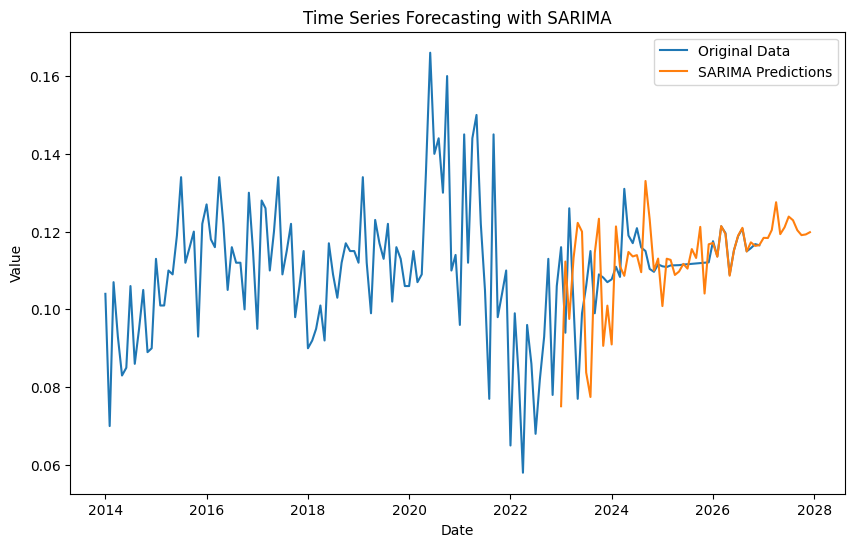

SARIMA - MSE: 0.00020754954943881347, RMSE: 0.01440658007435538, MAPE: 8.53%


In [ ]:
model_sarima(data_filtered,'Norway', '15-24', 'Female')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=-826.667, Time=1.01 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-628.095, Time=0.04 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-705.765, Time=0.11 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=-787.346, Time=0.39 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-630.088, Time=0.05 sec
 ARIMA(2,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.35 sec
 ARIMA(1,2,2)(0,0,0)[0] intercept   : AIC=-833.796, Time=0.38 sec
 ARIMA(0,2,2)(0,0,0)[0] intercept   : AIC=-832.792, Time=0.21 sec
 ARIMA(2,2,2)(0,0,0)[0] intercept   : AIC=-846.472, Time=0.86 sec
 ARIMA(3,2,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.76 sec
 ARIMA(2,2,3)(0,0,0)[0] intercept   : AIC=-829.408, Time=0.52 sec
 ARIMA(1,2,3)(0,0,0)[0] intercept   : AIC=-830.130, Time=0.28 sec
 ARIMA(3,2,1)(0,0,0)[0] intercept   : AIC=-839.512, Time=0.66 sec
 ARIMA(3,2,3)(0,0,0)[0] intercept   : AIC=-842.924, Time=0.26 sec
 ARIMA(2,2,2)(0,0,0)[0]             : AIC=i

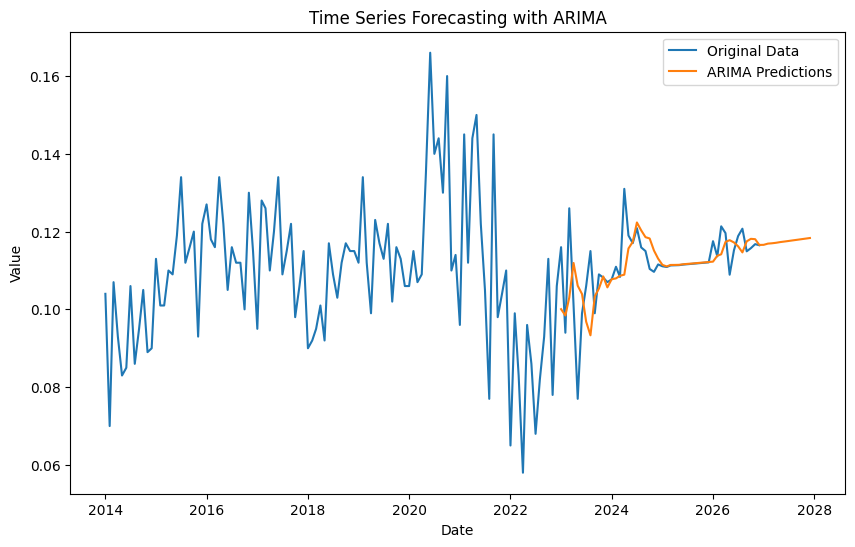

ARIMA - MSE: 6.749931139157495e-05, RMSE: 0.008215796455096423, MAPE: 4.33%


In [ ]:
model_arima(data_filtered,'Norway', '15-24', 'Female')

### XGboost

In [103]:
data_filtered.asfreq('MS')
data_filtered.sort_index()

,Value
Date,
2014-01-01,0.104
2014-02-01,0.070
2014-03-01,0.107
2014-04-01,0.093
2014-05-01,0.083
...,...
2024-05-01,0.119
2024-06-01,0.113
2024-07-01,0.108


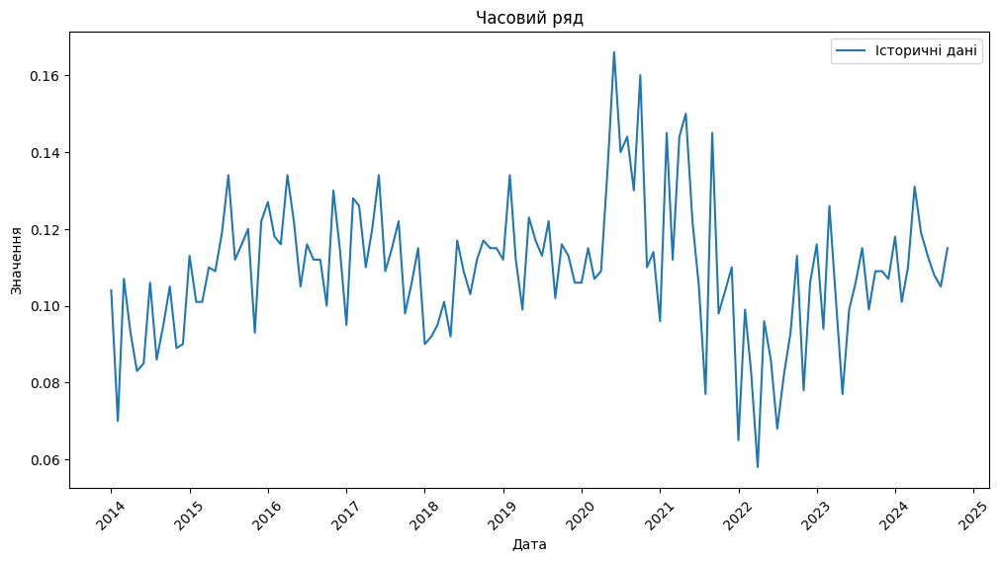

In [104]:
plt.figure(figsize=(12, 6))
plt.plot(data_filtered['Value'], label='Історичні дані')
plt.title('Часовий ряд')
plt.xlabel('Дата')
plt.ylabel('Значення')
plt.legend()

ax = plt.gca()
ax.xaxis.set_major_locator(mdates.YearLocator(1))
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
plt.xticks(rotation=45)
plt.show()

In [105]:
end_train = '2022-12-01'
data_train = data_filtered.loc[:end_train, :]
data_test = data_filtered.loc[end_train:, :]

forecaster = ForecasterAutoreg(
    regressor=XGBRegressor(random_state=42),
    lags=12
)

forecaster.fit(y=data_train['Value'])

def rolling_forecast(data, forecaster, steps, refit=True):
    predictions = []
    test_values = []
    dates = []

    for start in range(len(data) - len(data_train) - steps + 1):
        train_end = start + len(data_train)
        train_data = data.iloc[:train_end]
        test_data = data.iloc[train_end : train_end + steps]

        if refit:
            forecaster.fit(y=train_data['Value'])

        forecast = forecaster.predict(steps=steps)

        predictions.extend(forecast[:len(test_data)])
        test_values.extend(test_data['Value'])
        dates.extend(test_data.index)

    predictions_series = pd.Series(predictions, index=dates)
    test_series = pd.Series(test_values, index=dates)

    return predictions_series, test_series


In [106]:
steps = 12
predictions_series, test_series = rolling_forecast(
    data=data_filtered,
    forecaster=forecaster,
    steps=steps,
    refit=True
)

In [108]:
mape = np.mean(np.abs((data_test['Value'] - test_series) / data_test['Value'])) * 100
print(f'MAPE: {mape:.9f}%')
rmse = np.sqrt(np.mean((data_test['Value'] - test_series) ** 2))
print(f'RMSE: {rmse:.9f}')
mse = np.mean((data_test['Value'] - test_series) ** 2)
print(f'MSE: {mse:.9f}')


MAPE: 0.761236768%
RMSE: 0.000815444
MSE: 0.000000665


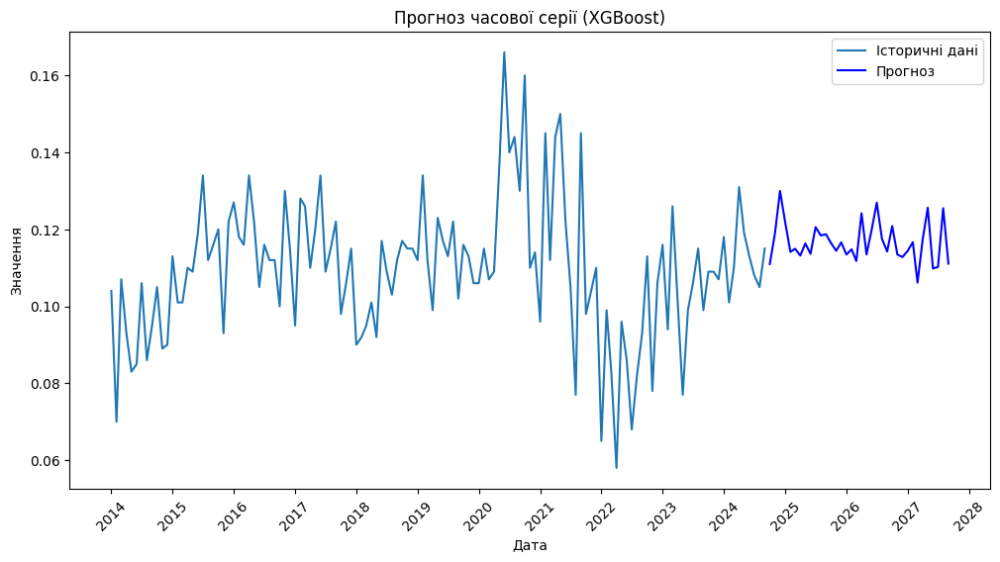

In [109]:
future_steps = 36
forecaster.fit(y=data_filtered['Value'])
forecast = forecaster.predict(steps=future_steps)

last_date = data_filtered.index[-1]
forecast_index = pd.date_range(start=last_date + pd.DateOffset(months=1), periods=future_steps, freq='MS')
forecast_series = pd.Series(data=forecast, index=forecast_index)

plt.figure(figsize=(12, 6))
plt.plot(data_filtered['Value'], label='Історичні дані')
plt.plot(forecast_series, label='Прогноз', color='blue')
plt.title('Прогноз часової серії (XGBoost)')
plt.xlabel('Дата')
plt.ylabel('Значення')
plt.legend()

ax = plt.gca()
ax.xaxis.set_major_locator(mdates.YearLocator(1))
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
plt.xticks(rotation=45)
plt.show()


## 15-24,Total

In [110]:
data_filtered = prepare_data(combined_df, country='Norway', age='15-24', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.5078
Weak or no seasonality detected.


(0.5078078358222724, False)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=1.81 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-668.541, Time=0.02 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-738.621, Time=0.30 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=1.09 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-706.046, Time=0.13 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-752.354, Time=1.02 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=inf, Time=2.01 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=inf, Time=0.79 sec
 ARIMA(0,1,0)(2,1,0)[12]             : AIC=-711.261, Time=0.46 sec
 ARIMA(2,1,0)(2,1,0)[12]             : AIC=-790.181, Time=1.65 sec
 ARIMA(2,1,0)(1,1,0)[12]             : AIC=-773.533, Time=0.67 sec
 ARIMA(2,1,0)(2,1,1)[12]             : AIC=inf, Time=2.42 sec
 ARIMA(2,1,0)(1,1,1)[12]             : AIC=inf, Time=1.63 sec
 ARIMA(3,1,0)(2,1,0)[12]             : AIC=-789.262, Time=2.50 sec
 ARIMA(2,1,1)(2,1,0)[12]             : AIC=-789.1

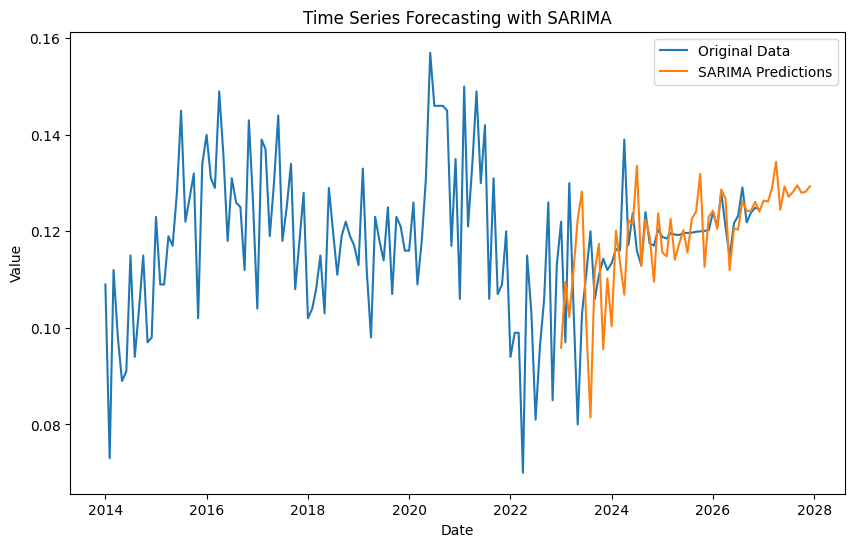

SARIMA - MSE: 0.00016977167283896825, RMSE: 0.013029645921473394, MAPE: 7.17%


In [ ]:
model_sarima(data_filtered,'Norway', '15-24', 'Total')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=1.09 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-653.452, Time=0.08 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-731.486, Time=0.07 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=-815.039, Time=0.44 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-655.442, Time=0.05 sec
 ARIMA(0,2,2)(0,0,0)[0] intercept   : AIC=-869.917, Time=0.81 sec
 ARIMA(1,2,2)(0,0,0)[0] intercept   : AIC=-873.811, Time=0.23 sec
 ARIMA(2,2,2)(0,0,0)[0] intercept   : AIC=-886.113, Time=0.46 sec
 ARIMA(2,2,1)(0,0,0)[0] intercept   : AIC=-885.106, Time=0.38 sec
 ARIMA(3,2,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.65 sec
 ARIMA(2,2,3)(0,0,0)[0] intercept   : AIC=inf, Time=0.47 sec
 ARIMA(1,2,3)(0,0,0)[0] intercept   : AIC=-868.867, Time=0.46 sec
 ARIMA(3,2,1)(0,0,0)[0] intercept   : AIC=-890.294, Time=0.83 sec
 ARIMA(3,2,0)(0,0,0)[0] intercept   : AIC=-851.810, Time=0.15 sec
 ARIMA(2,2,0)(0,0,0)[0] intercept   : AIC=-818.0

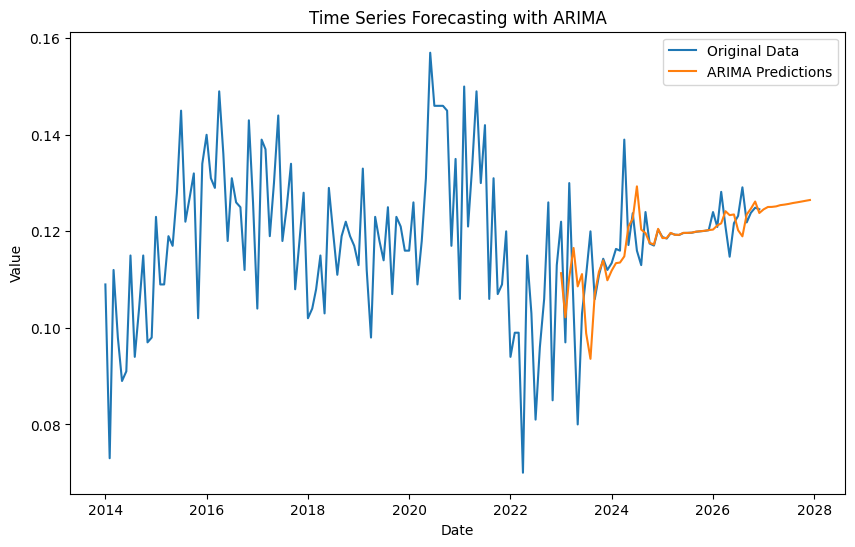

ARIMA - MSE: 7.384347188665276e-05, RMSE: 0.008593222439030237, MAPE: 4.28%


In [ ]:
model_arima(data_filtered,'Norway', '15-24', 'Total')

### XGboost

In [112]:
data_filtered.asfreq('MS')
data_filtered.sort_index()

,Value
Date,
2014-01-01,0.109
2014-02-01,0.073
2014-03-01,0.112
2014-04-01,0.098
2014-05-01,0.089
...,...
2024-05-01,0.127
2024-06-01,0.120
2024-07-01,0.116


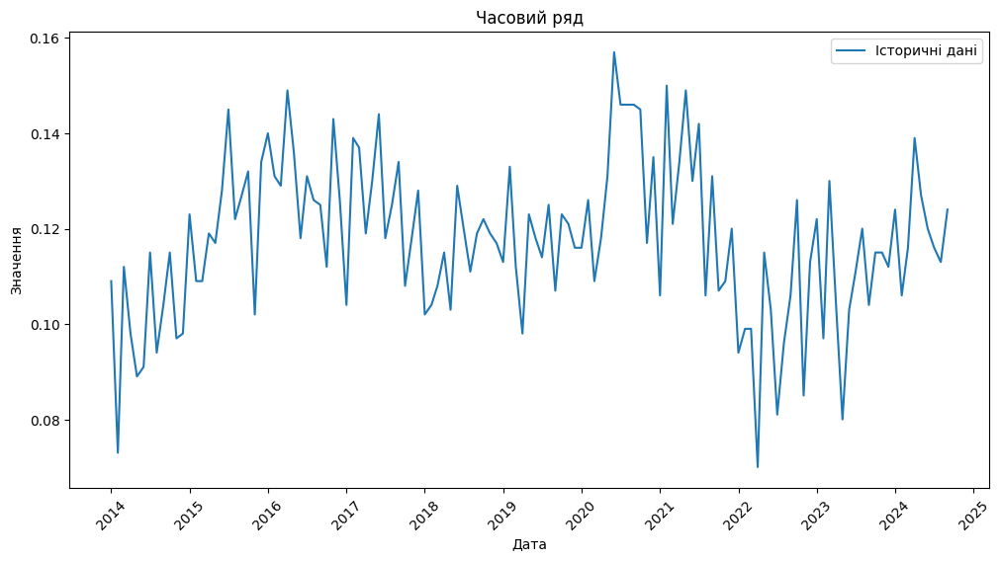

In [113]:
plt.figure(figsize=(12, 6))
plt.plot(data_filtered['Value'], label='Історичні дані')
plt.title('Часовий ряд')
plt.xlabel('Дата')
plt.ylabel('Значення')
plt.legend()

ax = plt.gca()
ax.xaxis.set_major_locator(mdates.YearLocator(1))
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
plt.xticks(rotation=45)
plt.show()

In [114]:
end_train = '2022-12-01'
data_train = data_filtered.loc[:end_train, :]
data_test = data_filtered.loc[end_train:, :]

forecaster = ForecasterAutoreg(
    regressor=XGBRegressor(random_state=42),
    lags=12
)

forecaster.fit(y=data_train['Value'])

def rolling_forecast(data, forecaster, steps, refit=True):
    predictions = []
    test_values = []
    dates = []

    for start in range(len(data) - len(data_train) - steps + 1):
        train_end = start + len(data_train)
        train_data = data.iloc[:train_end]
        test_data = data.iloc[train_end : train_end + steps]

        if refit:
            forecaster.fit(y=train_data['Value'])

        forecast = forecaster.predict(steps=steps)

        predictions.extend(forecast[:len(test_data)])
        test_values.extend(test_data['Value'])
        dates.extend(test_data.index)

    predictions_series = pd.Series(predictions, index=dates)
    test_series = pd.Series(test_values, index=dates)

    return predictions_series, test_series


In [115]:
steps = 12
predictions_series, test_series = rolling_forecast(
    data=data_filtered,
    forecaster=forecaster,
    steps=steps,
    refit=True
)

In [119]:
mape = np.mean(np.abs((data_test['Value'] - test_series) / data_test['Value'])) * 100
print(f'MAPE: {mape:.9f}%')
rmse = np.sqrt(np.mean((data_test['Value'] - test_series) ** 2))
print(f'RMSE: {rmse:.9f}')
mse = np.mean((data_test['Value'] - test_series) ** 2)
print(f'MSE: {mse:}')


MAPE: 4.125473776%
RMSE: 0.004649490
MSE: 2.161775726010005e-05


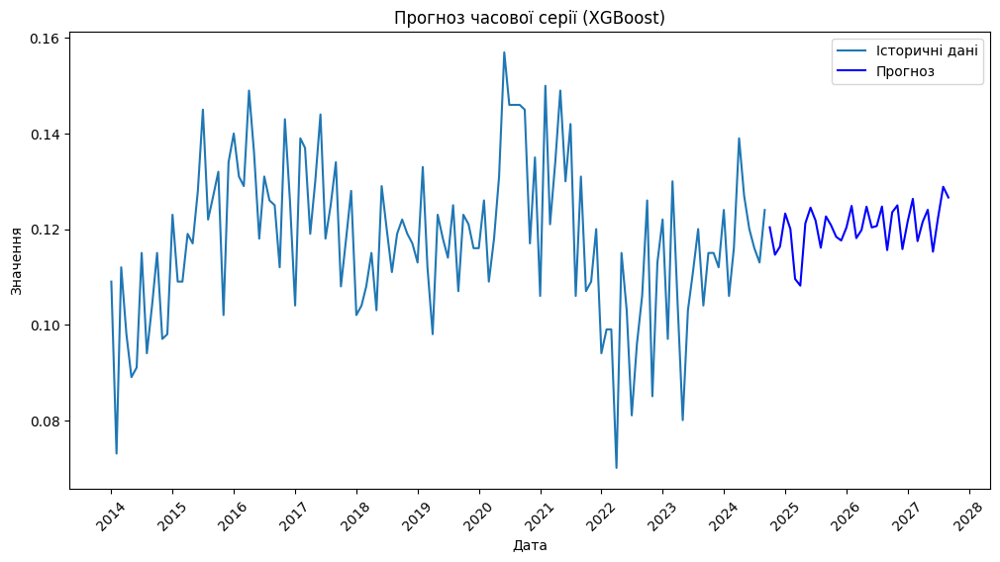

In [120]:
future_steps = 36
forecaster.fit(y=data_filtered['Value'])
forecast = forecaster.predict(steps=future_steps)

last_date = data_filtered.index[-1]
forecast_index = pd.date_range(start=last_date + pd.DateOffset(months=1), periods=future_steps, freq='MS')
forecast_series = pd.Series(data=forecast, index=forecast_index)

plt.figure(figsize=(12, 6))
plt.plot(data_filtered['Value'], label='Історичні дані')
plt.plot(forecast_series, label='Прогноз', color='blue')
plt.title('Прогноз часової серії (XGBoost)')
plt.xlabel('Дата')
plt.ylabel('Значення')
plt.legend()

ax = plt.gca()
ax.xaxis.set_major_locator(mdates.YearLocator(1))
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
plt.xticks(rotation=45)
plt.show()


## 25+, Female

In [67]:
data_filtered = prepare_data(combined_df, country='Norway', age='25+', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.7087
Strong seasonality detected.


(0.708697170307142, True)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1195.905, Time=0.78 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1097.531, Time=0.13 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1154.973, Time=0.57 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1198.334, Time=0.38 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-1127.678, Time=0.08 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=inf, Time=0.90 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=-1198.145, Time=1.10 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=-1166.231, Time=0.53 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=-1190.718, Time=0.98 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=-1166.067, Time=0.43 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=-1201.676, Time=1.05 sec
 ARIMA(0,1,2)(0,1,0)[12]             : AIC=-1125.029, Time=0.33 sec
 ARIMA(0,1,2)(1,1,1)[12]             : AIC=-1197.060, Time=1.94 sec
 ARIMA(0,1,2)(0,1,2)[12]             : AIC=-1195.711, Time=0.58 sec
 ARIMA(0,1,

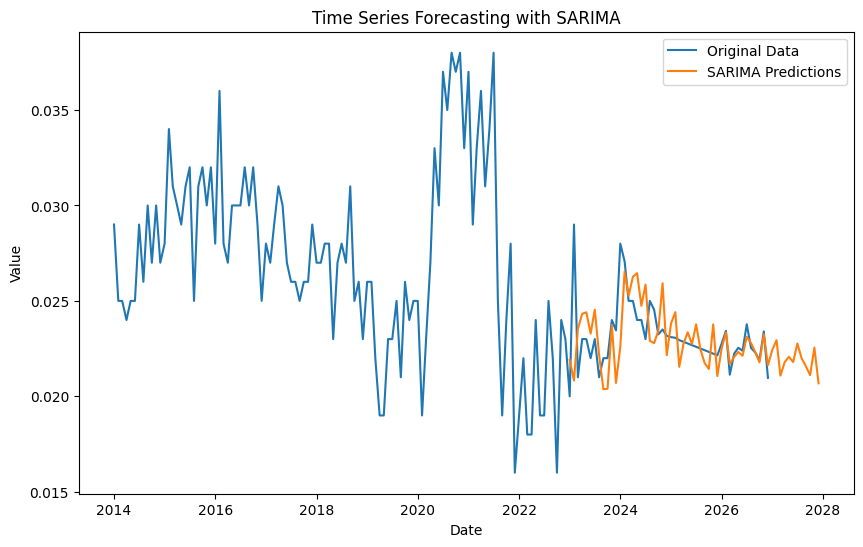

SARIMA - MSE: 3.5721112951971178e-06, RMSE: 0.0018900029881450235, MAPE: 5.19%


In [ ]:
model_sarima(data_filtered,'Norway', '25+', 'Female')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=-1272.855, Time=1.20 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-1142.774, Time=0.04 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-1209.151, Time=0.04 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.35 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-1144.775, Time=0.04 sec
 ARIMA(2,2,1)(0,0,0)[0] intercept   : AIC=-1319.181, Time=0.40 sec
 ARIMA(2,2,0)(0,0,0)[0] intercept   : AIC=-1269.552, Time=0.29 sec
 ARIMA(3,2,1)(0,0,0)[0] intercept   : AIC=-1319.203, Time=0.69 sec
 ARIMA(3,2,0)(0,0,0)[0] intercept   : AIC=-1298.391, Time=0.15 sec
 ARIMA(3,2,2)(0,0,0)[0] intercept   : AIC=-1319.305, Time=0.88 sec
 ARIMA(2,2,2)(0,0,0)[0] intercept   : AIC=-1317.628, Time=0.22 sec
 ARIMA(3,2,3)(0,0,0)[0] intercept   : AIC=-1325.542, Time=0.37 sec
 ARIMA(2,2,3)(0,0,0)[0] intercept   : AIC=-1306.505, Time=0.73 sec
 ARIMA(3,2,3)(0,0,0)[0]             : AIC=-1327.535, Time=0.68 sec
 ARIMA(2,2,3)(0,0,0)[0]  

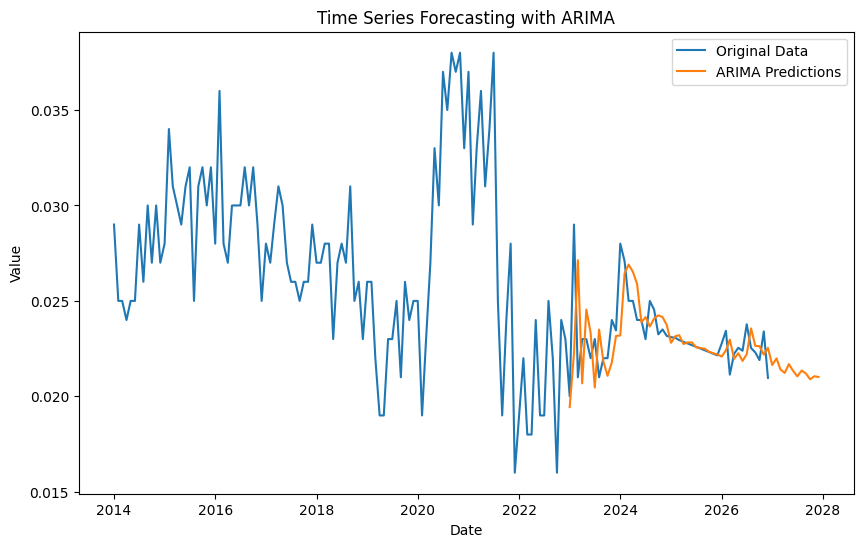

ARIMA - MSE: 3.398491694396408e-06, RMSE: 0.0018434998493074004, MAPE: 4.88%


In [ ]:
model_arima(data_filtered,'Norway', '25+', 'Female')

## 25+, Male

In [76]:
data_filtered = prepare_data(combined_df, country='Norway', age='25+', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.7621
Strong seasonality detected.


(0.7620767197315745, True)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1109.288, Time=1.35 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1027.596, Time=0.09 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1073.165, Time=0.25 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1110.127, Time=0.49 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-1063.454, Time=0.14 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-1096.285, Time=0.42 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=-1123.694, Time=1.95 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=-1121.116, Time=1.76 sec
 ARIMA(0,1,0)(0,1,2)[12]             : AIC=-1085.065, Time=1.13 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1122.482, Time=3.56 sec
 ARIMA(0,1,2)(0,1,2)[12]             : AIC=-1124.197, Time=3.41 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=-1110.103, Time=0.87 sec
 ARIMA(0,1,2)(1,1,2)[12]             : AIC=-1121.514, Time=2.05 sec
 ARIMA(0,1,2)(1,1,1)[12]             : AIC=-1096.074, Time=0.66 sec
 ARIM

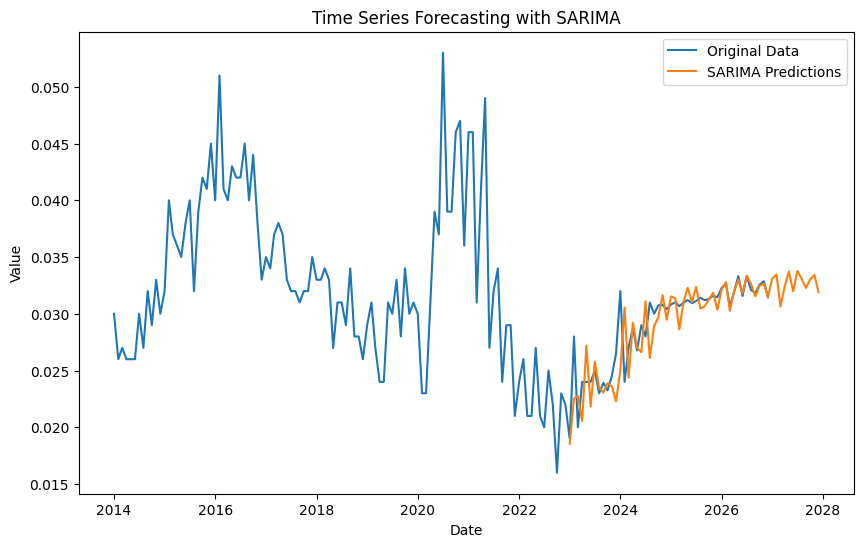

SARIMA - MSE: 4.968297504834527e-06, RMSE: 0.0022289678115294817, MAPE: 5.16%


In [ ]:
model_sarima(data_filtered,'Norway', '25+', 'Male')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=-1181.913, Time=0.81 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-1039.593, Time=0.06 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-1101.892, Time=0.04 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.62 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-1041.593, Time=0.04 sec
 ARIMA(2,2,1)(0,0,0)[0] intercept   : AIC=-1234.939, Time=0.37 sec
 ARIMA(2,2,0)(0,0,0)[0] intercept   : AIC=-1199.994, Time=0.18 sec
 ARIMA(3,2,1)(0,0,0)[0] intercept   : AIC=-1237.817, Time=0.43 sec
 ARIMA(3,2,0)(0,0,0)[0] intercept   : AIC=-1225.222, Time=0.61 sec
 ARIMA(3,2,2)(0,0,0)[0] intercept   : AIC=-1244.501, Time=0.65 sec
 ARIMA(2,2,2)(0,0,0)[0] intercept   : AIC=-1236.181, Time=0.52 sec
 ARIMA(3,2,3)(0,0,0)[0] intercept   : AIC=-1258.991, Time=0.37 sec
 ARIMA(2,2,3)(0,0,0)[0] intercept   : AIC=-1240.563, Time=0.65 sec
 ARIMA(3,2,3)(0,0,0)[0]             : AIC=-1262.142, Time=0.67 sec
 ARIMA(2,2,3)(0,0,0)[0]  

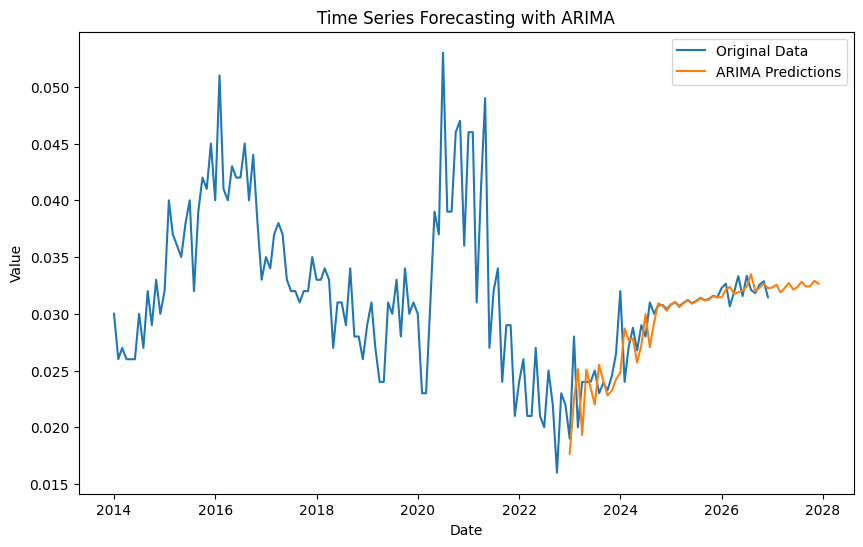

ARIMA - MSE: 4.432800858857589e-06, RMSE: 0.002105421776950545, MAPE: 4.75%


In [ ]:
model_arima(data_filtered,'Norway', '25+', 'Male')

## 25+, Total

In [ ]:
data_filtered = prepare_data(combined_df, country='Norway', age='25+', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.7644
Strong seasonality detected.


(0.7643839295750456, True)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1178.635, Time=1.29 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1100.724, Time=0.16 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1146.106, Time=0.22 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=1.07 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-1130.435, Time=0.11 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1166.306, Time=0.46 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1180.365, Time=1.23 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=-1188.522, Time=3.97 sec
 ARIMA(1,1,1)(2,1,2)[12]             : AIC=-1166.681, Time=2.17 sec
 ARIMA(1,1,1)(2,1,1)[12]             : AIC=-1169.947, Time=1.12 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=-1186.803, Time=1.68 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=-1172.584, Time=1.66 sec
 ARIMA(2,1,1)(1,1,2)[12]             : AIC=-1175.751, Time=2.44 sec
 ARIMA(1,1,2)(1,1,2)[12]             : AIC=-1184.555, Time=1.91 sec
 ARIMA(0,1,

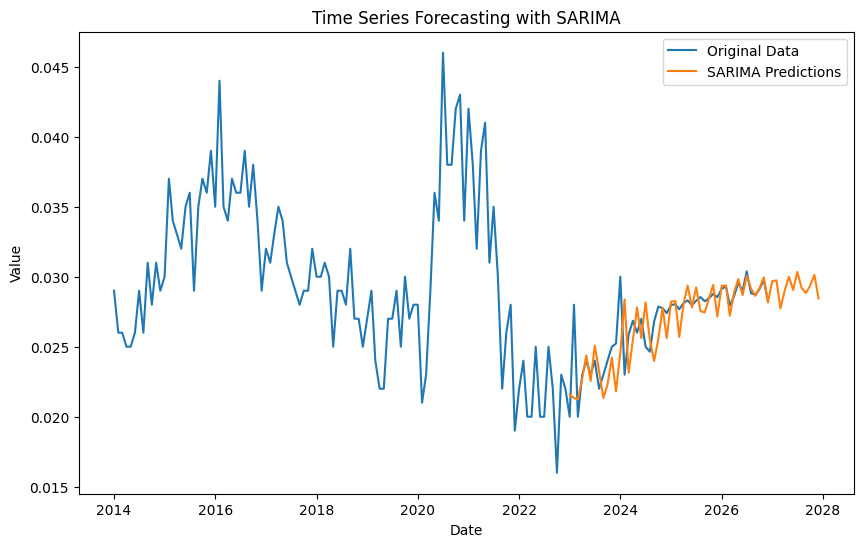

SARIMA - MSE: 3.776927423325903e-06, RMSE: 0.001943431867425741, MAPE: 4.90%


In [ ]:
model_sarima(data_filtered,'Norway', '25+', 'Total')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=-1289.197, Time=0.83 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-1120.888, Time=0.08 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-1189.577, Time=0.08 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.33 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-1122.887, Time=0.02 sec
 ARIMA(2,2,1)(0,0,0)[0] intercept   : AIC=-1298.120, Time=0.16 sec
 ARIMA(2,2,0)(0,0,0)[0] intercept   : AIC=-1271.644, Time=0.18 sec
 ARIMA(3,2,1)(0,0,0)[0] intercept   : AIC=-1301.140, Time=0.24 sec
 ARIMA(3,2,0)(0,0,0)[0] intercept   : AIC=-1289.994, Time=0.12 sec
 ARIMA(3,2,2)(0,0,0)[0] intercept   : AIC=-1299.836, Time=1.14 sec
 ARIMA(2,2,2)(0,0,0)[0] intercept   : AIC=-1299.961, Time=0.30 sec
 ARIMA(3,2,1)(0,0,0)[0]             : AIC=-1303.137, Time=0.31 sec
 ARIMA(2,2,1)(0,0,0)[0]             : AIC=-1303.656, Time=0.31 sec
 ARIMA(1,2,1)(0,0,0)[0]             : AIC=-1297.847, Time=0.15 sec
 ARIMA(2,2,0)(0,0,0)[0]  

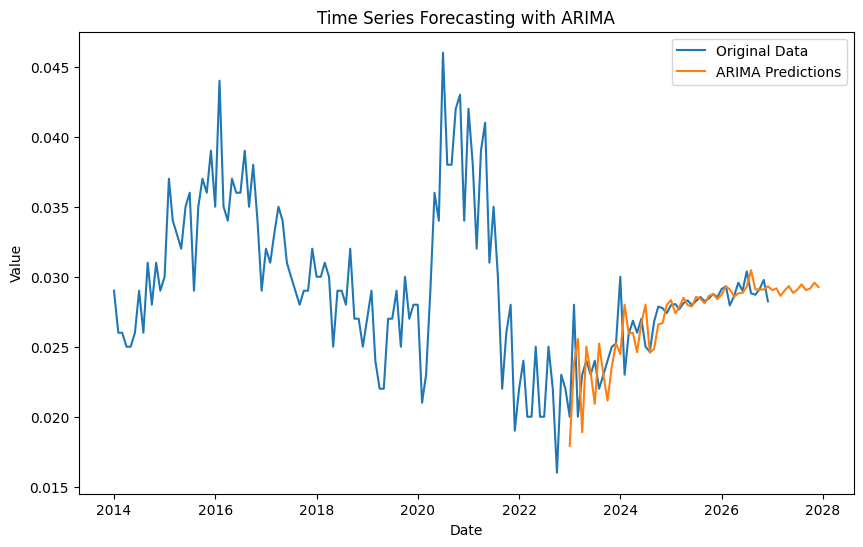

ARIMA - MSE: 3.830522817906419e-06, RMSE: 0.001957172148255339, MAPE: 4.94%


In [ ]:
model_arima(data_filtered,'Norway', '25+', 'Total')

# Latvia


For Latvia, the seasonal strength was around 0.70, indicating moderate seasonality. As a result, both SARIMA and ARIMA models were applied. However, in all categories (age and gender), ARIMA performed better because the seasonality was not clearly defined and was weaker than expected. ARIMA, which does not require a strong seasonal component, proved more effective in capturing the underlying trends and making accurate forecasts for this dataset.

## 15-24, Female

In [ ]:
data_filtered = prepare_data(combined_df, country='Latvia', age='15-24', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.7860
Strong seasonality detected.


(0.7860416835605826, True)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=2.74 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-669.206, Time=0.11 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-780.873, Time=0.33 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=2.56 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-738.350, Time=0.11 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-823.774, Time=0.75 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=inf, Time=2.73 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=inf, Time=2.16 sec
 ARIMA(0,1,0)(2,1,0)[12]             : AIC=-762.744, Time=0.35 sec
 ARIMA(2,1,0)(2,1,0)[12]             : AIC=-875.810, Time=1.87 sec
 ARIMA(2,1,0)(1,1,0)[12]             : AIC=-840.771, Time=0.84 sec
 ARIMA(2,1,0)(2,1,1)[12]             : AIC=-889.813, Time=4.76 sec
 ARIMA(2,1,0)(1,1,1)[12]             : AIC=-889.519, Time=1.74 sec
 ARIMA(2,1,0)(2,1,2)[12]             : AIC=-889.479, Time=4.62 sec
 ARIMA(2,1,0)(1,1,2)[12]             : 

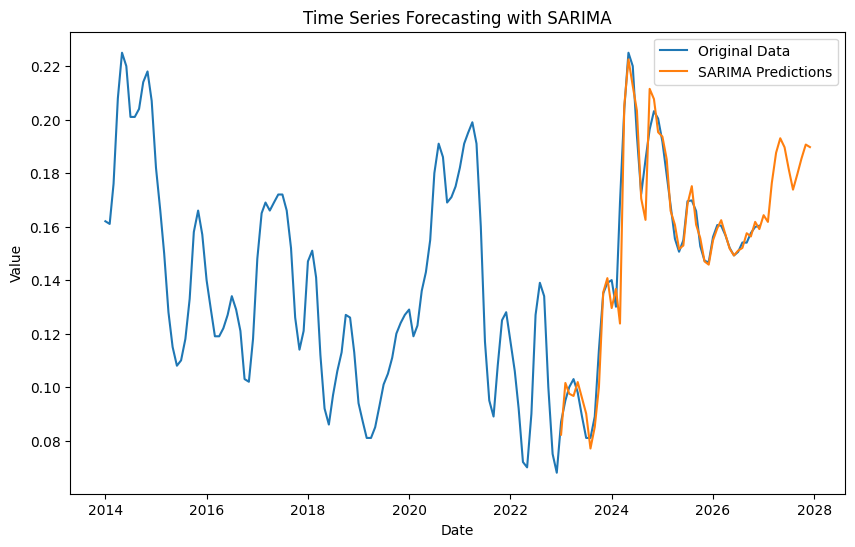

SARIMA - MSE: 7.908117783662677e-05, RMSE: 0.008892759854883452, MAPE: 3.59%


In [ ]:
model_sarima(data_filtered,'Latvia', '15-24', 'Female')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=1.07 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-910.446, Time=0.07 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-918.175, Time=0.09 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=-920.653, Time=0.12 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-912.446, Time=0.05 sec
 ARIMA(0,2,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.42 sec
 ARIMA(1,2,2)(0,0,0)[0] intercept   : AIC=-957.027, Time=0.25 sec
 ARIMA(2,2,2)(0,0,0)[0] intercept   : AIC=-984.318, Time=0.60 sec
 ARIMA(2,2,1)(0,0,0)[0] intercept   : AIC=-972.200, Time=0.54 sec
 ARIMA(3,2,2)(0,0,0)[0] intercept   : AIC=-992.186, Time=0.76 sec
 ARIMA(3,2,1)(0,0,0)[0] intercept   : AIC=-983.769, Time=0.68 sec
 ARIMA(3,2,3)(0,0,0)[0] intercept   : AIC=-990.976, Time=0.43 sec
 ARIMA(2,2,3)(0,0,0)[0] intercept   : AIC=-976.338, Time=0.60 sec
 ARIMA(3,2,2)(0,0,0)[0]             : AIC=-997.393, Time=0.61 sec
 ARIMA(2,2,2)(0,0,0)[0]             : AIC=-

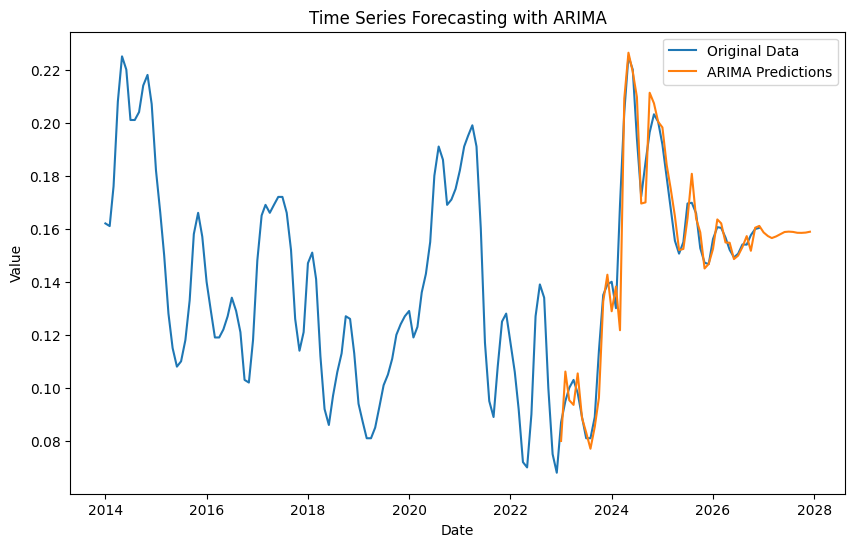

ARIMA - MSE: 9.103483451347892e-05, RMSE: 0.00954121766408664, MAPE: 4.13%


In [ ]:
model_arima(data_filtered,'Latvia', '15-24', 'Female')

## 15-24, Male

In [ ]:
data_filtered = prepare_data(combined_df, country='Latvia', age='15-24', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.5464
Weak or no seasonality detected.


(0.5463851259609913, False)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-845.522, Time=1.59 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-665.026, Time=0.13 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-785.216, Time=0.17 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=1.22 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-780.619, Time=0.37 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-831.952, Time=1.39 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=inf, Time=2.64 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-820.276, Time=0.77 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=-841.886, Time=4.51 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=inf, Time=0.94 sec
 ARIMA(2,1,1)(0,1,1)[12]             : AIC=-880.303, Time=2.91 sec
 ARIMA(2,1,1)(0,1,0)[12]             : AIC=-820.250, Time=0.37 sec
 ARIMA(2,1,1)(1,1,1)[12]             : AIC=-869.955, Time=1.95 sec
 ARIMA(2,1,1)(0,1,2)[12]             : AIC=inf, Time=3.25 sec
 ARIMA(2,1,1)(1,1,0)[12]             : 

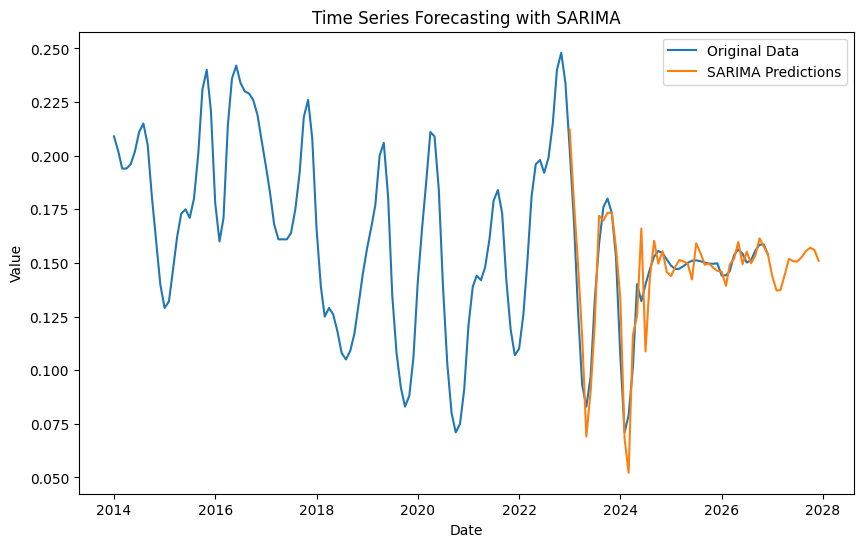

SARIMA - MSE: 0.00013022093486919943, RMSE: 0.011411438772968088, MAPE: 6.28%


In [ ]:
model_sarima(data_filtered,'Latvia', '15-24', 'Male')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=-910.234, Time=1.07 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-888.513, Time=0.09 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-909.444, Time=0.08 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=-909.675, Time=0.15 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-890.513, Time=0.02 sec
 ARIMA(2,2,1)(0,0,0)[0] intercept   : AIC=-931.737, Time=0.52 sec
 ARIMA(2,2,0)(0,0,0)[0] intercept   : AIC=-916.943, Time=0.39 sec
 ARIMA(3,2,1)(0,0,0)[0] intercept   : AIC=-946.316, Time=0.56 sec
 ARIMA(3,2,0)(0,0,0)[0] intercept   : AIC=-947.892, Time=0.12 sec
 ARIMA(3,2,0)(0,0,0)[0]             : AIC=-949.892, Time=0.10 sec
 ARIMA(2,2,0)(0,0,0)[0]             : AIC=-918.942, Time=0.07 sec
 ARIMA(3,2,1)(0,0,0)[0]             : AIC=-948.293, Time=0.16 sec
 ARIMA(2,2,1)(0,0,0)[0]             : AIC=inf, Time=0.36 sec

Best model:  ARIMA(3,2,0)(0,0,0)[0]          
Total fit time: 3.709 seconds
                           

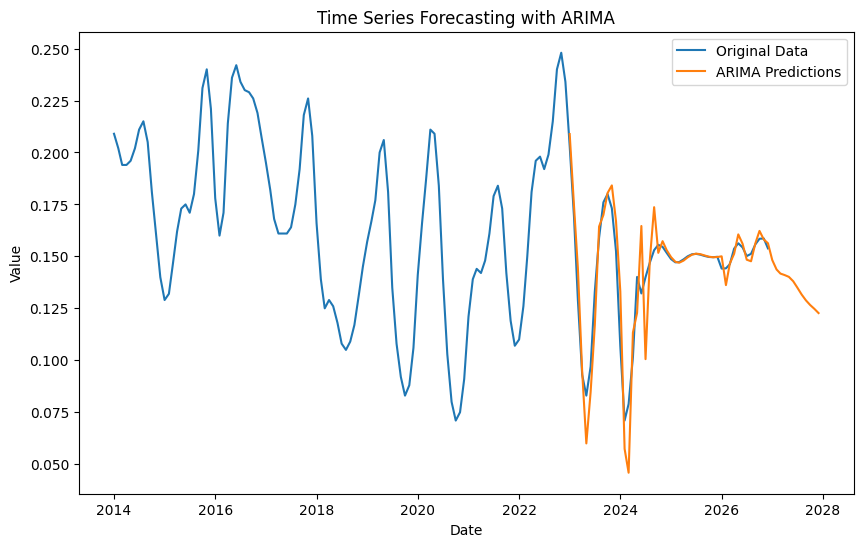

ARIMA - MSE: 0.00015178104669548464, RMSE: 0.01231994507680471, MAPE: 6.31%


In [ ]:
model_arima(data_filtered,'Latvia', '15-24', 'Male')

## 15-24, Total

In [ ]:
data_filtered = prepare_data(combined_df, country='Latvia', age='15-24', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.6538
Weak or no seasonality detected.


(0.6537517583360206, False)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-956.009, Time=2.47 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-806.894, Time=0.05 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-909.113, Time=0.53 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=1.21 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-885.843, Time=0.18 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-946.488, Time=2.70 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-956.552, Time=2.46 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=-954.376, Time=3.94 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=-939.618, Time=2.55 sec
 ARIMA(1,1,0)(0,1,2)[12]             : AIC=-941.120, Time=1.74 sec
 ARIMA(2,1,1)(0,1,2)[12]             : AIC=-967.785, Time=4.27 sec
 ARIMA(2,1,1)(0,1,1)[12]             : AIC=-968.489, Time=2.32 sec
 ARIMA(2,1,1)(0,1,0)[12]             : AIC=-897.064, Time=0.30 sec
 ARIMA(2,1,1)(1,1,1)[12]             : AIC=-963.048, Time=1.92 sec
 ARIMA(2,1,1)(1,1,0)[12]

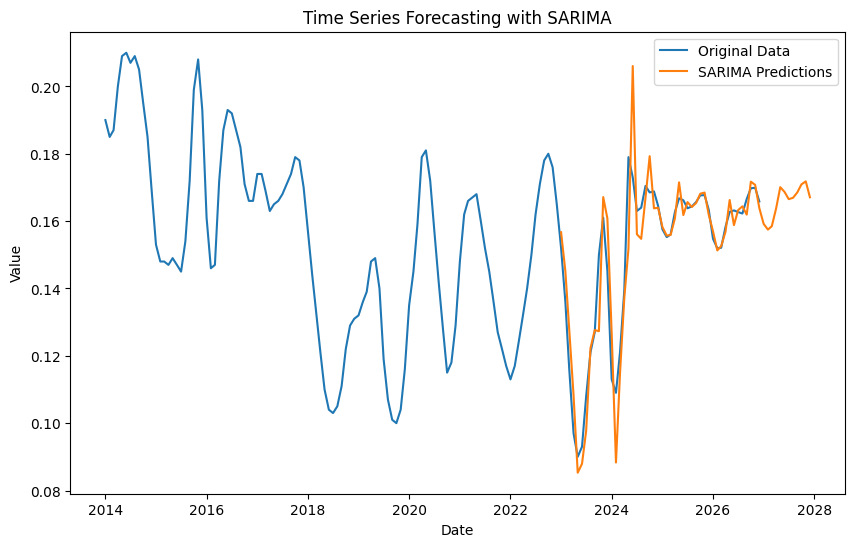

SARIMA - MSE: 8.80344655954962e-05, RMSE: 0.009382668362224907, MAPE: 4.22%


In [ ]:
model_sarima(data_filtered,'Latvia', '15-24', 'Total')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=-1019.149, Time=0.94 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-1014.089, Time=0.07 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-1017.713, Time=0.10 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=-1020.492, Time=0.23 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-1016.089, Time=0.04 sec
 ARIMA(0,2,2)(0,0,0)[0] intercept   : AIC=-1022.619, Time=0.23 sec
 ARIMA(1,2,2)(0,0,0)[0] intercept   : AIC=-1054.776, Time=0.93 sec
 ARIMA(2,2,2)(0,0,0)[0] intercept   : AIC=-1051.834, Time=0.56 sec
 ARIMA(1,2,3)(0,0,0)[0] intercept   : AIC=-1055.608, Time=0.41 sec
 ARIMA(0,2,3)(0,0,0)[0] intercept   : AIC=-1056.004, Time=0.76 sec
 ARIMA(0,2,3)(0,0,0)[0]             : AIC=inf, Time=0.53 sec

Best model:  ARIMA(0,2,3)(0,0,0)[0] intercept
Total fit time: 4.801 seconds
                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:             

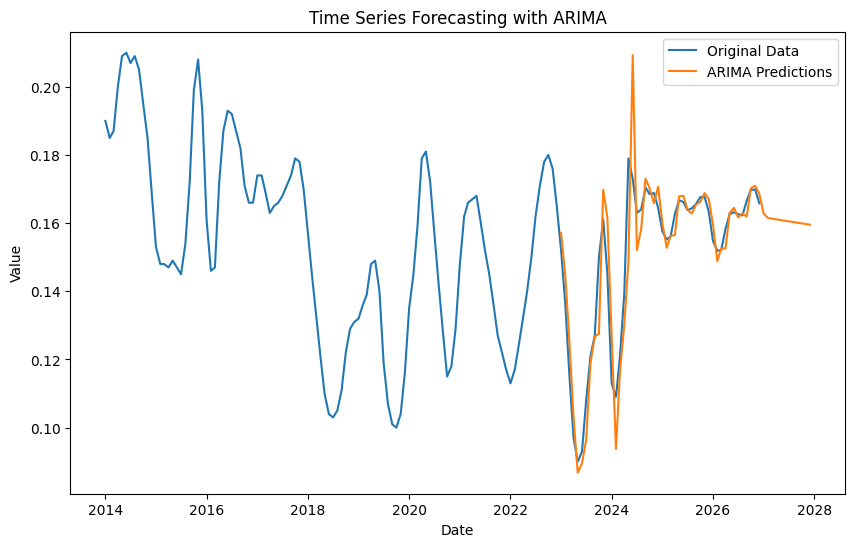

ARIMA - MSE: 9.107400161085831e-05, RMSE: 0.009543269964265829, MAPE: 4.13%


In [ ]:
model_arima(data_filtered,'Latvia', '15-24', 'Total')

## 25+, Male

In [ ]:
data_filtered = prepare_data(combined_df, country='Latvia', age='25+', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9371
Strong seasonality detected.


(0.9371103589916918, True)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1301.360, Time=2.02 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1155.676, Time=0.05 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1270.153, Time=0.30 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1232.623, Time=0.91 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-1249.048, Time=0.10 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1285.958, Time=1.31 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1291.881, Time=2.69 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1282.425, Time=0.64 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=-1296.739, Time=3.47 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1284.180, Time=0.90 sec
 ARIMA(2,1,1)(0,1,1)[12]             : AIC=-1318.502, Time=1.97 sec
 ARIMA(2,1,1)(0,1,0)[12]             : AIC=-1270.319, Time=0.79 sec
 ARIMA(2,1,1)(1,1,1)[12]             : AIC=-1296.238, Time=2.45 sec
 ARIMA(2,1,1)(0,1,2)[12]             : AIC=-1305.323, Time=1.85 sec
 ARIM

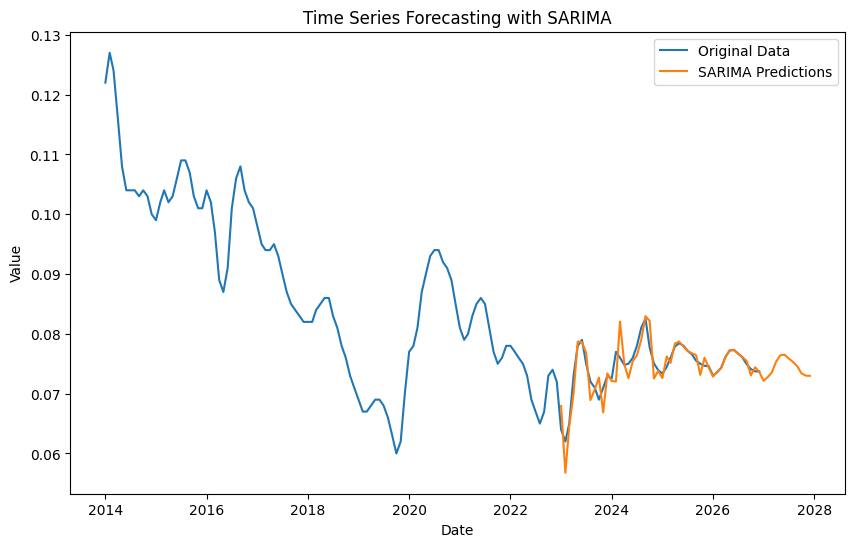

SARIMA - MSE: 4.365460983476049e-06, RMSE: 0.002089368560947553, MAPE: 1.85%


In [ ]:
model_sarima(data_filtered,'Latvia', '25+', 'Male')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=-1373.939, Time=1.07 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-1386.043, Time=0.15 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-1388.980, Time=0.10 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=-1387.814, Time=0.15 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-1388.020, Time=0.03 sec
 ARIMA(2,2,0)(0,0,0)[0] intercept   : AIC=-1397.565, Time=0.40 sec
 ARIMA(3,2,0)(0,0,0)[0] intercept   : AIC=-1422.523, Time=0.41 sec
 ARIMA(3,2,1)(0,0,0)[0] intercept   : AIC=-1420.331, Time=0.60 sec
 ARIMA(2,2,1)(0,0,0)[0] intercept   : AIC=-1380.042, Time=0.36 sec
 ARIMA(3,2,0)(0,0,0)[0]             : AIC=-1424.525, Time=0.35 sec
 ARIMA(2,2,0)(0,0,0)[0]             : AIC=-1399.554, Time=0.29 sec
 ARIMA(3,2,1)(0,0,0)[0]             : AIC=-1422.331, Time=0.65 sec
 ARIMA(2,2,1)(0,0,0)[0]             : AIC=-1382.021, Time=0.31 sec

Best model:  ARIMA(3,2,0)(0,0,0)[0]          
Total fit time: 4.888 seconds
         

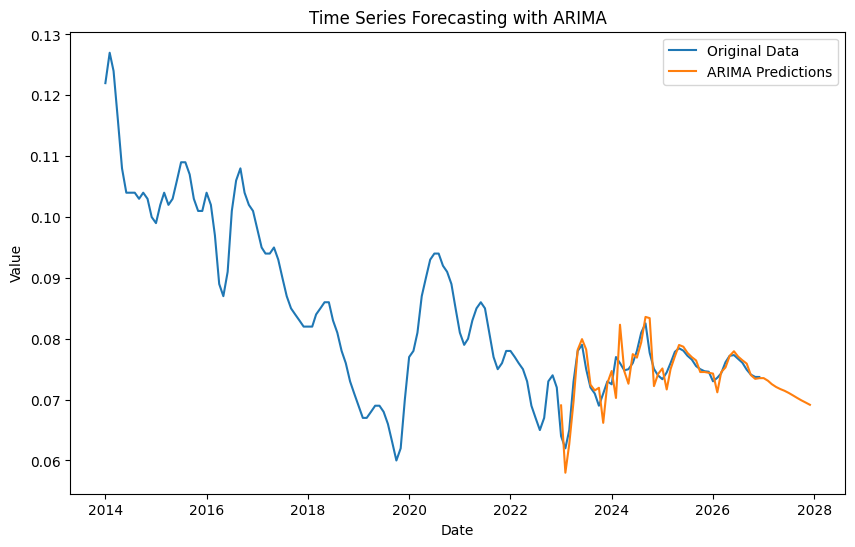

ARIMA - MSE: 5.60999419205173e-06, RMSE: 0.002368542630406244, MAPE: 2.21%


In [ ]:
model_arima(data_filtered,'Latvia', '25+', 'Male')

## 25+, Female

In [ ]:
data_filtered = prepare_data(combined_df, country='Latvia', age='25+', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9697
Strong seasonality detected.


(0.9697386289054877, True)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1317.332, Time=1.20 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1214.639, Time=0.07 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1353.368, Time=0.34 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1250.172, Time=1.15 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-1296.760, Time=0.14 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-1382.081, Time=0.61 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=-1380.243, Time=1.15 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=-1378.565, Time=0.47 sec
 ARIMA(0,1,0)(2,1,0)[12]             : AIC=-1315.330, Time=0.35 sec
 ARIMA(2,1,0)(2,1,0)[12]             : AIC=-1387.179, Time=1.09 sec
 ARIMA(2,1,0)(1,1,0)[12]             : AIC=-1378.401, Time=0.36 sec
 ARIMA(2,1,0)(2,1,1)[12]             : AIC=-1382.937, Time=1.85 sec
 ARIMA(2,1,0)(1,1,1)[12]             : AIC=-1387.589, Time=0.94 sec
 ARIMA(2,1,0)(0,1,1)[12]             : AIC=-1333.067, Time=0.53 sec
 ARIM

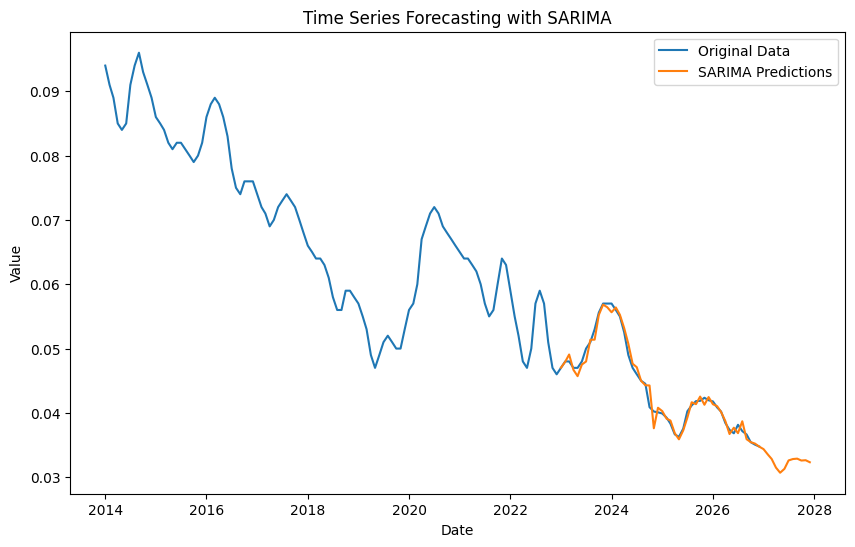

SARIMA - MSE: 9.646438975291382e-07, RMSE: 0.0009821628671096959, MAPE: 1.61%


In [ ]:
model_sarima(data_filtered,'Latvia', '25+', 'Female')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=-1497.054, Time=0.98 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-1498.973, Time=0.05 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-1498.834, Time=0.15 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=-1499.038, Time=0.10 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-1500.959, Time=0.11 sec

Best model:  ARIMA(0,2,0)(0,0,0)[0]          
Total fit time: 1.401 seconds
                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                  156
Model:               SARIMAX(0, 2, 0)   Log Likelihood                 751.479
Date:                Mon, 09 Dec 2024   AIC                          -1500.959
Time:                        14:23:52   BIC                          -1497.922
Sample:                    01-01-2014   HQIC                         -1499.725
                         - 12-01-2026                                  

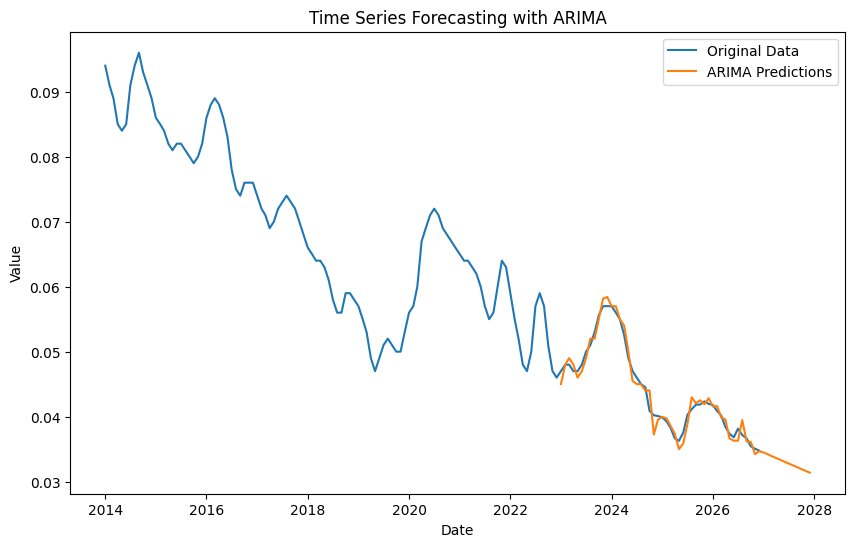

ARIMA - MSE: 1.38888884342585e-06, RMSE: 0.0011785112826892452, MAPE: 2.20%


In [ ]:
model_arima(data_filtered,'Latvia', '25+', 'Female')

## 25+, Total

In [ ]:
data_filtered = prepare_data(combined_df, country='Latvia', age='25+', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9794
Strong seasonality detected.


(0.9793603949425796, True)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1419.860, Time=1.12 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1279.960, Time=0.08 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1401.084, Time=0.86 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1393.301, Time=0.93 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-1346.005, Time=0.16 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1416.467, Time=1.04 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1417.315, Time=1.18 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1402.830, Time=0.33 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=-1417.252, Time=1.36 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1414.766, Time=0.47 sec
 ARIMA(2,1,1)(0,1,1)[12]             : AIC=-1415.134, Time=0.55 sec
 ARIMA(1,1,2)(0,1,1)[12]             : AIC=-1427.541, Time=0.95 sec
 ARIMA(1,1,2)(0,1,0)[12]             : AIC=-1351.960, Time=0.60 sec
 ARIMA(1,1,2)(1,1,1)[12]             : AIC=-1421.090, Time=0.64 sec
 ARIM

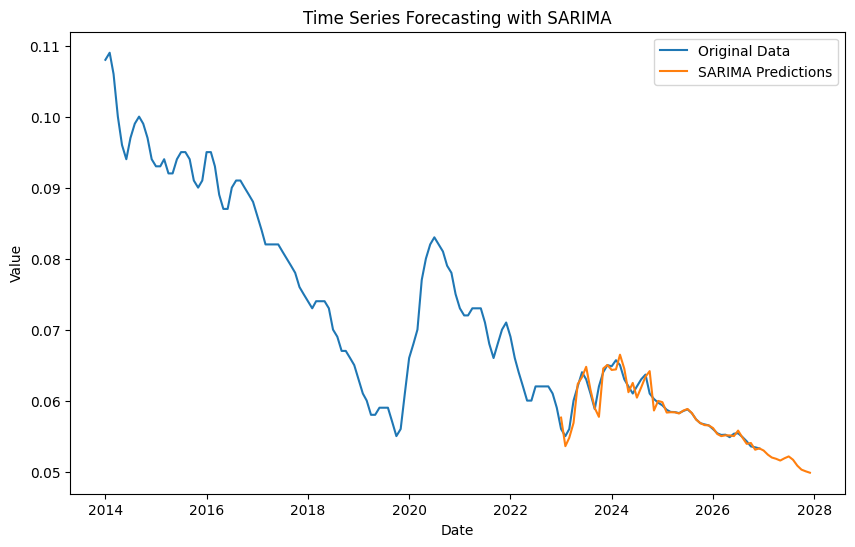

SARIMA - MSE: 1.3671903578333234e-06, RMSE: 0.001169269155427151, MAPE: 1.20%


In [ ]:
model_sarima(data_filtered,'Latvia', '25+', 'Total')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=-1522.810, Time=0.99 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-1526.812, Time=0.17 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-1525.026, Time=0.19 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=-1524.138, Time=0.31 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-1528.809, Time=0.07 sec

Best model:  ARIMA(0,2,0)(0,0,0)[0]          
Total fit time: 1.728 seconds
                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                  156
Model:               SARIMAX(0, 2, 0)   Log Likelihood                 765.404
Date:                Mon, 09 Dec 2024   AIC                          -1528.809
Time:                        14:24:21   BIC                          -1525.772
Sample:                    01-01-2014   HQIC                         -1527.575
                         - 12-01-2026                                  

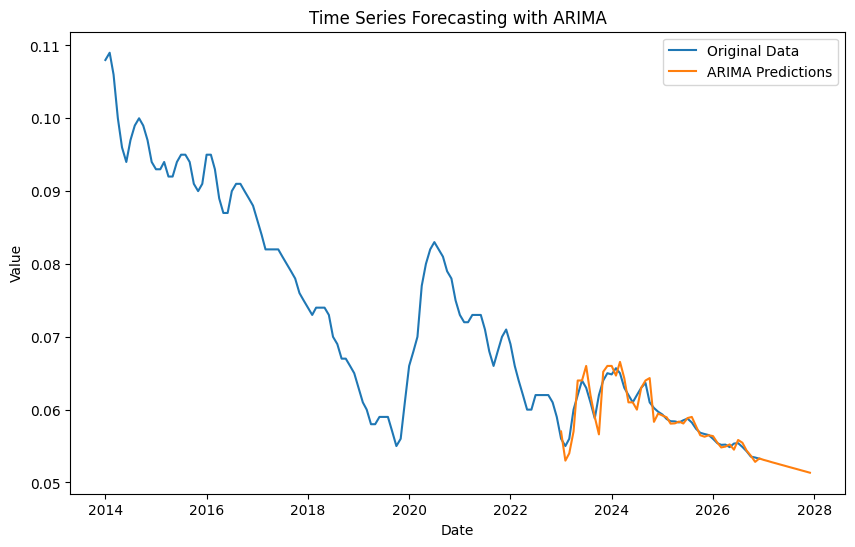

ARIMA - MSE: 1.948625199652669e-06, RMSE: 0.0013959316600939563, MAPE: 1.50%


In [ ]:
model_arima(data_filtered,'Latvia', '25+', 'Total')

# Lithuania


For Lithuania, the seasonal strength was around 0.70, indicating moderate seasonality. As a result, both SARIMA and ARIMA models were applied. However, in all categories (age and gender), ARIMA performed better because the seasonality was not clearly defined and was weaker than expected. ARIMA, which does not require a strong seasonal component, proved more effective in capturing the underlying trends and making accurate forecasts for this dataset.

## 15-24,Male

In [ ]:
data_filtered = prepare_data(combined_df, country='Lithuania', age='15-24', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.7065
Strong seasonality detected.


(0.7065319097842284, True)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2024-09-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-570.881, Time=1.48 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-523.132, Time=0.09 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-546.641, Time=0.28 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=1.56 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-531.068, Time=0.17 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-569.265, Time=1.18 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=inf, Time=2.83 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-545.909, Time=0.87 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=-567.165, Time=2.76 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-571.828, Time=1.21 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-531.643, Time=0.09 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=-569.817, Time=0.65 sec
 ARIMA(1,1,0)(0,1,2)[12]             : AIC=-570.568, Time=1.21 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=inf, Time=2.08 sec
 ARIMA(0,1,0)(0,1,1)[12]          

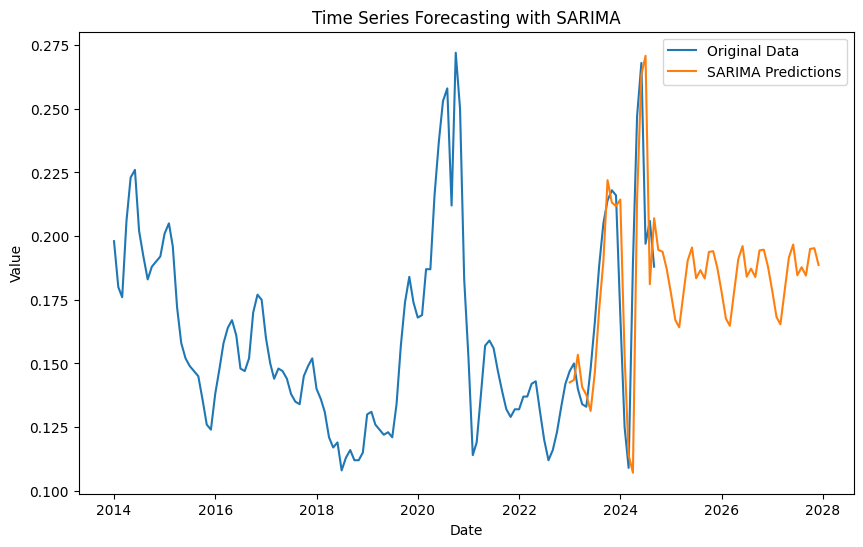

SARIMA - MSE: 0.0008886678589652439, RMSE: 0.029810532685030033, MAPE: 11.64%


In [ ]:
model_sarima(data_filtered,'Latvia', '15-24', 'Male')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.91 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-596.131, Time=0.04 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-602.000, Time=0.07 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.21 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-598.131, Time=0.06 sec
 ARIMA(2,2,0)(0,0,0)[0] intercept   : AIC=-603.908, Time=0.04 sec
 ARIMA(3,2,0)(0,0,0)[0] intercept   : AIC=-616.765, Time=0.07 sec
 ARIMA(3,2,1)(0,0,0)[0] intercept   : AIC=-654.484, Time=0.43 sec
 ARIMA(2,2,1)(0,0,0)[0] intercept   : AIC=-644.511, Time=0.43 sec
 ARIMA(3,2,2)(0,0,0)[0] intercept   : AIC=-650.542, Time=0.61 sec
 ARIMA(2,2,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.55 sec
 ARIMA(3,2,1)(0,0,0)[0]             : AIC=-657.800, Time=0.48 sec
 ARIMA(2,2,1)(0,0,0)[0]             : AIC=inf, Time=0.29 sec
 ARIMA(3,2,0)(0,0,0)[0]             : AIC=-618.759, Time=0.03 sec
 ARIMA(3,2,2)(0,0,0)[0]             : AIC=-655.169, T

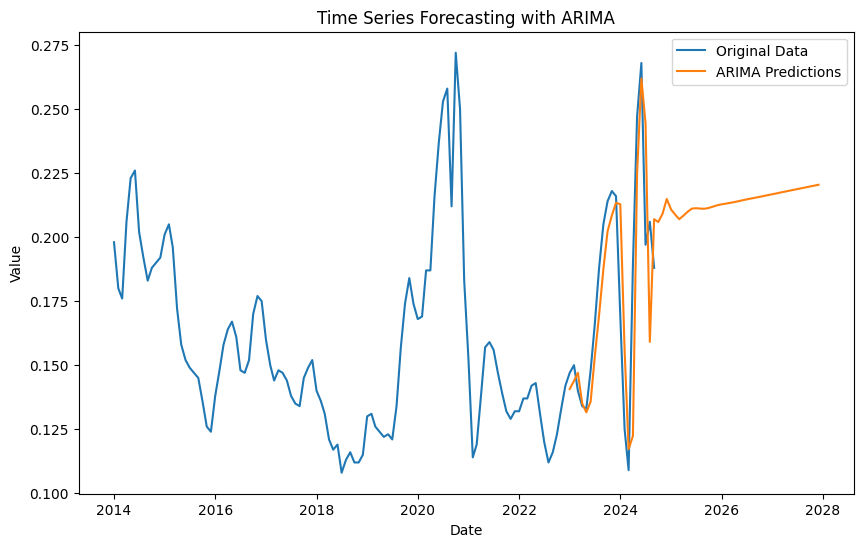

ARIMA - MSE: 0.0006691572356124093, RMSE: 0.025868073674172366, MAPE: 10.58%


In [ ]:
model_arima(data_filtered,'Latvia', '15-24', 'Male')

## 15-24, Female

In [ ]:
data_filtered = prepare_data(combined_df, country='Lithuania', age='15-24', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9661
Strong seasonality detected.


(0.9660777409728509, True)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=2.30 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-759.676, Time=0.04 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-814.394, Time=0.39 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-852.677, Time=0.86 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-772.418, Time=0.06 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-851.349, Time=0.93 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=-850.689, Time=2.94 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=-817.266, Time=0.27 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=-849.470, Time=2.30 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=inf, Time=0.58 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=-850.111, Time=1.50 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-848.142, Time=0.49 sec
 ARIMA(1,1,2)(0,1,1)[12]             : AIC=inf, Time=1.89 sec
 ARIMA(0,1,1)(0,1,1)[12] intercept   : AIC=-847.635, Time=0.61 sec

Best model:  ARIMA(0,1,1)(0,1,1)[

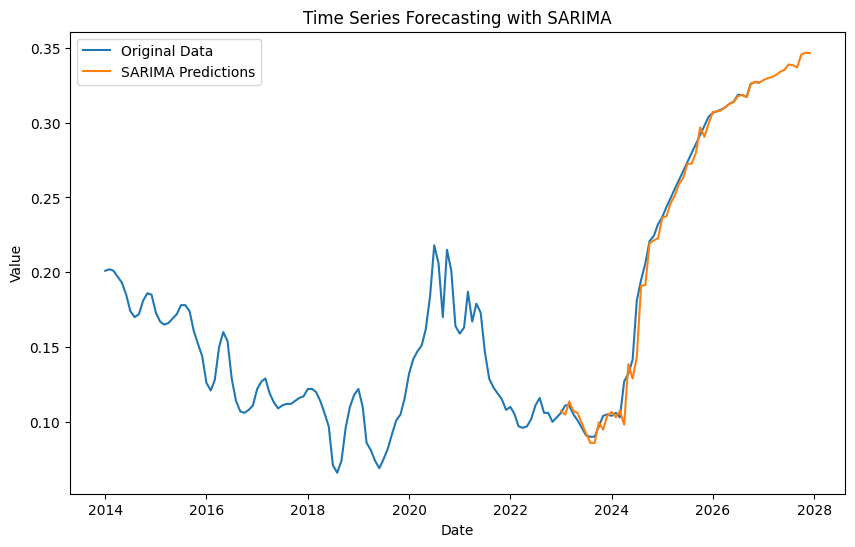

SARIMA - MSE: 6.9205045466039e-05, RMSE: 0.008318956993880843, MAPE: 3.02%


In [ ]:
model_sarima(data_filtered,'Lithuania', '15-24', 'Female')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.99 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-886.637, Time=0.04 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-899.711, Time=0.06 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.37 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-888.637, Time=0.05 sec
 ARIMA(2,2,0)(0,0,0)[0] intercept   : AIC=-924.145, Time=0.12 sec
 ARIMA(3,2,0)(0,0,0)[0] intercept   : AIC=-923.761, Time=0.12 sec
 ARIMA(2,2,1)(0,0,0)[0] intercept   : AIC=-925.574, Time=0.19 sec
 ARIMA(3,2,1)(0,0,0)[0] intercept   : AIC=-944.098, Time=1.64 sec
 ARIMA(3,2,2)(0,0,0)[0] intercept   : AIC=-948.453, Time=0.98 sec
 ARIMA(2,2,2)(0,0,0)[0] intercept   : AIC=-951.052, Time=0.51 sec
 ARIMA(1,2,2)(0,0,0)[0] intercept   : AIC=-947.064, Time=0.44 sec
 ARIMA(2,2,3)(0,0,0)[0] intercept   : AIC=-945.911, Time=0.44 sec
 ARIMA(1,2,3)(0,0,0)[0] intercept   : AIC=-947.937, Time=0.22 sec
 ARIMA(3,2,3)(0,0,0)[0] intercept   : AIC=i

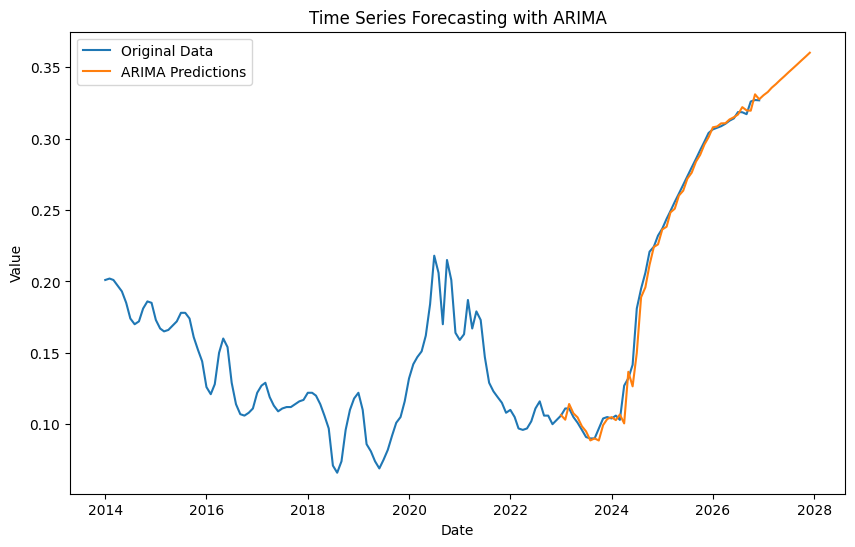

ARIMA - MSE: 5.469655383891917e-05, RMSE: 0.007395711854779036, MAPE: 2.80%


In [ ]:
model_arima(data_filtered,'Lithuania', '15-24', 'Female')

## 15-24, Total

In [ ]:
data_filtered = prepare_data(combined_df, country='Lithuania', age='15-24', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.8464
Strong seasonality detected.


(0.8464467888688147, True)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=2.27 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-737.598, Time=0.13 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-776.386, Time=0.21 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-819.983, Time=1.23 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-739.429, Time=0.12 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=inf, Time=2.44 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=-818.586, Time=0.91 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=-776.550, Time=0.41 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=inf, Time=4.55 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=inf, Time=0.54 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=inf, Time=1.55 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=inf, Time=1.15 sec
 ARIMA(1,1,2)(0,1,1)[12]             : AIC=inf, Time=1.80 sec
 ARIMA(0,1,1)(0,1,1)[12] intercept   : AIC=-816.278, Time=0.41 sec

Best model:  ARIMA(0,1,1)(0,1,1)[12]          
Total 

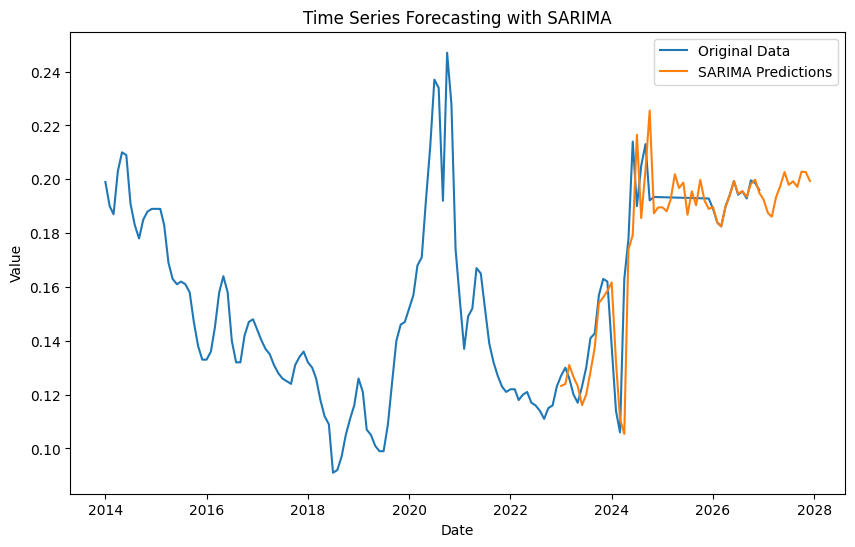

SARIMA - MSE: 0.00017971173256595832, RMSE: 0.01340566046735327, MAPE: 4.74%


In [ ]:
model_sarima(data_filtered,'Lithuania', '15-24', 'Total')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=1.25 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-829.399, Time=0.05 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-854.891, Time=0.04 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.22 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-831.398, Time=0.02 sec
 ARIMA(2,2,0)(0,0,0)[0] intercept   : AIC=-862.758, Time=0.16 sec
 ARIMA(3,2,0)(0,0,0)[0] intercept   : AIC=-867.452, Time=0.20 sec
 ARIMA(3,2,1)(0,0,0)[0] intercept   : AIC=-897.282, Time=0.62 sec
 ARIMA(2,2,1)(0,0,0)[0] intercept   : AIC=-884.200, Time=0.10 sec
 ARIMA(3,2,2)(0,0,0)[0] intercept   : AIC=-899.257, Time=0.72 sec
 ARIMA(2,2,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.82 sec
 ARIMA(3,2,3)(0,0,0)[0] intercept   : AIC=-894.058, Time=0.65 sec
 ARIMA(2,2,3)(0,0,0)[0] intercept   : AIC=-899.143, Time=0.36 sec
 ARIMA(3,2,2)(0,0,0)[0]             : AIC=inf, Time=0.68 sec

Best model:  ARIMA(3,2,2)(0,0,0)[0] intercept
Total 

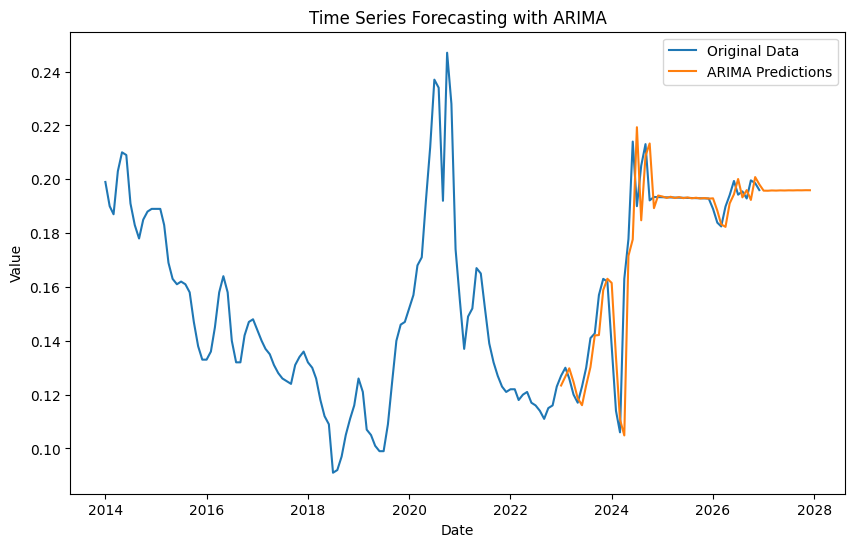

ARIMA - MSE: 0.00017115743028613408, RMSE: 0.01308271494324225, MAPE: 4.31%


In [ ]:
model_arima(data_filtered,'Lithuania', '15-24', 'Total')

## 25+, Female

In [ ]:
data_filtered = prepare_data(combined_df, country='Lithuania', age='25+', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9112
Strong seasonality detected.


(0.9111990762908475, True)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1283.545, Time=1.20 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1218.236, Time=0.03 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1281.520, Time=1.10 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1285.576, Time=0.55 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-1231.452, Time=0.19 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-1292.660, Time=0.52 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=-1280.221, Time=0.36 sec
 ARIMA(0,1,1)(2,1,1)[12]             : AIC=-1290.608, Time=0.79 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=-1290.802, Time=1.46 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=-1292.263, Time=0.78 sec
 ARIMA(0,1,1)(2,1,0)[12]             : AIC=-1290.849, Time=1.28 sec
 ARIMA(0,1,1)(2,1,2)[12]             : AIC=-1267.057, Time=1.01 sec
 ARIMA(0,1,0)(1,1,1)[12]             : AIC=-1283.124, Time=0.30 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1290.719, Time=0.59 sec
 ARIM

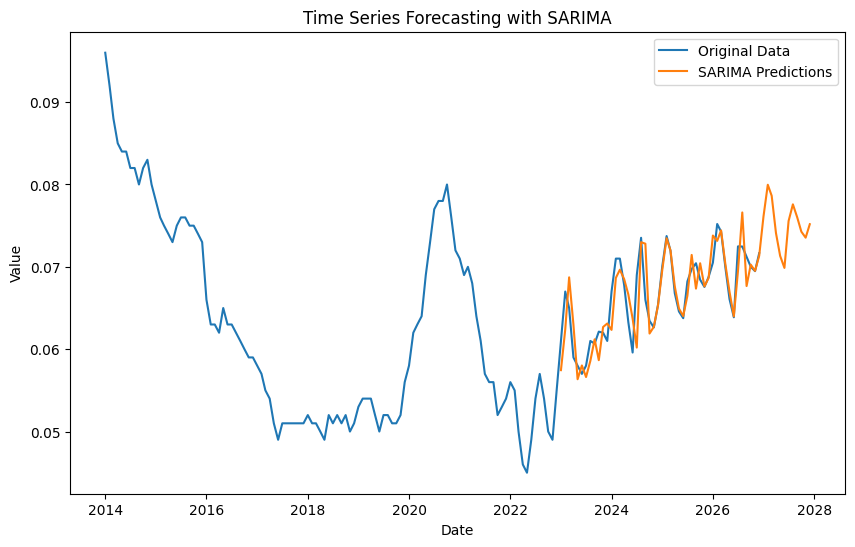

SARIMA - MSE: 7.329695856309201e-06, RMSE: 0.002707341104535814, MAPE: 2.92%


In [ ]:
model_sarima(data_filtered,'Lithuania', '25+', 'Female')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=-1322.319, Time=1.54 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-1326.319, Time=0.07 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-1327.061, Time=0.19 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=-1331.195, Time=0.14 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-1328.295, Time=0.07 sec
 ARIMA(0,2,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.24 sec
 ARIMA(1,2,2)(0,0,0)[0] intercept   : AIC=-1298.879, Time=0.12 sec
 ARIMA(0,2,1)(0,0,0)[0]             : AIC=-1333.160, Time=0.12 sec
 ARIMA(1,2,1)(0,0,0)[0]             : AIC=-1324.295, Time=0.16 sec
 ARIMA(0,2,2)(0,0,0)[0]             : AIC=inf, Time=0.17 sec
 ARIMA(1,2,0)(0,0,0)[0]             : AIC=-1329.033, Time=0.05 sec
 ARIMA(1,2,2)(0,0,0)[0]             : AIC=-1384.272, Time=0.35 sec
 ARIMA(2,2,2)(0,0,0)[0]             : AIC=inf, Time=0.57 sec
 ARIMA(1,2,3)(0,0,0)[0]             : AIC=-1384.190, Time=0.81 sec
 ARIMA(0,2,3)(0,0,0)[0]             :

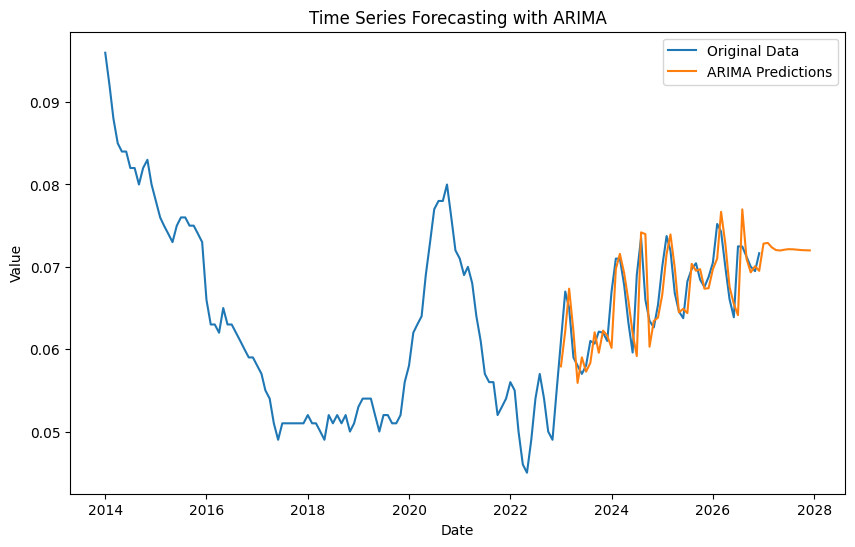

ARIMA - MSE: 1.0283843721540751e-05, RMSE: 0.003206843264261718, MAPE: 3.58%


In [ ]:
model_arima(data_filtered,'Lithuania',  '25+', 'Female')

## 25+, Male

In [ ]:
data_filtered = prepare_data(combined_df, country='Lithuania', age='25+', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9522
Strong seasonality detected.


(0.952242564228004, True)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1222.677, Time=2.59 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1165.937, Time=0.05 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1185.522, Time=0.23 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=1.41 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-1162.893, Time=0.11 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1203.560, Time=2.15 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1222.133, Time=7.87 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1183.538, Time=0.55 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=inf, Time=6.33 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1217.730, Time=0.61 sec
 ARIMA(2,1,1)(0,1,1)[12]             : AIC=-1205.934, Time=1.36 sec
 ARIMA(1,1,2)(0,1,1)[12]             : AIC=-1211.986, Time=2.37 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=-1211.934, Time=0.77 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=-1217.701, Time=1.38 sec
 ARIMA(2,1,0)(0,1

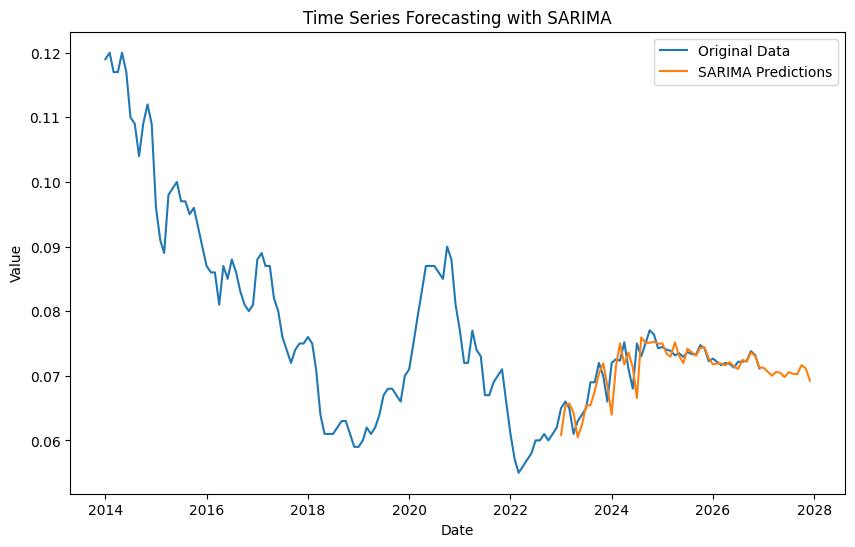

SARIMA - MSE: 5.45877411612143e-06, RMSE: 0.0023364019594499207, MAPE: 2.13%


In [ ]:
model_sarima(data_filtered,'Lithuania', '25+', 'Male')

## 25+, Total

In [ ]:
data_filtered = prepare_data(combined_df, country='Lithuania', age='25+', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9494
Strong seasonality detected.


(0.9494340503815948, True)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1278.595, Time=0.86 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1217.292, Time=0.08 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1246.197, Time=0.89 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1280.812, Time=0.30 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-1218.387, Time=0.10 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-1276.655, Time=0.83 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=inf, Time=2.18 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=-1244.843, Time=0.45 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=inf, Time=3.27 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=-1275.603, Time=0.35 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=-1280.044, Time=1.05 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1281.316, Time=3.20 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-1218.770, Time=0.11 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=-1277.191, Time=0.78 sec
 ARIMA(1,1,0)(0,1

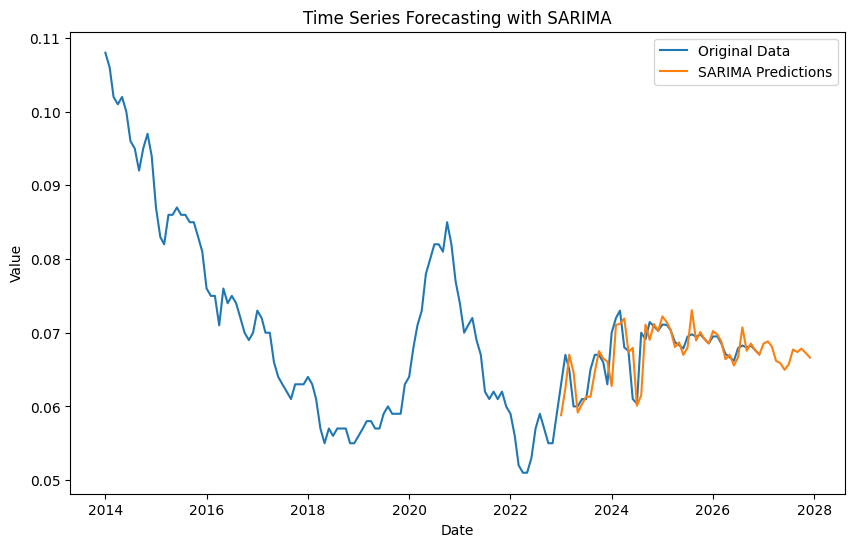

SARIMA - MSE: 6.708453273953776e-06, RMSE: 0.0025900681987070873, MAPE: 2.46%


In [ ]:
model_sarima(data_filtered,'Lithuania', '25+', 'Total')

# Slovakia


For Slovakia, the seasonal strength was high, around 0.92, indicating a strong seasonal pattern. Due to this clear and significant seasonality, SARIMA was applied to this country, as it is well-suited to handle both trend and seasonal components effectively. The high seasonality in the data made SARIMA the ideal choice for accurate forecasting in all categories (age and gender).

## 15-24, Female

In [ ]:
data_filtered = prepare_data(combined_df, country='Slovak Republic', age='15-24', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9296
Strong seasonality detected.


(0.9296423942776709, True)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-938.681, Time=1.22 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-774.022, Time=0.06 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-895.299, Time=0.13 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-879.734, Time=0.24 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-850.883, Time=0.16 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-937.632, Time=2.08 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=inf, Time=2.46 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-899.043, Time=0.44 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=inf, Time=3.52 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-934.397, Time=0.34 sec
 ARIMA(2,1,1)(0,1,1)[12]             : AIC=-943.470, Time=0.48 sec
 ARIMA(2,1,1)(0,1,0)[12]             : AIC=-857.271, Time=0.43 sec
 ARIMA(2,1,1)(1,1,1)[12]             : AIC=inf, Time=2.37 sec
 ARIMA(2,1,1)(0,1,2)[12]             : AIC=-945.912, Time=3.47 sec
 ARIMA(2,1,1)(1,1,2)[12]          

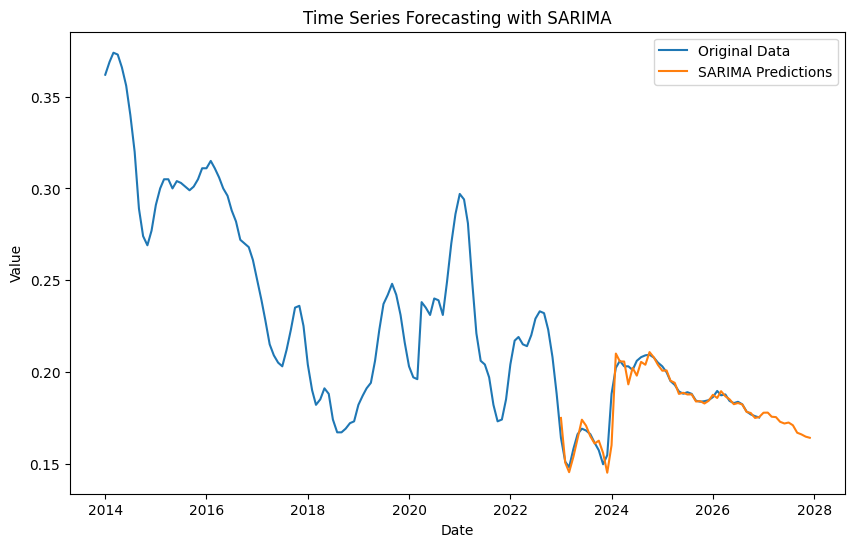

SARIMA - MSE: 2.9798775662626077e-05, RMSE: 0.0054588254838038265, MAPE: 1.64%


In [ ]:
model_sarima(data_filtered,'Slovak Republic', '15-24', 'Female')

## 15-24, Male

In [ ]:
data_filtered = prepare_data(combined_df, country='Slovak Republic', age='15-24', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9566
Strong seasonality detected.


(0.9565669016024397, True)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1033.141, Time=1.51 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-912.758, Time=0.07 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1001.663, Time=0.15 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1031.114, Time=1.02 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-984.230, Time=0.07 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1037.809, Time=0.89 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1013.235, Time=0.88 sec
 ARIMA(1,1,1)(2,1,1)[12]             : AIC=-1019.628, Time=1.07 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=-1035.845, Time=2.83 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1033.872, Time=1.49 sec
 ARIMA(1,1,1)(2,1,0)[12]             : AIC=-1023.281, Time=1.47 sec
 ARIMA(1,1,1)(2,1,2)[12]             : AIC=-1025.483, Time=3.18 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-1033.298, Time=1.18 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=-1015.437, Time=0.26 sec
 ARIMA(

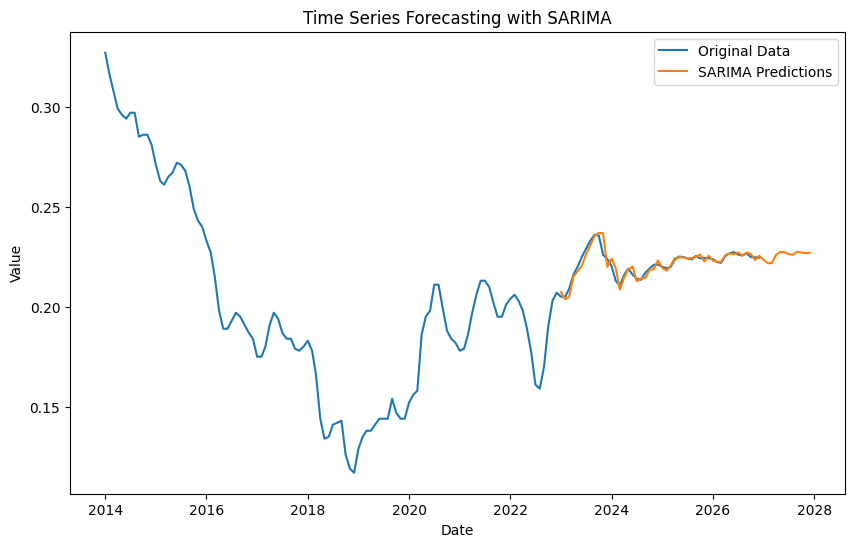

SARIMA - MSE: 6.501244530481061e-06, RMSE: 0.0025497538176226073, MAPE: 0.78%


In [ ]:
model_sarima(data_filtered,'Slovak Republic', '15-24', 'Male')

## 15-24, Total

In [ ]:
data_filtered = prepare_data(combined_df, country='Slovak Republic', age='15-24', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9705
Strong seasonality detected.


(0.970467094439087, True)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=1.15 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-962.655, Time=0.08 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1019.884, Time=0.15 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1061.352, Time=1.19 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-993.004, Time=0.10 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-1047.082, Time=0.87 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=inf, Time=1.81 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=-1024.381, Time=0.39 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=inf, Time=2.38 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=-1031.957, Time=0.25 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=-1065.089, Time=0.68 sec
 ARIMA(0,1,2)(0,1,0)[12]             : AIC=-993.289, Time=0.10 sec
 ARIMA(0,1,2)(1,1,1)[12]             : AIC=inf, Time=1.80 sec
 ARIMA(0,1,2)(0,1,2)[12]             : AIC=inf, Time=2.66 sec
 ARIMA(0,1,2)(1,1,0)[12]             :

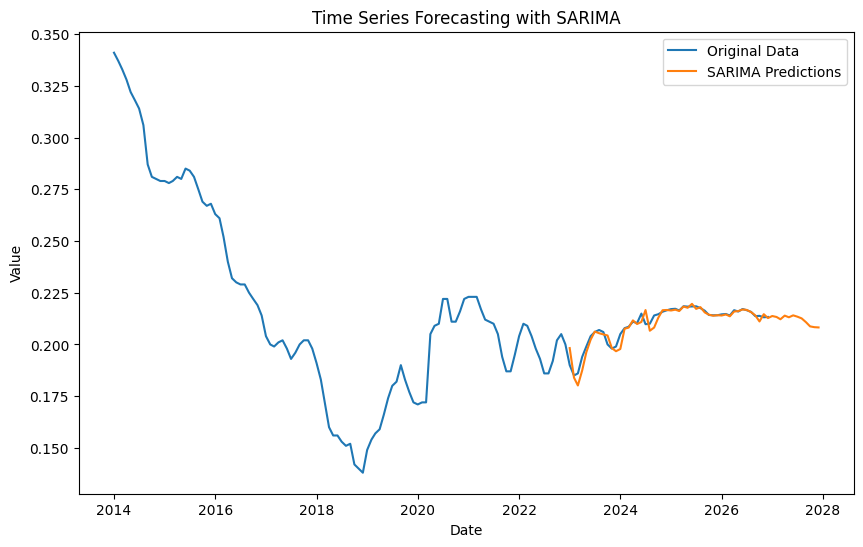

SARIMA - MSE: 7.6130783942923875e-06, RMSE: 0.002759180746941452, MAPE: 0.83%


In [ ]:
model_sarima(data_filtered,'Slovak Republic', '15-24', 'Total')

## 25+, Female

In [ ]:
data_filtered = prepare_data(combined_df, country='Slovak Republic', age='25+', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9971
Strong seasonality detected.


(0.9970980246488896, True)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1481.363, Time=0.82 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1404.850, Time=0.14 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1470.388, Time=0.19 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1479.270, Time=0.40 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-1453.575, Time=0.25 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1469.206, Time=0.64 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1496.111, Time=1.20 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=-1494.841, Time=2.41 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=-1493.487, Time=0.66 sec
 ARIMA(1,1,0)(0,1,2)[12]             : AIC=-1498.218, Time=0.63 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1483.455, Time=0.22 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=-1497.007, Time=1.31 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=-1471.315, Time=0.51 sec
 ARIMA(0,1,0)(0,1,2)[12]             : AIC=-1446.594, Time=0.68 sec
 ARIM

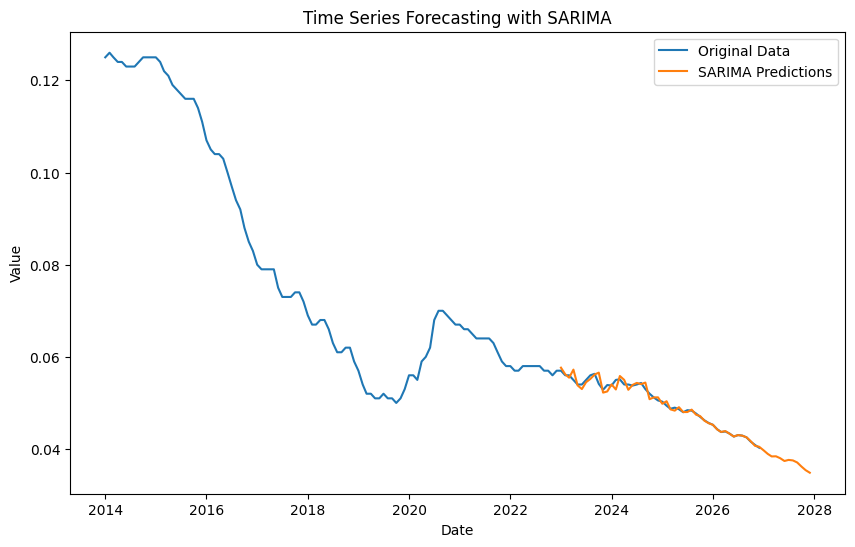

SARIMA - MSE: 6.146044388125849e-07, RMSE: 0.0007839671159000133, MAPE: 0.97%


In [ ]:
model_sarima(data_filtered,'Slovak Republic', '25+', 'Female')

## 25+, Male

In [ ]:
data_filtered = prepare_data(combined_df, country='Slovak Republic', age='25+', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9987
Strong seasonality detected.


(0.9986563414542313, True)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1568.995, Time=0.79 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1500.832, Time=0.11 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1554.830, Time=0.22 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1552.268, Time=0.27 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-1517.214, Time=0.31 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1564.532, Time=0.93 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=inf, Time=1.38 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1563.713, Time=0.61 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=-1577.482, Time=1.46 sec
 ARIMA(1,1,1)(2,1,2)[12]             : AIC=-1576.877, Time=1.74 sec
 ARIMA(1,1,1)(2,1,1)[12]             : AIC=-1561.277, Time=1.13 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=-1555.139, Time=1.08 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=-1566.141, Time=0.89 sec
 ARIMA(2,1,1)(1,1,2)[12]             : AIC=-1575.078, Time=1.04 sec
 ARIMA(1,1,

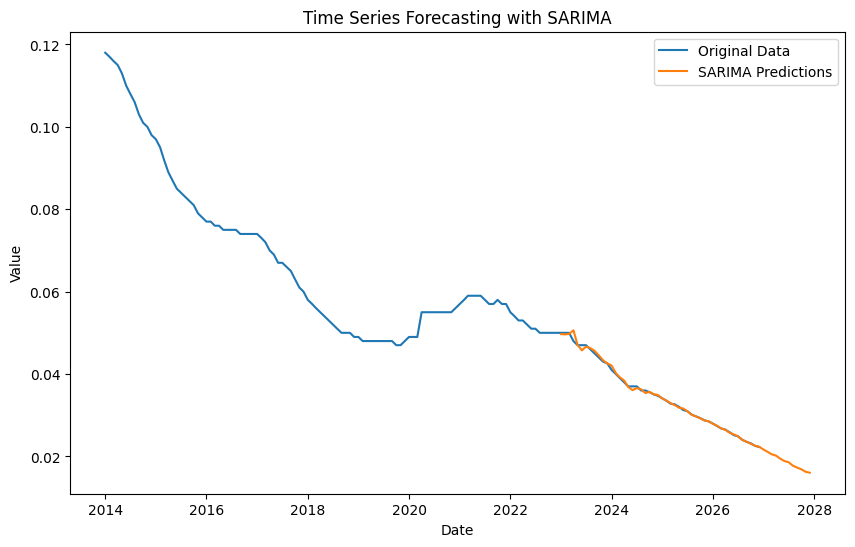

SARIMA - MSE: 2.707861378079033e-07, RMSE: 0.0005203711538968155, MAPE: 0.71%


In [ ]:
model_sarima(data_filtered,'Slovak Republic', '25+', 'Male')

## 25+, Total

In [ ]:
data_filtered = prepare_data(combined_df, country='Slovak Republic', age='25+', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9988
Strong seasonality detected.


(0.998819020440798, True)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1576.483, Time=0.75 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1521.807, Time=0.08 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1554.459, Time=0.26 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1560.851, Time=0.27 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-1536.480, Time=0.19 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1568.788, Time=0.40 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1578.673, Time=1.77 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=-1576.084, Time=0.81 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=-1562.252, Time=1.55 sec
 ARIMA(1,1,0)(0,1,2)[12]             : AIC=-1567.263, Time=0.72 sec
 ARIMA(2,1,1)(0,1,2)[12]             : AIC=-1576.112, Time=2.56 sec
 ARIMA(1,1,2)(0,1,2)[12]             : AIC=-1575.902, Time=1.80 sec
 ARIMA(0,1,0)(0,1,2)[12]             : AIC=-1555.462, Time=0.42 sec
 ARIMA(0,1,2)(0,1,2)[12]             : AIC=-1569.998, Time=1.67 sec
 ARIM

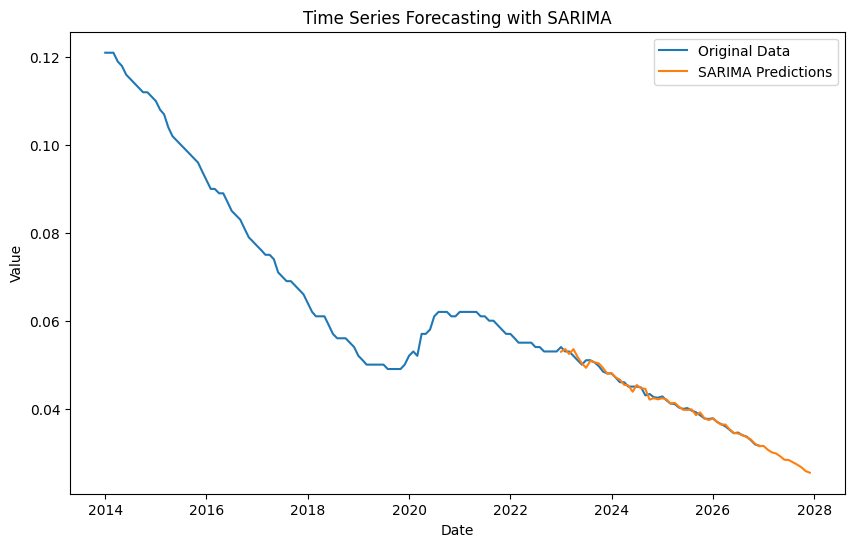

SARIMA - MSE: 3.536087333335486e-07, RMSE: 0.0005946500931922475, MAPE: 0.93%


In [ ]:
model_sarima(data_filtered,'Slovak Republic', '25+', 'Total')

# Hungary


For Hungary, the seasonal strength was high, around 0.94, indicating a strong seasonal pattern. Due to this clear and significant seasonality, SARIMA was applied to the dataset, as it is well-suited to handle both trend and seasonal components effectively. The high seasonality in the data made SARIMA the ideal choice for accurate forecasting in all categories (age and gender).

## 15-24, Female

In [ ]:
data_filtered = prepare_data(combined_df, country='Hungary', age='15-24', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9349
Strong seasonality detected.


(0.9348770630003987, True)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1002.543, Time=1.87 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-921.361, Time=0.07 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-963.764, Time=0.31 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1004.079, Time=0.89 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-925.823, Time=0.09 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-995.139, Time=0.73 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=inf, Time=3.05 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=-961.021, Time=0.52 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=inf, Time=1.40 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=-999.126, Time=0.20 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=-1017.339, Time=1.11 sec
 ARIMA(0,1,2)(0,1,0)[12]             : AIC=-940.779, Time=0.37 sec
 ARIMA(0,1,2)(1,1,1)[12]             : AIC=-1008.961, Time=1.10 sec
 ARIMA(0,1,2)(0,1,2)[12]             : AIC=-1014.237, Time=3.44 sec
 ARIMA(0,1,2)(1,1,0)[12]

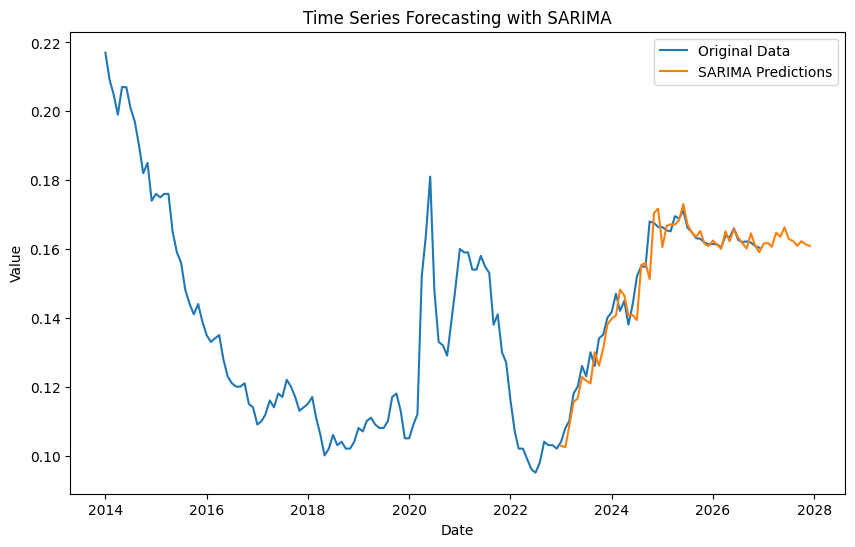

SARIMA - MSE: 1.8718309368874258e-05, RMSE: 0.004326466152516885, MAPE: 1.96%


In [ ]:
model_sarima(data_filtered,'Hungary', '15-24', 'Female')

## 15-24, Male

In [ ]:
data_filtered = prepare_data(combined_df, country='Hungary', age='15-24', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9709
Strong seasonality detected.


(0.9709171187926351, True)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1053.833, Time=1.67 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-973.032, Time=0.10 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1013.245, Time=0.66 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1038.742, Time=0.23 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-980.118, Time=0.15 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1028.247, Time=0.89 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1051.591, Time=2.08 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1014.395, Time=1.17 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=-1046.601, Time=1.89 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1038.523, Time=0.29 sec
 ARIMA(2,1,1)(0,1,1)[12]             : AIC=inf, Time=1.19 sec
 ARIMA(1,1,2)(0,1,1)[12]             : AIC=-1042.980, Time=1.02 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=inf, Time=0.75 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=inf, Time=1.54 sec
 ARIMA(2,1,0)(0,1,1)[12] 

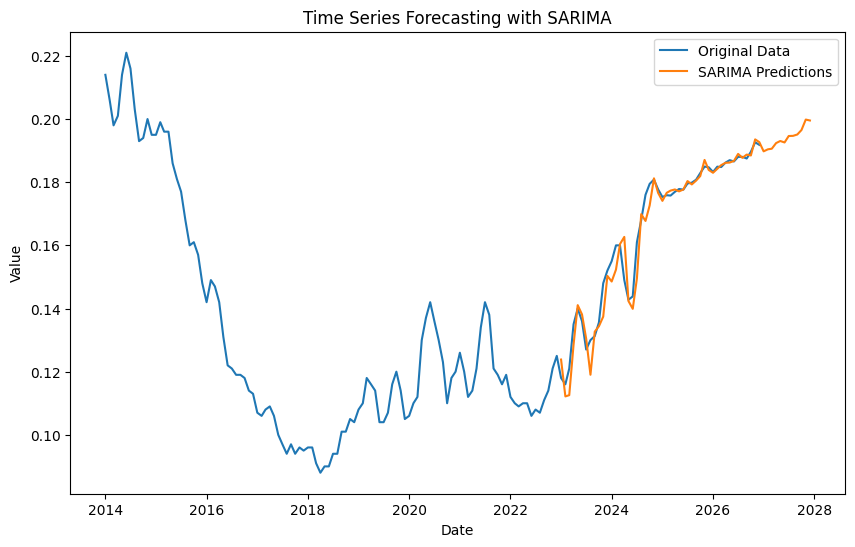

SARIMA - MSE: 2.0691480011080633e-05, RMSE: 0.004548788851010853, MAPE: 1.94%


In [ ]:
model_sarima(data_filtered,'Hungary', '15-24', 'Male')

## 15-24, Total

In [ ]:
data_filtered = prepare_data(combined_df, country='Hungary', age='15-24', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9676
Strong seasonality detected.


(0.9676416341577138, True)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1048.800, Time=1.83 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-975.141, Time=0.13 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1016.544, Time=0.27 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1047.513, Time=1.15 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-980.006, Time=0.29 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1054.189, Time=2.80 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1015.211, Time=0.71 sec
 ARIMA(1,1,1)(2,1,1)[12]             : AIC=-1033.950, Time=0.61 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=inf, Time=2.79 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=inf, Time=5.18 sec
 ARIMA(1,1,1)(2,1,0)[12]             : AIC=-1036.461, Time=0.66 sec
 ARIMA(1,1,1)(2,1,2)[12]             : AIC=-1051.361, Time=6.04 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-1048.872, Time=1.33 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=-1032.636, Time=0.89 sec
 ARIMA(2,1,1)(1,1,1

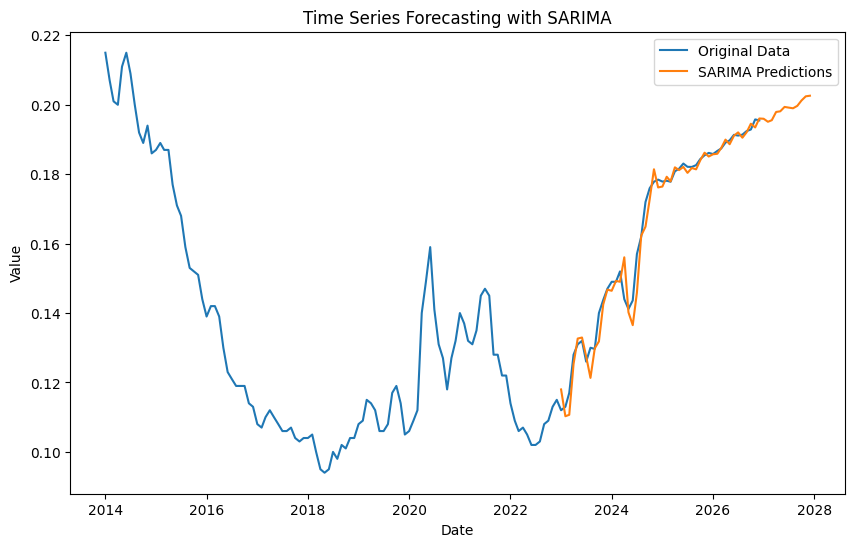

SARIMA - MSE: 1.4189687184166594e-05, RMSE: 0.00376692011916454, MAPE: 1.62%


In [ ]:
model_sarima(data_filtered,'Hungary', '15-24', 'Total')

## 25+, Female

In [ ]:
data_filtered = prepare_data(combined_df, country='Hungary', age='25+', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9898
Strong seasonality detected.


(0.989805636812056, True)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1470.384, Time=1.70 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1414.215, Time=0.17 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1442.806, Time=0.71 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1473.023, Time=0.63 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-1412.825, Time=0.25 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-1466.428, Time=0.90 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=inf, Time=1.77 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=-1442.911, Time=0.41 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=inf, Time=1.29 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=-1474.382, Time=0.71 sec
 ARIMA(0,1,0)(1,1,1)[12]             : AIC=-1468.049, Time=0.62 sec
 ARIMA(0,1,0)(0,1,2)[12]             : AIC=inf, Time=0.95 sec
 ARIMA(0,1,0)(1,1,0)[12]             : AIC=-1444.823, Time=0.33 sec
 ARIMA(0,1,0)(1,1,2)[12]             : AIC=inf, Time=1.84 sec
 ARIMA(1,1,0)(0,1,1)[12]     

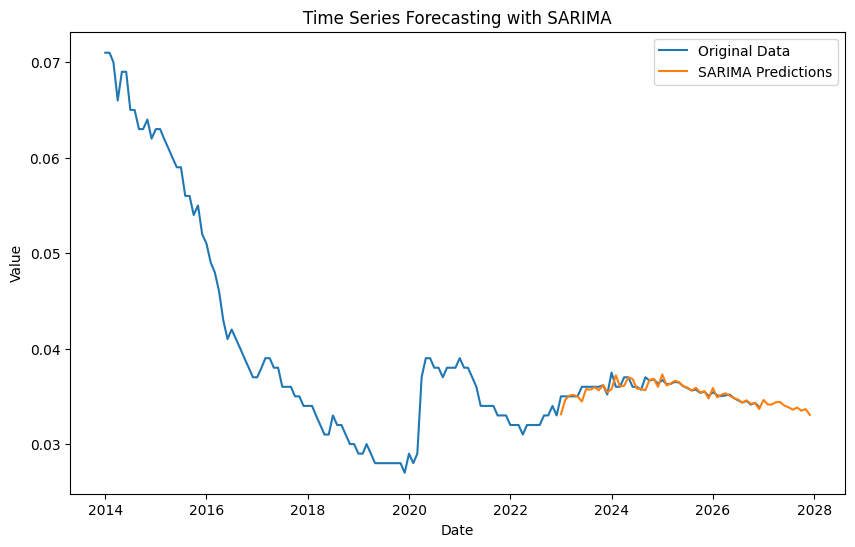

SARIMA - MSE: 3.172105219977918e-07, RMSE: 0.0005632144547131153, MAPE: 0.88%


In [ ]:
model_sarima(data_filtered,'Hungary', '25+', 'Female')

## 25+, Male

In [ ]:
data_filtered = prepare_data(combined_df, country='Hungary', age='25+', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9929
Strong seasonality detected.


(0.9929332842767239, True)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1523.341, Time=1.37 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1476.857, Time=0.09 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1505.799, Time=0.20 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1524.398, Time=1.09 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-1475.141, Time=0.25 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-1518.076, Time=0.40 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=inf, Time=2.01 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=-1505.288, Time=0.99 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=-1523.647, Time=3.89 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=-1525.560, Time=0.40 sec
 ARIMA(0,1,0)(1,1,1)[12]             : AIC=-1519.546, Time=0.59 sec
 ARIMA(0,1,0)(0,1,2)[12]             : AIC=inf, Time=1.08 sec
 ARIMA(0,1,0)(1,1,0)[12]             : AIC=-1507.364, Time=0.41 sec
 ARIMA(0,1,0)(1,1,2)[12]             : AIC=-1523.488, Time=2.27 sec
 ARIMA(1,1,0)(0,1

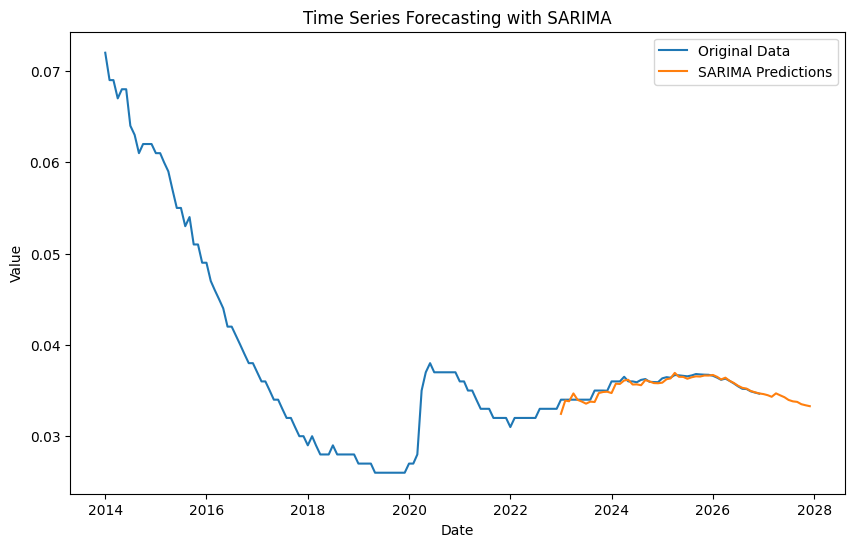

SARIMA - MSE: 1.6789683440206371e-07, RMSE: 0.00040975216216886974, MAPE: 0.72%


In [ ]:
model_sarima(data_filtered,'Hungary', '25+', 'Male')

## 25+, Total

In [ ]:
data_filtered = prepare_data(combined_df, country='Hungary', age='25+', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9930
Strong seasonality detected.


(0.9930354826145923, True)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1524.430, Time=1.38 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1472.921, Time=0.14 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1503.792, Time=0.52 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1525.798, Time=0.69 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-1471.293, Time=0.13 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-1518.753, Time=0.73 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=inf, Time=1.46 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=-1503.628, Time=0.12 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=-1525.199, Time=1.51 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=-1526.807, Time=0.41 sec
 ARIMA(0,1,0)(1,1,1)[12]             : AIC=-1519.964, Time=0.59 sec
 ARIMA(0,1,0)(0,1,2)[12]             : AIC=inf, Time=1.48 sec
 ARIMA(0,1,0)(1,1,0)[12]             : AIC=-1505.193, Time=0.20 sec
 ARIMA(0,1,0)(1,1,2)[12]             : AIC=-1525.746, Time=1.61 sec
 ARIMA(1,1,0)(0,1

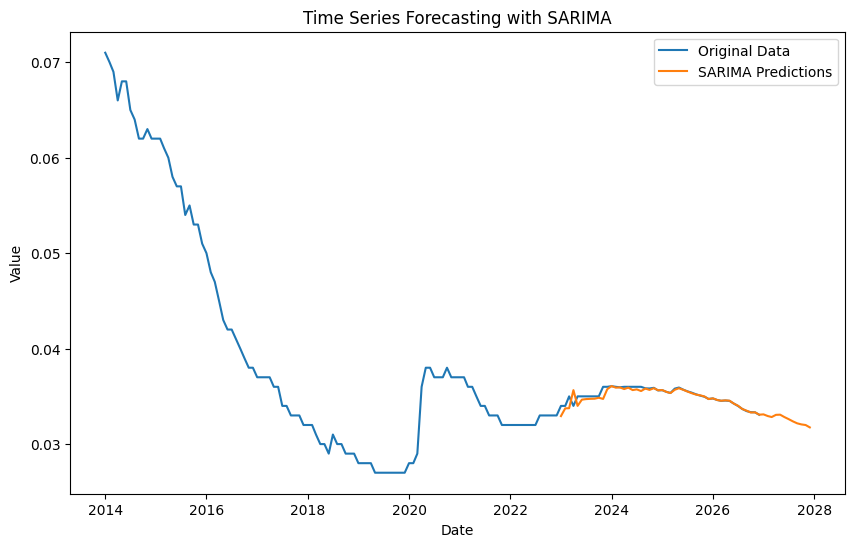

SARIMA - MSE: 1.875599763906119e-07, RMSE: 0.00043308195112543295, MAPE: 0.61%


In [ ]:
model_sarima(data_filtered,'Hungary', '25+', 'Total')

# USA


For the United States, the seasonal strength was around 0.70, indicating moderate seasonality. Both SARIMA and ARIMA models were applied, but in all categories (age and gender), ARIMA performed better. This was due to the fact that the seasonality was not clearly defined, and the seasonal component was weaker, making ARIMA a more effective choice for capturing the underlying trends and providing better forecasts.

## 15-24, Male

In [ ]:
data_filtered = prepare_data(combined_df, country='United States of America', age='15-24', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.6671
Weak or no seasonality detected.


(0.6671349449118169, False)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=1.46 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-697.926, Time=0.04 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-729.403, Time=0.49 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=0.85 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-697.509, Time=0.08 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-739.004, Time=1.54 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=inf, Time=2.44 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=-759.903, Time=0.85 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=inf, Time=0.91 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=inf, Time=4.11 sec
 ARIMA(1,1,0)(0,1,2)[12]             : AIC=inf, Time=2.71 sec
 ARIMA(1,1,0)(2,1,2)[12]             : AIC=-756.584, Time=1.59 sec
 ARIMA(0,1,0)(1,1,1)[12]             : AIC=inf, Time=1.49 sec
 ARIMA(2,1,0)(1,1,1)[12]             : AIC=inf, Time=1.97 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=inf, Time=3.53 s

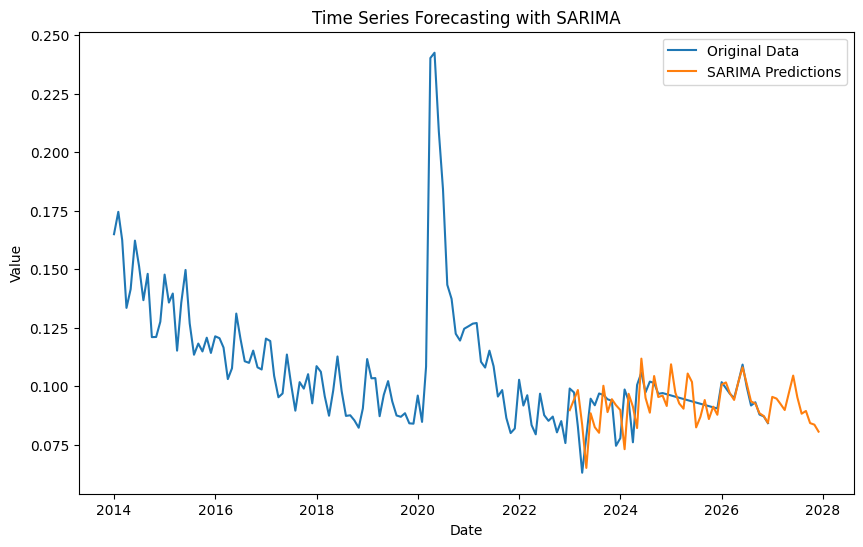

SARIMA - MSE: 8.177628484631925e-05, RMSE: 0.00904302409851479, MAPE: 7.22%


In [ ]:
model_sarima(data_filtered,'United States of America', '15-24', 'Male')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=2.22 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-742.661, Time=0.08 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-757.452, Time=0.17 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.48 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-744.659, Time=0.02 sec
 ARIMA(2,2,0)(0,0,0)[0] intercept   : AIC=-786.574, Time=0.22 sec
 ARIMA(3,2,0)(0,0,0)[0] intercept   : AIC=-793.169, Time=0.16 sec
 ARIMA(3,2,1)(0,0,0)[0] intercept   : AIC=-830.407, Time=0.98 sec
 ARIMA(2,2,1)(0,0,0)[0] intercept   : AIC=-837.938, Time=0.50 sec
 ARIMA(2,2,2)(0,0,0)[0] intercept   : AIC=-826.753, Time=0.53 sec
 ARIMA(1,2,2)(0,0,0)[0] intercept   : AIC=-831.133, Time=0.67 sec
 ARIMA(3,2,2)(0,0,0)[0] intercept   : AIC=-833.940, Time=1.35 sec
 ARIMA(2,2,1)(0,0,0)[0]             : AIC=inf, Time=0.48 sec

Best model:  ARIMA(2,2,1)(0,0,0)[0] intercept
Total fit time: 7.869 seconds
                               SARIMA

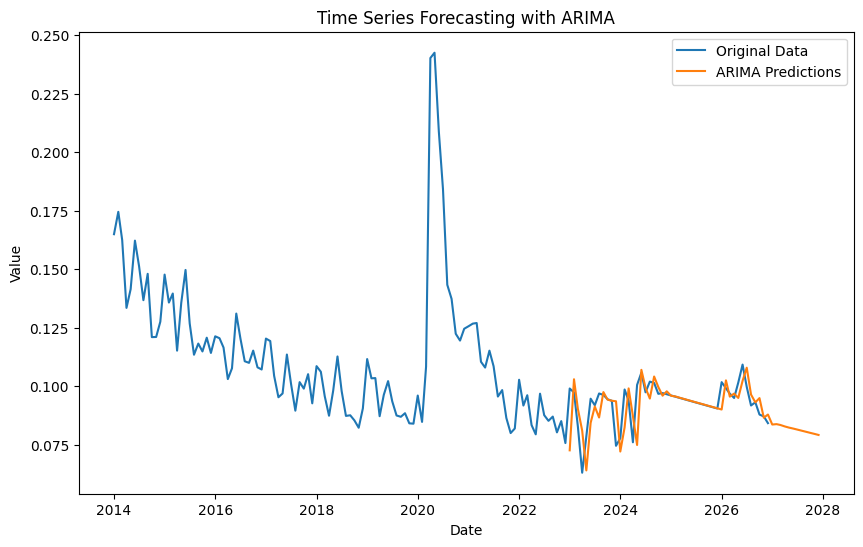

ARIMA - MSE: 7.247986290732056e-05, RMSE: 0.008513510610043342, MAPE: 5.92%


In [ ]:
model_arima(data_filtered,'United States of America', '15-24', 'Male')

## 15-24, Female

In [ ]:
data_filtered = prepare_data(combined_df, country='United States of America', age='15-24', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.6702
Weak or no seasonality detected.


(0.670165621975304, False)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=2.34 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-609.309, Time=0.14 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-642.264, Time=0.67 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=1.97 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-607.323, Time=0.05 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-652.102, Time=1.27 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=inf, Time=3.02 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=inf, Time=1.83 sec
 ARIMA(0,1,0)(2,1,0)[12]             : AIC=-654.096, Time=1.32 sec
 ARIMA(0,1,0)(1,1,0)[12]             : AIC=-644.255, Time=0.42 sec
 ARIMA(0,1,0)(2,1,1)[12]             : AIC=inf, Time=2.85 sec
 ARIMA(0,1,0)(1,1,1)[12]             : AIC=inf, Time=0.91 sec
 ARIMA(0,1,1)(2,1,0)[12]             : AIC=-652.102, Time=0.86 sec
 ARIMA(1,1,1)(2,1,0)[12]             : AIC=inf, Time=2.87 sec
 ARIMA(0,1,0)(2,1,0)[12] intercept   : AIC=-652.103, T

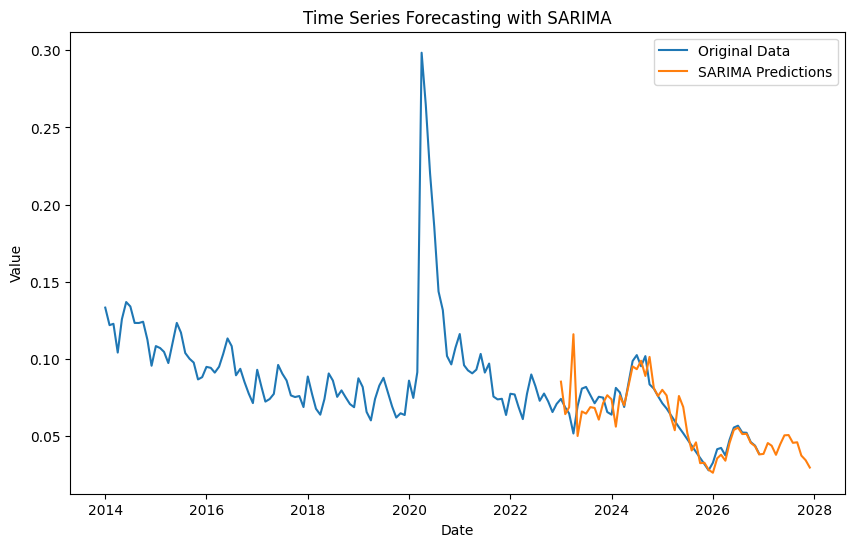

SARIMA - MSE: 0.00016686879659881626, RMSE: 0.012917770573857405, MAPE: 12.41%


In [ ]:
model_sarima(data_filtered,'United States of America', '15-24', 'Female')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=1.84 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-656.985, Time=0.04 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-682.216, Time=0.06 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.23 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-658.985, Time=0.06 sec
 ARIMA(2,2,0)(0,0,0)[0] intercept   : AIC=-706.064, Time=0.06 sec
 ARIMA(3,2,0)(0,0,0)[0] intercept   : AIC=-710.501, Time=0.36 sec
 ARIMA(3,2,1)(0,0,0)[0] intercept   : AIC=-750.963, Time=0.53 sec
 ARIMA(2,2,1)(0,0,0)[0] intercept   : AIC=-751.412, Time=0.41 sec
 ARIMA(2,2,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.74 sec
 ARIMA(1,2,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.28 sec
 ARIMA(3,2,2)(0,0,0)[0] intercept   : AIC=-750.501, Time=0.40 sec
 ARIMA(2,2,1)(0,0,0)[0]             : AIC=inf, Time=0.37 sec

Best model:  ARIMA(2,2,1)(0,0,0)[0] intercept
Total fit time: 5.370 seconds
                               SARIMAX Results 

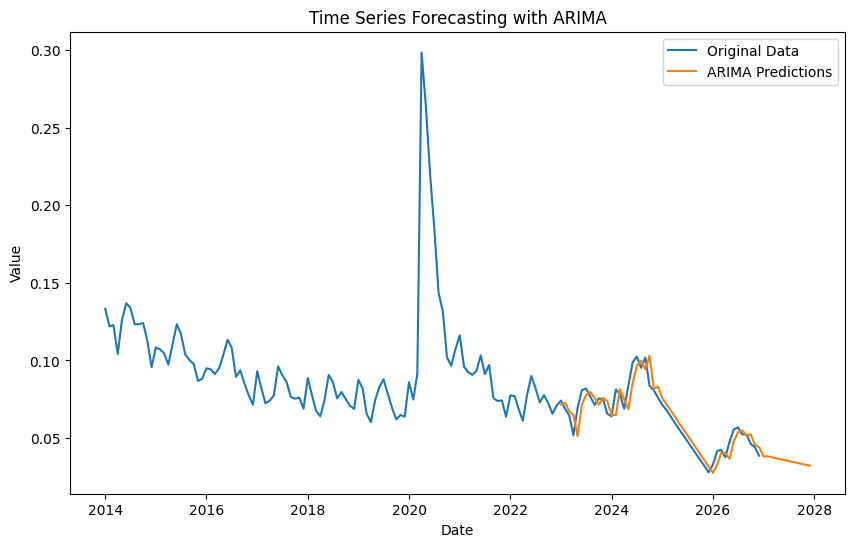

ARIMA - MSE: 5.42179258302364e-05, RMSE: 0.007363282272888661, MAPE: 9.59%


In [ ]:
model_arima(data_filtered,'United States of America', '15-24', 'Female')

## 15-24, Total

In [ ]:
data_filtered = prepare_data(combined_df, country='United States of America', age='15-24', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.6266
Weak or no seasonality detected.


(0.6266369351400024, False)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=4.35 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-662.042, Time=0.13 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-695.454, Time=1.16 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=2.03 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-660.930, Time=0.24 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-704.657, Time=1.72 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=inf, Time=9.51 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=inf, Time=2.64 sec
 ARIMA(0,1,0)(2,1,0)[12]             : AIC=-705.595, Time=2.05 sec
 ARIMA(0,1,0)(1,1,0)[12]             : AIC=-696.553, Time=0.67 sec
 ARIMA(0,1,0)(2,1,1)[12]             : AIC=inf, Time=6.39 sec
 ARIMA(0,1,0)(1,1,1)[12]             : AIC=inf, Time=1.75 sec
 ARIMA(0,1,1)(2,1,0)[12]             : AIC=-705.402, Time=1.01 sec
 ARIMA(1,1,1)(2,1,0)[12]             : AIC=-707.279, Time=4.85 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-699.4

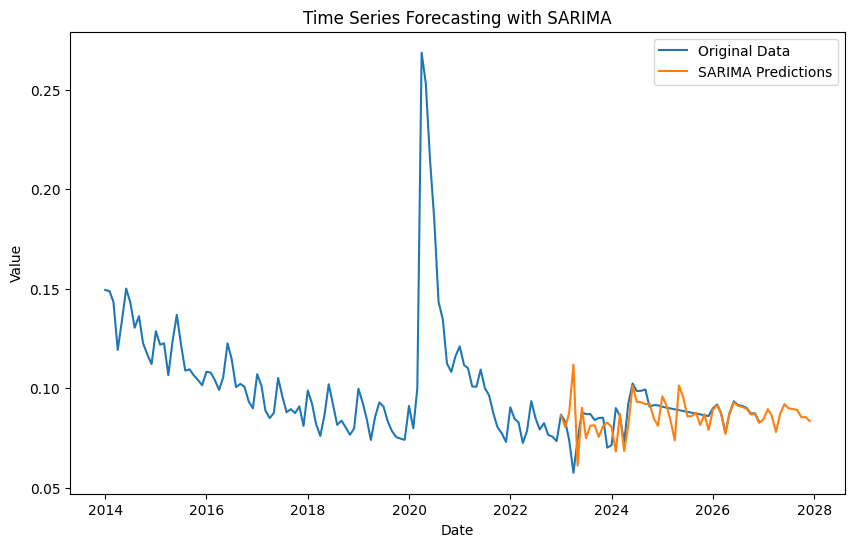

SARIMA - MSE: 0.00011132601292101514, RMSE: 0.01055111429759981, MAPE: 7.69%


In [ ]:
model_sarima(data_filtered,'United States of America', '15-24', 'Total')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.81 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-716.434, Time=0.02 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-733.379, Time=0.02 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.24 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-718.434, Time=0.04 sec
 ARIMA(2,2,0)(0,0,0)[0] intercept   : AIC=-759.996, Time=0.06 sec
 ARIMA(3,2,0)(0,0,0)[0] intercept   : AIC=-764.596, Time=0.06 sec
 ARIMA(3,2,1)(0,0,0)[0] intercept   : AIC=-804.893, Time=0.39 sec
 ARIMA(2,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.30 sec
 ARIMA(3,2,2)(0,0,0)[0] intercept   : AIC=inf, Time=0.42 sec
 ARIMA(2,2,2)(0,0,0)[0] intercept   : AIC=-800.898, Time=0.42 sec
 ARIMA(3,2,1)(0,0,0)[0]             : AIC=inf, Time=0.32 sec

Best model:  ARIMA(3,2,1)(0,0,0)[0] intercept
Total fit time: 3.098 seconds
                               SARIMAX Results                                
Dep. Variable:                    

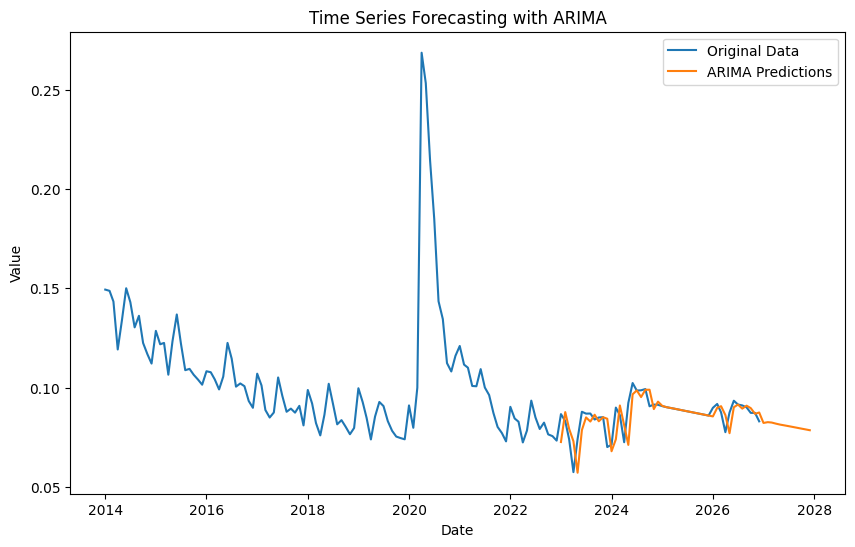

ARIMA - MSE: 4.750863787261736e-05, RMSE: 0.006892651004701845, MAPE: 5.33%


In [ ]:
model_arima(data_filtered,'United States of America', '15-24', 'Total')

## 25+, Male

In [ ]:
data_filtered = prepare_data(combined_df, country='United States of America', age='25+', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.7271
Strong seasonality detected.


(0.7271193609049051, True)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=1.47 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-892.323, Time=0.08 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-925.321, Time=0.41 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=1.13 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-890.439, Time=0.11 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-934.033, Time=0.69 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=-953.232, Time=2.48 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=inf, Time=1.28 sec
 ARIMA(1,1,0)(2,1,2)[12]             : AIC=inf, Time=1.69 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=inf, Time=1.68 sec
 ARIMA(0,1,0)(2,1,1)[12]             : AIC=inf, Time=1.63 sec
 ARIMA(2,1,0)(2,1,1)[12]             : AIC=-956.181, Time=3.91 sec
 ARIMA(2,1,0)(1,1,1)[12]             : AIC=inf, Time=1.83 sec
 ARIMA(2,1,0)(2,1,0)[12]             : AIC=-933.226, Time=1.85 sec
 ARIMA(2,1,0)(2,1,2)[12]             : AIC=inf, Time=1

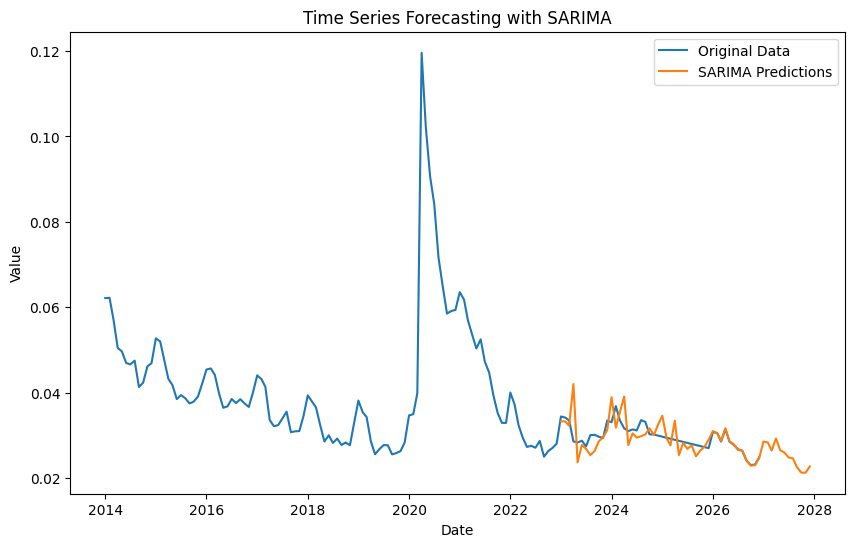

SARIMA - MSE: 1.0116190867656056e-05, RMSE: 0.0031805959925234224, MAPE: 6.53%


In [ ]:
model_sarima(data_filtered,'United States of America', '25+', 'Male')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=-1065.131, Time=0.84 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-963.194, Time=0.04 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-1001.713, Time=0.11 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=-1042.707, Time=0.11 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-965.194, Time=0.02 sec
 ARIMA(2,2,1)(0,0,0)[0] intercept   : AIC=-1044.029, Time=0.37 sec
 ARIMA(1,2,2)(0,0,0)[0] intercept   : AIC=-1049.227, Time=0.16 sec
 ARIMA(0,2,2)(0,0,0)[0] intercept   : AIC=-1053.419, Time=0.09 sec
 ARIMA(2,2,0)(0,0,0)[0] intercept   : AIC=-1022.488, Time=0.11 sec
 ARIMA(2,2,2)(0,0,0)[0] intercept   : AIC=-1045.673, Time=0.21 sec
 ARIMA(1,2,1)(0,0,0)[0]             : AIC=inf, Time=0.25 sec

Best model:  ARIMA(1,2,1)(0,0,0)[0] intercept
Total fit time: 2.309 seconds
                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:               

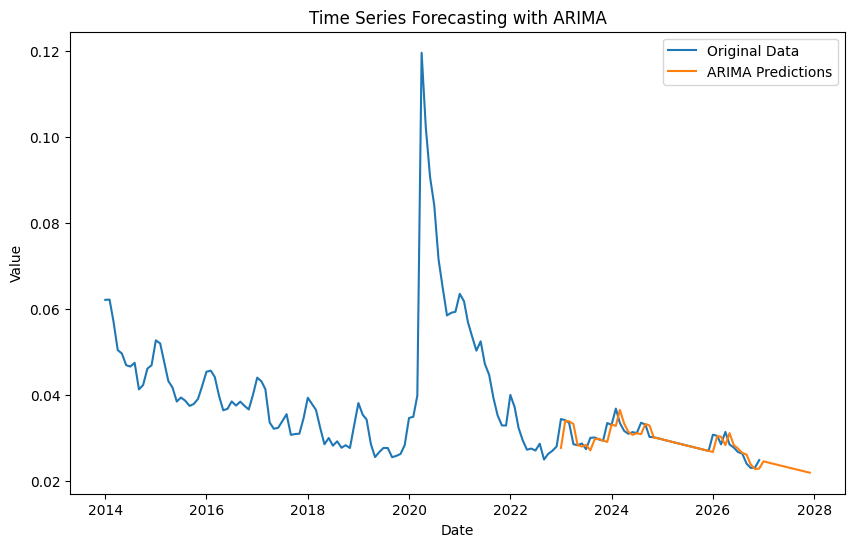

ARIMA - MSE: 3.867994601903665e-06, RMSE: 0.001966721790671895, MAPE: 3.78%


In [ ]:
model_arima(data_filtered,'United States of America', '25+', 'Male')

## 25+, Female

In [ ]:
data_filtered = prepare_data(combined_df, country='United States of America', age='25+', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.6630
Weak or no seasonality detected.


(0.6630217297656078, False)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=1.04 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-819.035, Time=0.04 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-851.951, Time=0.17 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=0.80 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-817.037, Time=0.03 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-867.462, Time=0.86 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=inf, Time=2.27 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=inf, Time=1.14 sec
 ARIMA(0,1,0)(2,1,0)[12]             : AIC=-869.414, Time=0.42 sec
 ARIMA(0,1,0)(1,1,0)[12]             : AIC=-854.215, Time=0.41 sec
 ARIMA(0,1,0)(2,1,1)[12]             : AIC=inf, Time=1.93 sec
 ARIMA(0,1,0)(1,1,1)[12]             : AIC=inf, Time=0.86 sec
 ARIMA(0,1,1)(2,1,0)[12]             : AIC=-867.458, Time=0.59 sec
 ARIMA(1,1,1)(2,1,0)[12]             : AIC=-865.448, Time=1.23 sec
 ARIMA(0,1,0)(2,1,0)[12] intercept   : AIC=-867.4

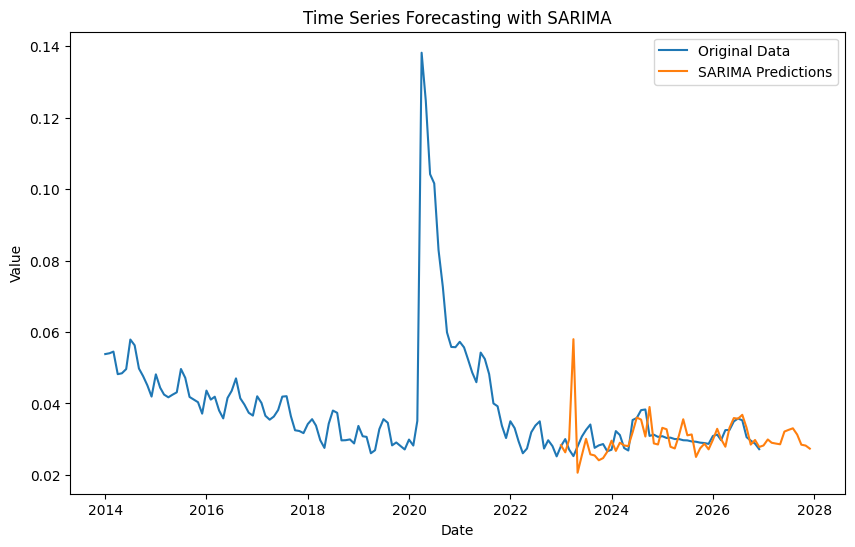

SARIMA - MSE: 3.359192609515699e-05, RMSE: 0.0057958542161752995, MAPE: 11.01%


In [ ]:
model_sarima(data_filtered,'United States of America', '25+', 'Female')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=1.05 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-892.165, Time=0.03 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-920.005, Time=0.03 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.23 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-894.165, Time=0.02 sec
 ARIMA(2,2,0)(0,0,0)[0] intercept   : AIC=-945.168, Time=0.11 sec
 ARIMA(3,2,0)(0,0,0)[0] intercept   : AIC=-947.419, Time=0.06 sec
 ARIMA(3,2,1)(0,0,0)[0] intercept   : AIC=-986.512, Time=0.50 sec
 ARIMA(2,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.36 sec
 ARIMA(3,2,2)(0,0,0)[0] intercept   : AIC=-973.868, Time=0.38 sec
 ARIMA(2,2,2)(0,0,0)[0] intercept   : AIC=-986.669, Time=0.35 sec
 ARIMA(1,2,2)(0,0,0)[0] intercept   : AIC=-975.326, Time=0.26 sec
 ARIMA(2,2,3)(0,0,0)[0] intercept   : AIC=-974.905, Time=0.09 sec
 ARIMA(1,2,3)(0,0,0)[0] intercept   : AIC=-981.422, Time=0.23 sec
 ARIMA(3,2,3)(0,0,0)[0] intercept   : AIC=-977.3

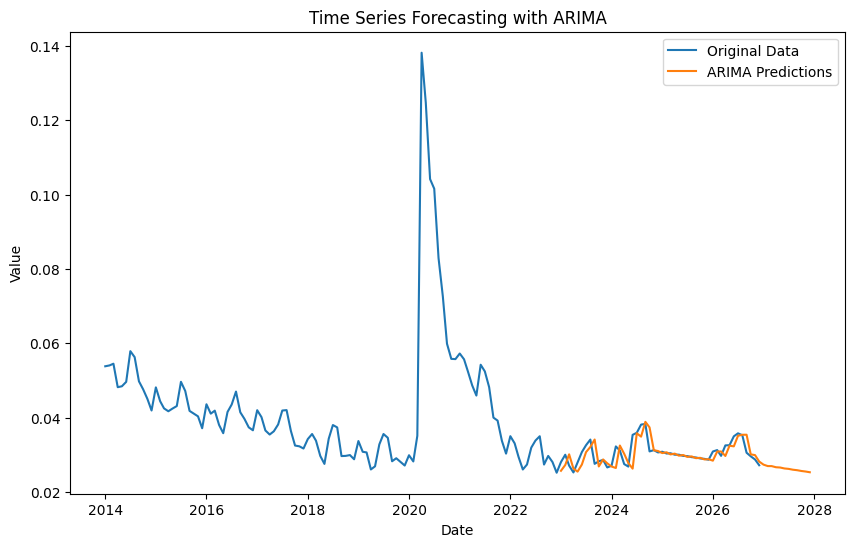

ARIMA - MSE: 6.7563141222719274e-06, RMSE: 0.0025992910807125713, MAPE: 5.41%


In [ ]:
model_arima(data_filtered,'United States of America', '25+', 'Female')

## 25+, Total

In [ ]:
data_filtered = prepare_data(combined_df, country='United States of America', age='25+', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.6912
Weak or no seasonality detected.


(0.6912158053396849, False)

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-923.382, Time=0.92 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-858.093, Time=0.05 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-890.960, Time=0.22 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-925.328, Time=0.37 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-856.100, Time=0.13 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=inf, Time=1.05 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=inf, Time=1.09 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=-890.956, Time=0.22 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=inf, Time=1.40 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=inf, Time=0.61 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=-933.274, Time=1.75 sec
 ARIMA(0,1,2)(0,1,0)[12]             : AIC=-857.734, Time=0.18 sec
 ARIMA(0,1,2)(1,1,1)[12]             : AIC=-922.209, Time=0.30 sec
 ARIMA(0,1,2)(0,1,2)[12]             : AIC=inf, Time=0.69 sec
 ARIMA(0,1,2)(1,1,0)[12]             : AIC=-

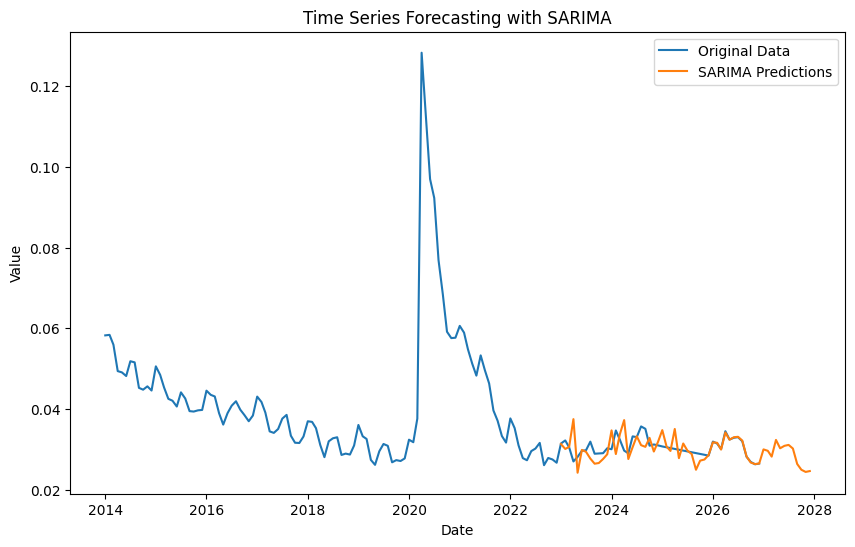

SARIMA - MSE: 8.481428525431266e-06, RMSE: 0.0029122892242068378, MAPE: 6.14%


In [ ]:
model_sarima(data_filtered,'United States of America', '25+', 'Total')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=1.13 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-931.783, Time=0.04 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-964.471, Time=0.08 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=-1033.567, Time=0.28 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-933.783, Time=0.03 sec
 ARIMA(0,2,2)(0,0,0)[0] intercept   : AIC=-1025.402, Time=0.24 sec
 ARIMA(1,2,2)(0,0,0)[0] intercept   : AIC=-1018.608, Time=0.37 sec
 ARIMA(0,2,1)(0,0,0)[0]             : AIC=inf, Time=0.25 sec

Best model:  ARIMA(0,2,1)(0,0,0)[0] intercept
Total fit time: 2.418 seconds
                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                  156
Model:               SARIMAX(0, 2, 1)   Log Likelihood                 519.784
Date:                Mon, 09 Dec 2024   AIC                          -1033.567
Time:                        14:42:32   BIC

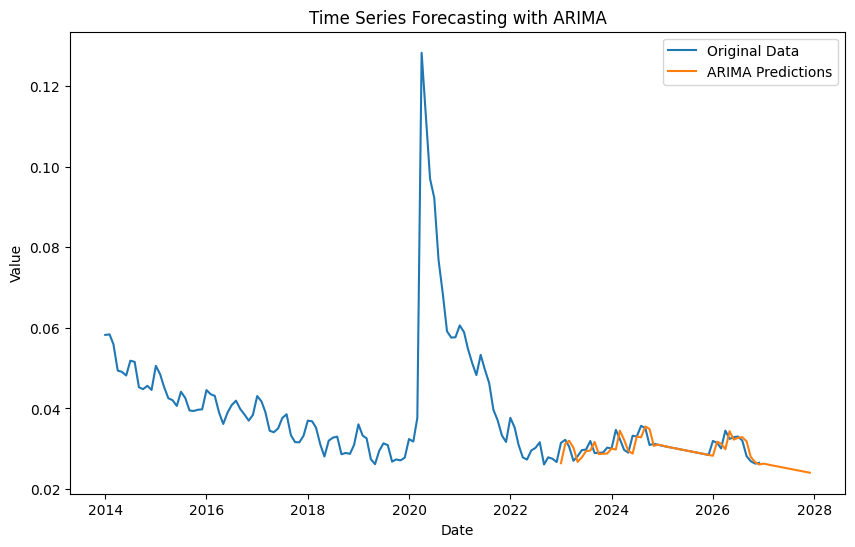

ARIMA - MSE: 4.066510668273736e-06, RMSE: 0.0020165591159878593, MAPE: 4.20%


In [ ]:
model_arima(data_filtered,'United States of America', '25+', 'Total')

# Germany


For Germany, the seasonal strength was high, around 0.97, indicating a very strong seasonal pattern. Given this high level of seasonality, SARIMA was applied to this country, as it is designed to capture both trend and seasonal components effectively. The significant seasonal fluctuations make SARIMA an ideal model for accurate forecasting in this case.

## 15-24 Male

In [ ]:
data_filtered = prepare_data(combined_df, country='Germany', age='15-24', sex='Male')


In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)


Seasonal Strength: 0.9881
Strong seasonality detected.


(0.9881450849758528, True)

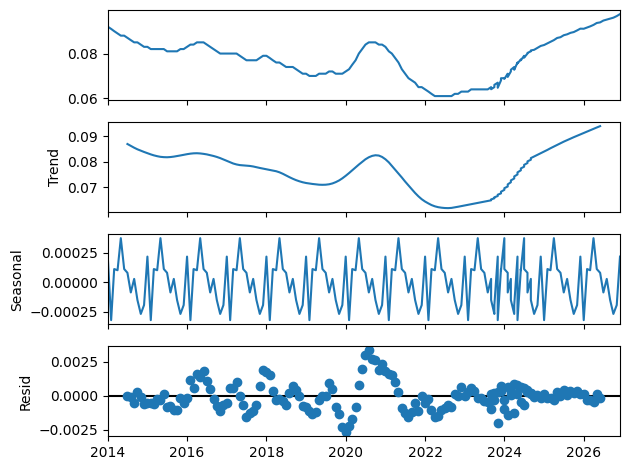

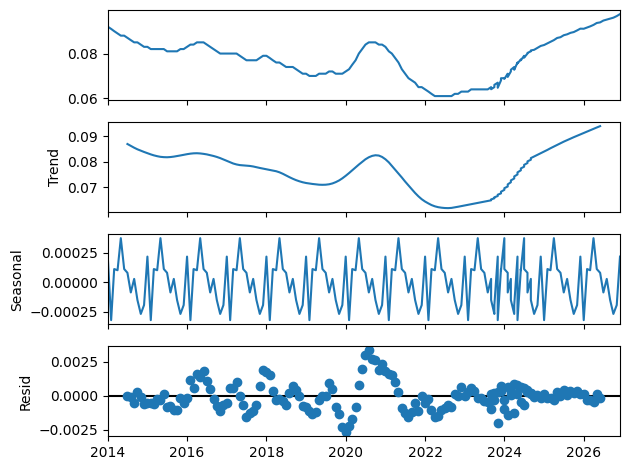

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()


In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1656.954, Time=1.21 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1475.139, Time=0.09 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1634.313, Time=0.28 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1557.299, Time=0.08 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-1611.991, Time=0.11 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1642.822, Time=0.87 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1658.165, Time=1.55 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=-1647.849, Time=1.82 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=-1589.549, Time=1.49 sec
 ARIMA(1,1,0)(0,1,2)[12]             : AIC=-1648.403, Time=1.34 sec
 ARIMA(2,1,1)(0,1,2)[12]             : AIC=-1658.442, Time=2.05 sec
 ARIMA(2,1,1)(0,1,1)[12]             : AIC=-1657.756, Time=0.91 sec
 ARIMA(2,1,1)(1,1,2)[12]             : AIC=-1648.073, Time=2.40 sec
 ARIMA(2,1,1)(1,1,1)[12]             : AIC=-1644.602, Time=1.04 sec
 ARIM

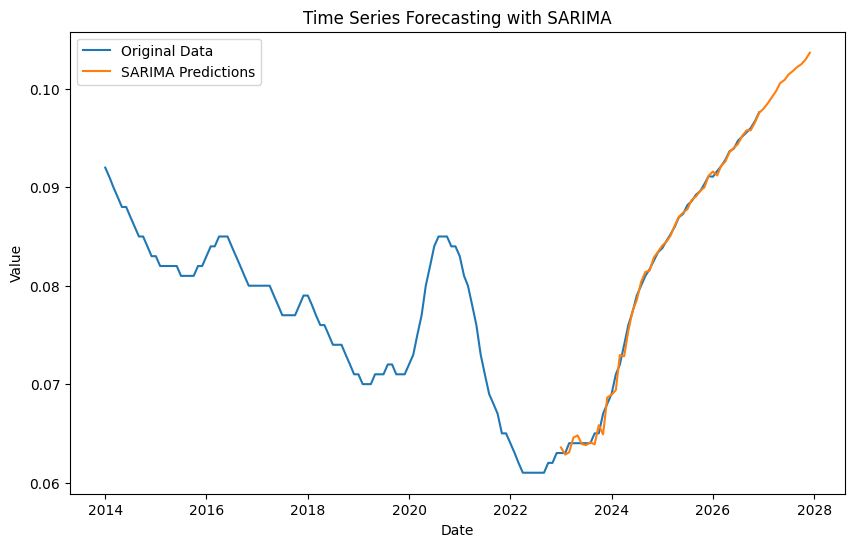

SARIMA - MSE: 3.3387812354598546e-07, RMSE: 0.0005778218787359868, MAPE: 0.53%


In [ ]:
model_sarima(data_filtered,'Germany', '15-24', 'Male')


## 15-24 Female

In [ ]:
data_filtered = prepare_data(combined_df, country='Germany', age='15-24', sex='Female')


In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)


Seasonal Strength: 0.9684
Strong seasonality detected.


(0.9683757395803718, True)

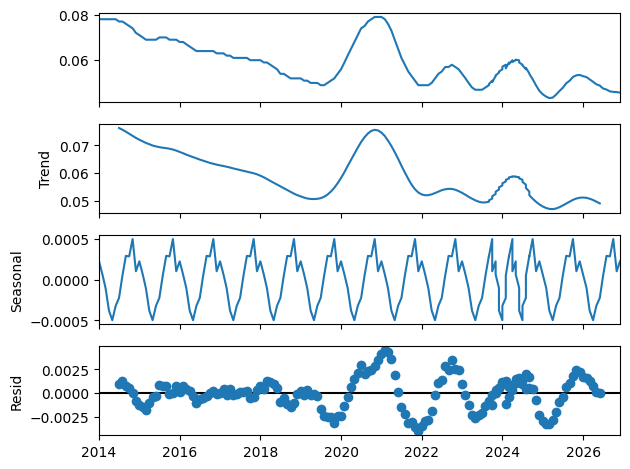

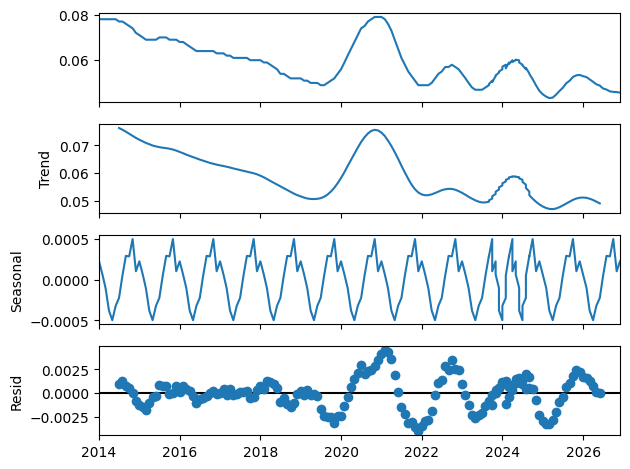

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=1.23 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1304.788, Time=0.10 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1562.125, Time=0.54 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=0.45 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-1532.604, Time=0.10 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-1566.283, Time=1.09 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=-1570.468, Time=1.67 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=-1568.519, Time=0.28 sec
 ARIMA(1,1,0)(2,1,2)[12]             : AIC=-1564.621, Time=2.08 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=-1593.265, Time=1.23 sec
 ARIMA(1,1,0)(0,1,2)[12]             : AIC=-1586.932, Time=1.85 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=inf, Time=0.63 sec
 ARIMA(0,1,0)(1,1,2)[12]             : AIC=-1436.964, Time=1.09 sec
 ARIMA(2,1,0)(1,1,2)[12]             : AIC=-1594.839, Time=2.13 sec
 ARIMA(2,1,0)(0,1,2)[12

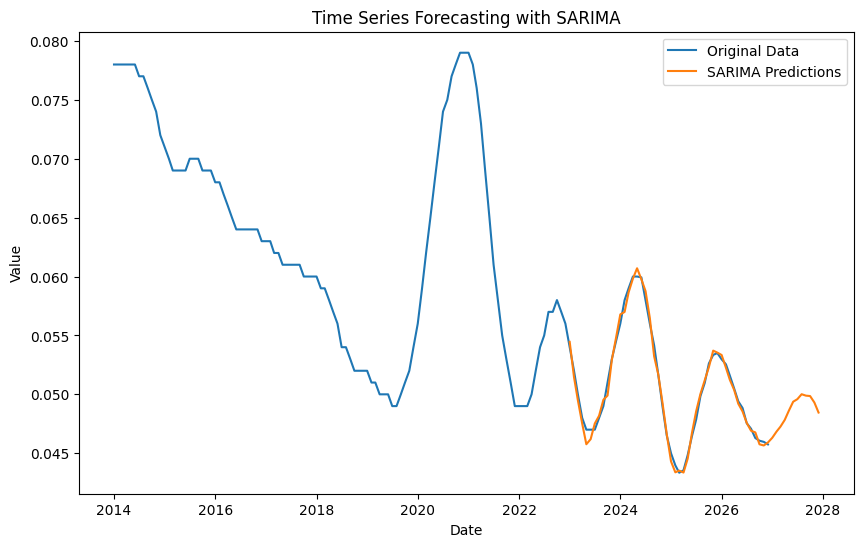

SARIMA - MSE: 2.4916493882817885e-07, RMSE: 0.0004991642403339595, MAPE: 0.81%


In [ ]:
model_sarima(data_filtered,'Germany', '15-24', 'Female')


## 15-24 Total

In [ ]:
data_filtered = prepare_data(combined_df, country='Germany', age='15-24', sex='Total')


In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)


Seasonal Strength: 0.9793
Strong seasonality detected.


(0.9793223216087171, True)

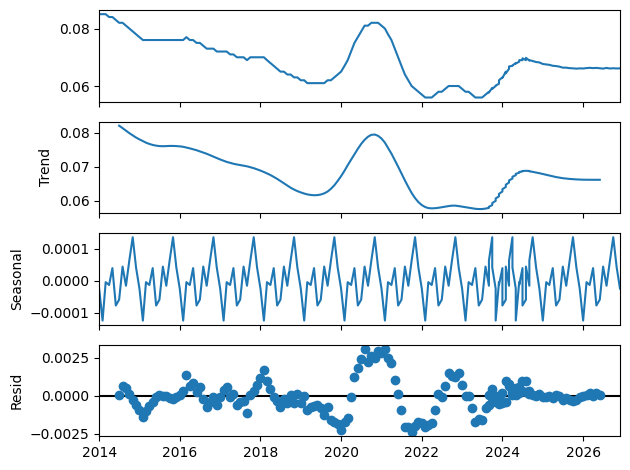

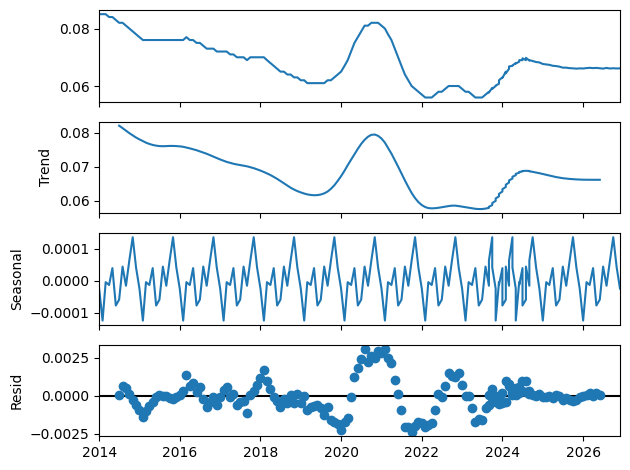

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()


In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1672.634, Time=1.61 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1416.309, Time=0.06 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1618.671, Time=0.43 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1575.518, Time=0.68 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-1591.581, Time=0.18 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1637.949, Time=0.83 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1587.575, Time=0.35 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1633.091, Time=0.96 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=-1625.960, Time=2.40 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1659.191, Time=0.57 sec
 ARIMA(2,1,1)(0,1,1)[12]             : AIC=-1671.592, Time=1.36 sec
 ARIMA(1,1,2)(0,1,1)[12]             : AIC=-1687.724, Time=1.06 sec
 ARIMA(1,1,2)(0,1,0)[12]             : AIC=-1610.862, Time=0.15 sec
 ARIMA(1,1,2)(1,1,1)[12]             : AIC=-1641.372, Time=0.36 sec
 ARIM

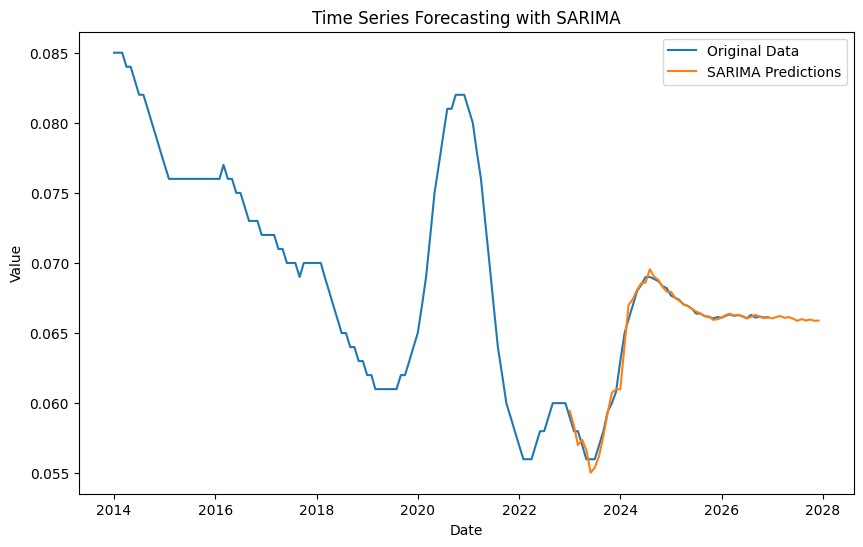

SARIMA - MSE: 2.351037489705e-07, RMSE: 0.00048487498282598574, MAPE: 0.47%


In [ ]:
model_sarima(data_filtered,'Germany', '15-24', 'Total')


## 25+ Male

In [ ]:
data_filtered = prepare_data(combined_df, country='Germany', age='25+', sex='Male')


In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)


Seasonal Strength: 0.9903
Strong seasonality detected.


(0.9902879393324442, True)

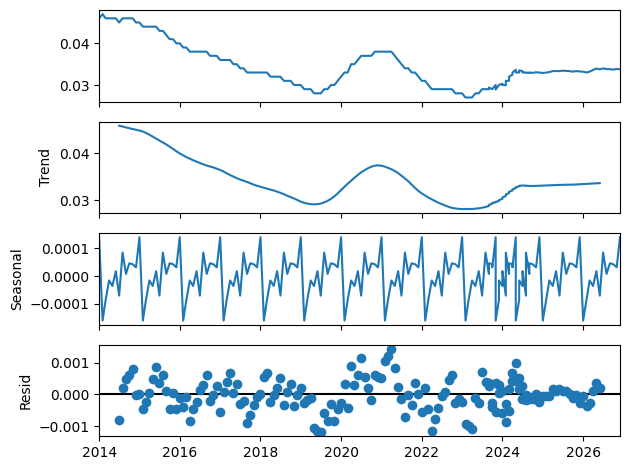

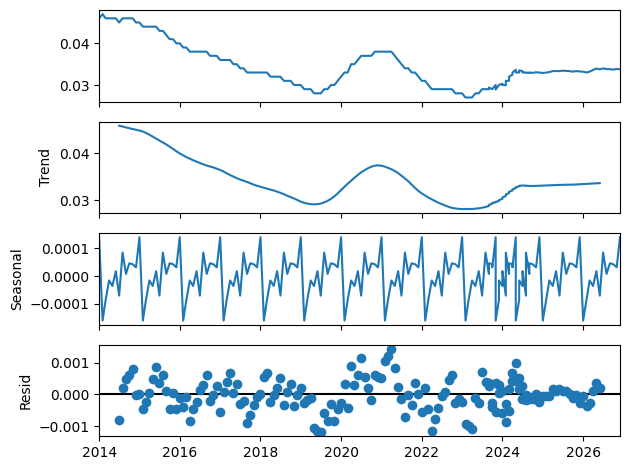

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()


In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1680.578, Time=1.90 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1616.486, Time=0.09 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1642.716, Time=0.85 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1668.489, Time=0.71 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-1628.597, Time=0.18 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1665.695, Time=1.61 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1624.628, Time=2.35 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1652.747, Time=0.62 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=inf, Time=3.37 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1670.421, Time=0.72 sec
 ARIMA(2,1,1)(0,1,1)[12]             : AIC=-1689.264, Time=1.54 sec
 ARIMA(2,1,1)(0,1,0)[12]             : AIC=-1636.802, Time=0.56 sec
 ARIMA(2,1,1)(1,1,1)[12]             : AIC=-1674.820, Time=1.66 sec
 ARIMA(2,1,1)(0,1,2)[12]             : AIC=-1632.808, Time=3.76 sec
 ARIMA(2,1,

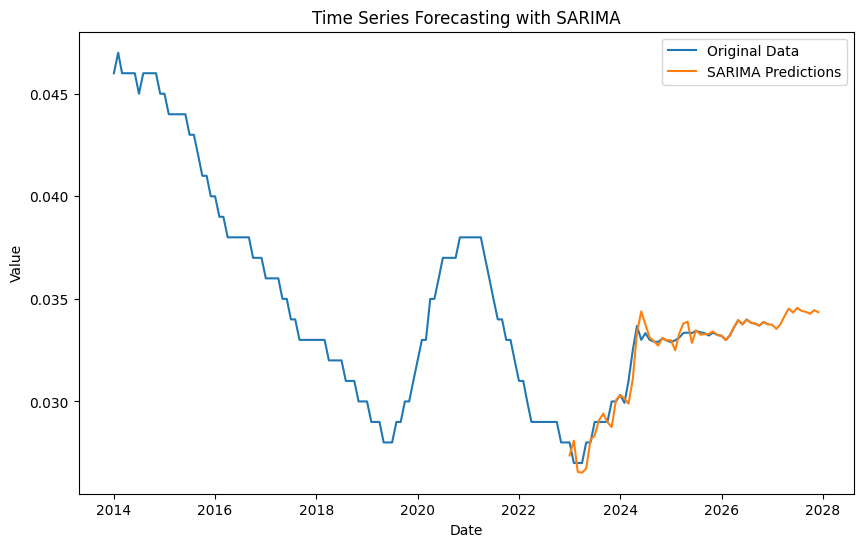

SARIMA - MSE: 2.5750979688123787e-07, RMSE: 0.0005074542313167148, MAPE: 0.98%


In [ ]:
model_sarima(data_filtered,'Germany', '25+', 'Male')


## 25+ Female

In [ ]:
data_filtered = prepare_data(combined_df, country='Germany', age='25+', sex='Female')


In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)


Seasonal Strength: 0.9866
Strong seasonality detected.


(0.9865751212562996, True)

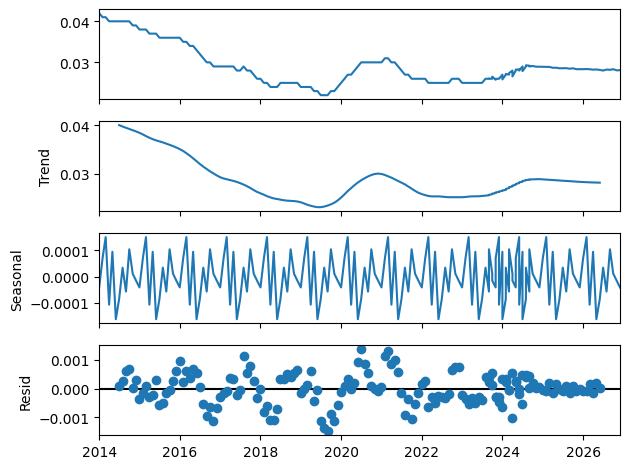

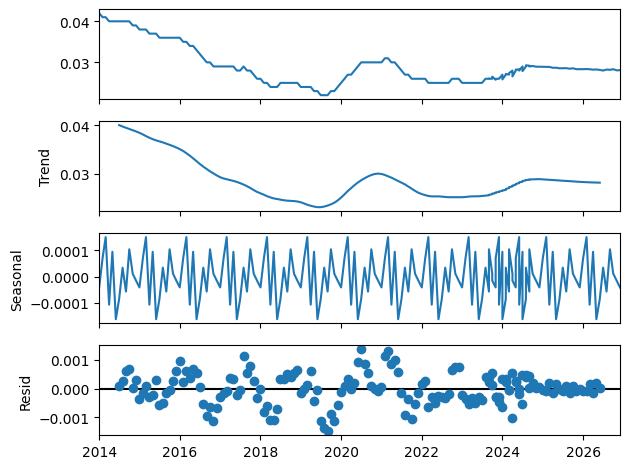

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()


In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1727.192, Time=0.80 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1633.547, Time=0.09 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1687.009, Time=0.26 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1716.144, Time=0.53 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-1645.124, Time=0.35 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1721.090, Time=0.90 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1717.993, Time=1.04 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1692.662, Time=0.22 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=-1709.821, Time=1.51 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1719.891, Time=1.39 sec
 ARIMA(2,1,1)(0,1,1)[12]             : AIC=-1730.421, Time=0.44 sec
 ARIMA(2,1,1)(0,1,0)[12]             : AIC=-1648.821, Time=0.34 sec
 ARIMA(2,1,1)(1,1,1)[12]             : AIC=-1722.797, Time=0.54 sec
 ARIMA(2,1,1)(0,1,2)[12]             : AIC=-1720.598, Time=1.20 sec
 ARIM

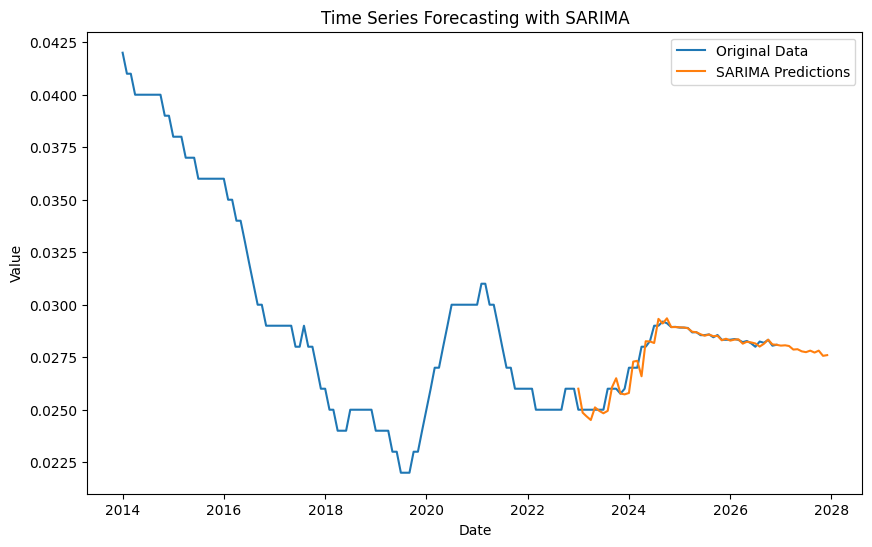

SARIMA - MSE: 1.5594777223013087e-07, RMSE: 0.0003949022312296182, MAPE: 0.79%


In [ ]:
model_sarima(data_filtered,'Germany', '25+', 'Female')


## 25+ Total

In [ ]:
data_filtered = prepare_data(combined_df, country='Germany', age='25+', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)


Seasonal Strength: 0.9905
Strong seasonality detected.


(0.9904818953738207, True)

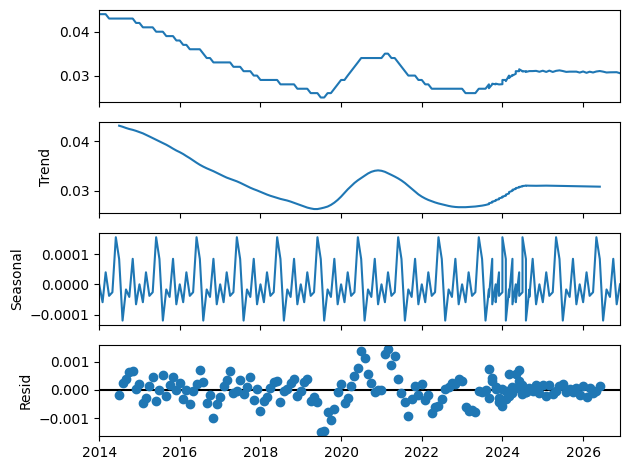

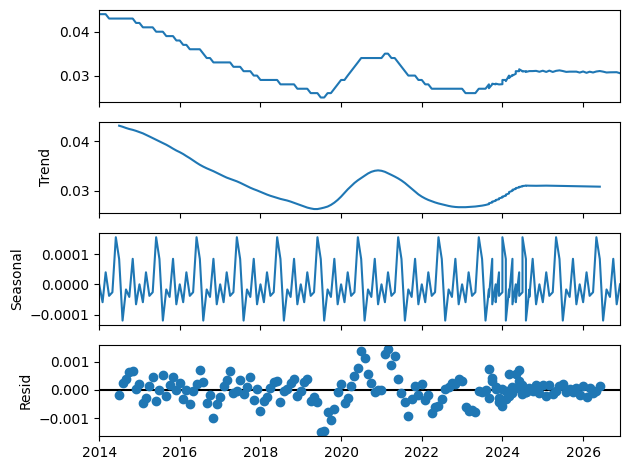

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()


In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1740.822, Time=1.34 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1647.744, Time=0.05 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1681.233, Time=0.80 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1723.818, Time=0.79 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-1344.275, Time=0.35 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1720.448, Time=3.03 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1689.197, Time=2.76 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1693.142, Time=1.52 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=-1702.224, Time=4.03 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1727.816, Time=0.98 sec
 ARIMA(2,1,1)(0,1,1)[12]             : AIC=-1711.547, Time=1.25 sec
 ARIMA(1,1,2)(0,1,1)[12]             : AIC=-1738.705, Time=0.84 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=-1717.548, Time=0.30 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=-1727.225, Time=1.01 sec
 ARIM

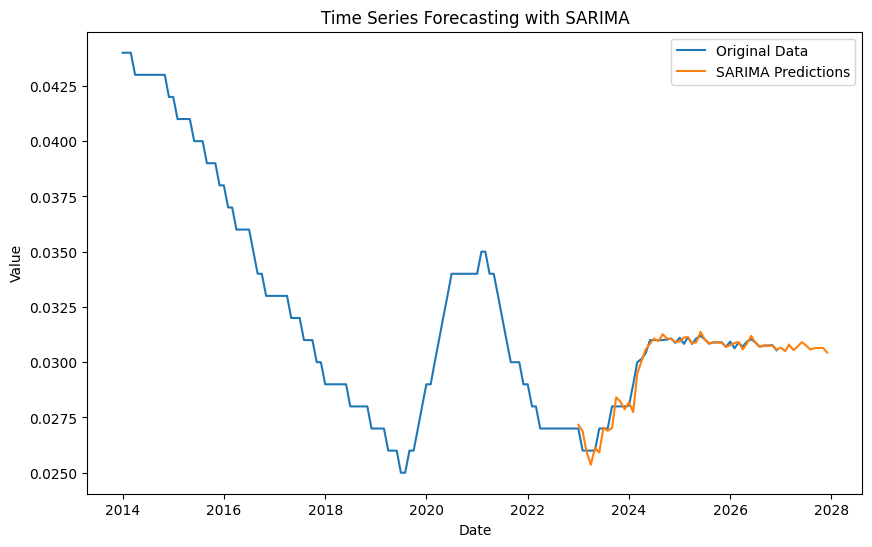

SARIMA - MSE: 1.23970558393899e-07, RMSE: 0.00035209453047995365, MAPE: 0.69%


In [ ]:
model_sarima(data_filtered,'Germany', '25+', 'Total')


# Ireland


For Ireland, the seasonal strength was high, around 0.95, indicating a very strong seasonal pattern. Given this high level of seasonality, SARIMA was applied to the dataset, as it is designed to capture both trend and seasonal components effectively. The significant seasonal fluctuations make SARIMA an ideal model for accurate forecasting in this case.

## 15-24 Male

In [ ]:
data_filtered = prepare_data(combined_df, country='Ireland', age='15-24', sex='Male')


In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)


Seasonal Strength: 0.9409
Strong seasonality detected.


(0.9408705580855545, True)

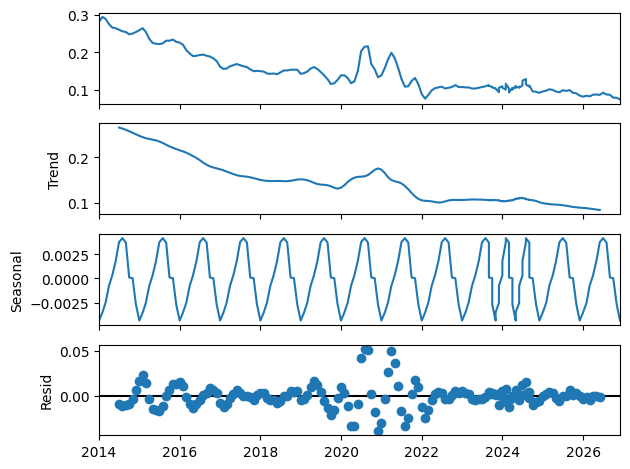

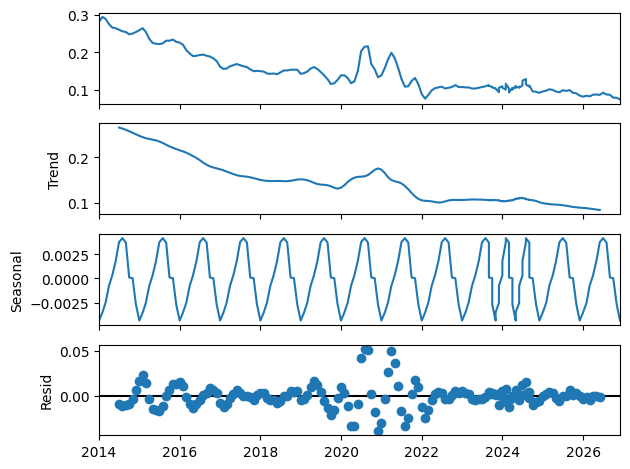

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()


In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-893.900, Time=2.14 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-767.337, Time=0.08 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-852.217, Time=0.70 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-892.510, Time=1.16 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-814.892, Time=0.44 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-892.334, Time=2.17 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=inf, Time=4.21 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-855.753, Time=1.71 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=inf, Time=4.78 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-893.591, Time=0.42 sec
 ARIMA(2,1,1)(0,1,1)[12]             : AIC=-919.479, Time=2.03 sec
 ARIMA(2,1,1)(0,1,0)[12]             : AIC=-843.811, Time=1.10 sec
 ARIMA(2,1,1)(1,1,1)[12]             : AIC=inf, Time=1.65 sec
 ARIMA(2,1,1)(0,1,2)[12]             : AIC=-902.008, Time=4.25 sec
 ARIMA(2,1,1)(1,1,0)[12]          

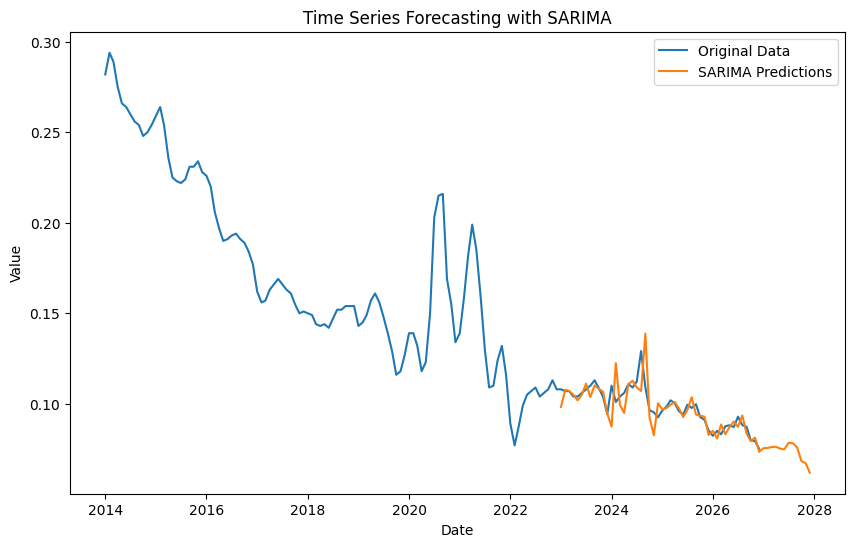

SARIMA - MSE: 6.629272183815715e-05, RMSE: 0.008142034256754091, MAPE: 4.90%


In [ ]:
model_sarima(data_filtered,'Ireland', '15-24', 'Male')


## 15-24 Female

In [ ]:
data_filtered = prepare_data(combined_df, country='Ireland', age='15-24', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)


Seasonal Strength: 0.8912
Strong seasonality detected.


(0.891160207310158, True)

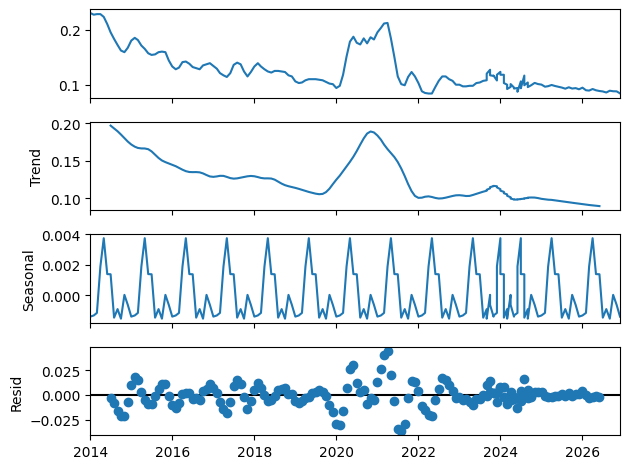

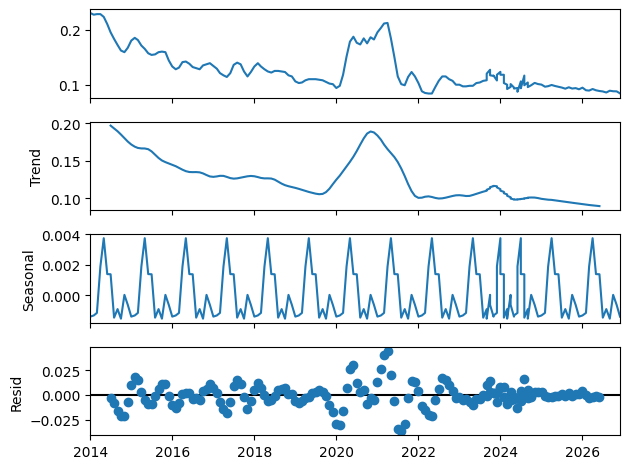

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()


In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-946.233, Time=2.30 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-813.291, Time=0.06 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-905.522, Time=0.39 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=1.50 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-874.552, Time=0.15 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-931.348, Time=2.95 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=inf, Time=3.20 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-911.949, Time=1.20 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=inf, Time=3.19 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-940.300, Time=2.48 sec
 ARIMA(2,1,1)(0,1,1)[12]             : AIC=-953.149, Time=2.56 sec
 ARIMA(2,1,1)(0,1,0)[12]             : AIC=-881.137, Time=0.07 sec
 ARIMA(2,1,1)(1,1,1)[12]             : AIC=-944.725, Time=1.68 sec
 ARIMA(2,1,1)(0,1,2)[12]             : AIC=inf, Time=5.19 sec
 ARIMA(2,1,1)(1,1,0)[12]             : 

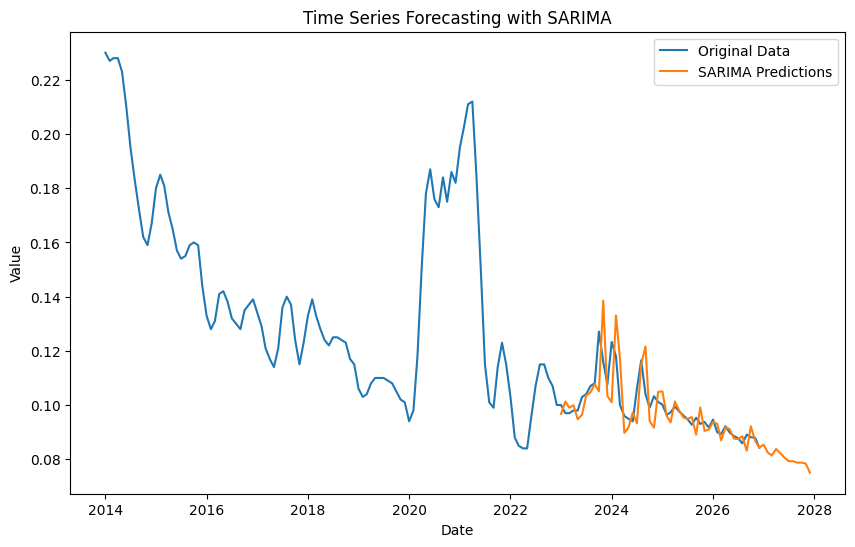

SARIMA - MSE: 6.342542808717684e-05, RMSE: 0.007964008292761683, MAPE: 4.90%


In [ ]:
model_sarima(data_filtered,'Ireland', '15-24', 'Female')

## 15-24 Total

In [ ]:
data_filtered = prepare_data(combined_df, country='Ireland', age='15-24', sex='Total')


In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9459
Strong seasonality detected.


(0.9459183890925977, True)

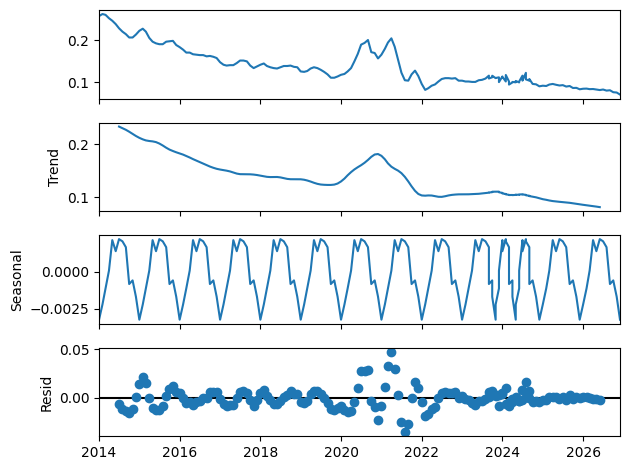

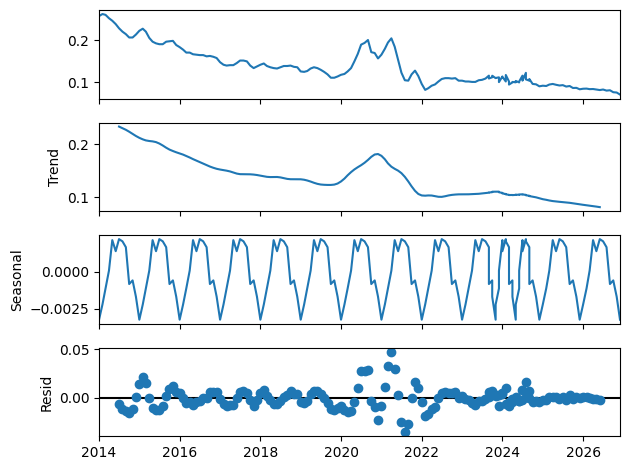

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=1.23 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-839.254, Time=0.08 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-940.683, Time=0.95 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=0.86 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-889.936, Time=0.07 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-960.821, Time=1.33 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=-972.275, Time=3.16 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=-979.933, Time=1.96 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=inf, Time=1.10 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=inf, Time=1.71 sec
 ARIMA(1,1,0)(0,1,2)[12]             : AIC=inf, Time=2.22 sec
 ARIMA(1,1,0)(2,1,2)[12]             : AIC=-978.244, Time=3.88 sec
 ARIMA(0,1,0)(1,1,1)[12]             : AIC=inf, Time=2.03 sec
 ARIMA(2,1,0)(1,1,1)[12]             : AIC=-978.969, Time=1.90 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-976.2

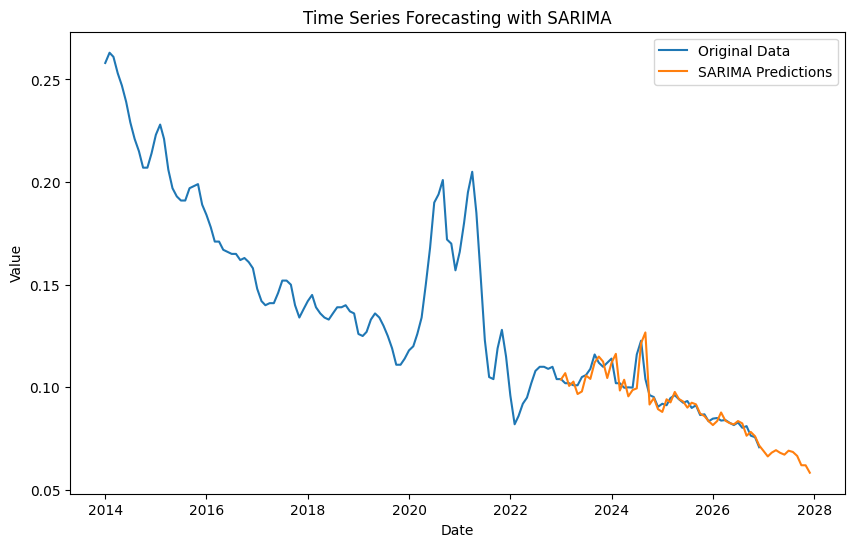

SARIMA - MSE: 2.884606860931325e-05, RMSE: 0.005370853620171867, MAPE: 3.26%


In [ ]:
model_sarima(data_filtered,'Ireland', '15-24', 'Total')

## 25+ Male

In [ ]:
data_filtered = prepare_data(combined_df, country='Ireland', age='25+', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9919
Strong seasonality detected.


(0.991946828283503, True)

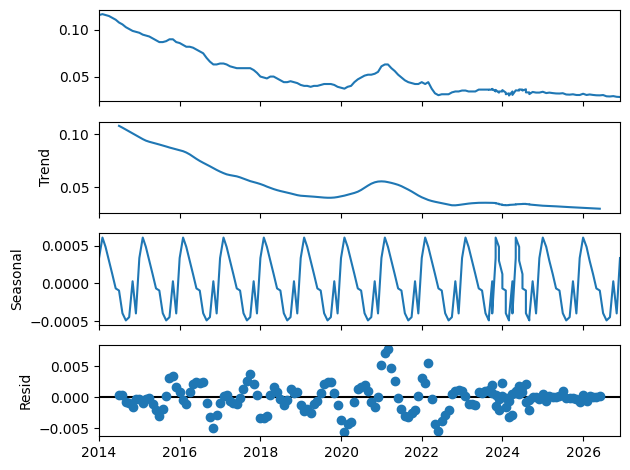

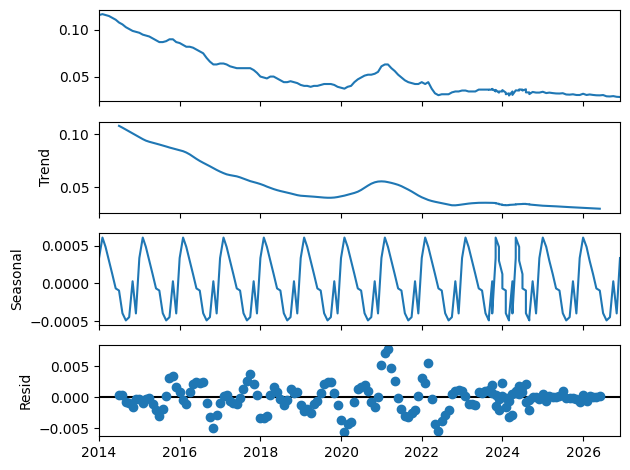

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1411.461, Time=2.01 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1306.559, Time=0.14 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1391.693, Time=0.51 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1387.095, Time=0.43 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-1360.220, Time=0.39 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1402.197, Time=0.91 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1356.221, Time=1.54 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1389.655, Time=0.64 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=inf, Time=2.81 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1413.834, Time=1.04 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-1361.305, Time=0.06 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=-1404.585, Time=0.55 sec
 ARIMA(1,1,0)(0,1,2)[12]             : AIC=-1357.305, Time=0.45 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=inf, Time=1.04 sec
 ARIMA(0,1,0)(0,1

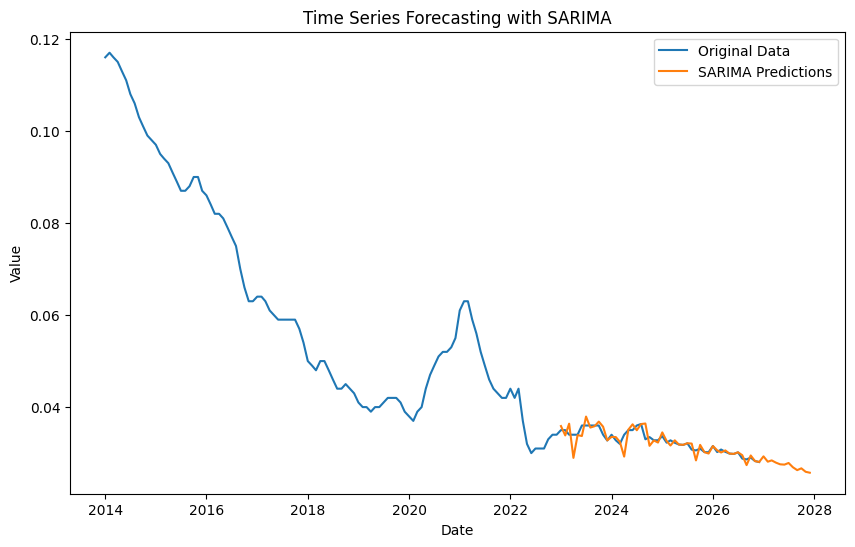

SARIMA - MSE: 2.092763663265411e-06, RMSE: 0.0014466387466349057, MAPE: 2.70%


In [ ]:

model_sarima(data_filtered,'Ireland', '25+', 'Male')

## 25+ Female

In [ ]:
data_filtered = prepare_data(combined_df, country='Ireland', age='25+', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9736
Strong seasonality detected.


(0.9736134816328867, True)

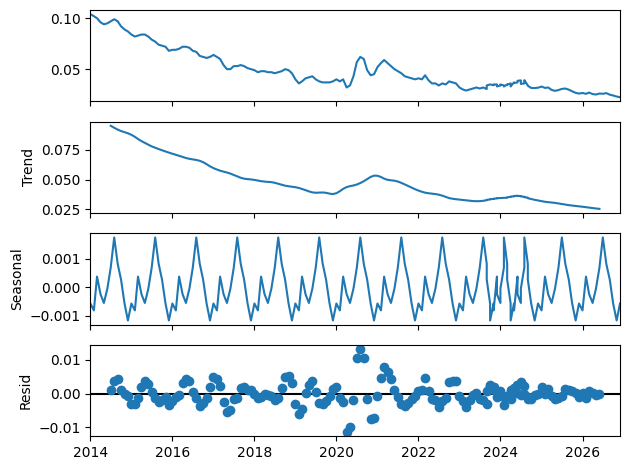

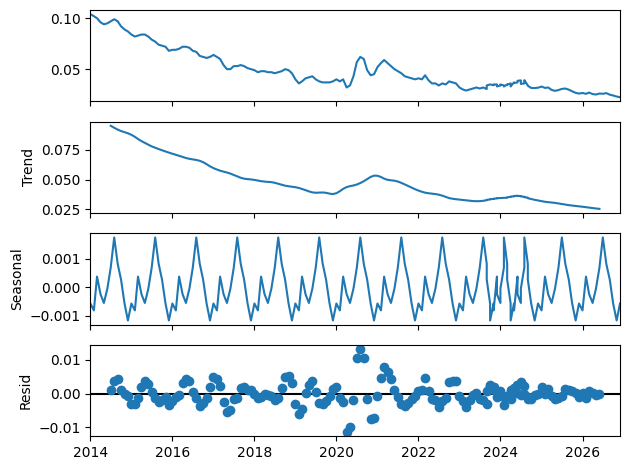

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1266.925, Time=1.77 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1171.852, Time=0.10 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1223.662, Time=0.68 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1269.036, Time=1.17 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-1200.586, Time=0.45 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-1249.776, Time=1.46 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=-1241.101, Time=1.48 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=-1219.844, Time=0.43 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=-1266.872, Time=5.87 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=-1243.601, Time=0.63 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=-1290.227, Time=1.65 sec
 ARIMA(0,1,2)(0,1,0)[12]             : AIC=-1221.658, Time=0.31 sec
 ARIMA(0,1,2)(1,1,1)[12]             : AIC=-1268.232, Time=0.88 sec
 ARIMA(0,1,2)(0,1,2)[12]             : AIC=-1282.881, Time=2.96 sec
 ARIM

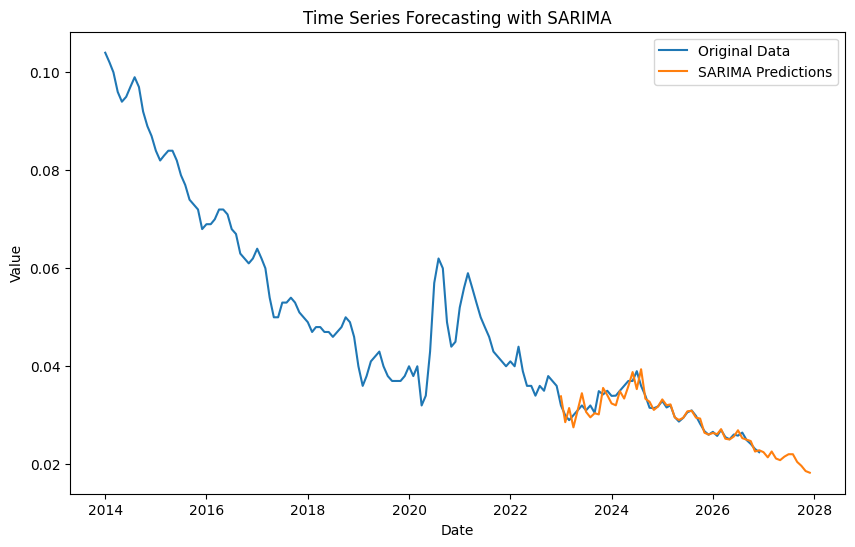

SARIMA - MSE: 2.1909609491942865e-06, RMSE: 0.001480189497731384, MAPE: 3.09%


In [ ]:
model_sarima(data_filtered,'Ireland', '25+', 'Female')

## 25+ Total


In [ ]:
data_filtered = prepare_data(combined_df, country='Ireland', age='25+', sex='Total')


In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9896
Strong seasonality detected.


(0.9896207774021202, True)

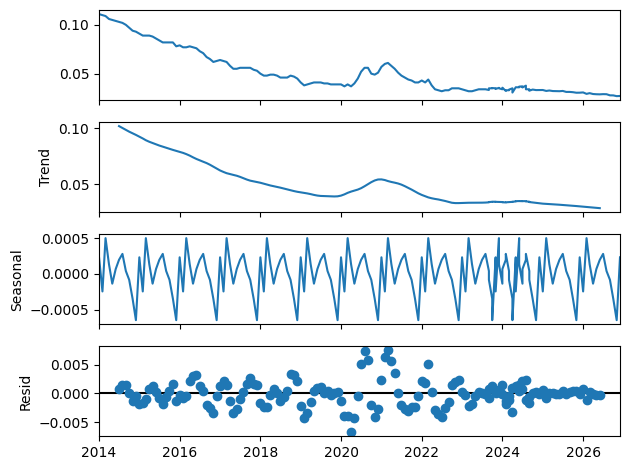

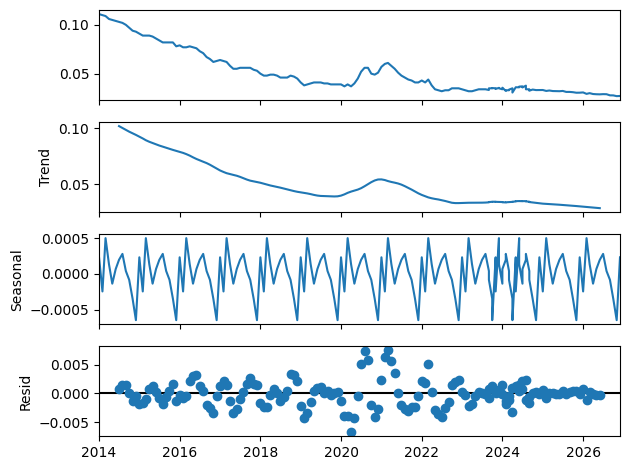

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1371.320, Time=0.84 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1285.207, Time=0.07 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1337.136, Time=0.34 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1363.347, Time=0.38 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-1313.415, Time=0.16 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1362.214, Time=0.44 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1309.416, Time=0.72 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1335.992, Time=0.22 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=-1364.668, Time=1.94 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1372.769, Time=0.35 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-1314.882, Time=0.17 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=-1363.595, Time=0.62 sec
 ARIMA(1,1,0)(0,1,2)[12]             : AIC=-1310.880, Time=0.65 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=-1332.635, Time=0.96 sec
 ARIM

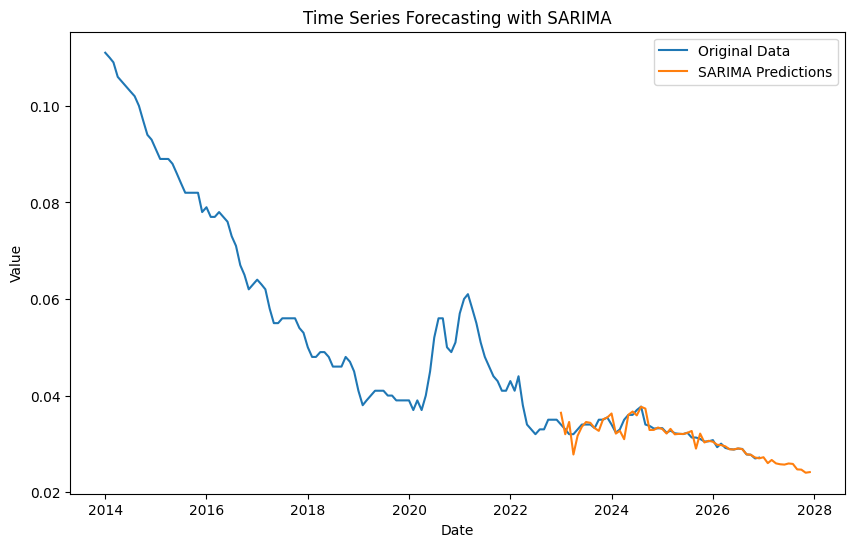

SARIMA - MSE: 1.731198252621254e-06, RMSE: 0.001315750072248242, MAPE: 2.31%


In [ ]:
model_sarima(data_filtered,'Ireland', '25+', 'Total')


# Netherlands


For Netherlands, the seasonal strength was high, around 0.96, indicating a very strong seasonal pattern. Given this high level of seasonality, SARIMA was applied to the dataset, as it is designed to capture both trend and seasonal components effectively. The significant seasonal fluctuations make SARIMA an ideal model for accurate forecasting in this case.

## 15-24 Male

In [ ]:
data_filtered = prepare_data(combined_df, country='Netherlands', age='15-24', sex='Male')


In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)


Seasonal Strength: 0.9674
Strong seasonality detected.


(0.9674412299039289, True)

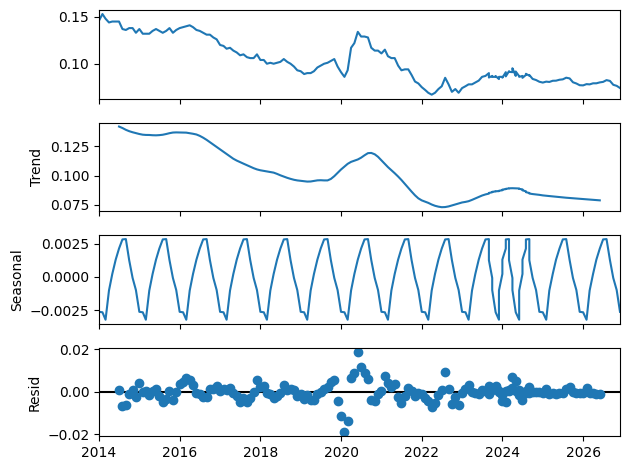

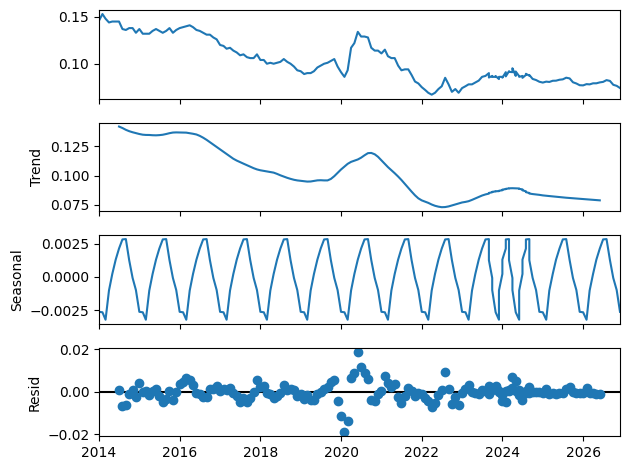

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1144.450, Time=1.23 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1079.833, Time=0.03 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1116.177, Time=0.55 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1145.035, Time=0.67 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-1082.507, Time=0.54 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-1132.717, Time=1.15 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=inf, Time=4.16 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=-1114.611, Time=0.70 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=inf, Time=5.00 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=-1143.663, Time=0.71 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=-1146.645, Time=1.08 sec
 ARIMA(0,1,2)(0,1,0)[12]             : AIC=-1087.344, Time=0.55 sec
 ARIMA(0,1,2)(1,1,1)[12]             : AIC=-1134.502, Time=1.10 sec
 ARIMA(0,1,2)(0,1,2)[12]             : AIC=inf, Time=2.74 sec
 ARIMA(0,1,2)(1,1,0)[12

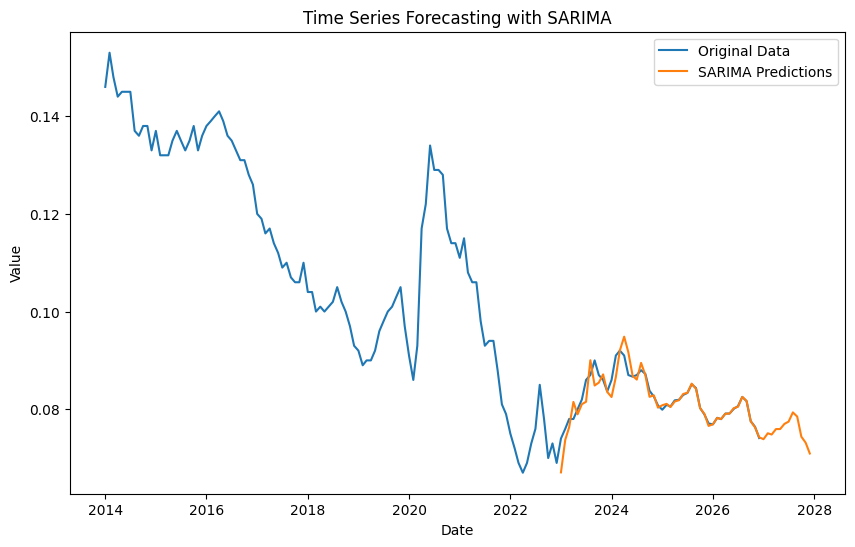

SARIMA - MSE: 4.2599009084745764e-06, RMSE: 0.0020639527389149626, MAPE: 1.41%


In [ ]:
model_sarima(data_filtered,'Netherlands', '15-24', 'Male')

## 15-24 Female

In [ ]:
data_filtered = prepare_data(combined_df, country='Netherlands', age='15-24', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9568
Strong seasonality detected.


(0.9567629437904523, True)

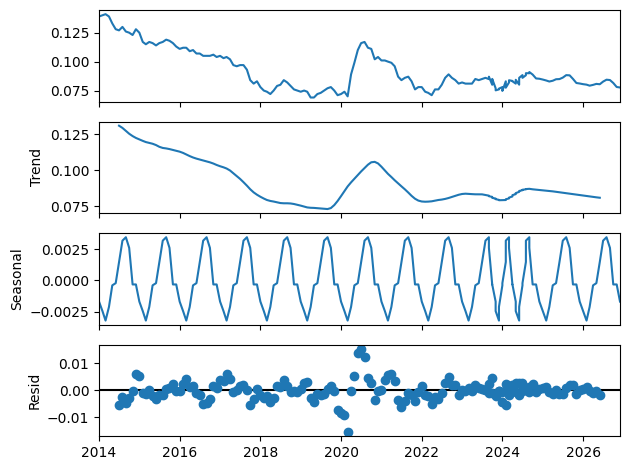

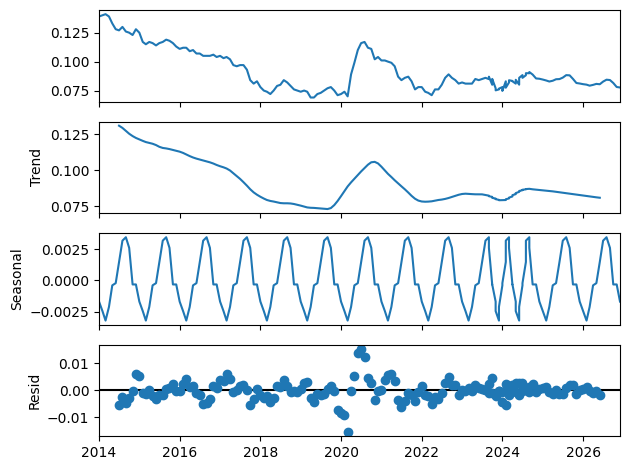

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=2.21 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1108.134, Time=0.11 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1155.081, Time=0.48 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1193.338, Time=1.57 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-1119.402, Time=0.29 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=inf, Time=2.48 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=inf, Time=1.61 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=-1157.227, Time=1.25 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=inf, Time=2.74 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=inf, Time=0.98 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=-1195.664, Time=0.29 sec
 ARIMA(0,1,2)(0,1,0)[12]             : AIC=-1121.550, Time=0.30 sec
 ARIMA(0,1,2)(1,1,1)[12]             : AIC=-1198.129, Time=2.13 sec
 ARIMA(0,1,2)(1,1,0)[12]             : AIC=-1154.015, Time=1.01 sec
 ARIMA(0,1,2)(2,1,1)[12]           

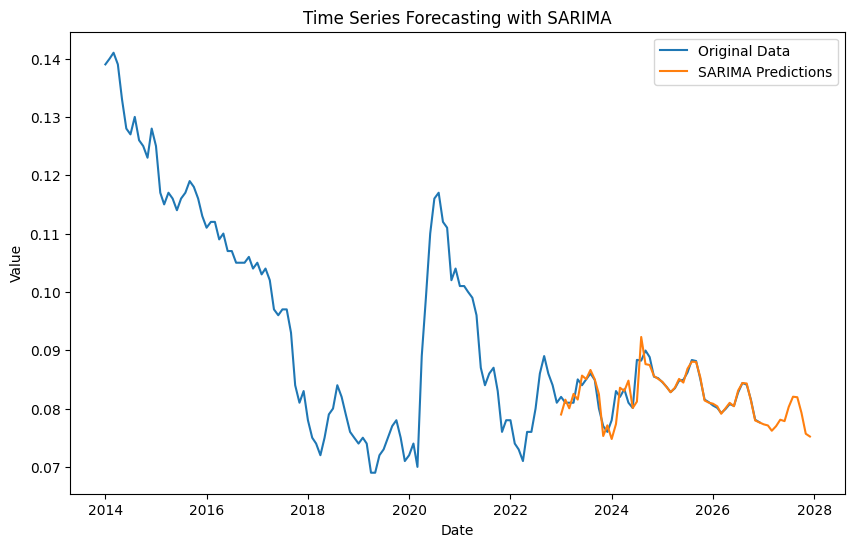

SARIMA - MSE: 3.6130465159260957e-06, RMSE: 0.0019008015456449144, MAPE: 1.28%


In [ ]:
model_sarima(data_filtered,'Netherlands', '15-24', 'Female')

## 15-24 Total

In [ ]:
data_filtered = prepare_data(combined_df, country='Netherlands', age='15-24', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9667
Strong seasonality detected.


(0.9666505376430923, True)

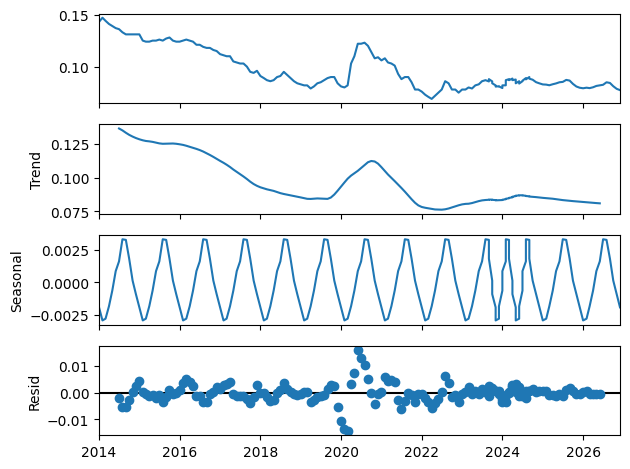

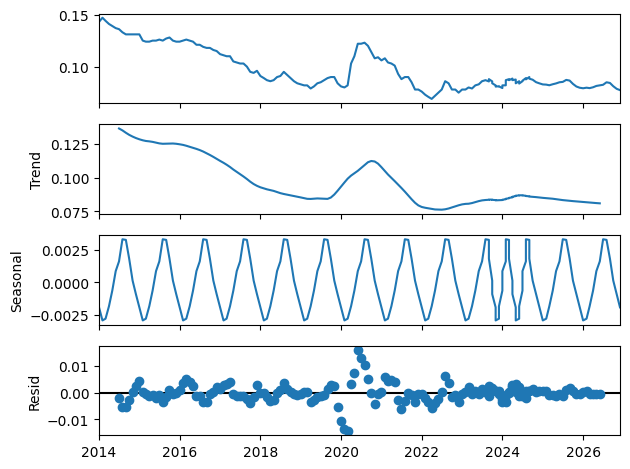

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1216.237, Time=1.93 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1128.552, Time=0.08 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1178.812, Time=0.58 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1211.210, Time=0.97 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-1143.696, Time=0.49 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1206.497, Time=2.66 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=inf, Time=6.50 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1177.575, Time=0.89 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=inf, Time=4.12 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1217.459, Time=0.62 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-1144.723, Time=0.24 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=-1199.880, Time=1.07 sec
 ARIMA(1,1,0)(0,1,2)[12]             : AIC=-1220.346, Time=2.87 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=inf, Time=2.13 sec
 ARIMA(0,1,0)(0,1,2)[12

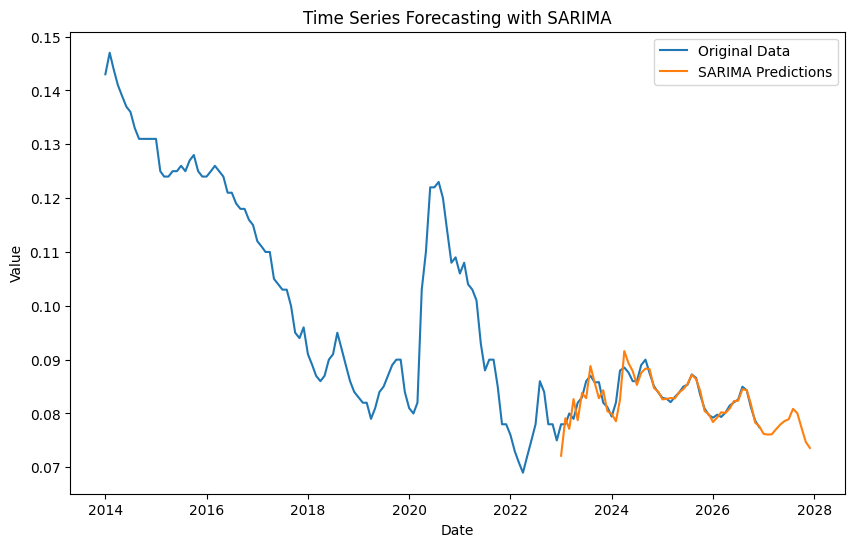

SARIMA - MSE: 3.42930523684496e-06, RMSE: 0.0018518383398247699, MAPE: 1.46%


In [ ]:
model_sarima(data_filtered,'Netherlands', '15-24', 'Total')

## 25+ Male

In [ ]:
data_filtered = prepare_data(combined_df, country='Netherlands', age='25+', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9945
Strong seasonality detected.


(0.9944597864648317, True)

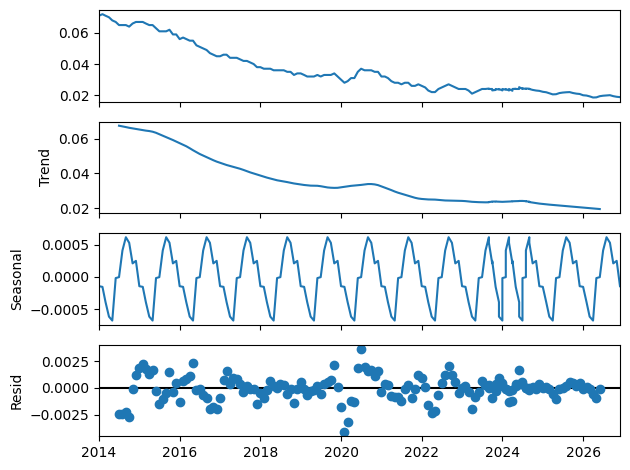

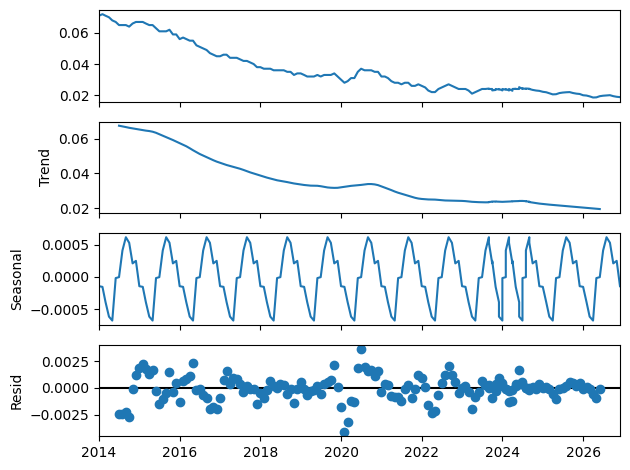

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1521.334, Time=0.88 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1471.041, Time=0.15 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1509.816, Time=0.30 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1523.297, Time=0.84 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-1469.039, Time=0.13 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-1517.244, Time=0.82 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=inf, Time=1.02 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=-1509.841, Time=0.48 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=-1519.352, Time=2.07 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=-1525.338, Time=0.31 sec
 ARIMA(0,1,0)(1,1,1)[12]             : AIC=-1519.273, Time=0.63 sec
 ARIMA(0,1,0)(0,1,2)[12]             : AIC=inf, Time=0.74 sec
 ARIMA(0,1,0)(1,1,0)[12]             : AIC=-1511.855, Time=0.18 sec
 ARIMA(0,1,0)(1,1,2)[12]             : AIC=-1521.432, Time=1.77 sec
 ARIMA(1,1,0)(0,1

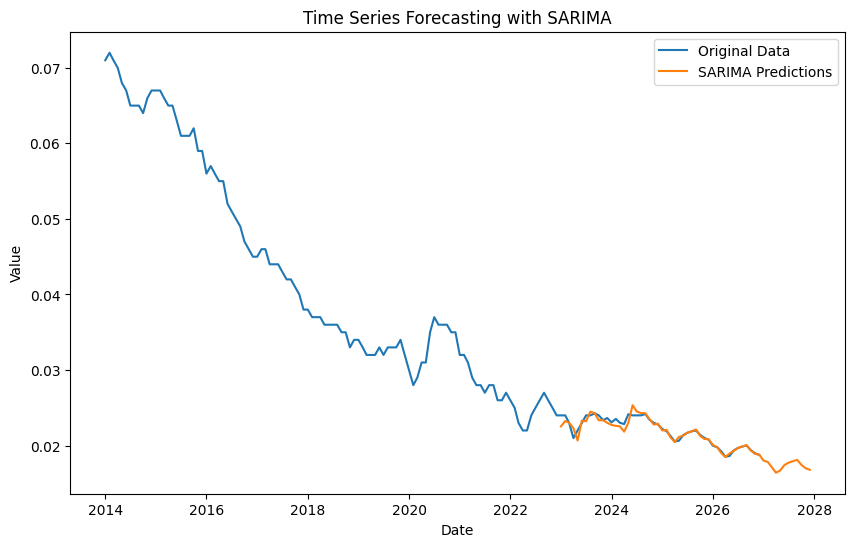

SARIMA - MSE: 2.9683540028295463e-07, RMSE: 0.0005448260275381074, MAPE: 1.55%


In [ ]:
model_sarima(data_filtered,'Netherlands', '25+', 'Male')

## 25+ Female

In [ ]:
data_filtered = prepare_data(combined_df, country='Netherlands', age='25+', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9933
Strong seasonality detected.


(0.9933371621383846, True)

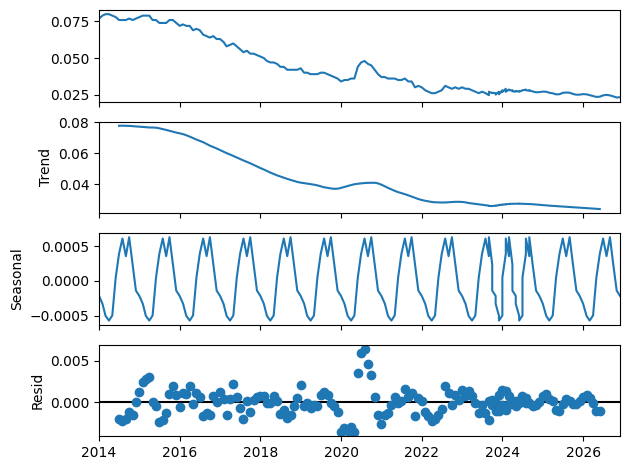

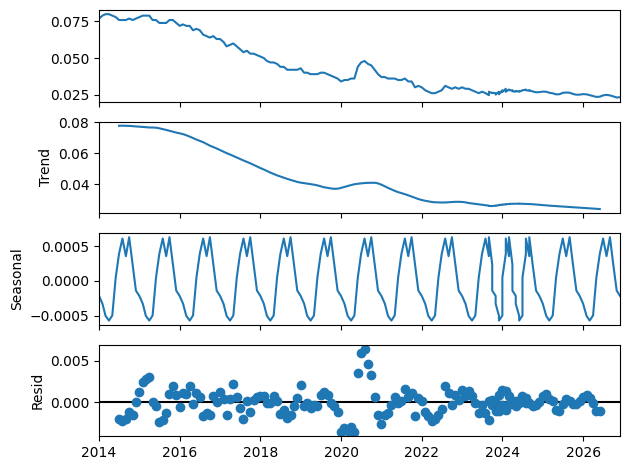

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1434.442, Time=1.42 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1396.736, Time=0.09 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1419.764, Time=0.45 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1436.428, Time=0.68 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-1394.773, Time=0.39 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-1425.771, Time=0.87 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=-1440.873, Time=1.76 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=-1436.968, Time=2.47 sec
 ARIMA(0,1,0)(0,1,2)[12]             : AIC=-1442.268, Time=0.60 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=-1437.988, Time=0.37 sec
 ARIMA(0,1,0)(1,1,2)[12]             : AIC=-1439.015, Time=2.59 sec
 ARIMA(0,1,0)(1,1,1)[12]             : AIC=-1427.335, Time=0.43 sec
 ARIMA(1,1,0)(0,1,2)[12]             : AIC=-1440.963, Time=2.22 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1438.891, Time=1.43 sec
 ARIM

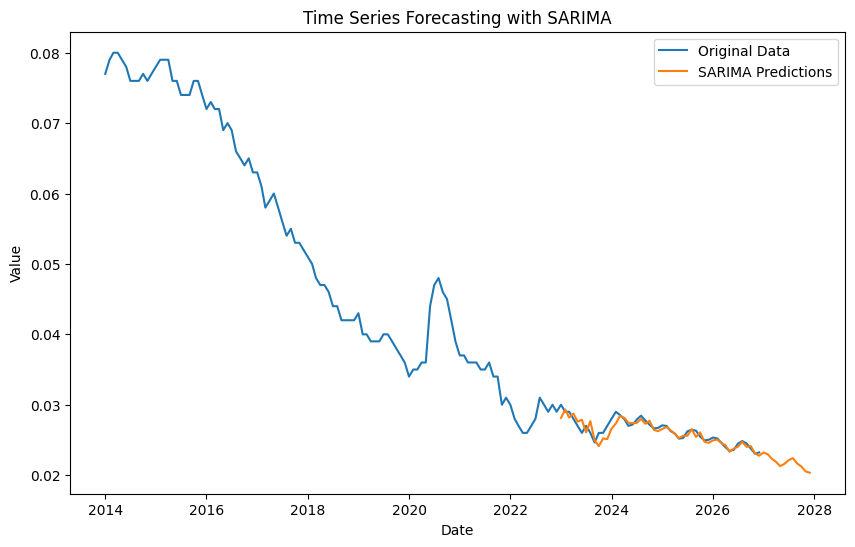

SARIMA - MSE: 6.197789750061962e-07, RMSE: 0.000787260423879034, MAPE: 2.14%


In [ ]:
model_sarima(data_filtered,'Netherlands', '25+', 'Female')

## 25+ Total

In [ ]:
data_filtered = prepare_data(combined_df, country='Netherlands', age='25+', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9947
Strong seasonality detected.


(0.9947336576422628, True)

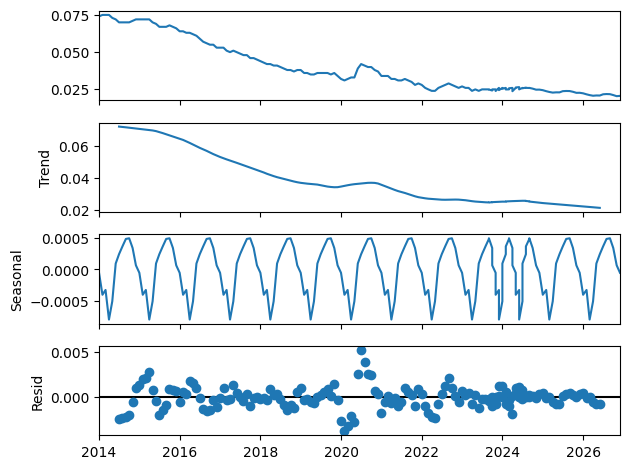

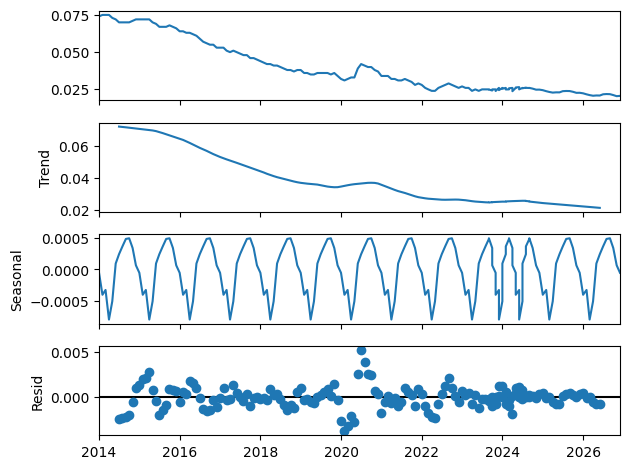

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1510.743, Time=1.80 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1461.258, Time=0.07 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1499.058, Time=0.32 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1512.735, Time=0.46 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-1459.266, Time=0.29 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-1502.680, Time=0.61 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=-1455.264, Time=2.39 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=-1499.049, Time=0.59 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=-1508.598, Time=1.21 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=-1514.558, Time=0.31 sec
 ARIMA(0,1,0)(1,1,1)[12]             : AIC=-1504.524, Time=0.41 sec
 ARIMA(0,1,0)(0,1,2)[12]             : AIC=-1457.254, Time=0.45 sec
 ARIMA(0,1,0)(1,1,0)[12]             : AIC=-1500.927, Time=0.48 sec
 ARIMA(0,1,0)(1,1,2)[12]             : AIC=-1510.353, Time=1.35 sec
 ARIM

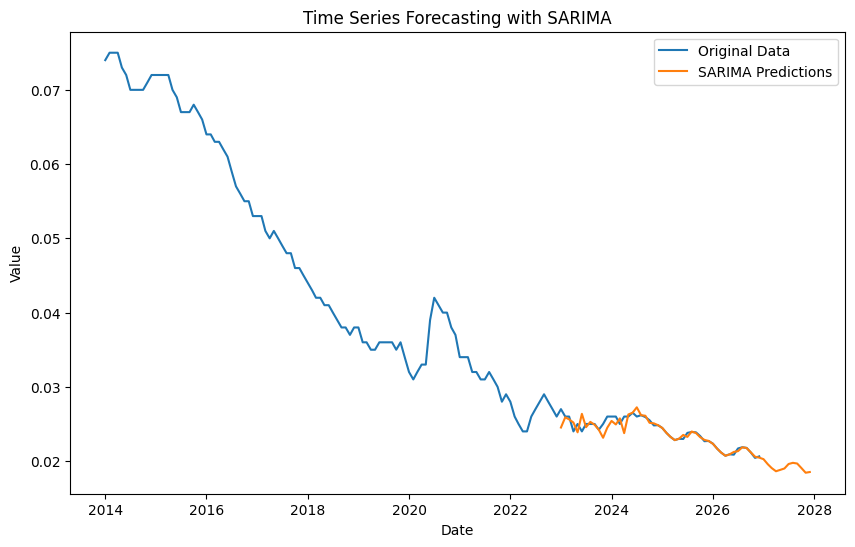

SARIMA - MSE: 6.338621598032758e-07, RMSE: 0.0007961546079771665, MAPE: 1.79%


In [ ]:
model_sarima(data_filtered,'Netherlands', '25+', 'Total')


# Chechia

For Czechia, the seasonal strength was high, around 0.97, indicating a very strong seasonal pattern. Given this high seasonality, SARIMA was applied to this country, as it is highly effective in capturing both the trend and seasonal components. The pronounced seasonal fluctuations in the data made SARIMA the ideal choice for accurate forecasting in this case.

## 15-24 Male

In [ ]:
data_filtered = prepare_data(combined_df, country='Czechia', age='15-24', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9524
Strong seasonality detected.


(0.9523927082252568, True)

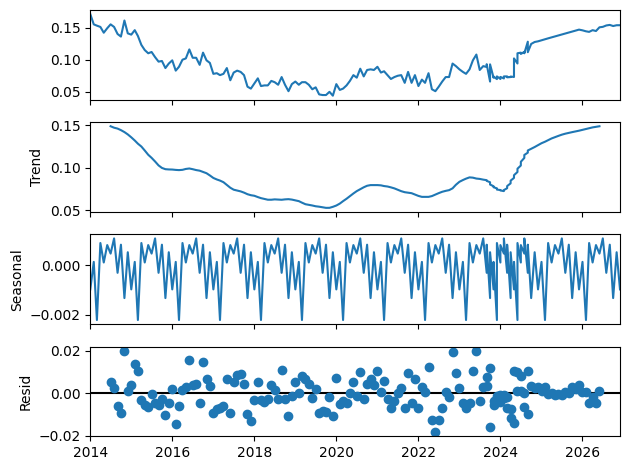

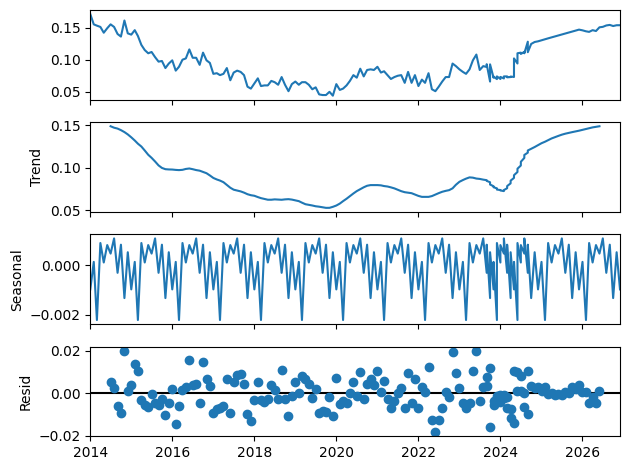

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=2.45 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-816.149, Time=0.07 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-865.839, Time=0.80 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-903.077, Time=2.00 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-822.661, Time=0.16 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-900.434, Time=4.79 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=inf, Time=2.13 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=-865.154, Time=1.00 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=inf, Time=1.70 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=inf, Time=1.15 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=inf, Time=0.69 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-901.813, Time=1.93 sec
 ARIMA(1,1,2)(0,1,1)[12]             : AIC=inf, Time=3.15 sec
 ARIMA(0,1,1)(0,1,1)[12] intercept   : AIC=-897.158, Time=0.68 sec

Best model:  ARIMA(0,1,1)(0,1,1)[12]          
T

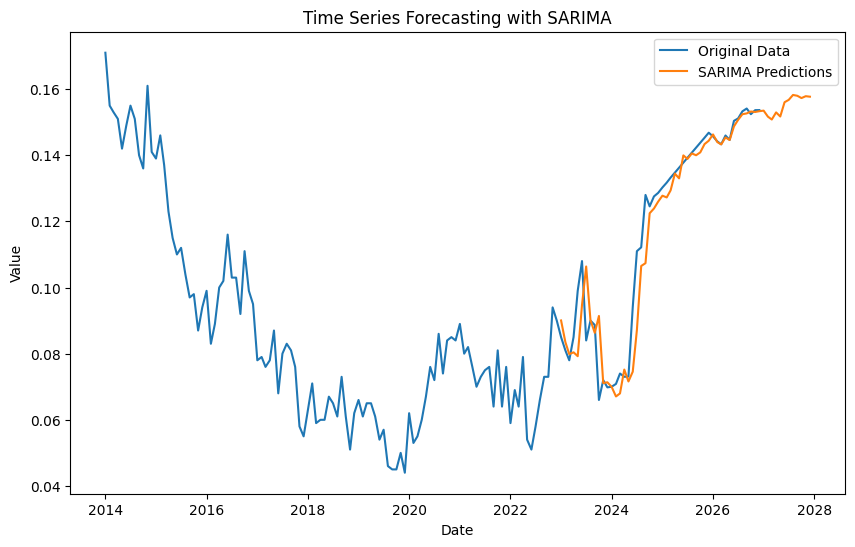

SARIMA - MSE: 6.985171142962094e-05, RMSE: 0.00835773362997535, MAPE: 4.86%


In [ ]:
model_sarima(data_filtered,'Czechia', '15-24', 'Male')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=1.08 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-864.342, Time=0.03 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-940.852, Time=0.07 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.35 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-866.334, Time=0.02 sec
 ARIMA(2,2,0)(0,0,0)[0] intercept   : AIC=-963.400, Time=0.24 sec
 ARIMA(3,2,0)(0,0,0)[0] intercept   : AIC=-980.423, Time=0.43 sec
 ARIMA(3,2,1)(0,0,0)[0] intercept   : AIC=-995.138, Time=1.00 sec
 ARIMA(2,2,1)(0,0,0)[0] intercept   : AIC=-1004.902, Time=0.76 sec
 ARIMA(2,2,2)(0,0,0)[0] intercept   : AIC=-1001.047, Time=0.36 sec
 ARIMA(1,2,2)(0,0,0)[0] intercept   : AIC=-1006.909, Time=0.22 sec
 ARIMA(0,2,2)(0,0,0)[0] intercept   : AIC=-1002.050, Time=0.44 sec
 ARIMA(1,2,3)(0,0,0)[0] intercept   : AIC=-1002.486, Time=0.45 sec
 ARIMA(0,2,3)(0,0,0)[0] intercept   : AIC=-1001.385, Time=0.23 sec
 ARIMA(2,2,3)(0,0,0)[0] intercept   :

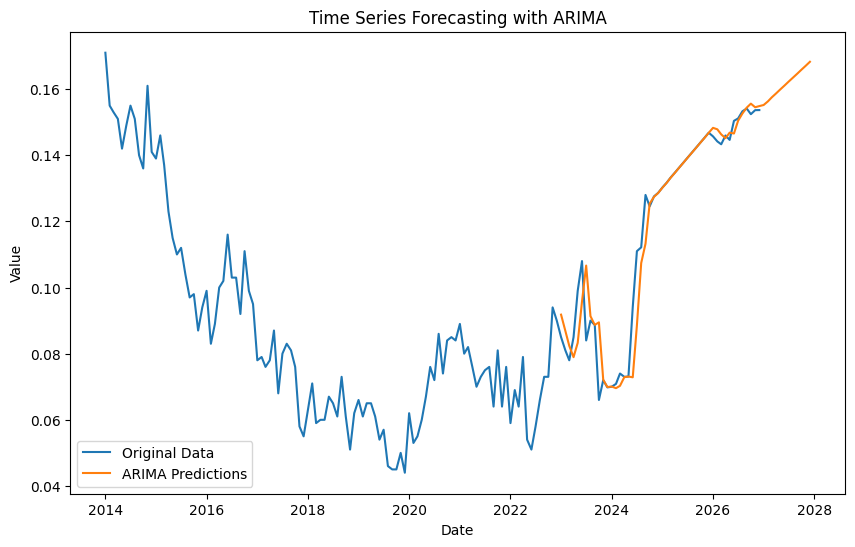

ARIMA - MSE: 5.980403973284351e-05, RMSE: 0.007733307166590728, MAPE: 4.21%


In [ ]:
model_arima(data_filtered,'Czechia', '15-24', 'Male')

## 15-24 Female

In [ ]:
data_filtered = prepare_data(combined_df, country='Czechia', age='15-24', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9113
Strong seasonality detected.


(0.9112951523014148, True)

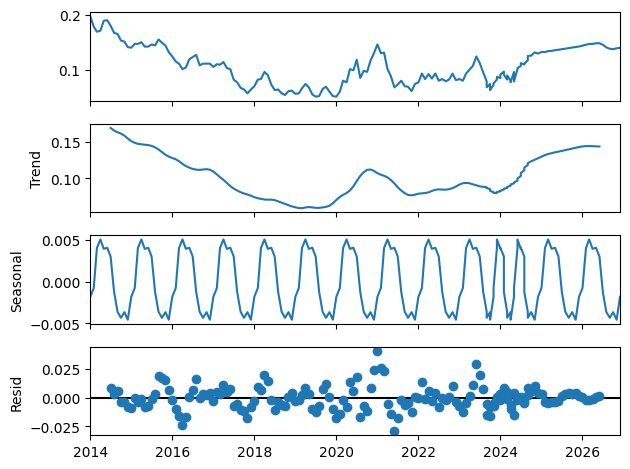

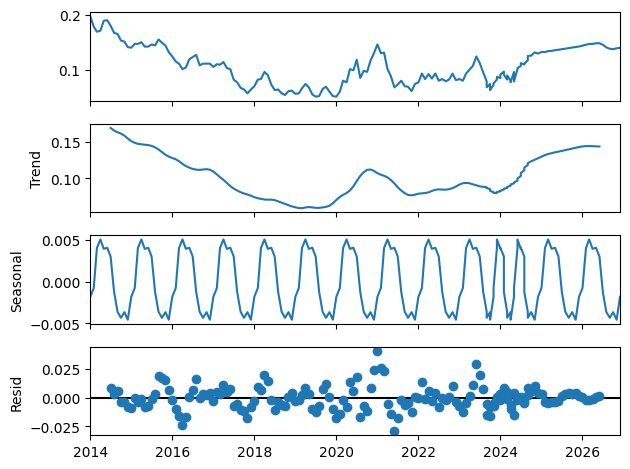

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=3.18 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-801.460, Time=0.08 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-835.588, Time=0.67 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=2.00 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-799.737, Time=0.04 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-849.825, Time=0.93 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=-877.029, Time=2.81 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=inf, Time=2.13 sec
 ARIMA(1,1,0)(2,1,2)[12]             : AIC=-867.979, Time=1.50 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=inf, Time=2.72 sec
 ARIMA(0,1,0)(2,1,1)[12]             : AIC=-873.725, Time=1.33 sec
 ARIMA(2,1,0)(2,1,1)[12]             : AIC=-882.850, Time=4.05 sec
 ARIMA(2,1,0)(1,1,1)[12]             : AIC=inf, Time=1.97 sec
 ARIMA(2,1,0)(2,1,0)[12]             : AIC=-859.465, Time=2.59 sec
 ARIMA(2,1,0)(2,1,2)[12]             : AIC=i

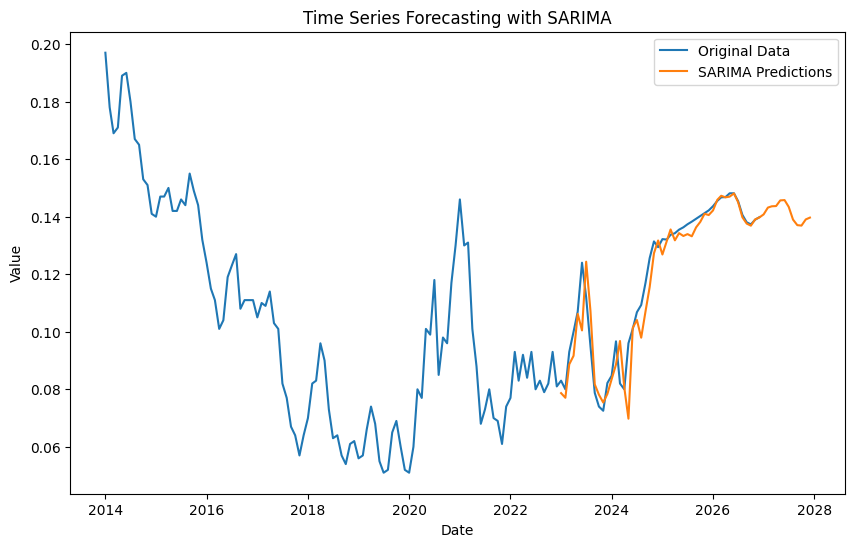

SARIMA - MSE: 5.127874981271631e-05, RMSE: 0.007160918224132734, MAPE: 4.17%


In [ ]:
model_sarima(data_filtered,'Czechia', '15-24', 'Female')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=-963.690, Time=0.95 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-895.183, Time=0.06 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-960.732, Time=0.12 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=1.34 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-897.168, Time=0.02 sec
 ARIMA(2,2,1)(0,0,0)[0] intercept   : AIC=-957.338, Time=1.25 sec
 ARIMA(1,2,2)(0,0,0)[0] intercept   : AIC=-989.783, Time=0.49 sec
 ARIMA(0,2,2)(0,0,0)[0] intercept   : AIC=-984.668, Time=0.73 sec
 ARIMA(2,2,2)(0,0,0)[0] intercept   : AIC=-1000.838, Time=0.56 sec
 ARIMA(3,2,2)(0,0,0)[0] intercept   : AIC=-1004.359, Time=0.88 sec
 ARIMA(3,2,1)(0,0,0)[0] intercept   : AIC=-999.034, Time=0.69 sec
 ARIMA(3,2,3)(0,0,0)[0] intercept   : AIC=-1003.560, Time=0.78 sec
 ARIMA(2,2,3)(0,0,0)[0] intercept   : AIC=-1007.882, Time=0.60 sec
 ARIMA(1,2,3)(0,0,0)[0] intercept   : AIC=-1009.943, Time=0.40 sec
 ARIMA(0,2,3)(0,0,0)[0] intercept

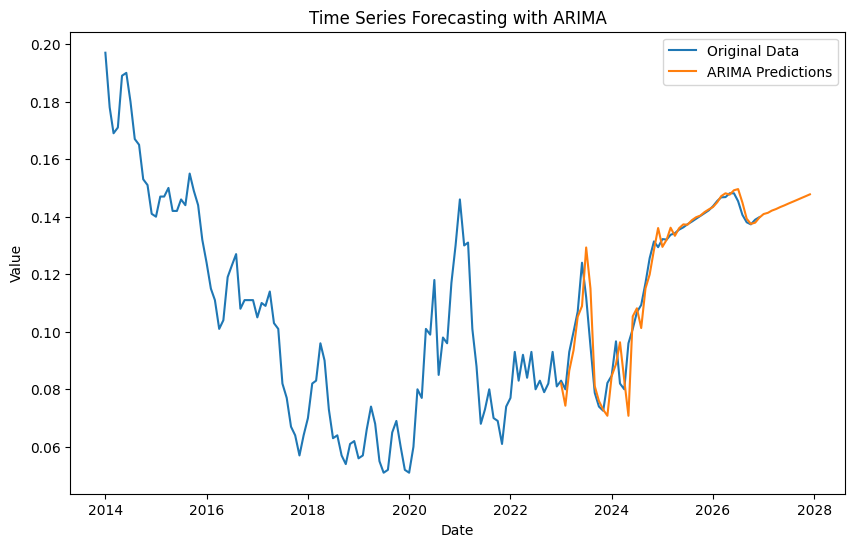

ARIMA - MSE: 4.862072854292618e-05, RMSE: 0.006972856555453166, MAPE: 4.00%


In [ ]:
model_arima(data_filtered,'Czechia', '15-24', 'Female')

## 15-24 Total

In [ ]:
data_filtered = prepare_data(combined_df, country='Czechia', age='15-24', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9657
Strong seasonality detected.


(0.9656508365443612, True)

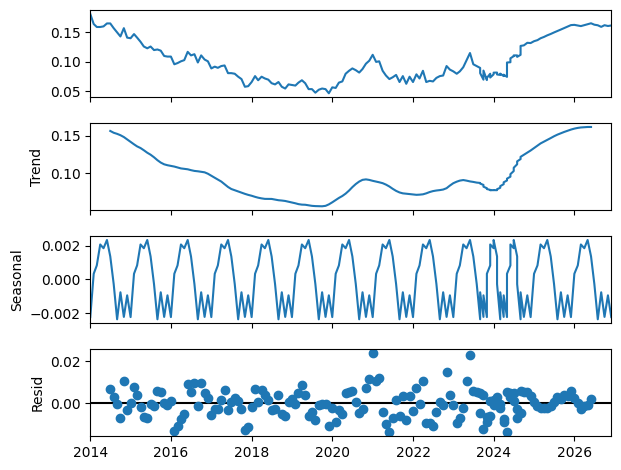

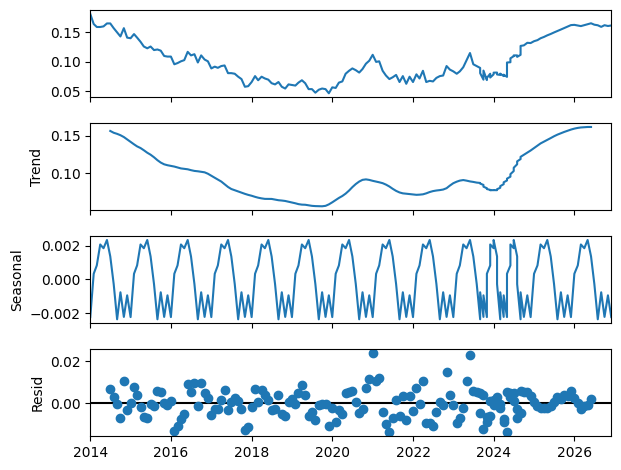

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=2.14 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-864.756, Time=0.06 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-911.659, Time=0.25 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=2.75 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-864.436, Time=0.17 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-930.277, Time=1.83 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=-943.990, Time=3.85 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=-951.323, Time=1.72 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=inf, Time=2.36 sec
 ARIMA(1,1,0)(1,1,2)[12]             : AIC=-935.214, Time=1.66 sec
 ARIMA(1,1,0)(0,1,2)[12]             : AIC=-951.972, Time=2.67 sec
 ARIMA(0,1,0)(0,1,2)[12]             : AIC=-952.749, Time=1.72 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=-948.165, Time=0.90 sec
 ARIMA(0,1,0)(1,1,2)[12]             : AIC=inf, Time=2.69 sec
 ARIMA(0,1,0)(1,1,1)[12]             : 

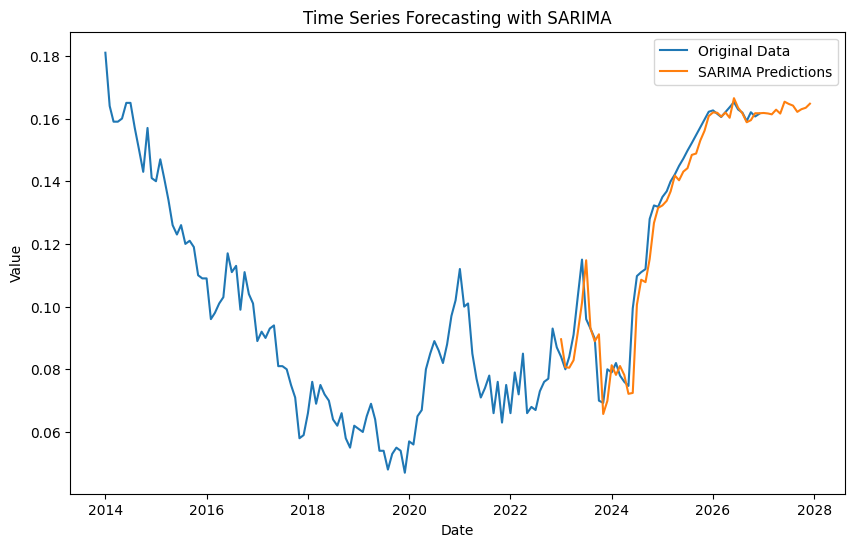

SARIMA - MSE: 5.443148526499018e-05, RMSE: 0.007377769667385271, MAPE: 4.60%


In [ ]:
model_sarima(data_filtered,'Czechia', '15-24', 'Total')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=-1065.653, Time=0.88 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-946.451, Time=0.03 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-1019.196, Time=0.16 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.42 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-948.434, Time=0.05 sec
 ARIMA(2,2,1)(0,0,0)[0] intercept   : AIC=-1059.771, Time=0.74 sec
 ARIMA(1,2,2)(0,0,0)[0] intercept   : AIC=-1066.029, Time=0.59 sec
 ARIMA(0,2,2)(0,0,0)[0] intercept   : AIC=-1046.506, Time=0.22 sec
 ARIMA(2,2,2)(0,0,0)[0] intercept   : AIC=-1046.213, Time=0.26 sec
 ARIMA(1,2,3)(0,0,0)[0] intercept   : AIC=-1063.081, Time=0.77 sec
 ARIMA(0,2,3)(0,0,0)[0] intercept   : AIC=-1055.521, Time=0.62 sec
 ARIMA(2,2,3)(0,0,0)[0] intercept   : AIC=-1059.708, Time=0.36 sec
 ARIMA(1,2,2)(0,0,0)[0]             : AIC=-1065.624, Time=0.89 sec

Best model:  ARIMA(1,2,2)(0,0,0)[0] intercept
Total fit time: 5.990 seconds
                 

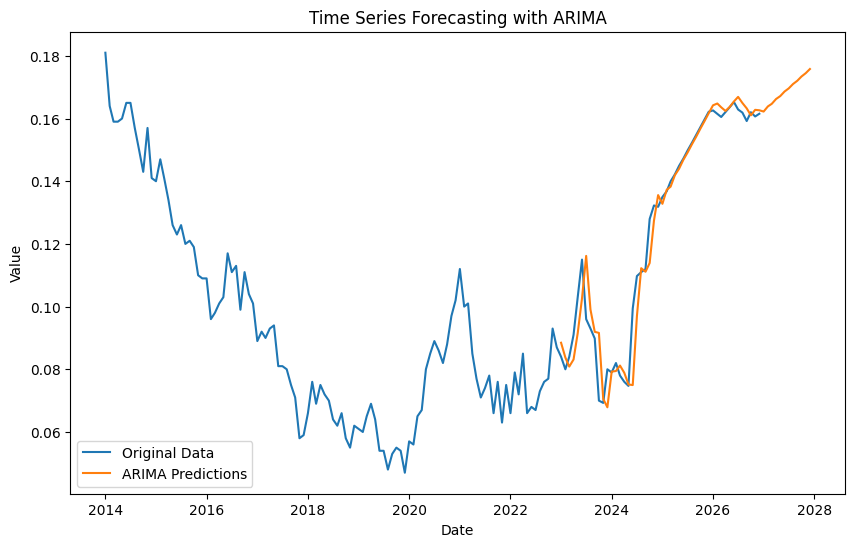

ARIMA - MSE: 5.336020665526733e-05, RMSE: 0.007304807092269263, MAPE: 4.39%


In [ ]:
model_arima(data_filtered,'Czechia', '15-24', 'Total')

## 25+ Male

In [ ]:
data_filtered = prepare_data(combined_df, country='Czechia', age='25+', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9840
Strong seasonality detected.


(0.9839738975071189, True)

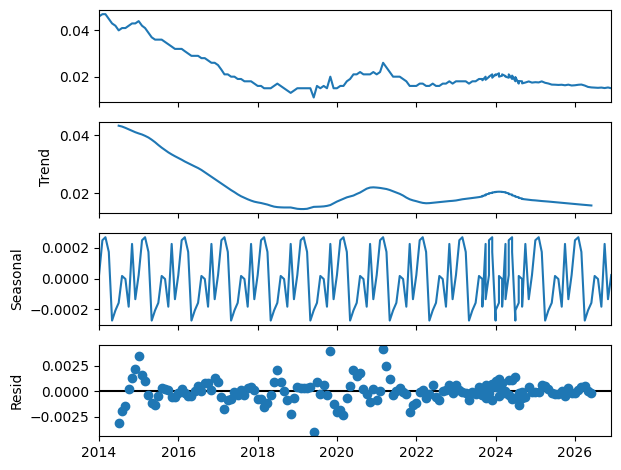

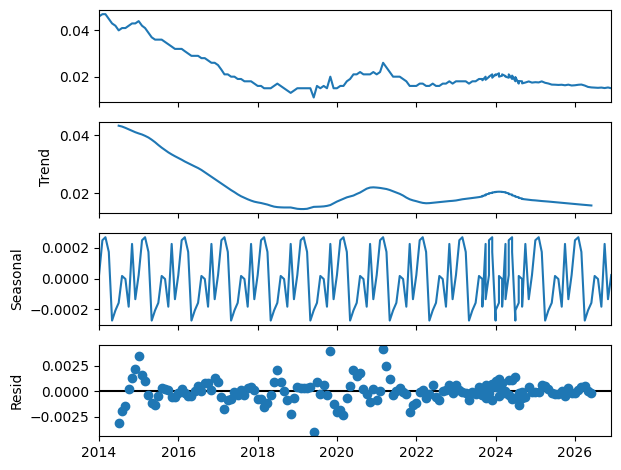

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1476.504, Time=1.80 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1396.115, Time=0.11 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1452.711, Time=0.38 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1472.974, Time=1.51 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-1404.338, Time=0.42 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1465.008, Time=1.55 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1460.488, Time=3.86 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1455.204, Time=2.20 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=-1463.424, Time=4.08 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1474.620, Time=1.70 sec
 ARIMA(2,1,1)(0,1,1)[12]             : AIC=-1470.627, Time=2.65 sec
 ARIMA(1,1,2)(0,1,1)[12]             : AIC=-1471.215, Time=2.45 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=-1472.992, Time=1.10 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=-1475.007, Time=1.70 sec
 ARIM

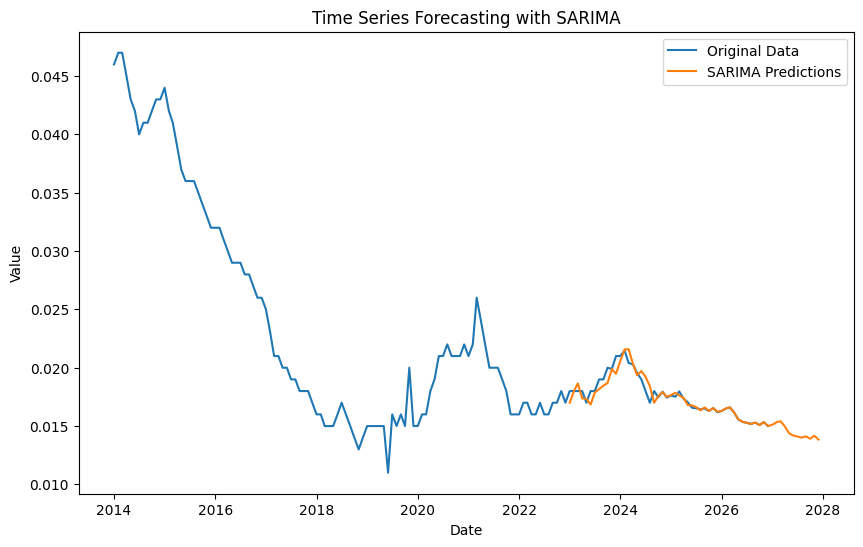

SARIMA - MSE: 3.196861116609619e-07, RMSE: 0.0005654079161640398, MAPE: 1.82%


In [ ]:
model_sarima(data_filtered,'Czechia', '25+', 'Male')

## 25+ Female

In [ ]:
data_filtered = prepare_data(combined_df, country='Czechia', age='25+', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9641
Strong seasonality detected.


(0.9640914416914781, True)

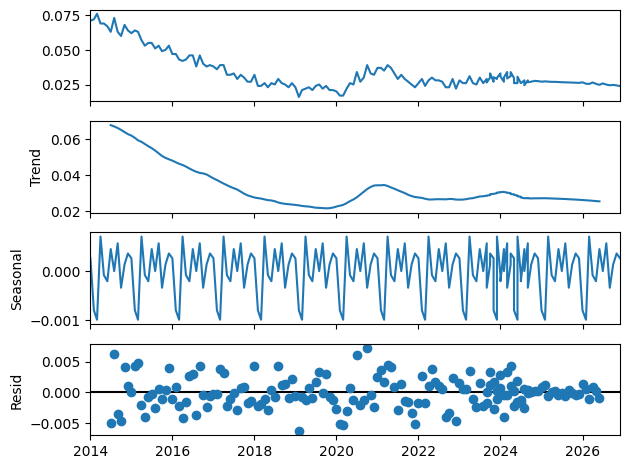

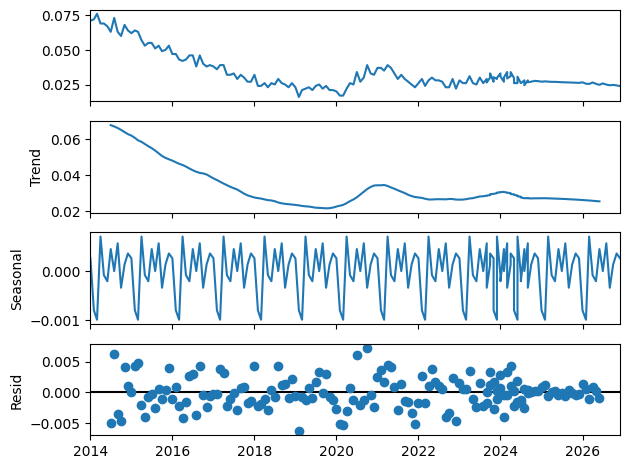

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1195.556, Time=1.78 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1132.841, Time=0.08 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1168.354, Time=0.83 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1197.031, Time=1.86 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-1161.717, Time=0.24 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-1191.087, Time=1.71 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=-1194.617, Time=2.03 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=-1175.990, Time=0.57 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=inf, Time=3.05 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=-1162.365, Time=0.60 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=-1194.263, Time=1.73 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1188.439, Time=2.11 sec
 ARIMA(1,1,2)(0,1,1)[12]             : AIC=-1193.768, Time=1.22 sec
 ARIMA(0,1,1)(0,1,1)[12] intercept   : AIC=-1196.445, Time=2.11 sec

Best model

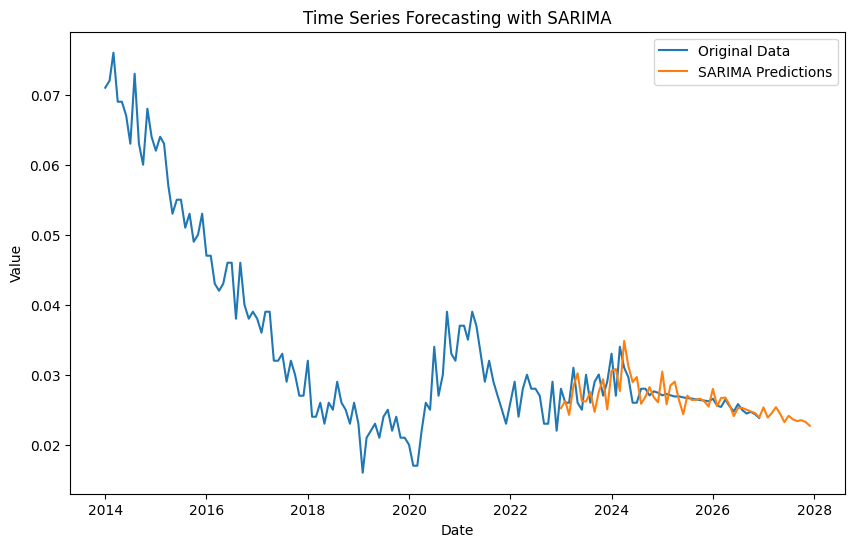

SARIMA - MSE: 5.029519283938366e-06, RMSE: 0.0022426589762909485, MAPE: 6.02%


In [ ]:
model_sarima(data_filtered,'Czechia', '25+', 'Female')

Performing stepwise search to minimize aic
 ARIMA(1,2,1)(0,0,0)[0] intercept   : AIC=-1308.206, Time=0.63 sec
 ARIMA(0,2,0)(0,0,0)[0] intercept   : AIC=-1135.944, Time=0.02 sec
 ARIMA(1,2,0)(0,0,0)[0] intercept   : AIC=-1200.195, Time=0.19 sec
 ARIMA(0,2,1)(0,0,0)[0] intercept   : AIC=inf, Time=0.34 sec
 ARIMA(0,2,0)(0,0,0)[0]             : AIC=-1137.943, Time=0.03 sec
 ARIMA(2,2,1)(0,0,0)[0] intercept   : AIC=-1318.097, Time=0.28 sec
 ARIMA(2,2,0)(0,0,0)[0] intercept   : AIC=-1292.288, Time=0.18 sec
 ARIMA(3,2,1)(0,0,0)[0] intercept   : AIC=-1320.880, Time=0.39 sec
 ARIMA(3,2,0)(0,0,0)[0] intercept   : AIC=-1307.542, Time=0.45 sec
 ARIMA(3,2,2)(0,0,0)[0] intercept   : AIC=-1323.764, Time=0.30 sec
 ARIMA(2,2,2)(0,0,0)[0] intercept   : AIC=-1334.136, Time=0.56 sec
 ARIMA(1,2,2)(0,0,0)[0] intercept   : AIC=-1278.321, Time=0.85 sec
 ARIMA(2,2,3)(0,0,0)[0] intercept   : AIC=-1330.475, Time=0.55 sec
 ARIMA(1,2,3)(0,0,0)[0] intercept   : AIC=-1287.191, Time=0.60 sec
 ARIMA(3,2,3)(0,0,0)[0] i

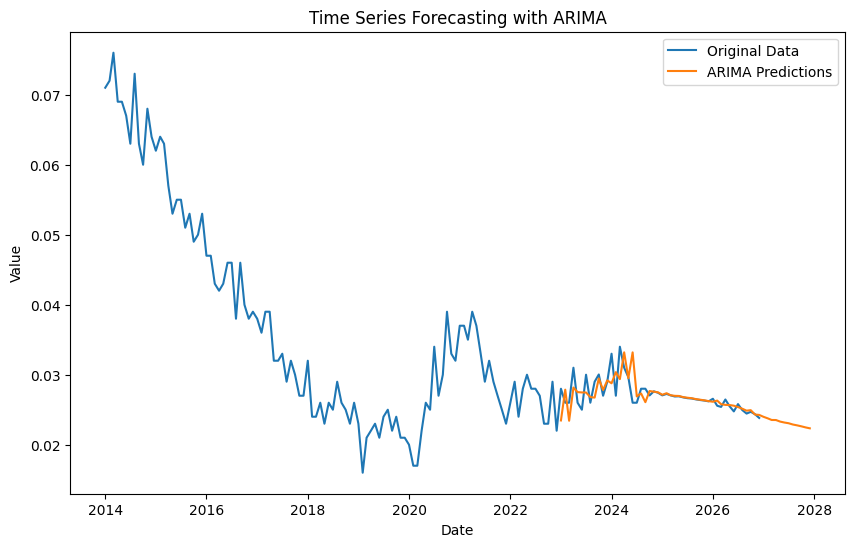

ARIMA - MSE: 3.661521173965226e-06, RMSE: 0.0019135101708549203, MAPE: 4.06%


In [ ]:
model_arima(data_filtered,'Czechia', '25+', 'Female')

## 25+ Total

In [ ]:
data_filtered = prepare_data(combined_df, country='Czechia', age='25+', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.9795
Strong seasonality detected.


(0.9794589261115342, True)

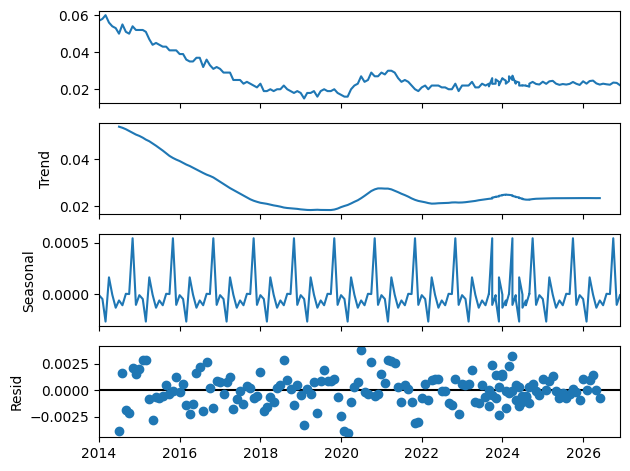

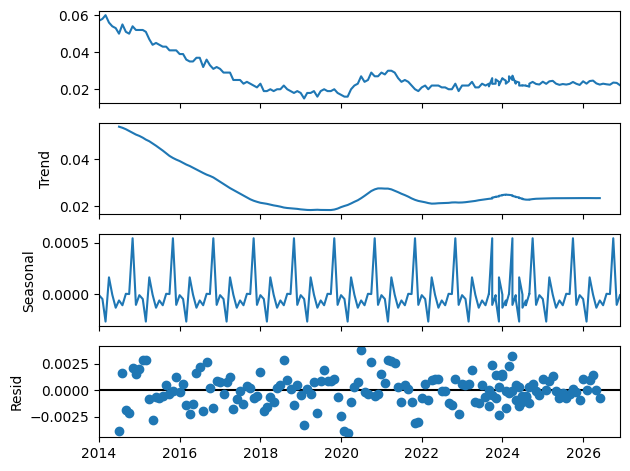

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1368.354, Time=1.62 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1322.256, Time=0.16 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1350.785, Time=0.86 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1370.046, Time=1.39 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-1331.966, Time=0.22 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-1363.559, Time=1.77 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=-1361.879, Time=3.84 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=-1351.794, Time=0.70 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=-1358.939, Time=3.47 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=-1359.576, Time=0.61 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=-1368.017, Time=1.97 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1369.201, Time=0.75 sec
 ARIMA(1,1,2)(0,1,1)[12]             : AIC=-1366.224, Time=1.70 sec
 ARIMA(0,1,1)(0,1,1)[12] intercept   : AIC=-1370.930, Time=1.64 sec
 ARIM

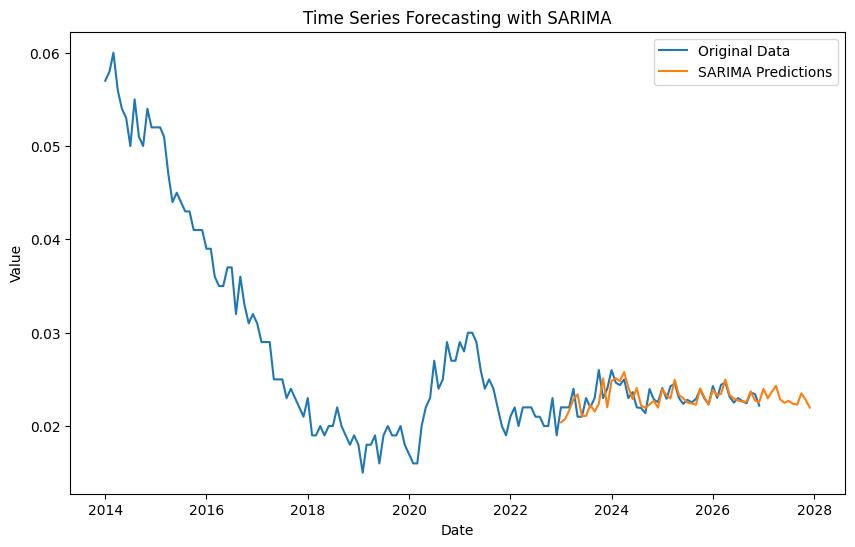

SARIMA - MSE: 1.158175316187256e-06, RMSE: 0.0010761855398523322, MAPE: 3.27%


In [ ]:
model_sarima(data_filtered,'Czechia', '25+', 'Total')


# Canada


For Canada, the data exhibits a clear seasonal pattern with a noticeable spike around 2020, which is reflected in both the trend and seasonal components. The seasonal strength is significant, with a well-defined cycle, and the trend shows fluctuations that align with this cycle. The residuals are relatively small and scattered around zero, indicating that the seasonal and trend components were well captured by the model.

Due to the strong and clear seasonal pattern, SARIMA is the optimal choice for this data, as it is specifically designed to handle both trend and seasonal components effectively for accurate forecasting.

## 15-24 Male

In [ ]:
data_filtered = prepare_data(combined_df, country='Canada', age='15-24', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.7137
Strong seasonality detected.


(0.7137124208527434, True)

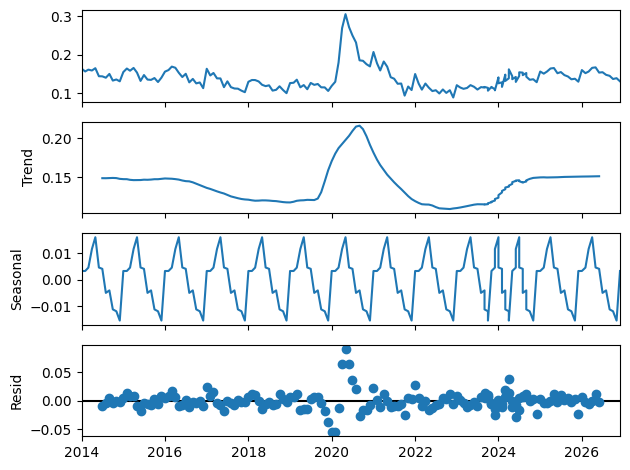

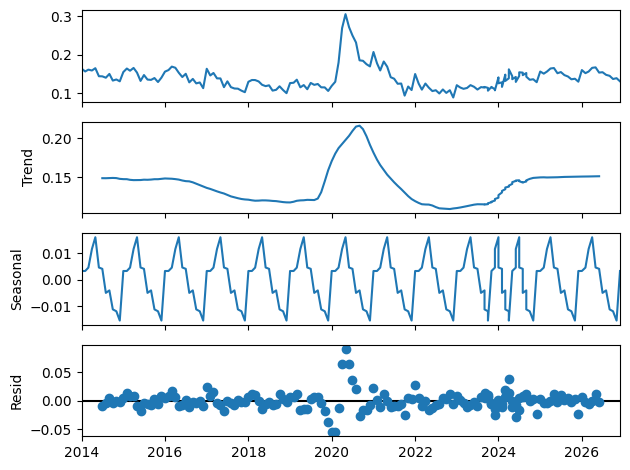

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=3.10 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-721.359, Time=0.07 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-751.896, Time=0.49 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=0.99 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-722.940, Time=0.16 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-762.429, Time=0.37 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=inf, Time=2.37 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=inf, Time=1.45 sec
 ARIMA(0,1,0)(2,1,0)[12]             : AIC=-760.460, Time=0.74 sec
 ARIMA(2,1,0)(2,1,0)[12]             : AIC=-761.038, Time=1.59 sec
 ARIMA(1,1,1)(2,1,0)[12]             : AIC=-760.375, Time=2.21 sec
 ARIMA(0,1,1)(2,1,0)[12]             : AIC=-761.883, Time=2.39 sec
 ARIMA(2,1,1)(2,1,0)[12]             : AIC=-759.349, Time=1.78 sec
 ARIMA(1,1,0)(2,1,0)[12] intercept   : AIC=-760.518, Time=1.86 sec

Best model:  ARIMA(1,1,0)(2,1,0)[12]  

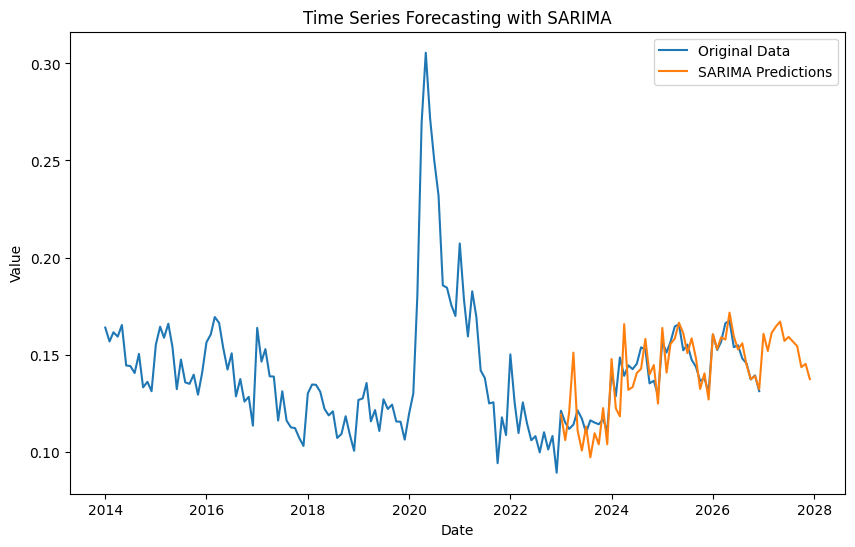

SARIMA - MSE: 0.00011223925917134025, RMSE: 0.010594303147038046, MAPE: 5.65%


In [ ]:
model_sarima(data_filtered,'Canada', '15-24', 'Male')

## 15-24 Female

In [ ]:
data_filtered = prepare_data(combined_df, country='Canada', age='15-24', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.6653
Weak or no seasonality detected.


(0.6653235695854054, False)

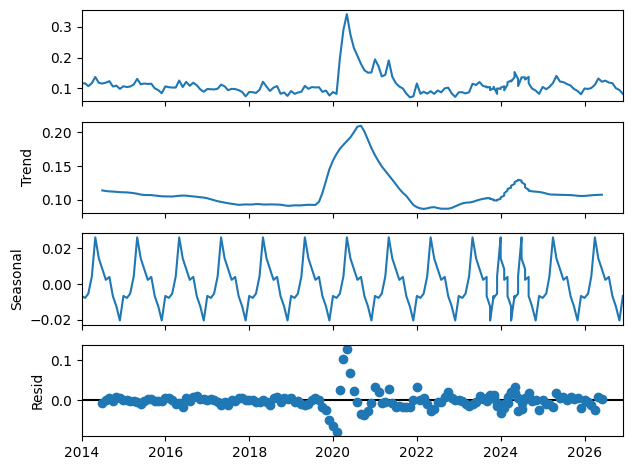

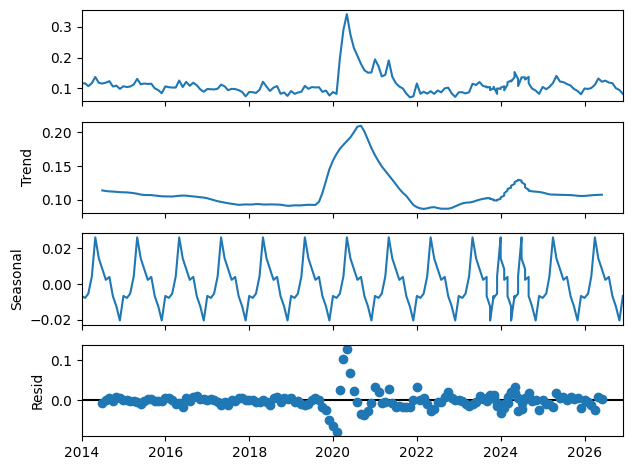

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=1.53 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-661.244, Time=0.08 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-709.809, Time=0.32 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=1.81 sec
 ARIMA(1,1,0)(0,1,0)[12]             : AIC=-679.538, Time=0.11 sec
 ARIMA(1,1,0)(2,1,0)[12]             : AIC=-720.762, Time=1.33 sec
 ARIMA(1,1,0)(2,1,1)[12]             : AIC=inf, Time=4.40 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=inf, Time=1.13 sec
 ARIMA(0,1,0)(2,1,0)[12]             : AIC=-703.660, Time=0.33 sec
 ARIMA(2,1,0)(2,1,0)[12]             : AIC=-727.846, Time=1.01 sec
 ARIMA(2,1,0)(1,1,0)[12]             : AIC=-717.895, Time=0.50 sec
 ARIMA(2,1,0)(2,1,1)[12]             : AIC=inf, Time=2.93 sec
 ARIMA(2,1,0)(1,1,1)[12]             : AIC=inf, Time=1.72 sec
 ARIMA(3,1,0)(2,1,0)[12]             : AIC=-728.424, Time=1.26 sec
 ARIMA(3,1,0)(1,1,0)[12]             : AIC=-717.9

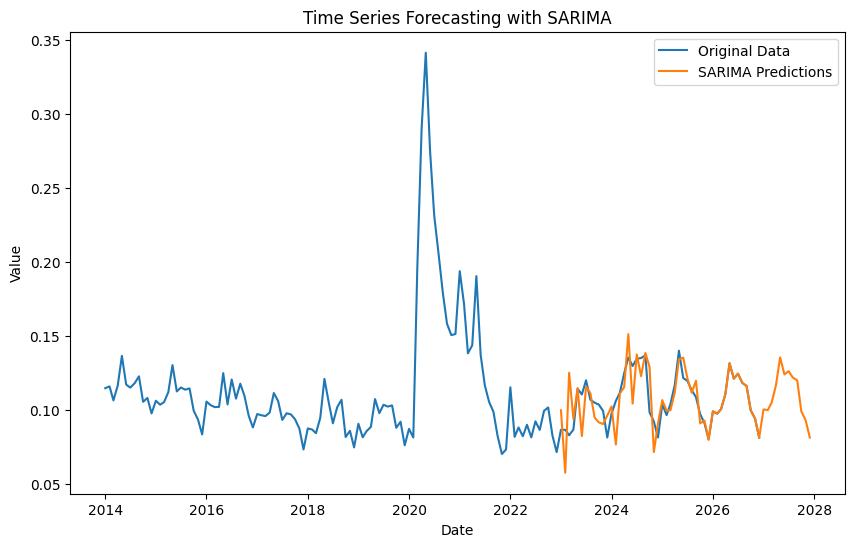

SARIMA - MSE: 0.00017064045517343606, RMSE: 0.013062942056575006, MAPE: 8.19%


In [ ]:
model_sarima(data_filtered,'Canada', '15-24', 'Female')

## 15-24 Total

In [ ]:
data_filtered = prepare_data(combined_df, country='Canada', age='15-24', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.6971
Weak or no seasonality detected.


(0.6970511533653332, False)

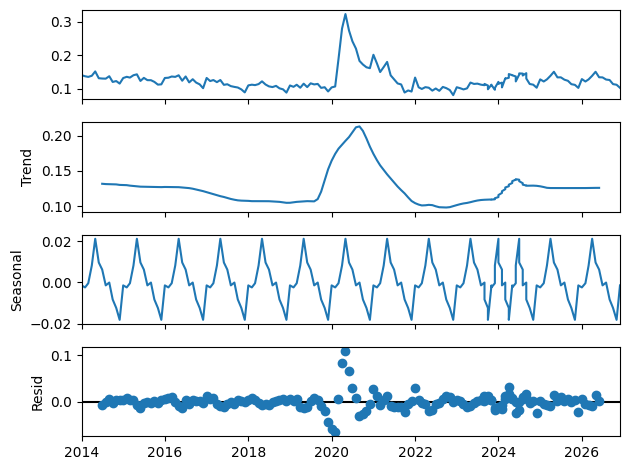

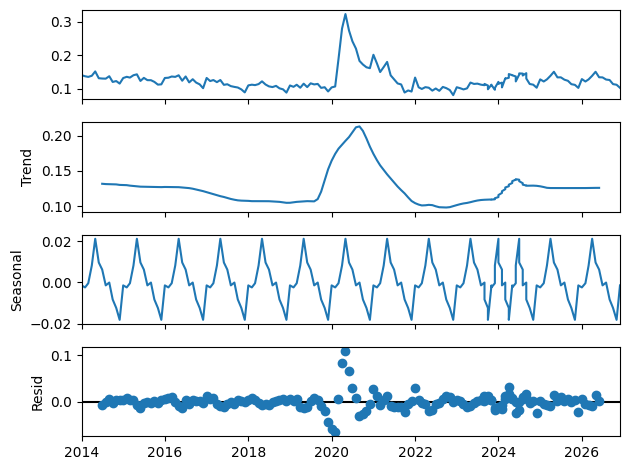

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=inf, Time=2.54 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-718.277, Time=0.04 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-774.728, Time=0.43 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-820.312, Time=0.74 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-748.597, Time=0.10 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=inf, Time=1.45 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=inf, Time=2.50 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=-780.772, Time=0.21 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=inf, Time=2.14 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=inf, Time=0.51 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=inf, Time=1.16 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-814.340, Time=0.55 sec
 ARIMA(1,1,2)(0,1,1)[12]             : AIC=-816.669, Time=0.99 sec
 ARIMA(0,1,1)(0,1,1)[12] intercept   : AIC=-817.823, Time=0.21 sec

Best model:  ARIMA(0,1,1)(0,1,1)[12]          
T

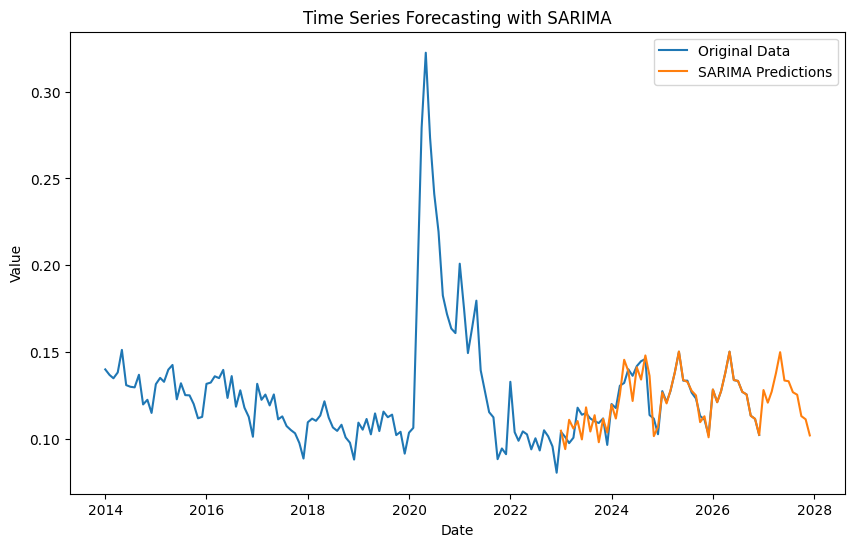

SARIMA - MSE: 4.15706864695036e-05, RMSE: 0.0064475333631943, MAPE: 3.35%


In [ ]:
model_sarima(data_filtered,'Canada', '15-24', 'Total')

## 25+ Male

In [ ]:
data_filtered = prepare_data(combined_df, country='Canada', age='25+', sex='Male')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.7279
Strong seasonality detected.


(0.7278908222525218, True)

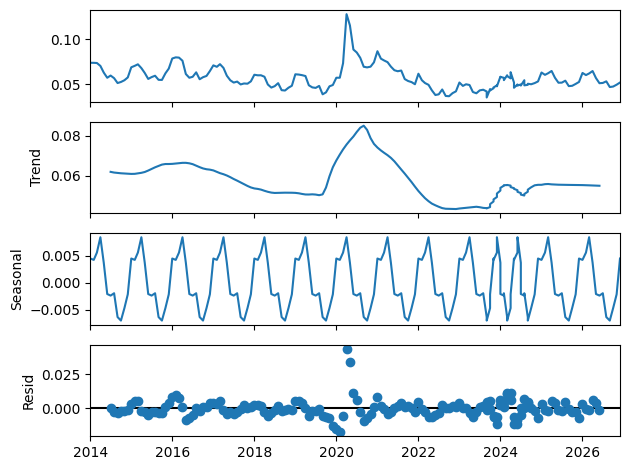

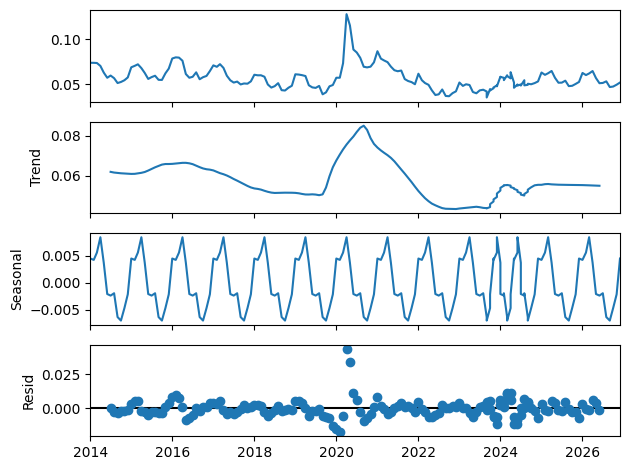

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1043.961, Time=1.45 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-972.070, Time=0.03 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1009.519, Time=0.19 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=inf, Time=1.06 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=-979.628, Time=0.25 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=-1052.649, Time=1.48 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=-1012.901, Time=0.65 sec
 ARIMA(1,1,1)(2,1,1)[12]             : AIC=-1027.548, Time=1.11 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=inf, Time=1.68 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=inf, Time=1.83 sec
 ARIMA(1,1,1)(2,1,0)[12]             : AIC=-1025.263, Time=0.73 sec
 ARIMA(1,1,1)(2,1,2)[12]             : AIC=-1045.473, Time=5.05 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-1042.912, Time=1.32 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=-1030.014, Time=0.66 sec
 ARIMA(2,1,1)(1,1,1)[12] 

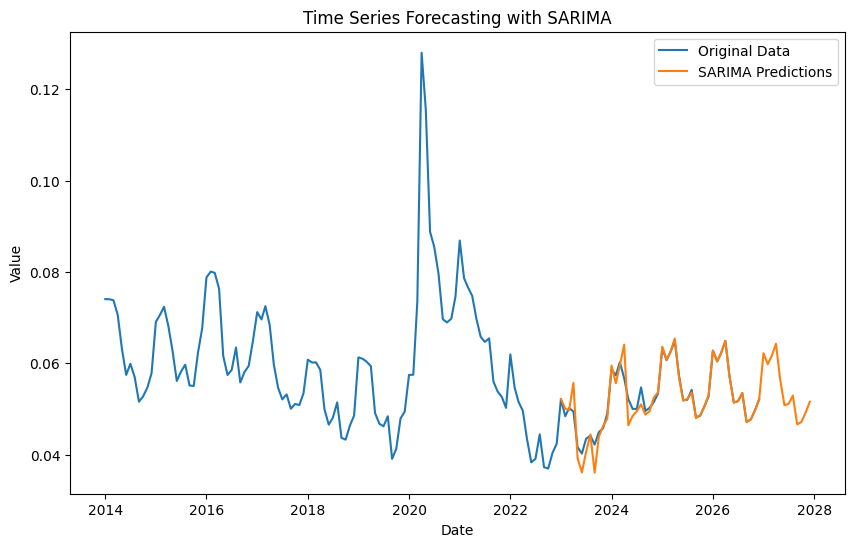

SARIMA - MSE: 4.679401665925867e-06, RMSE: 0.0021631924708462413, MAPE: 2.34%


In [ ]:
model_sarima(data_filtered,'Canada', '25+', 'Male')

## 25+ Female

In [ ]:
data_filtered = prepare_data(combined_df, country='Canada', age='25+', sex='Female')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.7248
Strong seasonality detected.


(0.7247656201859932, True)

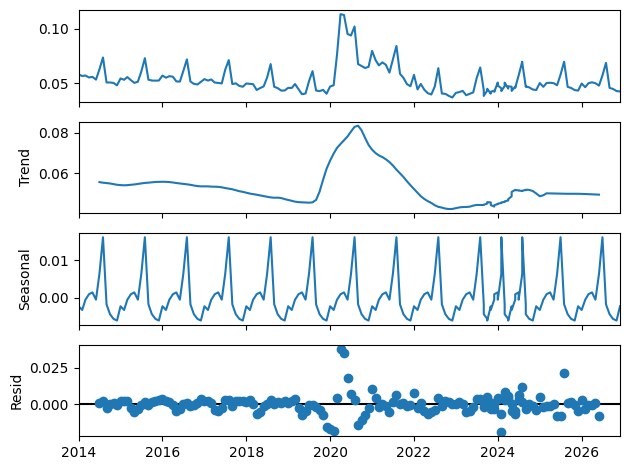

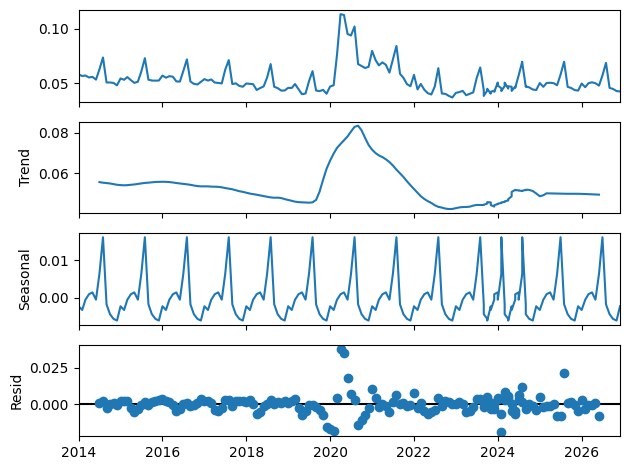

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1089.135, Time=1.15 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1007.095, Time=0.04 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1051.862, Time=0.40 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1096.758, Time=1.54 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-1032.740, Time=0.20 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-1086.092, Time=2.07 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=-1097.534, Time=1.28 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=-1095.059, Time=0.78 sec
 ARIMA(0,1,0)(0,1,2)[12]             : AIC=-1075.454, Time=0.97 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=-1094.537, Time=0.70 sec
 ARIMA(0,1,2)(0,1,2)[12]             : AIC=-1096.127, Time=1.66 sec
 ARIMA(1,1,0)(0,1,2)[12]             : AIC=-1089.890, Time=0.69 sec
 ARIMA(1,1,2)(0,1,2)[12]             : AIC=-1096.056, Time=0.72 sec
 ARIMA(0,1,1)(0,1,2)[12] intercept   : AIC=-1095.534, Time=2.02 sec

Best

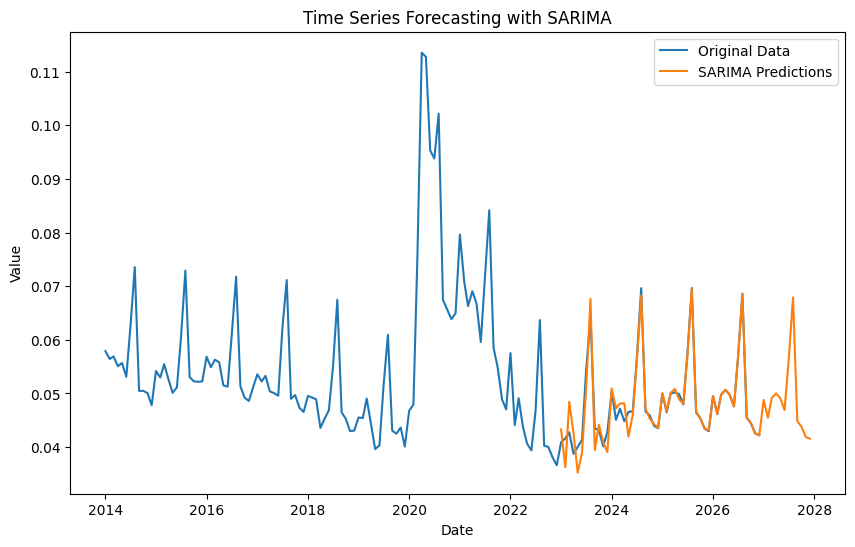

SARIMA - MSE: 4.37437267425257e-06, RMSE: 0.002091500101423036, MAPE: 2.79%


In [ ]:
model_sarima(data_filtered,'Canada', '25+', 'Female')

## 25+ Total

In [ ]:
data_filtered = prepare_data(combined_df, country='Canada', age='25+', sex='Total')

In [ ]:
calculate_seasonal_strength(data_filtered, 'Value', period=12)

Seasonal Strength: 0.7203
Strong seasonality detected.


(0.7203242036037023, True)

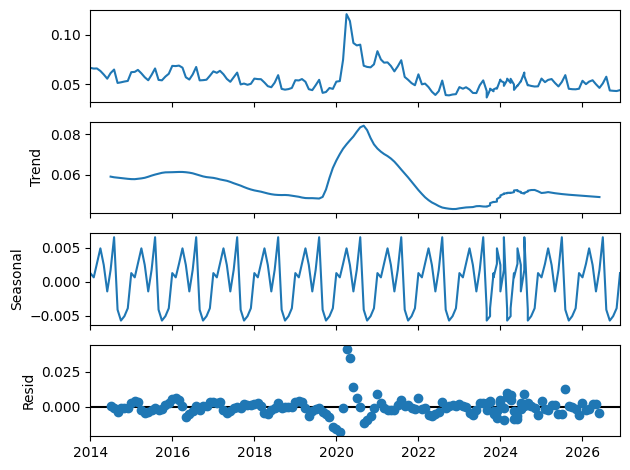

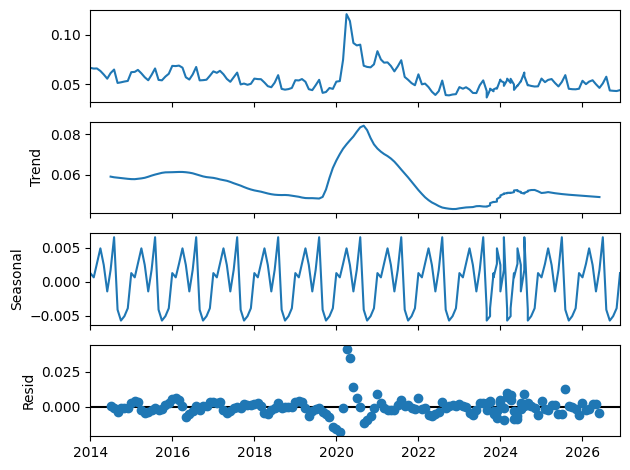

In [ ]:
result = seasonal_decompose(data_filtered, model='additive', period=12)
result.plot()

In [ ]:
data_filtered = data_filtered[~data_filtered.index.duplicated(keep='first')]
print(data_filtered.index.min(), data_filtered.index.max())
print(data_filtered.index.freq)
data_filtered = data_filtered.asfreq('MS')
print(data_filtered.index.freq)

2014-01-01 00:00:00 2026-12-01 00:00:00
None
<MonthBegin>


Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=-1086.680, Time=1.29 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=-1002.735, Time=0.04 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=-1045.414, Time=0.27 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=-1092.405, Time=1.30 sec
 ARIMA(0,1,1)(0,1,0)[12]             : AIC=-1032.039, Time=0.10 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=-1077.008, Time=2.25 sec
 ARIMA(0,1,1)(0,1,2)[12]             : AIC=inf, Time=1.22 sec
 ARIMA(0,1,1)(1,1,0)[12]             : AIC=-1056.980, Time=0.24 sec
 ARIMA(0,1,1)(1,1,2)[12]             : AIC=inf, Time=1.02 sec
 ARIMA(0,1,0)(0,1,1)[12]             : AIC=-1063.275, Time=0.61 sec
 ARIMA(0,1,2)(0,1,1)[12]             : AIC=-1087.673, Time=0.66 sec
 ARIMA(1,1,0)(0,1,1)[12]             : AIC=-1079.914, Time=0.57 sec
 ARIMA(1,1,2)(0,1,1)[12]             : AIC=-1090.628, Time=0.61 sec
 ARIMA(0,1,1)(0,1,1)[12] intercept   : AIC=-1086.220, Time=2.06 sec

Best model:  ARI

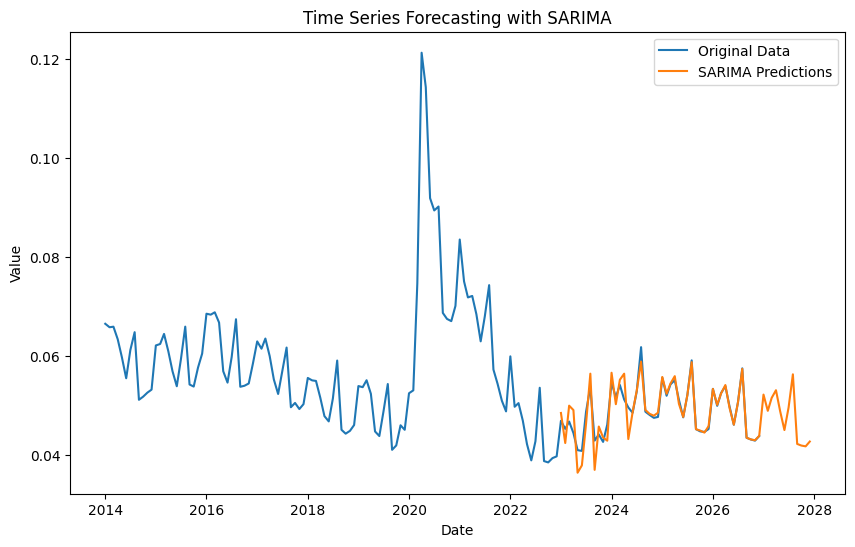

SARIMA - MSE: 4.5969617728969994e-06, RMSE: 0.002144052651614927, MAPE: 2.75%


In [ ]:
model_sarima(data_filtered,'Canada', '25+', 'Total')

# Final dataframe with results

In [ ]:
forecast_results_df

,Model,Country,Age,Sex,Date,Forecast,MSE,RMSE,MAPE
36,SARIMA,Italy,15-24,Male,2026-01-01,0.160870,0.000002,0.001503,0.002321
37,SARIMA,Italy,15-24,Male,2026-02-01,0.160921,0.000002,0.001503,0.002321
38,SARIMA,Italy,15-24,Male,2026-03-01,0.160921,0.000002,0.001503,0.002321
39,SARIMA,Italy,15-24,Male,2026-04-01,0.151051,0.000002,0.001503,0.002321
40,SARIMA,Italy,15-24,Male,2026-05-01,0.151093,0.000002,0.001503,0.002321
...,...,...,...,...,...,...,...,...,...
8095,SARIMA,Canada,25+,Total,2027-08-01,0.056230,0.000005,0.002144,0.027491
8096,SARIMA,Canada,25+,Total,2027-09-01,0.042157,0.000005,0.002144,0.027491
8097,SARIMA,Canada,25+,Total,2027-10-01,0.041830,0.000005,0.002144,0.027491
8098,SARIMA,Canada,25+,Total,2027-11-01,0.041670,0.000005,0.002144,0.027491


In [ ]:
data = forecast_results_df.copy()
filtered_data = data[pd.to_datetime(data['Date']) >= pd.to_datetime("2027-01-01")]

In [ ]:
filtered_data

,Model,Country,Age,Sex,Date,Forecast,MSE,RMSE,MAPE
48,SARIMA,Italy,15-24,Male,2027-01-01,0.139801,0.000002,0.001503,0.002321
49,SARIMA,Italy,15-24,Male,2027-02-01,0.139801,0.000002,0.001503,0.002321
50,SARIMA,Italy,15-24,Male,2027-03-01,0.139801,0.000002,0.001503,0.002321
51,SARIMA,Italy,15-24,Male,2027-04-01,0.129846,0.000002,0.001503,0.002321
52,SARIMA,Italy,15-24,Male,2027-05-01,0.129846,0.000002,0.001503,0.002321
...,...,...,...,...,...,...,...,...,...
8095,SARIMA,Canada,25+,Total,2027-08-01,0.056230,0.000005,0.002144,0.027491
8096,SARIMA,Canada,25+,Total,2027-09-01,0.042157,0.000005,0.002144,0.027491
8097,SARIMA,Canada,25+,Total,2027-10-01,0.041830,0.000005,0.002144,0.027491
8098,SARIMA,Canada,25+,Total,2027-11-01,0.041670,0.000005,0.002144,0.027491


In [ ]:
forecast_results_df = filtered_data

filtered_df = forecast_results_df.loc[
    forecast_results_df.groupby(['Country', 'Age', 'Sex', 'Date'])['RMSE'].idxmin()
].reset_index(drop=True)

filtered_df.to_csv('datasets/filtered_results_2027.csv', index=False)
filtered_df

,Model,Country,Age,Sex,Date,Forecast,MSE,RMSE,MAPE
0,SARIMA,Canada,15-24,Female,2027-01-01,0.100279,0.000171,0.013063,0.081901
1,SARIMA,Canada,15-24,Female,2027-02-01,0.099801,0.000171,0.013063,0.081901
2,SARIMA,Canada,15-24,Female,2027-03-01,0.104919,0.000171,0.013063,0.081901
3,SARIMA,Canada,15-24,Female,2027-04-01,0.116713,0.000171,0.013063,0.081901
4,SARIMA,Canada,15-24,Female,2027-05-01,0.135465,0.000171,0.013063,0.081901
...,...,...,...,...,...,...,...,...,...
1207,ARIMA,United States of America,25+,Total,2027-08-01,0.024885,0.000004,0.002017,0.041972
1208,ARIMA,United States of America,25+,Total,2027-09-01,0.024680,0.000004,0.002017,0.041972
1209,ARIMA,United States of America,25+,Total,2027-10-01,0.024476,0.000004,0.002017,0.041972
1210,ARIMA,United States of America,25+,Total,2027-11-01,0.024271,0.000004,0.002017,0.041972


In [ ]:
filtered_df = filtered_df.drop(columns=['Model'])
# filtered_df.to_csv('datasets/filtered_data_2027_without_model_column.csv', index=False)

In [ ]:
columns_to_keep = ['Age', 'Sex', 'Country', 'Unemployment Rate (%)', 'Year', 'Month']
def process_forecast_data(forecast_df, initial_df, output_file):

    mapped_df = forecast_df.rename(columns={'Forecast': 'Unemployment Rate (%)'})

    mapped_df['Year'] = pd.to_datetime(mapped_df['Date']).dt.year
    mapped_df['Month'] = pd.to_datetime(mapped_df['Date']).dt.month

    cleaned_df = mapped_df[columns_to_keep]

    combined_df = pd.concat([initial_df, cleaned_df], ignore_index=True)
    combined_df.to_csv(output_file, index=False)

    return combined_df

,Country,Age,Sex,Date,Unemployment Rate (%),MSE,RMSE,MAPE
0,Canada,15-24,Female,2027-01-01,0.100279,0.000171,0.013063,0.081901
1,Canada,15-24,Female,2027-02-01,0.099801,0.000171,0.013063,0.081901
2,Canada,15-24,Female,2027-03-01,0.104919,0.000171,0.013063,0.081901
3,Canada,15-24,Female,2027-04-01,0.116713,0.000171,0.013063,0.081901
4,Canada,15-24,Female,2027-05-01,0.135465,0.000171,0.013063,0.081901
...,...,...,...,...,...,...,...,...
1207,United States of America,25+,Total,2027-08-01,0.024885,0.000004,0.002017,0.041972
1208,United States of America,25+,Total,2027-09-01,0.024680,0.000004,0.002017,0.041972
1209,United States of America,25+,Total,2027-10-01,0.024476,0.000004,0.002017,0.041972
1210,United States of America,25+,Total,2027-11-01,0.024271,0.000004,0.002017,0.041972


In [ ]:
filtered_initial_data = pd.read_csv('datasets/filtered_initial_unemployment_data.csv')

,Age,Sex,Country,Unemployment Rate (%),Year,Month
0,25+,Female,Ireland,0.096000,2014,4
1,25+,Total,Norway,0.028000,2014,10
2,25+,Male,Iceland,0.052000,2021,1
3,25+,Male,Iceland,0.049000,2021,2
4,25+,Male,Iceland,0.048000,2021,3
...,...,...,...,...,...,...
36074,25+,Total,United States of America,0.024885,2027,8
36075,25+,Total,United States of America,0.024680,2027,9
36076,25+,Total,United States of America,0.024476,2027,10
36077,25+,Total,United States of America,0.024271,2027,11


In [ ]:
combined_df_with_2027 = process_forecast_data(filtered_df, filtered_initial_data, 'datasets/df_with_2027_.csv')

In [ ]:
combined_df_with_2027 = combined_df_with_2027[~combined_df_with_2027.index.duplicated(keep='first')]
print(combined_df_with_2027.index.min(), combined_df_with_2027.index.max())
print(combined_df_with_2027.index.freq)
combined_df_with_2027 = combined_df_with_2027.asfreq('MS')
print(combined_df_with_2027.index.freq)